# Temat testów

Czy istnieje istotna statystycznie różnica w poprawności/pewności odpowiedzi w zależności od:
- liczby fiksacji (na wszystkich elementach grafiki, tylko na treści, tylko na poleceniu)?
- długości całkowitej i średniej fiksacji (na wszystkich elementach grafiki, tylko na treści, tylko na poleceniu)?
- ostatniego odwiedzonego AOI (ze wszystkich elementów grafiki)?
- średniej wielkości źrenicy (na wszystkich elementach grafiki, tylko na treści, tylko na poleceniu)?

### Przygotowanie setów do testowania 
- fiksacje (liczba, długość całkowita, średnia, średnia wielkość źrenicy, ostatnie odwiedzone AOI)
vs
- poprawność odpowiedzi
- pewność odpowiedzi

### Jakie sety potrzebujemy do testów?

Poprawność/pewność w zależności od metryki eye tracking dla: każdego elementu (mapa, tabela, tekst, wykres, polecenie); elementów treści (bez polecenia) w grupach:
- dla każdej grafiki osobno
- sumy: wszystkie grafiki, A, B, 1, 2, 3
- kolekcje: wszystkie grafiki, A, B, 1, 2, 3



In [46]:
import pandas as pd
import re

from functions.set_preparations import prepare_row
from functions.tests.categorical_and_quntitative import conduct_categorical_vs_quantitative_continue_test, conduct_categorical_vs_quantitative_descrite_test
from functions.tests.categorical_only import two_categorical_variable_test
from functions.plots import plot_multi_density, plot_multi_boxplot, plot_scatter_with_regression, plot_heatmap

In [2]:
df_answers = pd.read_csv('/Users/martasolarz/Studies/Thesis/Master_thesis/prepare_datasets/sets/correctness.csv', index_col='ID')
df_answers.head()

,1a_trud,1b_trud,2a_trud,2b_trud,3a_trud,3b_trud,Trud_all,Corr_all,1a_corr,1b_corr,...,SumCorr_a,SumCorr_b,SumCorr_1,SumCorr_2,SumCorr_3,SumTrud_a,SumTrud_b,SumTrud_1,SumTrud_2,SumTrud_3
ID,,,,,,,,,,,,,,,,,,,,,
1,3,1,4,3,4,4,19,4,1,1,...,2,2,2,0,2,11,8,4,7,8
2,1,2,3,1,2,4,13,5,1,1,...,2,3,2,2,1,6,7,3,4,6
3,2,1,3,1,1,1,9,4,1,1,...,2,2,2,2,0,6,3,3,4,2
4,3,2,2,1,3,5,16,5,1,1,...,3,2,2,2,1,8,8,5,3,8
5,4,2,3,2,3,3,17,6,1,1,...,3,3,2,2,2,10,7,6,5,6


In [3]:
# Grafiki A - wszystki elementy treści oddzielnie: mapa, polecenie 
df_1a = pd.read_csv('/Users/martasolarz/Studies/Thesis/data/metrics/AOI_fixation/1a.csv', index_col='ID')

df_2a = pd.read_csv('/Users/martasolarz/Studies/Thesis/data/metrics/AOI_fixation/2a.csv',
                    index_col='ID')

df_3a = pd.read_csv('/Users/martasolarz/Studies/Thesis/data/metrics/AOI_fixation/3a.csv', index_col='ID')

# Grafiki B - suma elementów treści (bez polecenia)
df_1b_aggr = pd.read_csv('/Users/martasolarz/Studies/Thesis/data/metrics/AOI_fixation/1b-aggregate.csv', index_col='ID')

df_2b_aggr = pd.read_csv('/Users/martasolarz/Studies/Thesis/data/metrics/AOI_fixation/2b-aggregate.csv', index_col='ID')

df_3b_aggr = pd.read_csv('/Users/martasolarz/Studies/Thesis/data/metrics/AOI_fixation/3b-aggregate.csv', index_col='ID')

# Grafiki B - wszystki elementy treści oddzielnie: mapa, wykres, tabela, tekst, polecenie 
df_1b = pd.read_csv('/Users/martasolarz/Studies/Thesis/data/metrics/AOI_fixation/1b.csv', index_col='ID')

df_2b = pd.read_csv('/Users/martasolarz/Studies/Thesis/data/metrics/AOI_fixation/2b.csv', index_col='ID')

df_3b = pd.read_csv('/Users/martasolarz/Studies/Thesis/data/metrics/AOI_fixation/3b.csv', index_col='ID')

In [4]:
df_a = pd.concat([df_1a, df_2a, df_3a], axis=1)  # wszystkie elementy oddzielnie w jednym df - A
df_b = pd.concat([df_1b, df_2b, df_3b], axis=1)  # wszystkie elementy oddzielnie w jednym df - B
df_1 = pd.concat([df_1a, df_1b], axis=1)  # wszystkie elementy oddzielnie w jednym df - 1
df_2 = pd.concat([df_2a, df_2b], axis=1)  # wszystkie elementy oddzielnie w jednym df - 2
df_3 = pd.concat([df_3a, df_3b], axis=1)  # wszystkie elementy oddzielnie w jednym df - 3
df_all = pd.concat([df_a, df_b], axis=1)  # wszystkie elementy oddzielnie w jednym df - A i B

df_1aaggr = df_1a.filter(regex='^(?!.*_com$).*$')  # suma elementów treści (bez polecenia) - 1a
df_1aaggr.columns = [col.replace('_map', '') for col in df_1aaggr.columns]
df_2aaggr = df_2a.filter(regex='^(?!.*_com$).*$')  # suma elementów treści (bez polecenia) - 2a
df_2aaggr.columns = [col.replace('_map', '') for col in df_2aaggr.columns]
df_3aaggr = df_3a.filter(regex='^(?!.*_com$).*$')  # suma elementów treści (bez polecenia) - 3a
df_3aaggr.columns = [col.replace('_map', '') for col in df_3aaggr.columns]
df_a_aggr = pd.concat([df_1aaggr, df_2aaggr, df_3aaggr], axis=1)  # suma elementów treści (bez polecenia) w jednym df: A

df_1baggr = df_1b_aggr.add_suffix('_1b')  # suma elementów treści (bez polecenia) - 1b
df_2baggr = df_2b_aggr.add_suffix('_2b')  # suma elementów treści (bez polecenia) - 2b
df_3baggr = df_3b_aggr.add_suffix('_3b')  # suma elementów treści (bez polecenia) - 3b
df_b_aggr = pd.concat([df_1baggr, df_2baggr, df_3baggr], axis=1)  # suma elementów treści (bez polecenia) w jednym df: B

In [5]:
# zsumowane wszystkie elementy (bez polecenia): wszystkie grafiki A, B razem
df_all_aggr = pd.concat([df_a_aggr, df_b_aggr], axis=1)

In [6]:
# zsumowane wszystkie elementy (z poleceniem): 1A
total = df_1a.filter(regex='Total').sum(axis=1)
avg = df_1a.filter(regex='^Avg_(?!pupil_)').sum(axis=1)
avg_pupil = df_1a.filter(regex='Avg_pupil').mean(axis=1)
num = df_1a.filter(regex='Num').sum(axis=1)
df_1A_aggr = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

# zsumowane wszystkie elementy (z poleceniem): 2A
total = df_2a.filter(regex='Total').sum(axis=1)
avg = df_2a.filter(regex='^Avg_(?!pupil_)').sum(axis=1)
avg_pupil = df_2a.filter(regex='Avg_pupil').mean(axis=1)
num = df_2a.filter(regex='Num').sum(axis=1)
df_2A_aggr = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

# zsumowane wszystkie elementy (z poleceniem): 3A
total = df_3a.filter(regex='Total').sum(axis=1)
avg = df_3a.filter(regex='^Avg_(?!pupil_)').sum(axis=1)
avg_pupil = df_3a.filter(regex='Avg_pupil').mean(axis=1)
num = df_3a.filter(regex='Num').sum(axis=1)
df_3A_aggr = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

df_1A_aggr = df_1A_aggr.add_suffix('_1a')
df_2A_aggr = df_2A_aggr.add_suffix('_2a')
df_3A_aggr = df_3A_aggr.add_suffix('_3a')

# zsumowane wszystkie elementy (z poleceniem): 1A, 2A, 3A razem
df_A_aggr = pd.concat([df_1A_aggr, df_2A_aggr, df_3A_aggr], axis=1)

In [7]:
# zsumowane wszystkie elementy (z poleceniem): 1B
total = df_1b.filter(regex='Total').sum(axis=1)
avg = df_1b.filter(regex='^Avg_(?!pupil_)').sum(axis=1)
avg_pupil = df_1b.filter(regex='Avg_pupil').mean(axis=1)
num = df_1b.filter(regex='Num').sum(axis=1)
df_1B_aggr = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

# zsumowane wszystkie elementy (z poleceniem): 2B
total = df_2b.filter(regex='Total').sum(axis=1)
avg = df_2b.filter(regex='^Avg_(?!pupil_)').sum(axis=1)
avg_pupil = df_2b.filter(regex='Avg_pupil').mean(axis=1)
num = df_2b.filter(regex='Num').sum(axis=1)
df_2B_aggr = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

# zsumowane wszystkie elementy (z poleceniem): 3B
total = df_3b.filter(regex='Total').sum(axis=1)
avg = df_3b.filter(regex='^Avg_(?!pupil_)').sum(axis=1)
avg_pupil = df_3b.filter(regex='Avg_pupil').mean(axis=1)
num = df_3b.filter(regex='Num').sum(axis=1)
df_3B_aggr = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

df_1B_aggr = df_1B_aggr.add_suffix('_1b')
df_2B_aggr = df_2B_aggr.add_suffix('_2b')
df_3B_aggr = df_3B_aggr.add_suffix('_3b')

# zsumowane wszystkie elementy (z poleceniem): 1B, 2B, 3B razem
df_B_aggr = pd.concat([df_1B_aggr, df_2B_aggr, df_3B_aggr], axis=1)

In [8]:
# zsumowane wszystkie elementy (z poleceniem): wszystkie grafiki A, B razem
df_ALL_aggr = pd.concat([df_A_aggr, df_B_aggr], axis=1)

In [9]:
# zsumowane wszystkie elementy (z poleceniem): grafiki 1
total = df_ALL_aggr.filter(regex='Total_1').sum(axis=1)
avg = df_ALL_aggr.filter(regex='Avg_1').sum(axis=1)
avg_pupil = df_ALL_aggr.filter(regex='Avg_pupil_1').mean(axis=1)
num = df_ALL_aggr.filter(regex='Num_1').sum(axis=1)
df_1_AGGR = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

# zsumowane wszystkie elementy (z poleceniem): grafiki 2
total = df_ALL_aggr.filter(regex='Total_2').sum(axis=1)
avg = df_ALL_aggr.filter(regex='Avg_2').sum(axis=1)
avg_pupil = df_ALL_aggr.filter(regex='Avg_pupil_2').mean(axis=1)
num = df_ALL_aggr.filter(regex='Num_2').sum(axis=1)
df_2_AGGR = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

# zsumowane wszystkie elementy (z poleceniem): grafiki 3
total = df_ALL_aggr.filter(regex='Total_3').sum(axis=1)
avg = df_ALL_aggr.filter(regex='Avg_3').sum(axis=1)
avg_pupil = df_ALL_aggr.filter(regex='Avg_pupil_3').mean(axis=1)
num = df_ALL_aggr.filter(regex='Num_3').sum(axis=1)
df_3_AGGR = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

In [10]:
# zsumowane wszystkie elementy (bez polecenia): grafiki 1
total = df_all_aggr.filter(regex='Total_1').sum(axis=1)
avg = df_all_aggr.filter(regex='Avg_1').sum(axis=1)
avg_pupil = df_all_aggr.filter(regex='Avg_pupil_1').mean(axis=1)
num = df_all_aggr.filter(regex='Num_1').sum(axis=1)
df_1_aggr = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

# zsumowane wszystkie elementy (bez poleceniem): grafiki 2
total = df_all_aggr.filter(regex='Total_2').sum(axis=1)
avg = df_all_aggr.filter(regex='Avg_2').sum(axis=1)
avg_pupil = df_all_aggr.filter(regex='Avg_pupil_2').mean(axis=1)
num = df_all_aggr.filter(regex='Num_2').sum(axis=1)
df_2_aggr = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

# zsumowane wszystkie elementy (bez poleceniem): grafiki 3
total = df_all_aggr.filter(regex='Total_3').sum(axis=1)
avg = df_all_aggr.filter(regex='Avg_3').sum(axis=1)
avg_pupil = df_all_aggr.filter(regex='Avg_pupil_3').mean(axis=1)
num = df_all_aggr.filter(regex='Num_3').sum(axis=1)
df_3_aggr = pd.DataFrame(data={'Total': total, 'Avg': avg, 'Avg_pupil': avg_pupil, 'Num': num})

In [11]:
# SET: wszystkie elementy treści osobno: A - map, com; B - map, plt, tab, text, com; corr; trud
corr = df_answers.filter(regex='.+_corr$')
trud = df_answers.filter(regex='.+_trud$')
df_all[corr.columns] = corr
df_all[trud.columns] = trud

regex = re.compile(r'^Last_AOI_[^_]+_(?!map)')
columns_to_drop = [col for col in df_all.columns if regex.match(col)]
df_all.drop(columns=columns_to_drop, inplace=True)
df_all.columns = [col.replace('_map', '') if col.startswith('Last_AOI_') else col for col in df_all.columns];

/var/folders/vw/8y99f8gn61ddx6t8ck0zm6ch0000gn/T/ipykernel_3949/3959165894.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_all[corr.columns] = corr
/var/folders/vw/8y99f8gn61ddx6t8ck0zm6ch0000gn/T/ipykernel_3949/3959165894.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_all[corr.columns] = corr
/var/folders/vw/8y99f8gn61ddx6t8ck0zm6ch0000gn/T/ipykernel_3949/3959165894.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performanc

In [12]:
# SET: wszystkie elementy treści zsumowane (z poleceniem oraz bez polecenia): dla każdego zadania
corr = df_answers.filter(regex='.+_corr$')
trud = df_answers.filter(regex='.+_trud$')

df_all_with_com = pd.concat([df_answers[corr.columns], df_answers[trud.columns], df_A_aggr, df_B_aggr], axis=1)

df_all_without_com = pd.concat([df_answers[corr.columns], df_answers[trud.columns], df_a_aggr, df_b_aggr], axis=1)

In [13]:
def create_sum_sets(dfWithCom, dfWithoutCom, dfAllElements, corr, trud):
    total = dfWithCom.filter(regex='Total').sum(axis=1)
    avg = dfWithCom.filter(regex='^Avg_(?!pupil_)').sum(axis=1)
    avg_pupil = dfWithCom.filter(regex='Avg_pupil').mean(axis=1)
    num = dfWithCom.filter(regex='Num').sum(axis=1)
    df_sumWithCom = pd.DataFrame(
        data={'Corr': df_answers[corr], 'Diff': df_answers[trud], 'Total': total, 'Avg': avg, 'Num': num,
              'Avg_pupil': avg_pupil})

    total = dfWithoutCom.filter(regex='Total').sum(axis=1)
    avg = dfWithoutCom.filter(regex='^Avg_(?!pupil_)').sum(axis=1)
    avg_pupil = dfWithoutCom.filter(regex='Avg_pupil').mean(axis=1)
    num = dfWithoutCom.filter(regex='Num').sum(axis=1)
    df_sumWithoutCom = pd.DataFrame(
        data={'Corr': df_answers[corr], 'Diff': df_answers[trud], 'Total': total, 'Avg': avg, 'Num': num,
              'Avg_pupil': avg_pupil})

    total = dfAllElements.filter(regex='^Total_.*_com$').sum(axis=1)
    avg = dfAllElements.filter(regex='^Avg_(?!pupil_).*_com$').sum(axis=1)
    avg_pupil = dfAllElements.filter(regex='^Avg_pupil_.*_com$').mean(axis=1)
    num = dfAllElements.filter(regex='^Num_.*_com$').sum(axis=1)
    df_sumOnlyCom = pd.DataFrame(
        data={'Corr': df_answers[corr], 'Diff': df_answers[trud], 'Total': total, 'Avg': avg, 'Num': num,
              'Avg_pupil': avg_pupil})

    return df_sumWithCom, df_sumWithoutCom, df_sumOnlyCom

In [14]:
# SETY: 
# suma wszystkich elementów
df_sumAllWithCom, df_sumAllWithoutCom, df_sumAllOnlyCom = create_sum_sets(df_all_with_com, df_all_without_com, df_all,
                                                                          'Corr_all', 'Trud_all')

# suma A
df_sumAWithCom, df_sumAWithoutCom, df_sumAOnlyCom = create_sum_sets(df_A_aggr, df_a_aggr, df_a, 'SumCorr_a',
                                                                    'SumTrud_a')

# suma B
df_sumBWithCom, df_sumBWithoutCom, df_sumBOnlyCom = create_sum_sets(df_B_aggr, df_b_aggr, df_b, 'SumCorr_b',
                                                                    'SumTrud_b')

# suma 1
df_sum1WithCom, df_sum1WithoutCom, df_sum1OnlyCom = create_sum_sets(df_1_AGGR, df_1_aggr, df_1, 'SumCorr_1',
                                                                    'SumTrud_1')

# suma 2
df_sum2WithCom, df_sum2WithoutCom, df_sum2OnlyCom = create_sum_sets(df_2_AGGR, df_2_aggr, df_2, 'SumCorr_2',
                                                                    'SumTrud_2')

# suma 3
df_sum3WithCom, df_sum3WithoutCom, df_sum3OnlyCom = create_sum_sets(df_3_AGGR, df_3_aggr, df_3, 'SumCorr_3',
                                                                    'SumTrud_3')

In [15]:
def create_collection_sets(dfWithCom, dfWithoutCom, dfAllElements, corr_regex, trud_regex):
    corr = prepare_row(df_all_with_com.filter(regex=corr_regex))
    trud = prepare_row(df_all_with_com.filter(regex=trud_regex))

    total = prepare_row(dfWithCom.filter(regex='Total'))
    avg = prepare_row(dfWithCom.filter(regex='Avg_(?!pupil_)'))
    avg_pupil = prepare_row(dfWithCom.filter(regex='Avg_pupil'))
    num = prepare_row(dfWithCom.filter(regex='Num'))
    df_collWithCom = pd.DataFrame(
        data={'Corr': corr, 'Diff': trud, 'Total': total, 'Avg': avg, 'Num': num, 'Avg_pupil': avg_pupil})

    total = prepare_row(dfWithoutCom.filter(regex='Total'))
    avg = prepare_row(dfWithoutCom.filter(regex='Avg_(?!pupil_)'))
    avg_pupil = prepare_row(dfWithoutCom.filter(regex='Avg_pupil'))
    num = prepare_row(dfWithoutCom.filter(regex='Num'))
    df_collWithoutCom = pd.DataFrame(
        data={'Corr': corr, 'Diff': trud, 'Total': total, 'Avg': avg, 'Num': num, 'Avg_pupil': avg_pupil})

    total = prepare_row(dfAllElements.filter(regex='^Total_.*_com$'))
    avg = prepare_row(dfAllElements.filter(regex='^Avg_(?!pupil_).*_com$'))
    avg_pupil = prepare_row(dfAllElements.filter(regex='^Avg_pupil_.*_com$'))
    num = prepare_row(dfAllElements.filter(regex='^Num_.*_com$'))
    df_collOnlyCom = pd.DataFrame(
        data={'Corr': corr, 'Diff': trud, 'Total': total, 'Avg': avg, 'Num': num, 'Avg_pupil': avg_pupil})

    return df_collWithCom, df_collWithoutCom, df_collOnlyCom


def create_collection_sets_123(dfWithCom, dfWithoutCom, dfAllElements, corr_regex, trud_regex):
    corr = prepare_row(df_all_with_com.filter(regex=corr_regex))
    trud = prepare_row(df_all_with_com.filter(regex=trud_regex))

    total = prepare_row(dfWithCom.filter(regex='Total'))
    total = pd.concat([total, total], ignore_index=True)
    avg = prepare_row(dfWithCom.filter(regex='\\bAvg\\b'))
    avg = pd.concat([avg, avg], ignore_index=True)
    avg_pupil = prepare_row(dfWithCom.filter(regex='Avg_pupil'))
    avg_pupil = pd.concat([avg_pupil, avg_pupil], ignore_index=True)
    num = prepare_row(dfWithCom.filter(regex='Num'))
    num = pd.concat([num, num], ignore_index=True)
    df_collWithCom = pd.DataFrame(
        data={'Corr': corr, 'Diff': trud, 'Total': total, 'Avg': avg, 'Num': num, 'Avg_pupil': avg_pupil})

    total = prepare_row(dfWithoutCom.filter(regex='Total'))
    total = pd.concat([total, total], ignore_index=True)
    avg = prepare_row(dfWithoutCom.filter(regex='\\bAvg\\b'))
    avg = pd.concat([avg, avg], ignore_index=True)
    avg_pupil = prepare_row(dfWithoutCom.filter(regex='Avg_pupil'))
    avg_pupil = pd.concat([avg_pupil, avg_pupil], ignore_index=True)
    num = prepare_row(dfWithoutCom.filter(regex='Num'))
    num = pd.concat([num, num], ignore_index=True)
    df_collWithoutCom = pd.DataFrame(
        data={'Corr': corr, 'Diff': trud, 'Total': total, 'Avg': avg, 'Num': num, 'Avg_pupil': avg_pupil})

    total = prepare_row(dfAllElements.filter(regex='^Total_.*_com$'))
    avg = prepare_row(dfAllElements.filter(regex='^Avg_(?!pupil_).*_com$'))
    avg_pupil = prepare_row(dfAllElements.filter(regex='^Avg_pupil_.*_com$'))
    num = prepare_row(dfAllElements.filter(regex='^Num_.*_com$'))
    df_collOnlyCom = pd.DataFrame(
        data={'Corr': corr, 'Diff': trud, 'Total': total, 'Avg': avg, 'Num': num, 'Avg_pupil': avg_pupil})

    return df_collWithCom, df_collWithoutCom, df_collOnlyCom

In [16]:
# SETY: 
# collections: wszystkie
df_collAllWithCom, df_collAllWithoutCom, df_collAllOnlyCom = create_collection_sets(df_all_with_com, df_all_without_com,
                                                                                    df_all, '.+_corr$', '.+_trud$')

# collections: A
df_collAWithCom, df_collAWithoutCom, df_collAOnlyCom = create_collection_sets(df_A_aggr, df_a_aggr, df_a, '.+a_corr$',
                                                                              '.+a_trud$')

# collections: B
df_collBWithCom, df_collBWithoutCom, df_collBOnlyCom = create_collection_sets(df_B_aggr, df_b_aggr, df_b, '.+b_corr$',
                                                                              '.+b_trud$')

# collections: 1
df_coll1WithCom, df_coll1WithoutCom, df_coll1OnlyCom = create_collection_sets_123(df_1_AGGR, df_1_aggr, df_1,
                                                                                  '^1.*_corr$', '^1.*_trud$')

# collections: 2
df_coll2WithCom, df_coll2WithoutCom, df_coll2OnlyCom = create_collection_sets_123(df_2_AGGR, df_2_aggr, df_2,
                                                                                  '^2.*_corr$', '^2.*_trud$')

# collections: 3
df_coll3WithCom, df_coll3WithoutCom, df_coll3OnlyCom = create_collection_sets_123(df_3_AGGR, df_3_aggr, df_3,
                                                                                  '^3.*_corr$', '^3.*_trud$')

In [17]:
def prepare_graphic_set(df, pattern):
    regex = [re.compile('Min'), re.compile('Max'), re.compile('DTTF'), re.compile('TTF'), re.compile('AOI_int_end'),
             re.compile('^Last_AOI_[^_]+_(?!map)')]
    columns_to_drop = [col for col in df.columns if any(pat.search(col) for pat in regex)]
    df.drop(columns=columns_to_drop, inplace=True)
    df.columns = [col.replace('_map', '') if col.startswith('Last_AOI_') else col for col in df.columns]
    df.columns = [col.replace(f'_{pattern}', '') for col in df.columns]
    df['Corr'] = df_answers[f'{pattern}_corr']
    df['Diff'] = df_answers[f'{pattern}_trud']
    return df

In [18]:
# SET: wszystkie elementy
df_1a_samples = prepare_graphic_set(df_1a, "1a")
df_2a_samples = prepare_graphic_set(df_2a, "2a")
df_3a_samples = prepare_graphic_set(df_3a, "3a")
df_1b_samples = prepare_graphic_set(df_1b, "1b")
df_2b_samples = prepare_graphic_set(df_2b, "2b")
df_3b_samples = prepare_graphic_set(df_3b, "3b")

In [19]:
# Analiza NaNów
def print_nans(df):
    for col in df.filter(regex='Avg_pupil').columns:
        print(f"{col}: {df[col].isna().sum()} - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie")


for df, id in zip([df_1a_samples, df_1b_samples, df_2a_samples, df_2b_samples, df_3a_samples, df_3b_samples],
                  ['1a', '1b', '2a', '2b', '3a', '3b']):
    print(id)
    print_nans(df)

1a
Avg_pupil_map: 0 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
Avg_pupil_com: 3 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
1b
Avg_pupil_map: 1 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
Avg_pupil_com: 3 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
Avg_pupil_plt: 5 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
Avg_pupil_tab: 1 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
Avg_pupil_txt: 12 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
2a
Avg_pupil_map: 0 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
Avg_pupil_com: 1 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
2b
Avg_pupil_map: 0 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
Avg_pupil_com: 1 - dla tylu osób nie odnotowano ani jednej fiksacji na tym elemencie
Avg_pupil_plt: 5 - dla tylu osób nie odnotowano ani 

In [20]:
dfs_sum = [df_sumAllWithCom, df_sumAllWithoutCom, df_sumAllOnlyCom, df_sumAWithCom, df_sumAWithoutCom, df_sumAOnlyCom,
           df_sumBWithCom, df_sumBWithoutCom, df_sumBOnlyCom, df_sum1WithCom, df_sum1WithoutCom, df_sum1OnlyCom,
           df_sum2WithCom, df_sum2WithoutCom, df_sum2OnlyCom, df_sum3WithCom, df_sum3WithoutCom, df_sum3OnlyCom]

dfs_coll = [df_collAllWithCom, df_collAllWithoutCom, df_collAllOnlyCom, df_collAWithCom, df_collAWithoutCom,
            df_collAOnlyCom, df_collBWithCom, df_collBWithoutCom, df_collBOnlyCom, df_coll1WithCom, df_coll1WithoutCom,
            df_coll1OnlyCom, df_coll2WithCom, df_coll2WithoutCom, df_coll2OnlyCom, df_coll3WithCom, df_coll3WithoutCom,
            df_coll3OnlyCom]

dfs_samples = [df_1a_samples, df_1b_samples, df_2a_samples, df_2b_samples, df_3a_samples, df_3b_samples]

names_sum = {
    1: 'Zsumowane wszystkie grafiki: z poleceniem:',
    2: 'Zsumowane wszystkie grafiki: bez polecenia:',
    3: 'Zsumowane wszystkie grafiki: tylko polecenie :',
    4: 'Zsumowane grafiki A: z poleceniem:',
    5: 'Zsumowane grafiki A: bez polecenia:',
    6: 'Zsumowane grafiki A: tylko polecenie :',
    7: 'Zsumowane grafiki B: z poleceniem:',
    8: 'Zsumowane grafiki B: bez polecenia:',
    9: 'Zsumowane grafiki B: tylko polecenie :',
    10: 'Zsumowane grafiki 1: z poleceniem:',
    11: 'Zsumowane grafiki 1: bez polecenia:',
    12: 'Zsumowane grafiki 1: tylko polecenie :',
    13: 'Zsumowane grafiki 2: z poleceniem:',
    14: 'Zsumowane grafiki 2: bez polecenia:',
    15: 'Zsumowane grafiki 2: tylko polecenie :',
    16: 'Zsumowane grafiki 3: z poleceniem:',
    17: 'Zsumowane grafiki 3: bez polecenia:',
    18: 'Zsumowane grafiki 3: tylko polecenie :',
}

cols_continue = {
    'Total': 'Całkowity czas fiksacji',
    'Avg': 'Średni czas fiksacji',
    'Avg_pupil': 'Średnia wielkość źrenicy',
}

names_coll = {
    1: 'Kolekcja wszystkie grafiki: z poleceniem:',
    2: 'Kolekcja wszystkie grafiki: bez polecenia:',
    3: 'Kolekcja wszystkie grafiki: tylko polecenie:',
    4: 'Kolekcja grafiki A: z poleceniem:',
    5: 'Kolekcja grafiki A: bez polecenia:',
    6: 'Kolekcja grafiki A: tylko polecenie:',
    7: 'Kolekcja grafiki B: z poleceniem:',
    8: 'Kolekcja grafiki B: bez polecenia:',
    9: 'Kolekcja grafiki B: tylko polecenie:',
    10: 'Kolekcja grafiki 1: z poleceniem:',
    11: 'Kolekcja grafiki 1: bez polecenia:',
    12: 'Kolekcja grafiki 1: tylko polecenie :',
    13: 'Kolekcja grafiki 2: z poleceniem:',
    14: 'Kolekcja grafiki 2: bez polecenia:',
    15: 'Kolekcja grafiki 2: tylko polecenie:',
    16: 'Kolekcja grafiki 3: z poleceniem:',
    17: 'Kolekcja grafiki 3: bez polecenia:',
    18: 'Kolekcja grafiki 3: tylko polecenie:',
}

names_samples = {
    1: '1a',
    2: '1b',
    3: '2a',
    4: '2b',
    5: '3a',
    6: '3b',
}

### Testy:

**H0:** Nie ma istotnej statystycznie zależności między poprawnością odpowiedzi a daną metryką dotyczącą fiksacji.

**H1:** Istnieje istotna statystycznie zależność między poprawnością odpowiedzi a daną metryką dotyczącą fiksacji.

**Poziom istotności:** $\alpha=0.05$

In [21]:
ALPHA = 0.05

Poprawność vs całkowita, średnia długość fiksacji, średnia wielkość źrenicy

In [22]:
# kolekcje grafik
param_category = 'Corr'
for col in cols_continue:
    print('##########################################')
    print(col)
    for i, df in enumerate(dfs_coll):
        print('------------------------------')
        print(names_coll[i+1])
        df = df.dropna()
        conduct_categorical_vs_quantitative_continue_test(df, col, param_category, ALPHA)

##########################################
Total
------------------------------
Kolekcja wszystkie grafiki: z poleceniem:
Conducting normality test...
Kruskal-Wallis test conducted...
H: 0.3722313882992209
p-value: 0.5417904756587442
Brak podstaw do odrzucenia H0.
------------------------------
Kolekcja wszystkie grafiki: bez polecenia:
Conducting normality test...
Kruskal-Wallis test conducted...
H: 0.09714095948111462
p-value: 0.7552879513623005
Brak podstaw do odrzucenia H0.
------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:
Conducting normality test...
Kruskal-Wallis test conducted...
H: 2.0377543056223795
p-value: 0.15343602134352796
Brak podstaw do odrzucenia H0.
------------------------------
Kolekcja grafiki A: z poleceniem:
Conducting normality test...
Kruskal-Wallis test conducted...
H: 4.5144625128915665
p-value: 0.03360944458088249
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
Kolekcja grafiki A: bez pol

In [23]:
# sumy grafik
param_category = 'Corr'
for col in cols_continue:
    print('##########################################')
    print(col)
    for i, df in enumerate(dfs_sum):
        print('------------------------------')
        print(names_sum[i+1])
        df = df.dropna()
        conduct_categorical_vs_quantitative_continue_test(df, col, param_category, ALPHA)

##########################################
Total
------------------------------
Zsumowane wszystkie grafiki: z poleceniem:
Kruskal-Wallis test conducted...
H: 4.9598566068078185
p-value: 0.42079898765955215
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane wszystkie grafiki: bez polecenia:
Kruskal-Wallis test conducted...
H: 4.815766550522667
p-value: 0.4387756940793298
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :
Kruskal-Wallis test conducted...
H: 7.435744438488342
p-value: 0.19019729589953768
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane grafiki A: z poleceniem:
Kruskal-Wallis test conducted...
H: 2.4764024390243975
p-value: 0.4795707898761241
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane grafiki A: bez polecenia:
Kruskal-Wallis test conducted...
H: 1.2192378048780483
p-value: 0.7483940856294573
Brak podstaw do odrzucenia H0.
---------------------

Poprawność vs liczba fiksacji - dla sum stosujemy ANOVA/Kruskala-Wallisa dla kolekcji t-Student/Mann-Whitney

In [24]:
# kolekcje grafik
param_category = 'Corr'
col = 'Num'
for i, df in enumerate(dfs_coll):
    print('------------------------------')
    print(names_coll[i+1])
    df = df.dropna()
    conduct_categorical_vs_quantitative_descrite_test(df, col, param_category, ALPHA)

------------------------------
Kolekcja wszystkie grafiki: z poleceniem:
Conducting normality test...
Mann-Whitney test conducted...
U-statistic: 5820.5
p-value: 0.7161354629827974
Brak podstaw do odrzucenia H0.
------------------------------
Kolekcja wszystkie grafiki: bez polecenia:
Conducting normality test...
Mann-Whitney test conducted...
U-statistic: 6010.5
p-value: 0.9829346630411019
Brak podstaw do odrzucenia H0.
------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:
Conducting normality test...
Mann-Whitney test conducted...
U-statistic: 4687.0
p-value: 0.11276642501291559
Brak podstaw do odrzucenia H0.
------------------------------
Kolekcja grafiki A: z poleceniem:
Conducting normality test...
Conducting homogeneity variance test...
Mann-Whitney test conducted...
U-statistic: 1920.5
p-value: 0.012516750239180707
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
Kolekcja grafiki A: bez polecenia:
Conducting normal

In [26]:
# sumy grafik
param_category = 'Corr'
col = 'Num'
for i, df in enumerate(dfs_sum):
    print('------------------------------')
    print(names_sum[i+1])
    df = df.dropna()
    conduct_categorical_vs_quantitative_continue_test(df, col, param_category, ALPHA)

------------------------------
Zsumowane wszystkie grafiki: z poleceniem:
Kruskal-Wallis test conducted...
H: 4.503876306620228
p-value: 0.4793649691553096
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane wszystkie grafiki: bez polecenia:
Kruskal-Wallis test conducted...
H: 4.481241624229455
p-value: 0.4823971610158163
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :
Kruskal-Wallis test conducted...
H: 8.810468303864685
p-value: 0.11686696391517887
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane grafiki A: z poleceniem:
Kruskal-Wallis test conducted...
H: 1.6520706276975012
p-value: 0.6476416199558372
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane grafiki A: bez polecenia:
Kruskal-Wallis test conducted...
H: 1.9507165978607643
p-value: 0.5826984047275534
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane grafiki A: tylko polecenie :
Kr

Podsumowanie - poprawność:

Istotne statystycznie:

- całkowita długość fiksacji: 
    - kolekcje: A (z poleceniem, bez polecenia)
    - sumy: 2 (z poleceniem, bez polecenia); 3 (z poleceniem, bez polecenia)
- średnia długość fiksacji:
    - kolekcje: wszystkie (z poleceniem)
- średnia wielkość źrenicy:
    - kolekcje: 2 (z poleceniem, bez polecenia, tylko polecenie) !!!
    - sumy: B (bez polecenia)
- liczba fiksacji:
    - kolekcje: A (z poleceniem, bez polecenia)
    - sumy: 2 (z poleceniem, bez polecenia), 3 (z poleceniem, bez polecenia)
- ostatnie AOI:
- 
Uwaga: stosujemy dropna()!

Test - poszczególne grafiki + ostatnie AOI - poprawność

In [49]:
columns_sample = ['Total_map', 'Avg_map', 'Num_map', 'Last_AOI', 'Avg_pupil_map',
                  'Total_com', 'Avg_com', 'Num_com', 'Avg_pupil_com', 'Total_plt',
                  'Avg_plt', 'Num_plt', 'Avg_pupil_plt', 'Total_tab', 'Avg_tab',
                  'Num_tab', 'Avg_pupil_tab', 'Total_txt', 'Avg_txt', 'Num_txt',
                  'Avg_pupil_txt']

param_category = 'Corr'
for col in columns_sample:
    print('##########################################')
    print(col)
    for i, df in enumerate(dfs_samples):
        if col not in df.columns:
            continue
        print('------------------------------')
        print(names_samples[i + 1])
        df = df.dropna()
        if col.startswith('Total') or col.startswith('Avg'):
            conduct_categorical_vs_quantitative_continue_test(df, col, param_category, ALPHA)
        elif col.startswith('Num'):
            conduct_categorical_vs_quantitative_descrite_test(df, col, param_category, ALPHA)
        elif col.startswith('Last_AOI'):
            two_categorical_variable_test(df, param_category, col, ALPHA)

##########################################
Total_map
------------------------------
1a
Conducting normality test...
Kruskal-Wallis test conducted...
H: 2.0210526315789537
p-value: 0.1551315687271094
Brak podstaw do odrzucenia H0.
------------------------------
1b
Kruskal-Wallis test conducted...
H: 0.1904761904761898
p-value: 0.662520583540058
Brak podstaw do odrzucenia H0.
------------------------------
2a
Conducting normality test...
Kruskal-Wallis test conducted...
H: 17.889814814814827
p-value: 2.340704616735994e-05
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
2b
Conducting normality test...
Kruskal-Wallis test conducted...
H: 0.09142857142857963
p-value: 0.7623688184698295
Brak podstaw do odrzucenia H0.
------------------------------
3a
Conducting normality test...
Conducting homogeneity variance test...
Kruskal-Wallis test conducted...
H: 3.6486486486486456
p-value: 0.05611472402810004
Brak podstaw do odrzucenia H0.
-----------------

Podsumowanie - każde AOI (każda grafika) osobno - poprawność:

Istotne statystycznie:
- całkowita długość fiksacji: mapa: 2a; wykres: 2b; tabela: 2b, tekst: 3b
- średnia długość fiksacji:  tabela: 2b
- liczba fiksacji: mapa: 2a; wykres: 2b; tekst: 3b
- ostatnie AOI: 1b

### Testy:

**H0:** Nie ma istotnej statystycznie zależności między trudnością a daną metryką dotyczącą fiksacji.

**H1:** Istnieje istotna statystycznie zależność między trudnością a daną metryką dotyczącą fiksacji.

**Poziom istotności:** $\alpha=0.05$

Trudność vs całkowita, średnia długość fiksacji, średnia wielkość źrenicy

In [27]:
# kolekcje grafik
param_category = 'Diff'
for col in cols_continue:
    print('##########################################')
    print(col)
    for i, df in enumerate(dfs_coll):
        print('------------------------------')
        print(names_coll[i + 1])
        df = df.dropna()
        conduct_categorical_vs_quantitative_continue_test(df, col, param_category, ALPHA)

##########################################
Total
------------------------------
Kolekcja wszystkie grafiki: z poleceniem:
Conducting normality test...
Kruskal-Wallis test conducted...
H: 11.780345898121613
p-value: 0.019061651008028507
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
Kolekcja wszystkie grafiki: bez polecenia:
Conducting normality test...
Kruskal-Wallis test conducted...
H: 11.693169179620341
p-value: 0.01978493158831043
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:
Conducting normality test...
Kruskal-Wallis test conducted...
H: 4.613937345085472
p-value: 0.32925040389001403
Brak podstaw do odrzucenia H0.
------------------------------
Kolekcja grafiki A: z poleceniem:
Conducting normality test...
Conducting homogeneity variance test...
Kruskal-Wallis test conducted...
H: 1.430367416661719
p-value: 0.8389002132823125
Brak podstaw do odrz

In [28]:
# sumy grafik
param_category = 'Diff'
for col in cols_continue:
    print('##########################################')
    print(col)
    for i, df in enumerate(dfs_sum):
        print('------------------------------')
        print(names_sum[i + 1])
        df = df.dropna()
        conduct_categorical_vs_quantitative_continue_test(df, col, param_category, ALPHA)

##########################################
Total
------------------------------
Zsumowane wszystkie grafiki: z poleceniem:
Kruskal-Wallis test conducted...
H: 7.2515853658536855
p-value: 0.8405496780675317
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane wszystkie grafiki: bez polecenia:
Kruskal-Wallis test conducted...
H: 8.223780487804902
p-value: 0.7674072677116746
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :
Kruskal-Wallis test conducted...
H: 10.910365853658561
p-value: 0.5366156053777633
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane grafiki A: z poleceniem:
Kruskal-Wallis test conducted...
H: 12.995778611632261
p-value: 0.07221131118754548
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane grafiki A: bez polecenia:
Kruskal-Wallis test conducted...
H: 14.698733583489684
p-value: 0.04006105321608685
Istnieją podstawy do odrzucenia H0, przyjmujemy hip

Trudność vs liczba fiksacji - stosujemy ANOVA / Kruskala - Wallisa (mamy wiele wartości)

In [39]:
# kolekcje grafik
param_category = 'Diff'
col = 'Num'
for i, df in enumerate(dfs_coll):
    print('------------------------------')
    print(names_coll[i + 1])
    df = df.dropna()
    conduct_categorical_vs_quantitative_continue_test(df, col, param_category, ALPHA)

------------------------------
Kolekcja wszystkie grafiki: z poleceniem:
Conducting normality test...
Kruskal-Wallis test conducted...
H: 19.080217041167742
p-value: 0.000757929123392422
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
Kolekcja wszystkie grafiki: bez polecenia:
Conducting normality test...
Kruskal-Wallis test conducted...
H: 17.242476732505033
p-value: 0.001734102342078377
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:
Conducting normality test...
Kruskal-Wallis test conducted...
H: 6.833952183276711
p-value: 0.14492762895063177
Brak podstaw do odrzucenia H0.
------------------------------
Kolekcja grafiki A: z poleceniem:
Conducting normality test...
Conducting homogeneity variance test...
Kruskal-Wallis test conducted...
H: 1.0765470306841216
p-value: 0.8979752056048587
Brak podstaw do odrzucenia H0.
------------------------------
Kolek

In [52]:
# sumy grafik
param_category = 'Diff'
col = 'Num'
for i, df in enumerate(dfs_sum):
    print('------------------------------')
    print(names_sum[i + 1])
    df = df.dropna()
    conduct_categorical_vs_quantitative_continue_test(df, col, param_category, ALPHA)

------------------------------
Zsumowane wszystkie grafiki: z poleceniem:
Kruskal-Wallis test conducted...
H: 6.712195121951254
p-value: 0.8760322365820302
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane wszystkie grafiki: bez polecenia:
Kruskal-Wallis test conducted...
H: 7.602439024390264
p-value: 0.8153760839968793
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :
Kruskal-Wallis test conducted...
H: 10.66885615088676
p-value: 0.5574904917830275
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane grafiki A: z poleceniem:
Kruskal-Wallis test conducted...
H: 13.51193938825296
p-value: 0.060574891802912284
Brak podstaw do odrzucenia H0.
------------------------------
Zsumowane grafiki A: bez polecenia:
Kruskal-Wallis test conducted...
H: 15.034270031900935
p-value: 0.03556261372264207
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
Zsumowane 

Podsumowanie - trudność:

Istotne statystycznie:

- całkowita długość fiksacji: 
    - kolekcje: wszystkie grafiki (z poleceniem, bez polecenia), B (z poleceniem, bez polecenia)
    - sumy: A (bez polecenia), 2 (z poleceniem, bez polecenia), 3 (z poleceniem, bez polecenia)
- średnia długość fiksacji:
    - kolekcje: 3 (bez polecenia)
    - sumy: 2 (tylko polecenie)
- liczba fiksacji:
    - kolekcje: wszystkie (z poleceniem, bez polecenia), B (z poleceniem, bez polecenia)
    - sumy: A (bez polecenia), 2 (z poleceniem, bez polecenia), 3 (z poleceniem, bez polecenia)

Test: poszczególne grafiki - trudność

In [45]:
columns_sample = ['Total_map', 'Avg_map', 'Num_map', 'Last_AOI', 'Avg_pupil_map',
       'Total_com', 'Avg_com', 'Num_com', 'Avg_pupil_com', 'Total_plt',
       'Avg_plt', 'Num_plt', 'Avg_pupil_plt', 'Total_tab', 'Avg_tab',
       'Num_tab', 'Avg_pupil_tab', 'Total_txt', 'Avg_txt', 'Num_txt',
       'Avg_pupil_txt']

In [48]:
param_category = 'Diff'
for col in columns_sample:
    print('##########################################')
    print(col)
    for i, df in enumerate(dfs_samples):
        if col not in df.columns:
            continue
        print('------------------------------')
        print(names_samples[i+1])
        df = df.dropna()
        if col.startswith('Total') or col.startswith('Avg'):
            conduct_categorical_vs_quantitative_continue_test(df, col, param_category, ALPHA)
        elif col.startswith('Num'):
            conduct_categorical_vs_quantitative_continue_test(df, col, param_category, ALPHA)
        elif col.startswith('Last_AOI'):
            two_categorical_variable_test(df, param_category, col, ALPHA)

##########################################
Total_map
------------------------------
1a
Kruskal-Wallis test conducted...
H: 4.342613289981713
p-value: 0.3616194181824566
Brak podstaw do odrzucenia H0.
------------------------------
1b
Kruskal-Wallis test conducted...
H: 0.9193840579710155
p-value: 0.8207476484572279
Brak podstaw do odrzucenia H0.
------------------------------
2a
Kruskal-Wallis test conducted...
H: 21.197425074925093
p-value: 0.0002893659425491841
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
2b
Kruskal-Wallis test conducted...
H: 9.754477791116443
p-value: 0.044772918526565175
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
3a
Kruskal-Wallis test conducted...
H: 16.800675675675677
p-value: 0.00211311480523174
Istnieją podstawy do odrzucenia H0, przyjmujemy hipotezę H1.
------------------------------
3b
Kruskal-Wallis test conducted...
H: 6.704344582185499
p-value: 0.15236181979793

Podsumowanie - każde AOI (każda grafika) osobno - trudność:

Istotne statystycznie:
- całkowita długość fiksacji: mapa: 2a, 2b, 3a;
- średnia długość fiksacji: mapa: 2a; tekst: 1b
- liczba fiksacji: mapa: 2a, 3a
- ostatnie AOI: 2b

Wykresy - poprawność

##########################################
Total
------------------------------
Kolekcja wszystkie grafiki: z poleceniem:


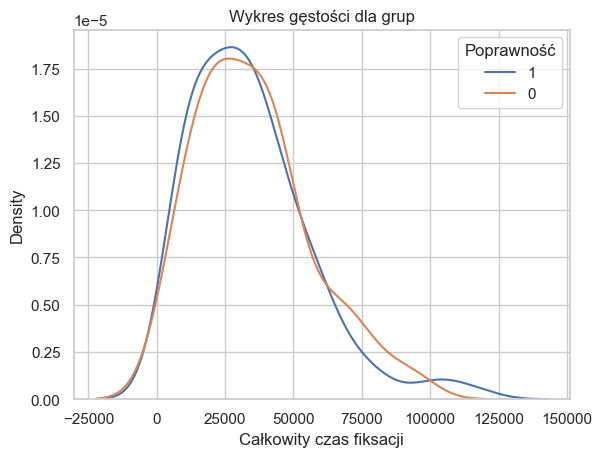

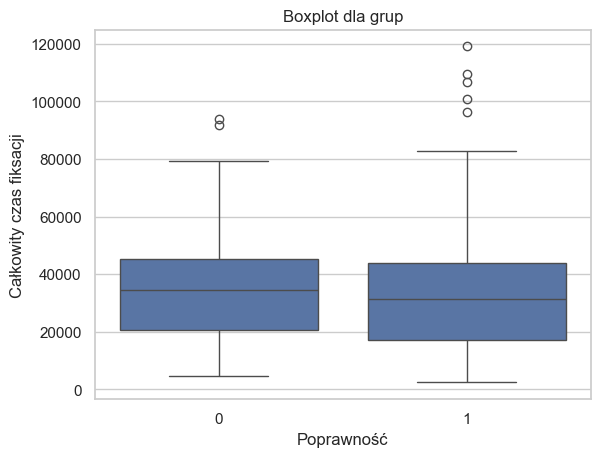

------------------------------
Kolekcja wszystkie grafiki: bez polecenia:


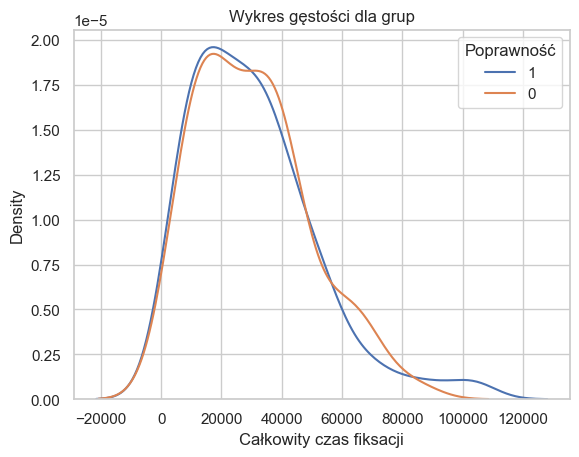

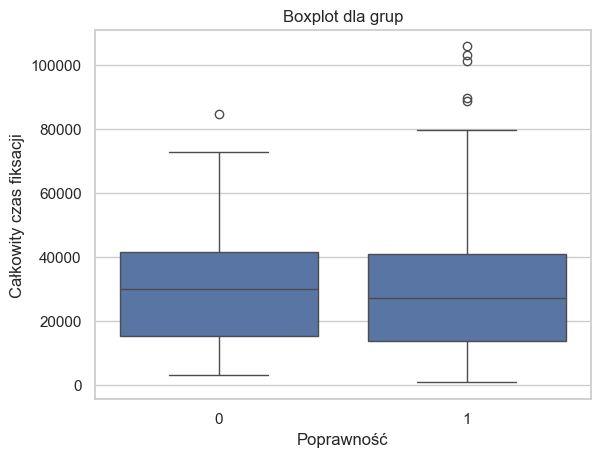

------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:


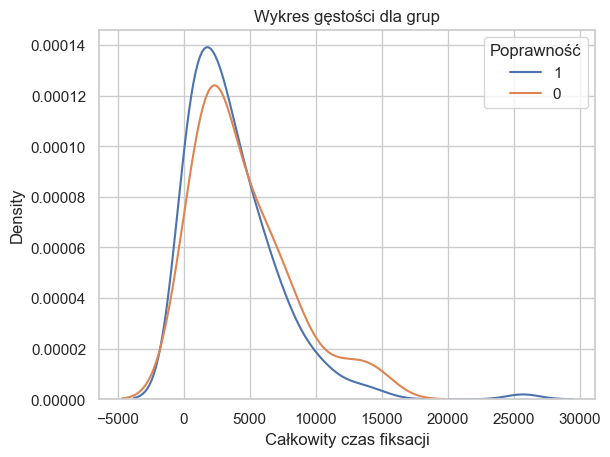

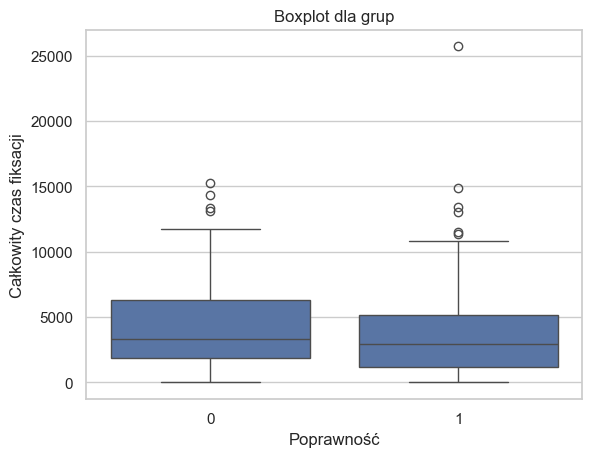

------------------------------
Kolekcja grafiki A: z poleceniem:


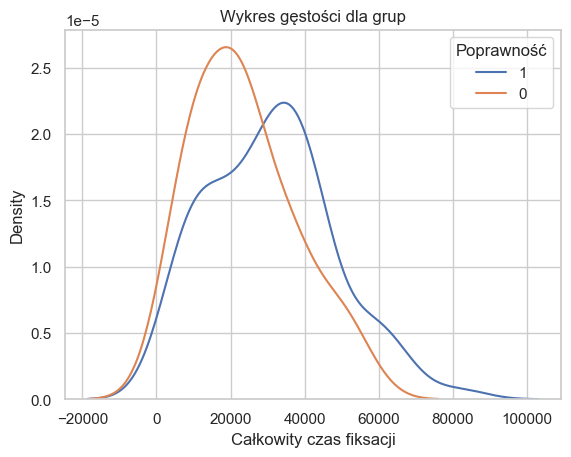

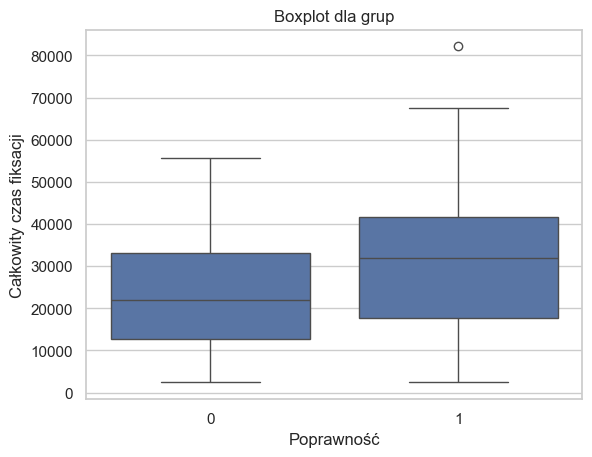

------------------------------
Kolekcja grafiki A: bez polecenia:


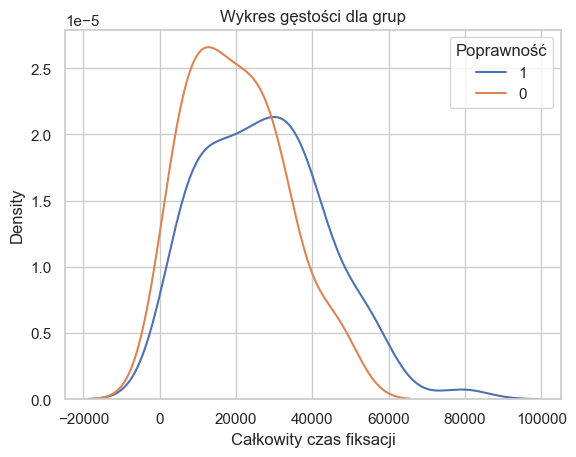

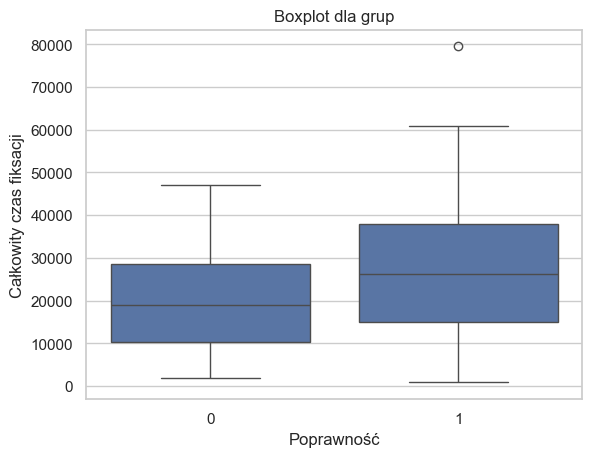

------------------------------
Kolekcja grafiki A: tylko polecenie:


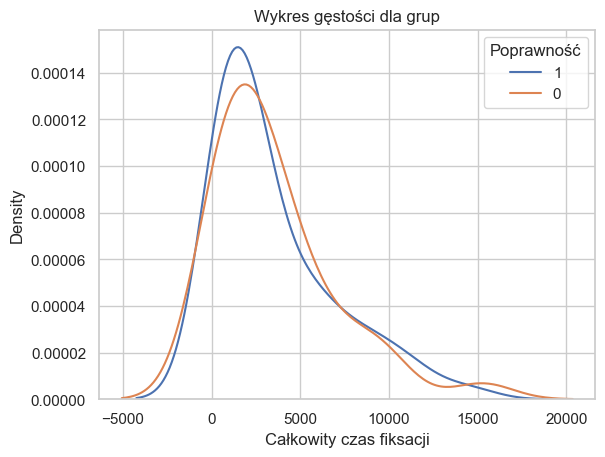

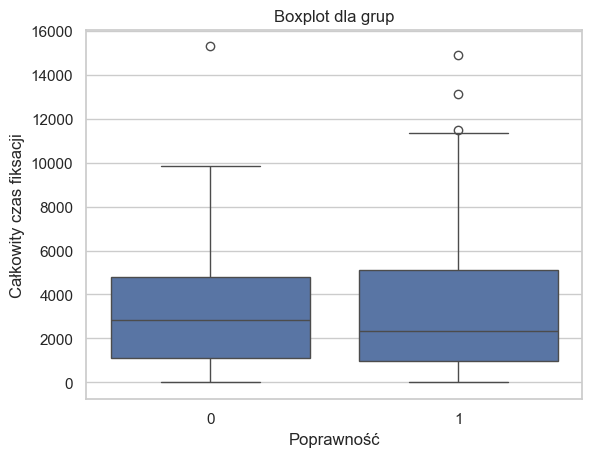

------------------------------
Kolekcja grafiki B: z poleceniem:


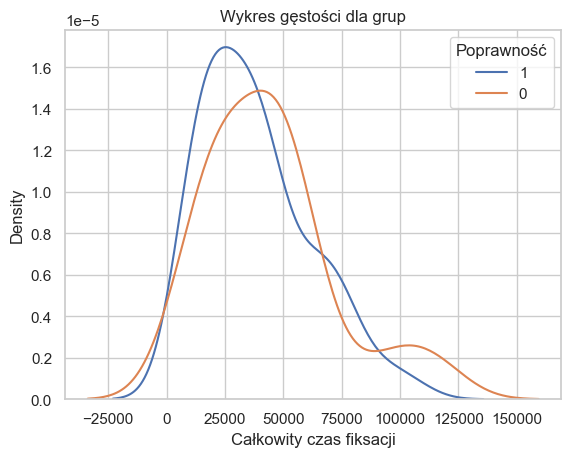

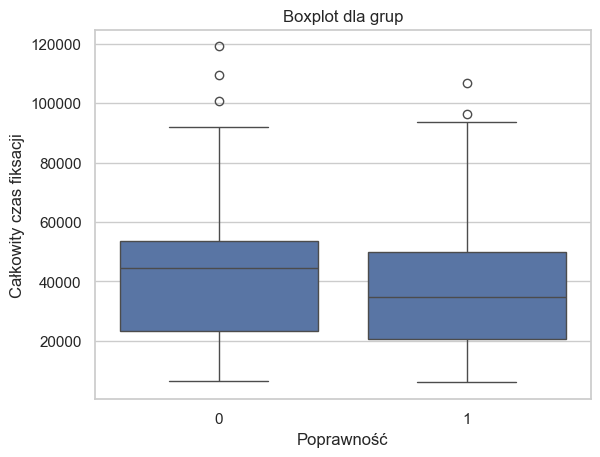

------------------------------
Kolekcja grafiki B: bez polecenia:


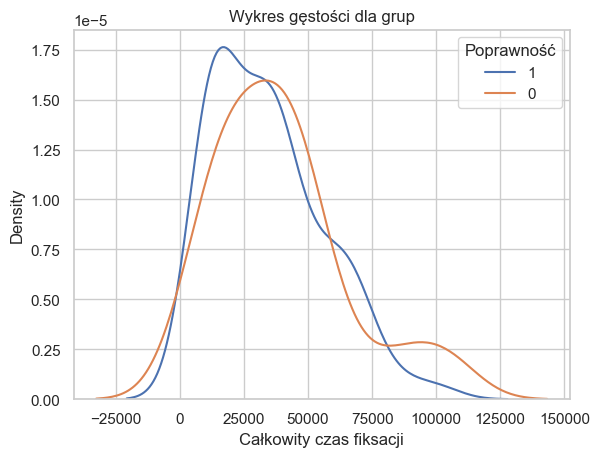

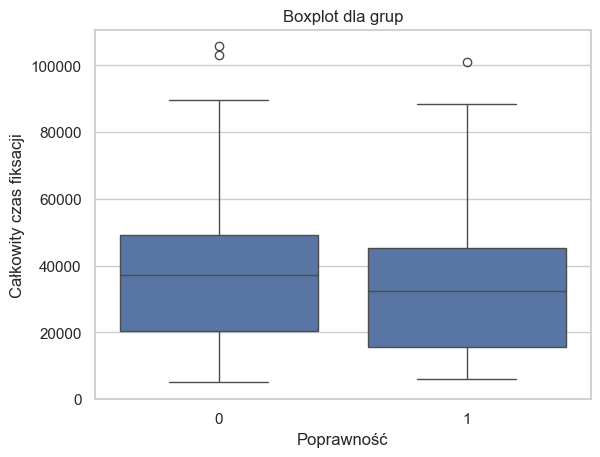

------------------------------
Kolekcja grafiki B: tylko polecenie:


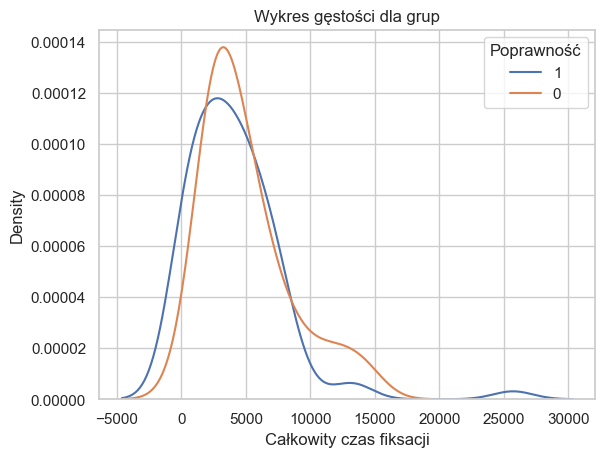

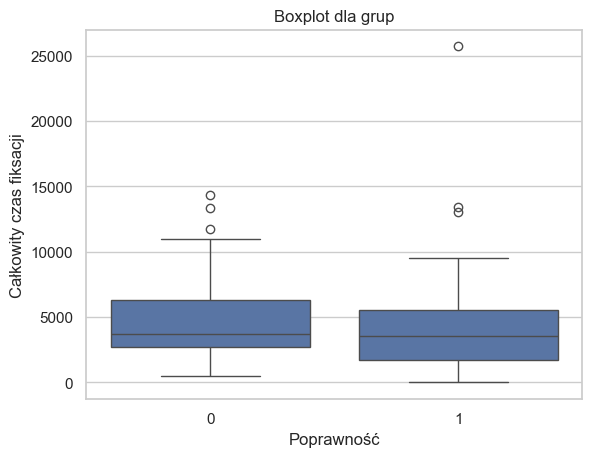

------------------------------
Kolekcja grafiki 1: z poleceniem:


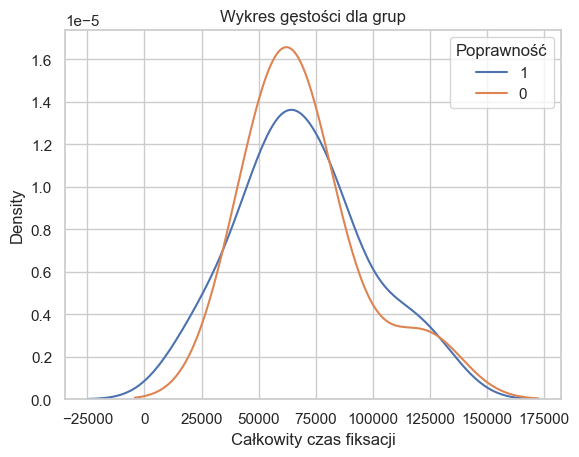

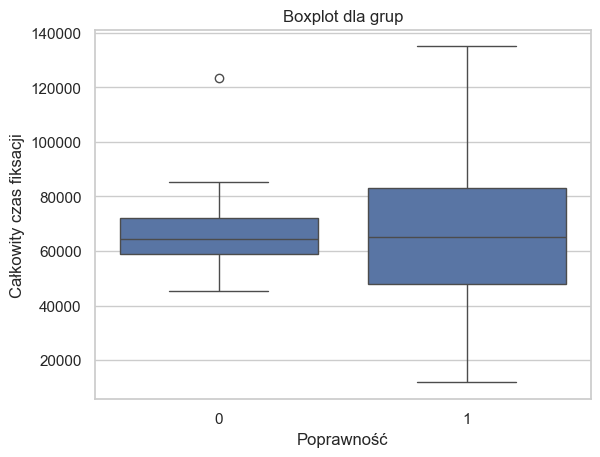

------------------------------
Kolekcja grafiki 1: bez polecenia:


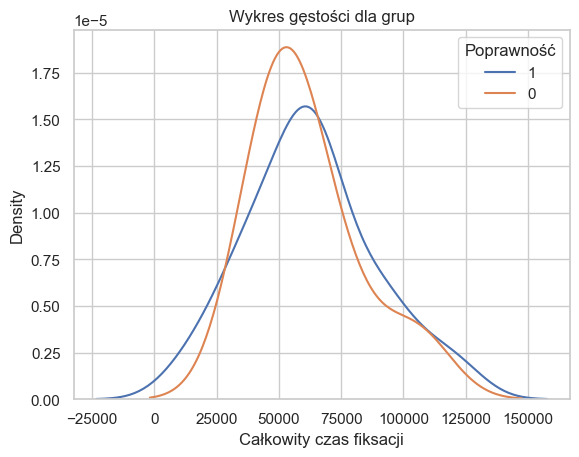

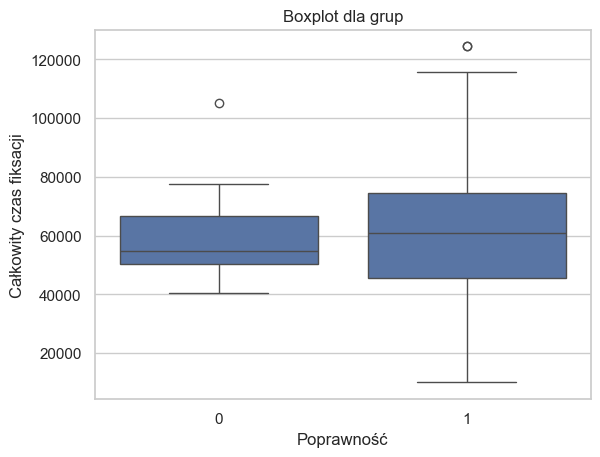

------------------------------
Kolekcja grafiki 1: tylko polecenie :


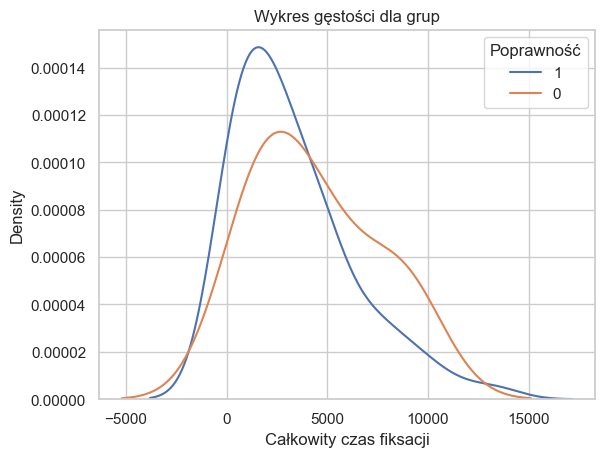

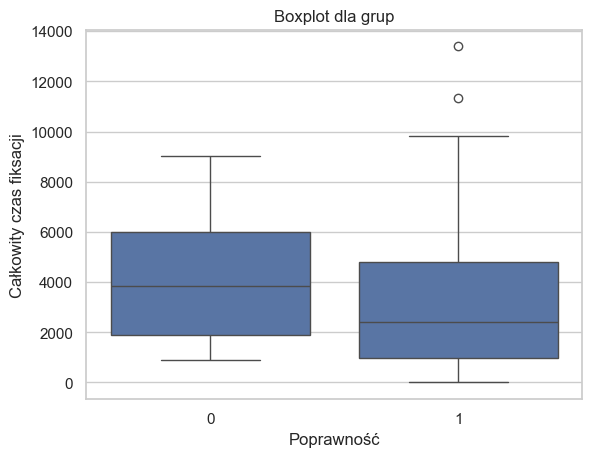

------------------------------
Kolekcja grafiki 2: z poleceniem:


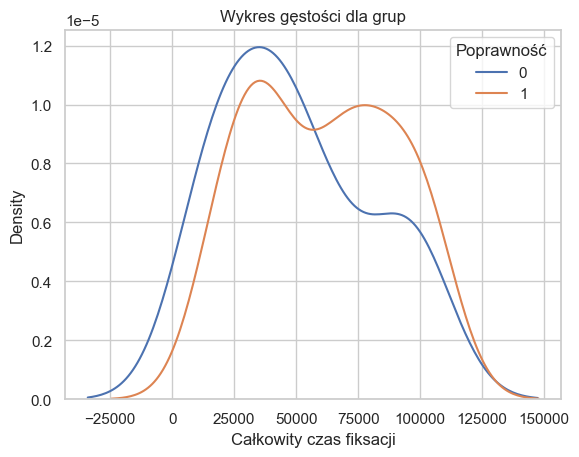

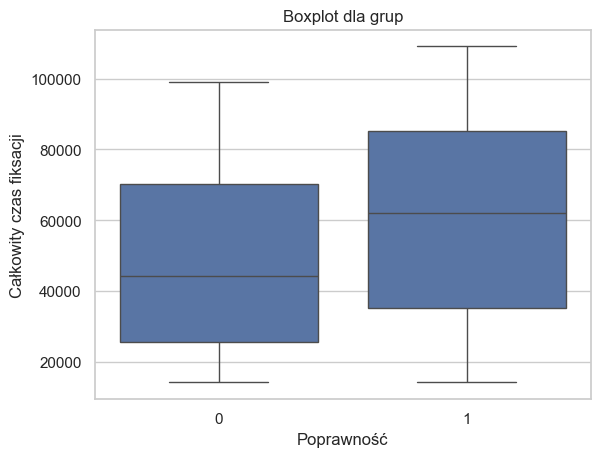

------------------------------
Kolekcja grafiki 2: bez polecenia:


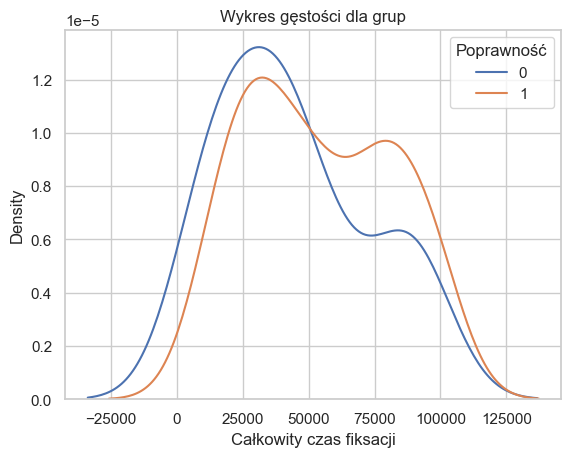

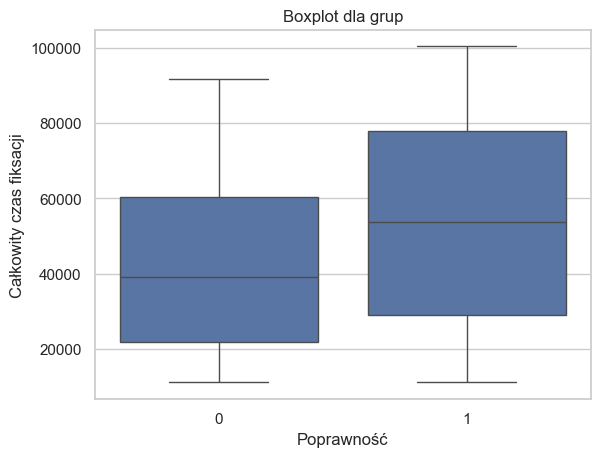

------------------------------
Kolekcja grafiki 2: tylko polecenie:


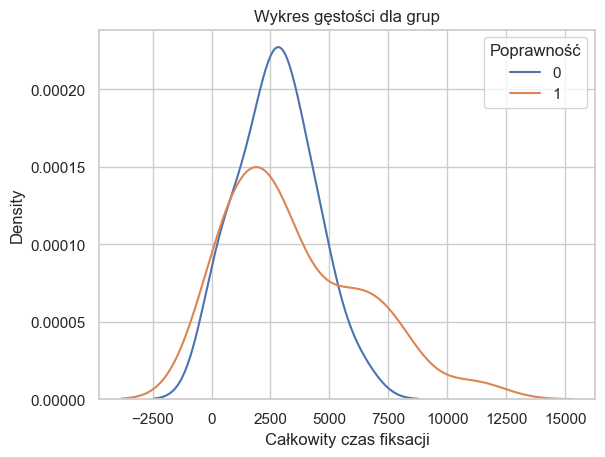

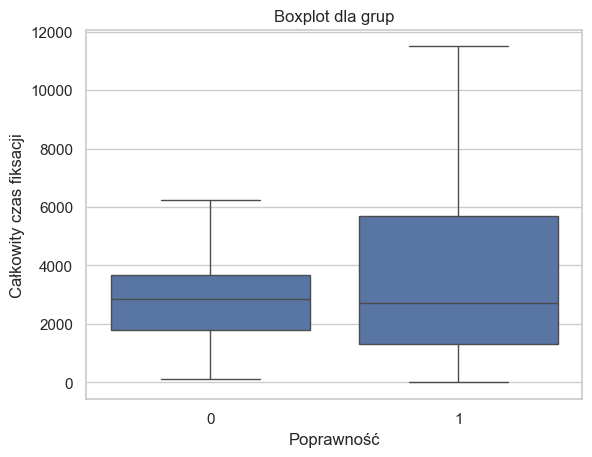

------------------------------
Kolekcja grafiki 3: z poleceniem:


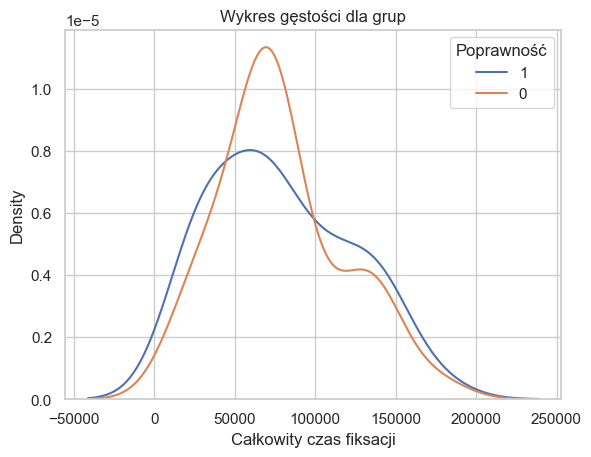

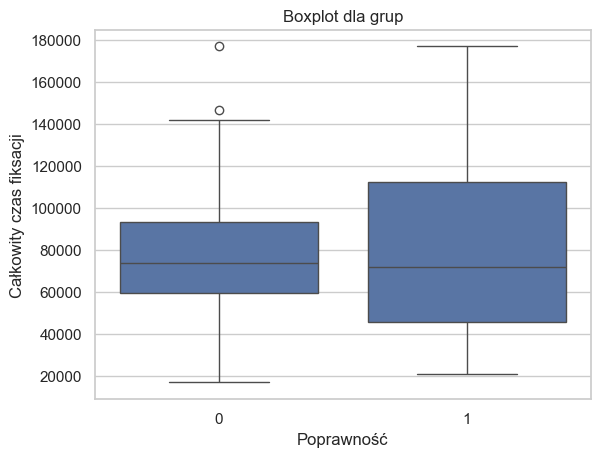

------------------------------
Kolekcja grafiki 3: bez polecenia:


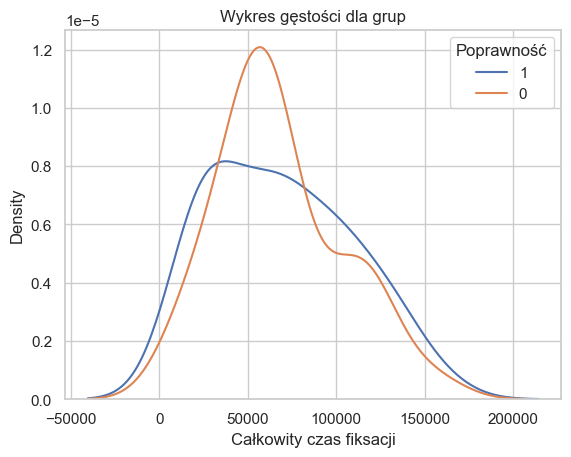

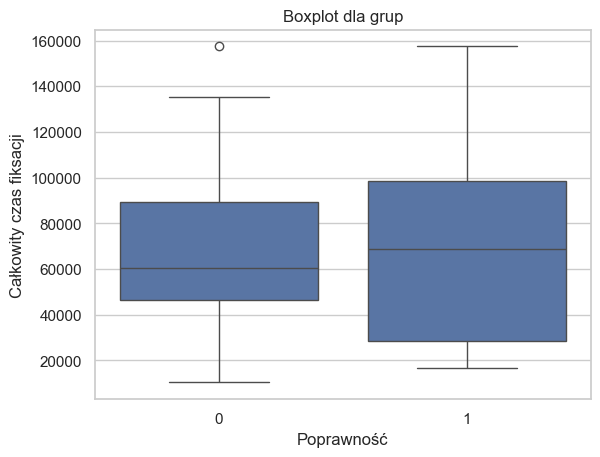

------------------------------
Kolekcja grafiki 3: tylko polecenie:


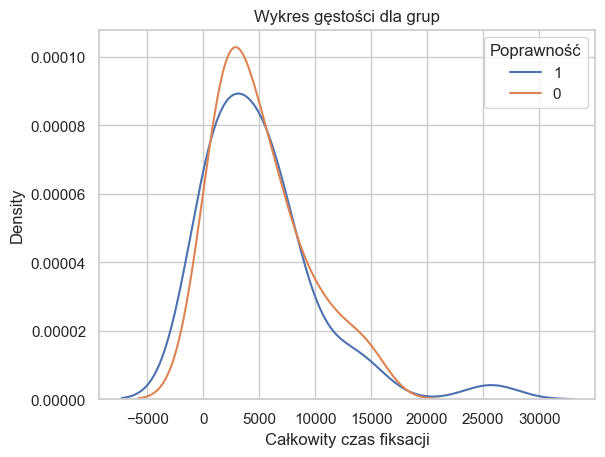

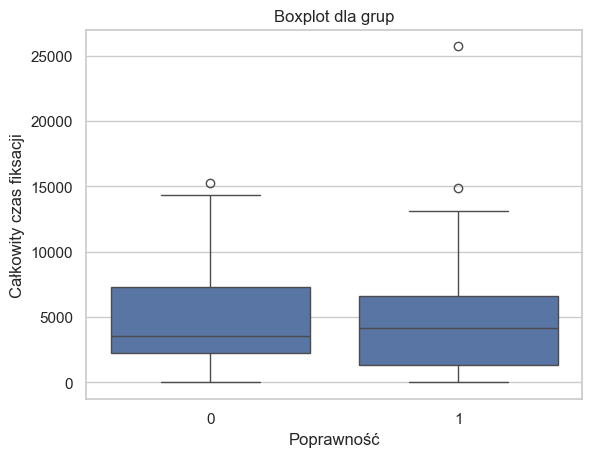

##########################################
Avg
------------------------------
Kolekcja wszystkie grafiki: z poleceniem:


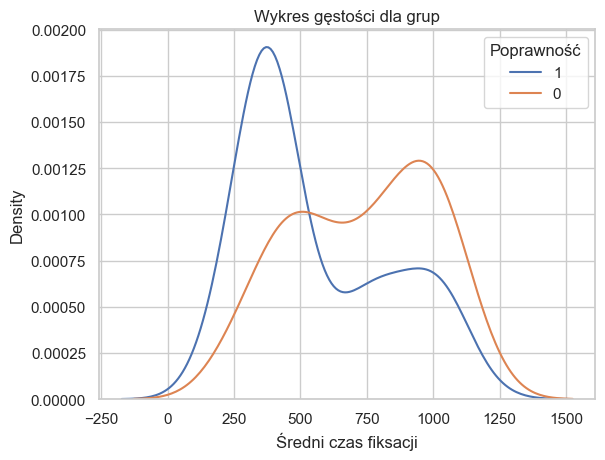

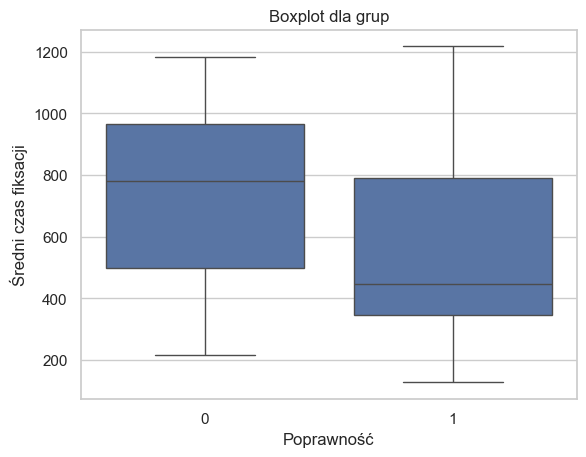

------------------------------
Kolekcja wszystkie grafiki: bez polecenia:


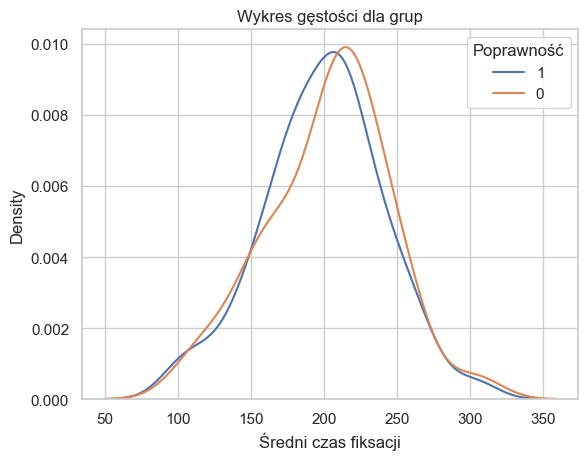

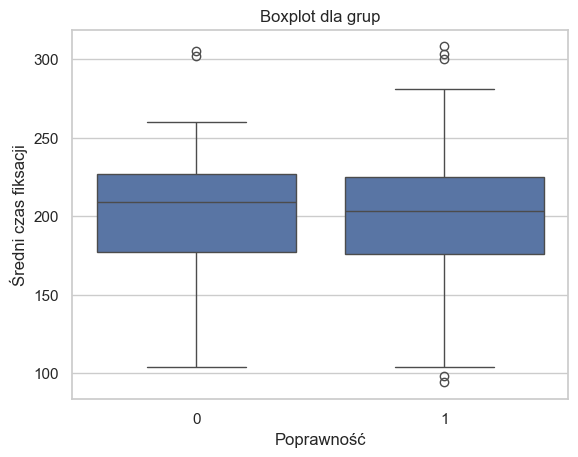

------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:


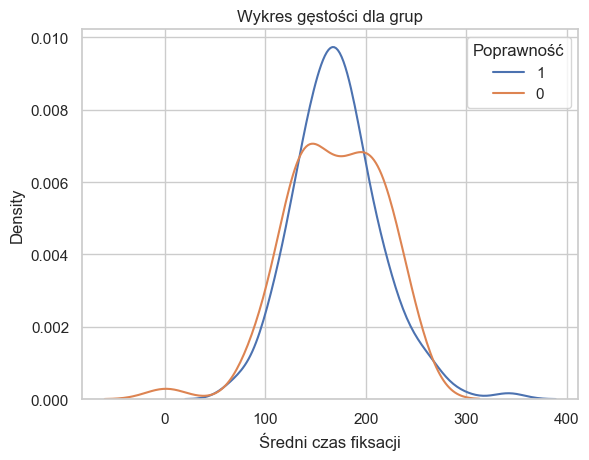

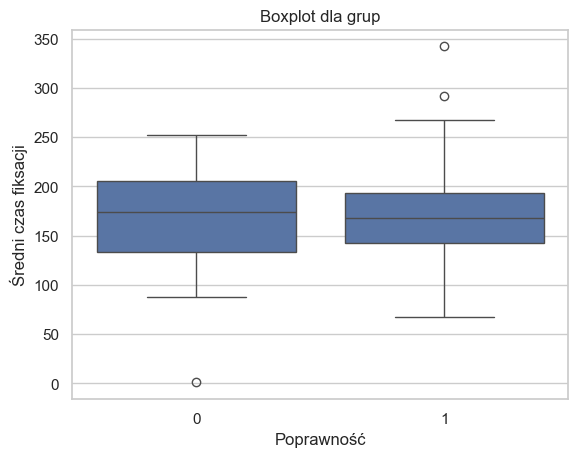

------------------------------
Kolekcja grafiki A: z poleceniem:


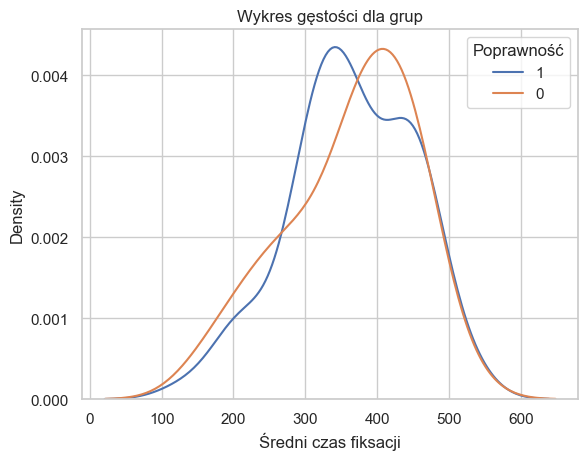

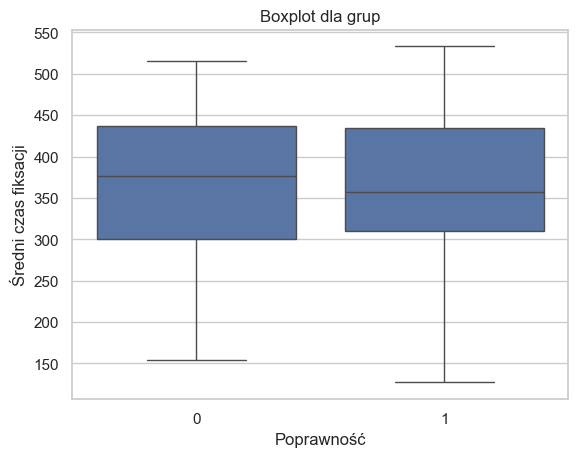

------------------------------
Kolekcja grafiki A: bez polecenia:


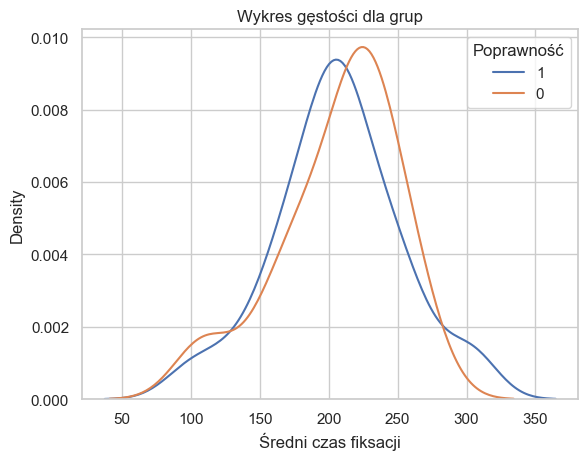

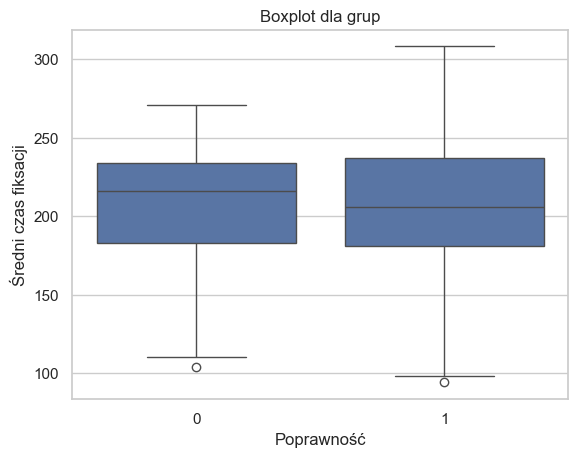

------------------------------
Kolekcja grafiki A: tylko polecenie:


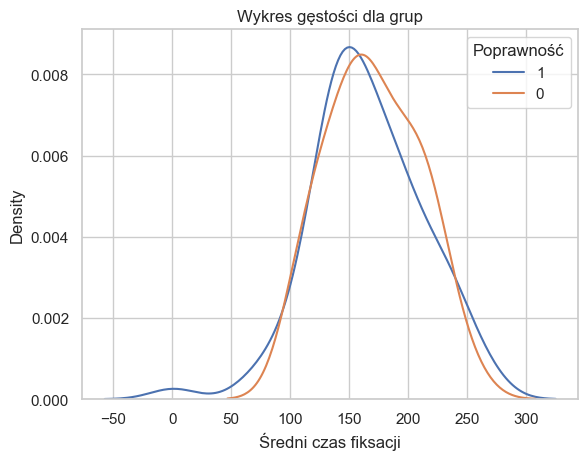

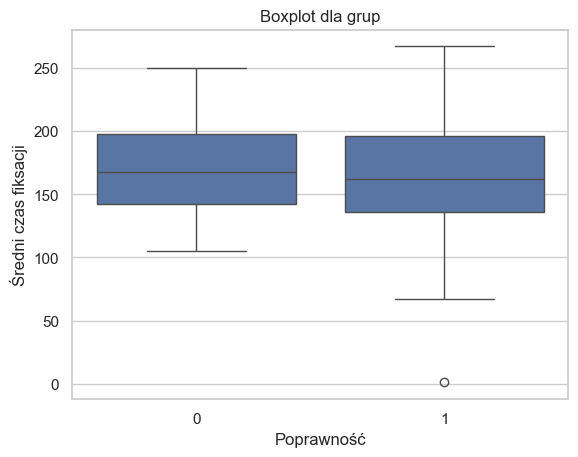

------------------------------
Kolekcja grafiki B: z poleceniem:


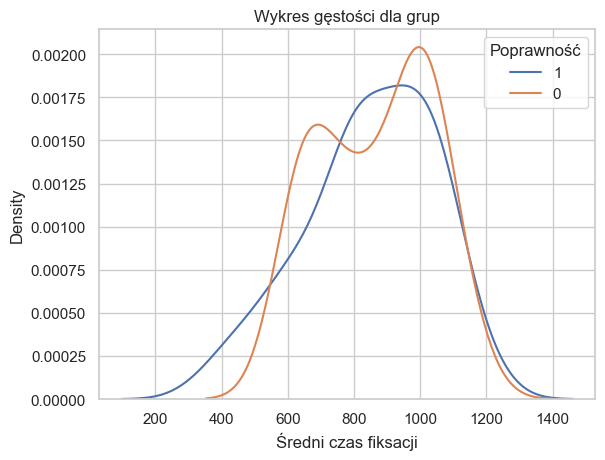

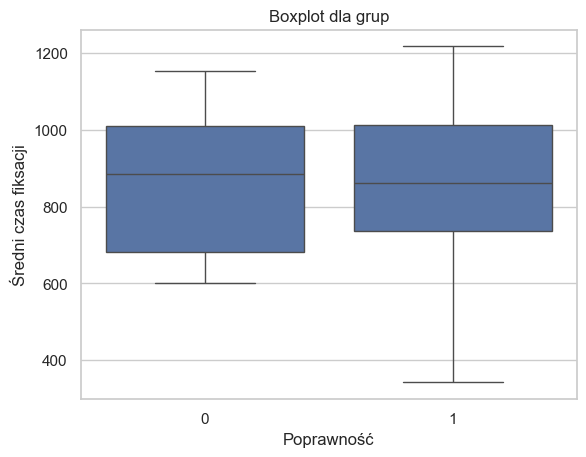

------------------------------
Kolekcja grafiki B: bez polecenia:


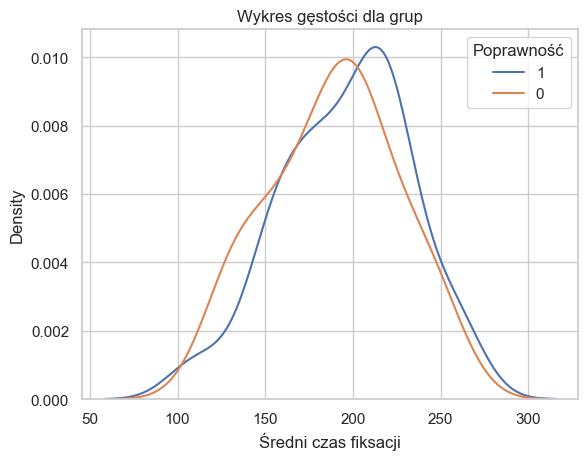

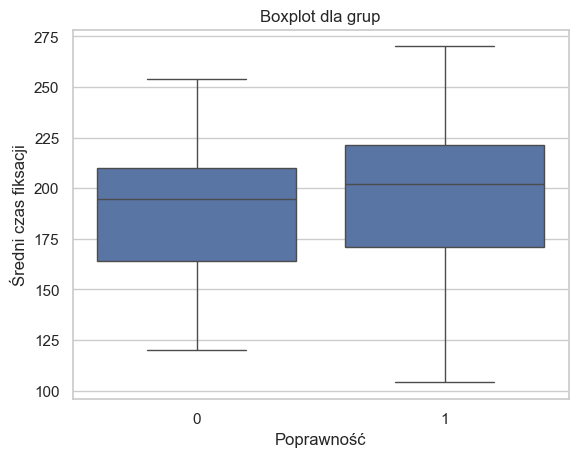

------------------------------
Kolekcja grafiki B: tylko polecenie:


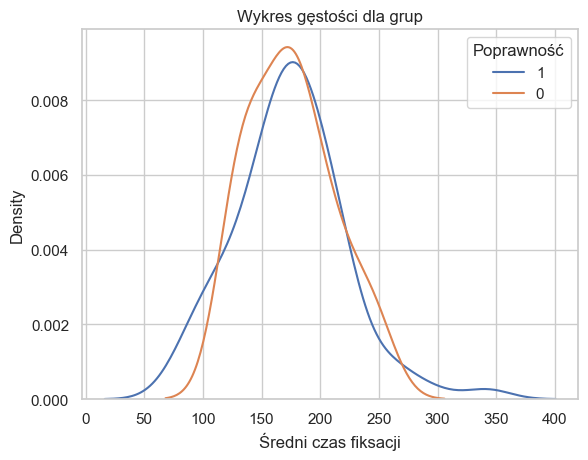

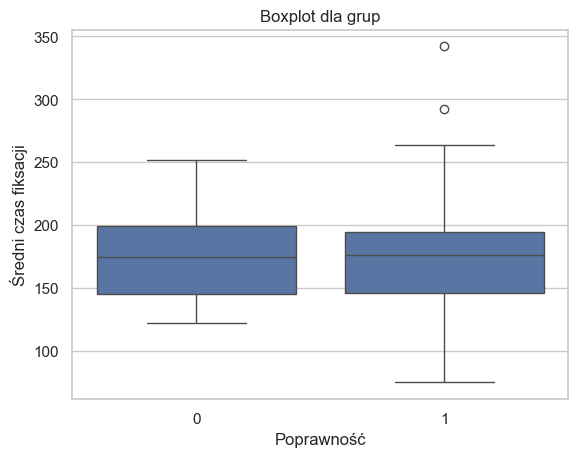

------------------------------
Kolekcja grafiki 1: z poleceniem:


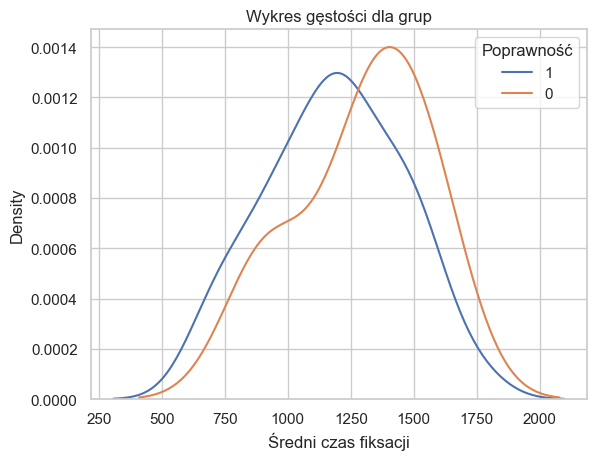

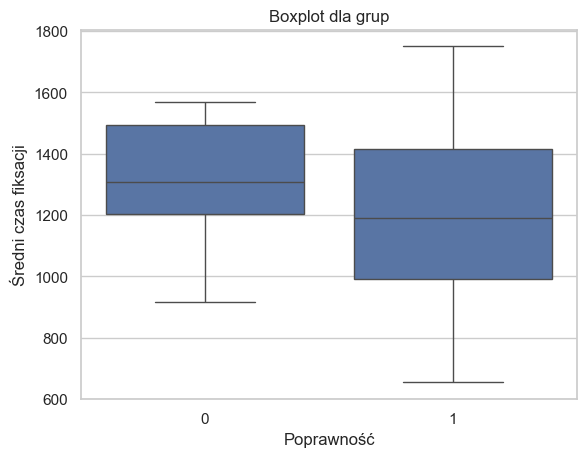

------------------------------
Kolekcja grafiki 1: bez polecenia:


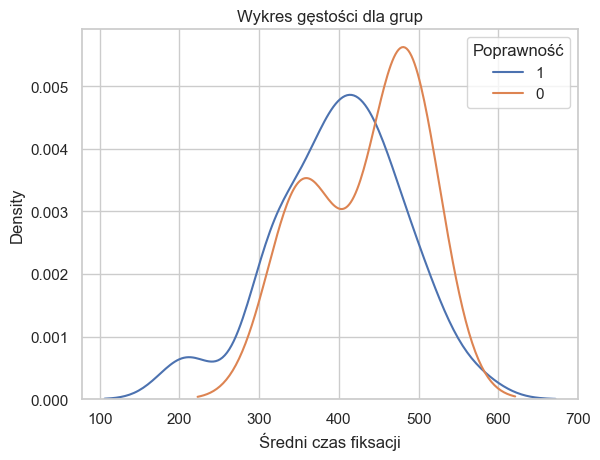

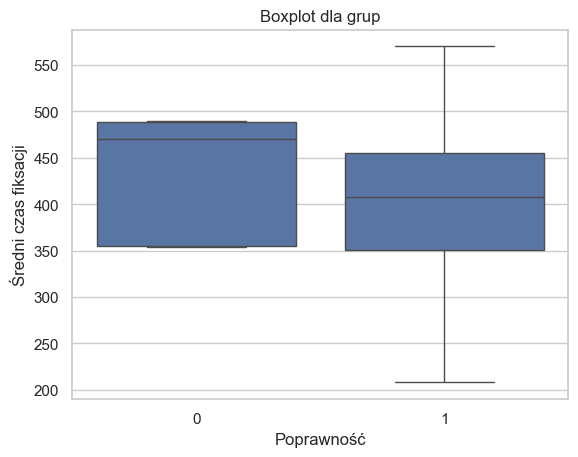

------------------------------
Kolekcja grafiki 1: tylko polecenie :


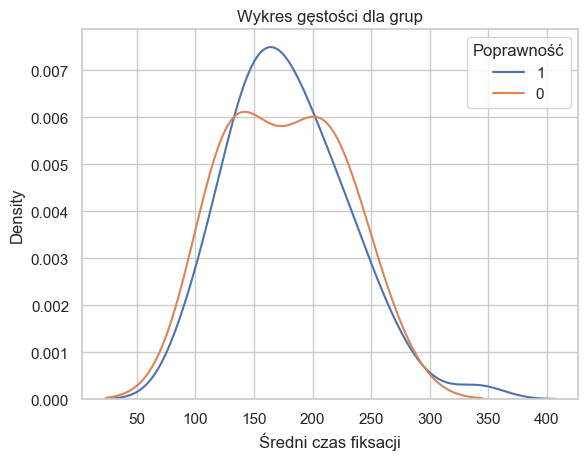

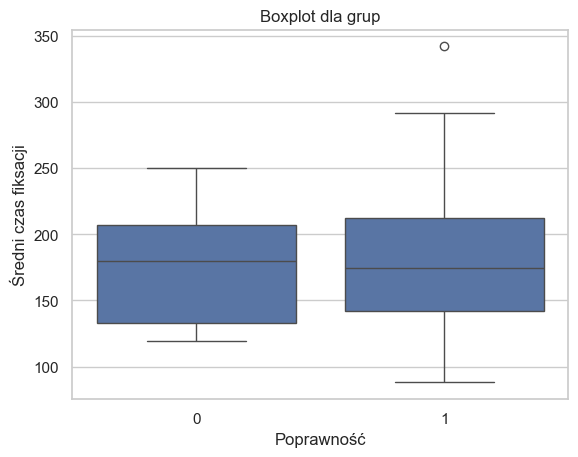

------------------------------
Kolekcja grafiki 2: z poleceniem:


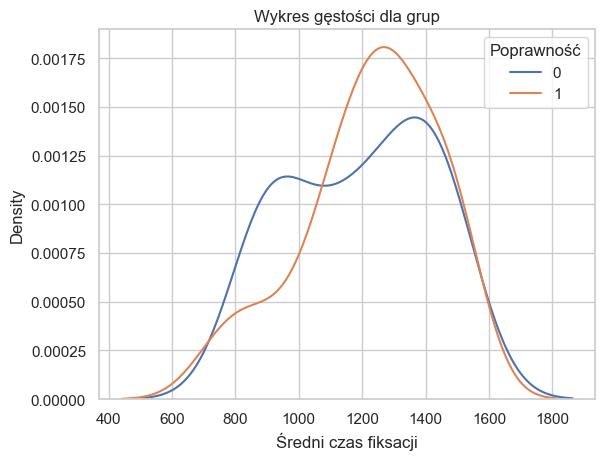

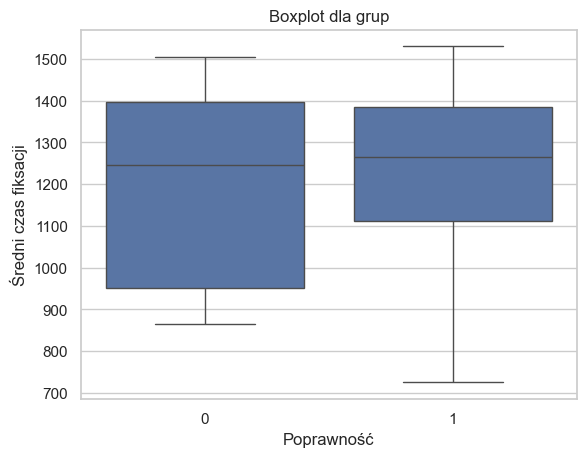

------------------------------
Kolekcja grafiki 2: bez polecenia:


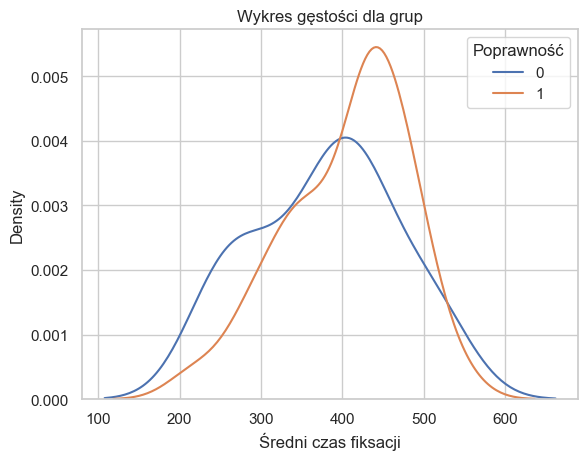

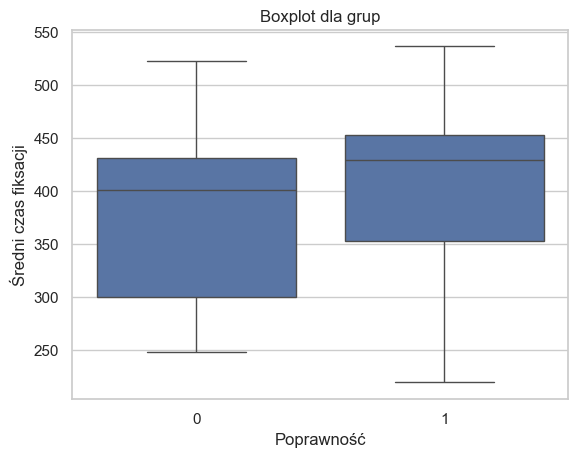

------------------------------
Kolekcja grafiki 2: tylko polecenie:


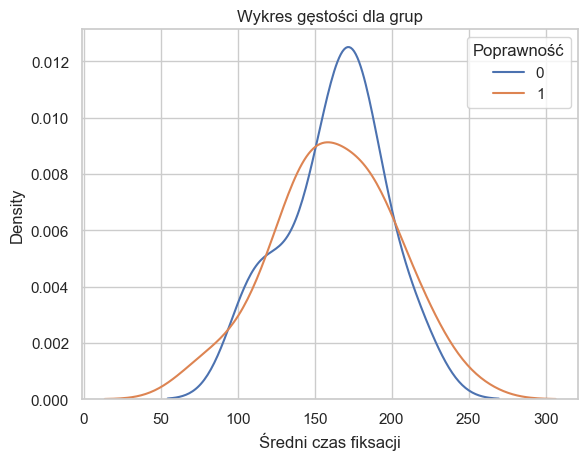

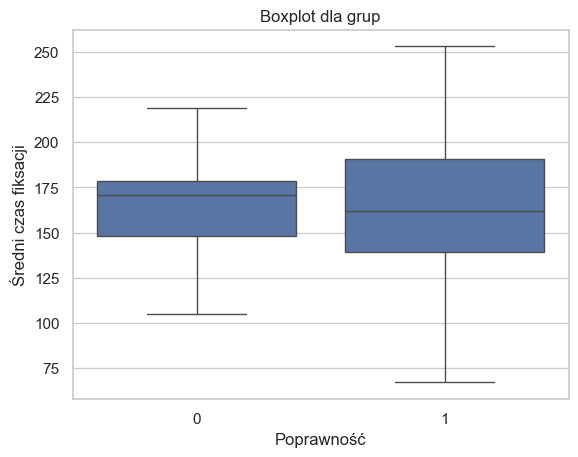

------------------------------
Kolekcja grafiki 3: z poleceniem:


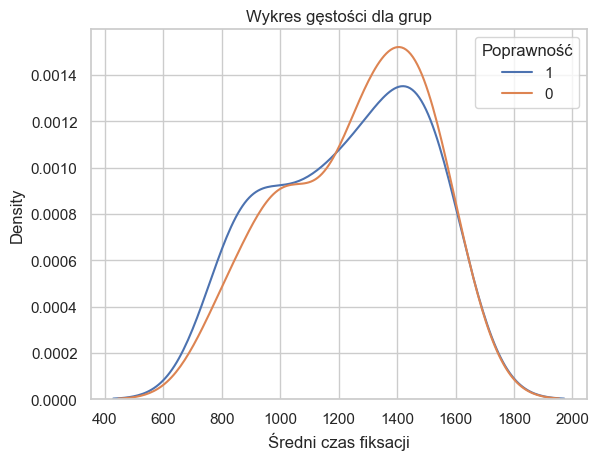

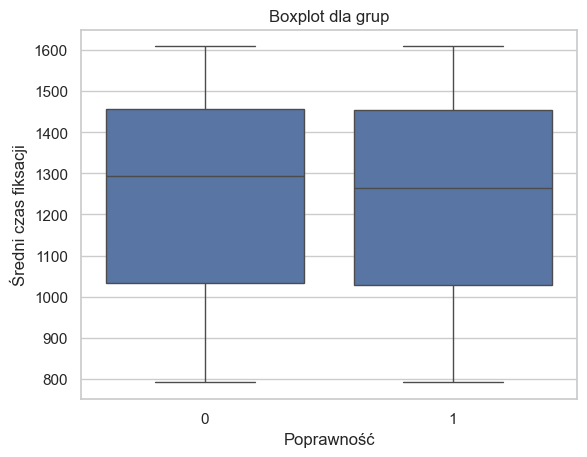

------------------------------
Kolekcja grafiki 3: bez polecenia:


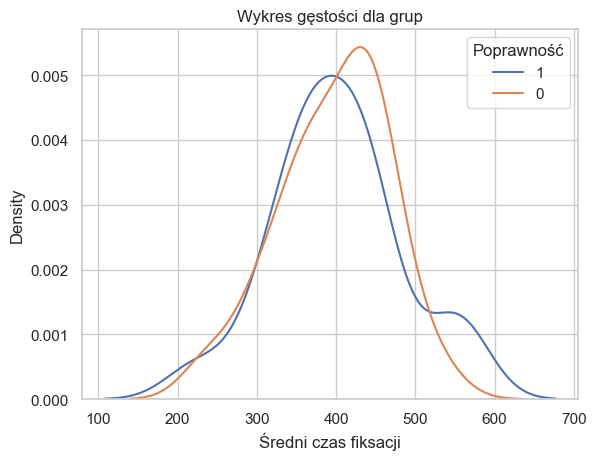

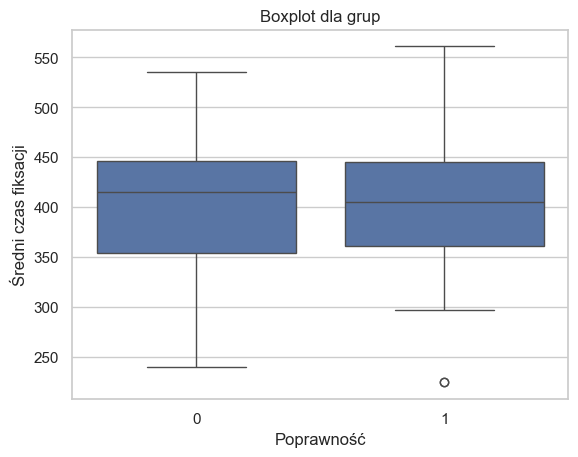

------------------------------
Kolekcja grafiki 3: tylko polecenie:


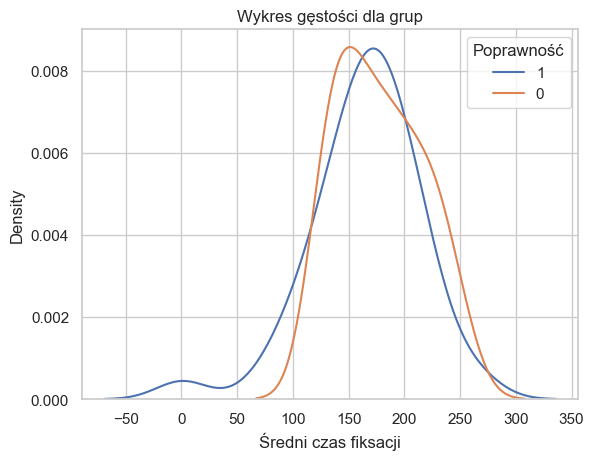

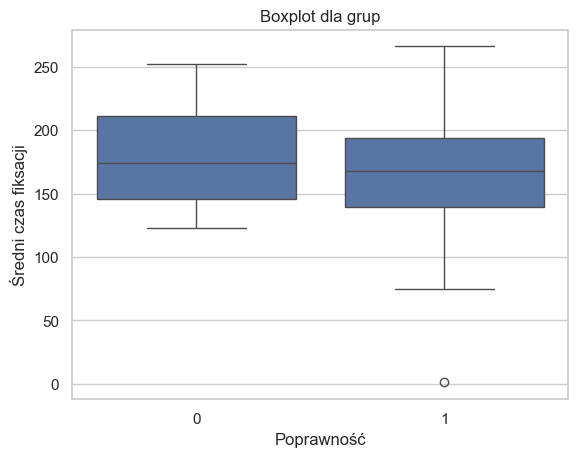

##########################################
Avg_pupil
------------------------------
Kolekcja wszystkie grafiki: z poleceniem:


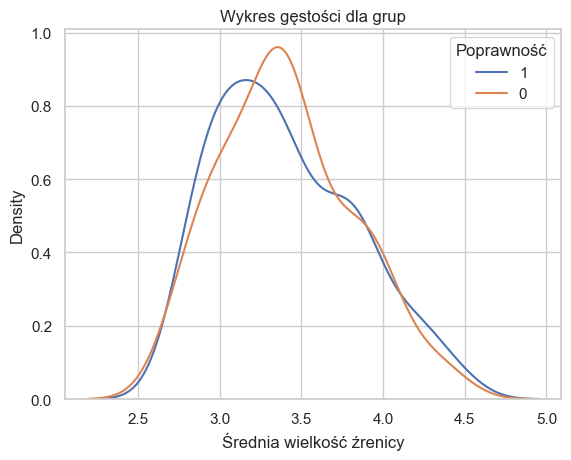

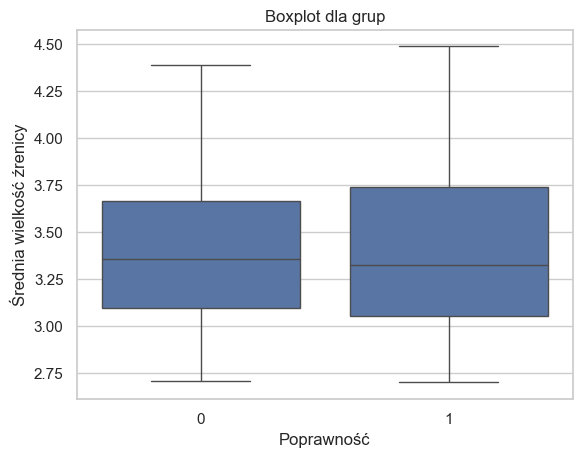

------------------------------
Kolekcja wszystkie grafiki: bez polecenia:


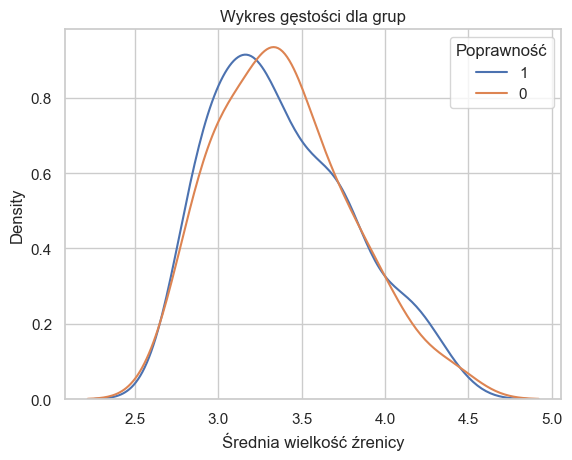

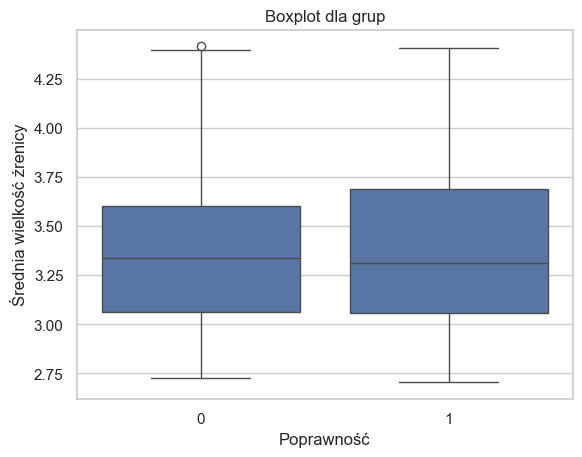

------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:


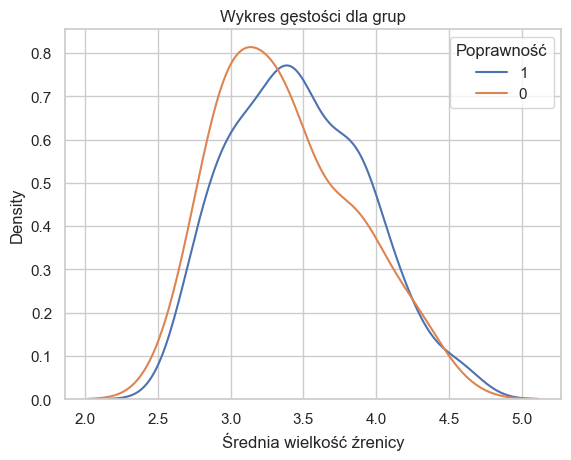

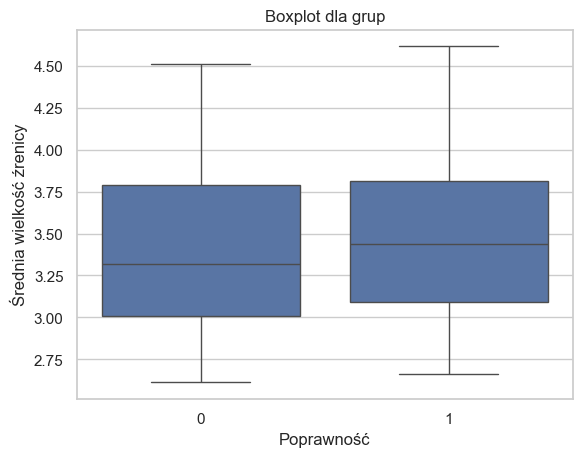

------------------------------
Kolekcja grafiki A: z poleceniem:


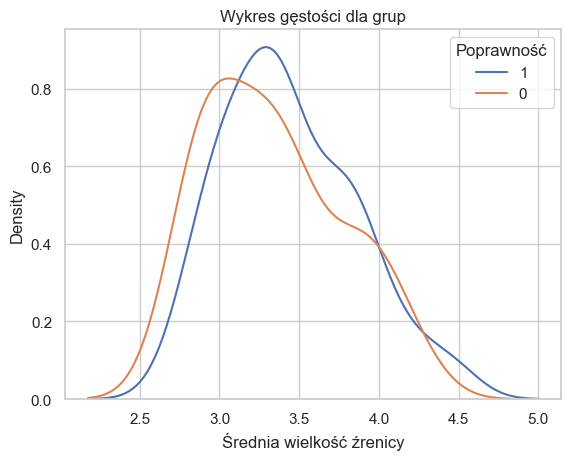

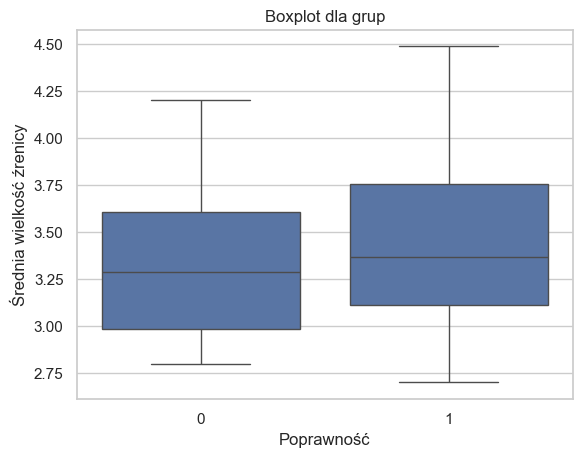

------------------------------
Kolekcja grafiki A: bez polecenia:


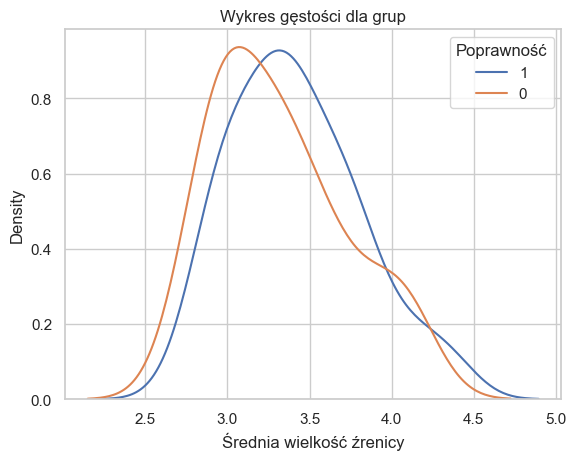

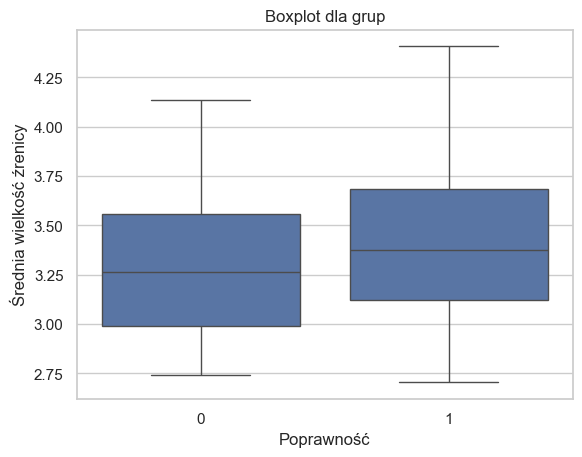

------------------------------
Kolekcja grafiki A: tylko polecenie:


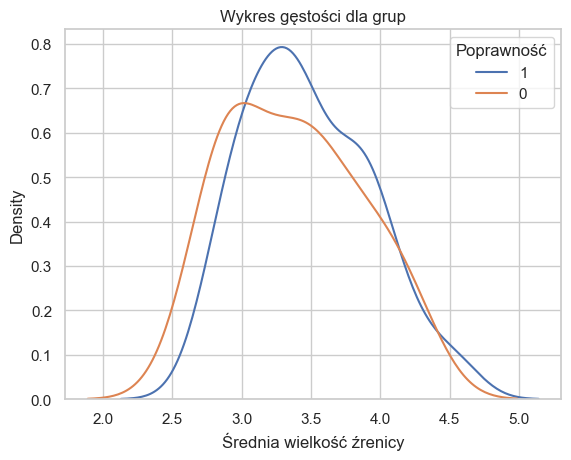

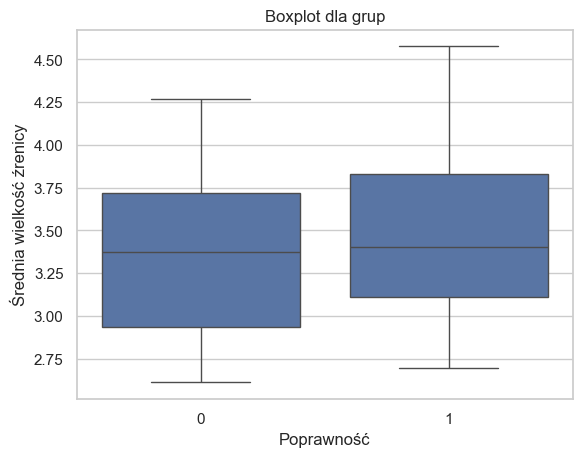

------------------------------
Kolekcja grafiki B: z poleceniem:


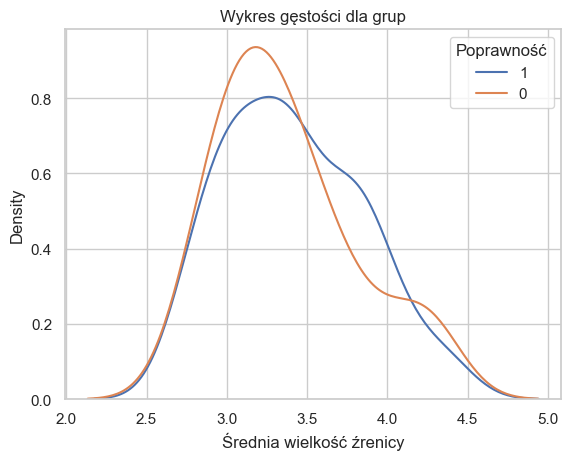

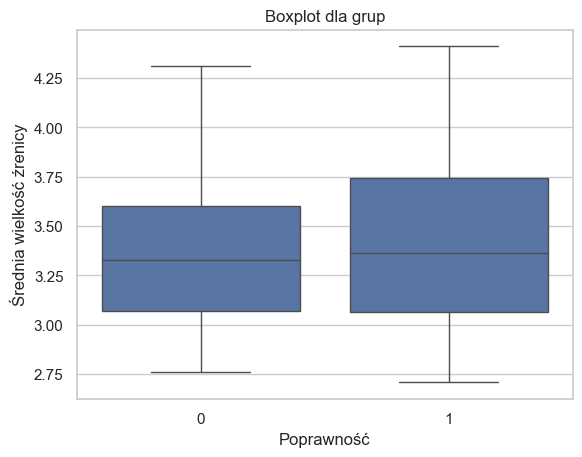

------------------------------
Kolekcja grafiki B: bez polecenia:


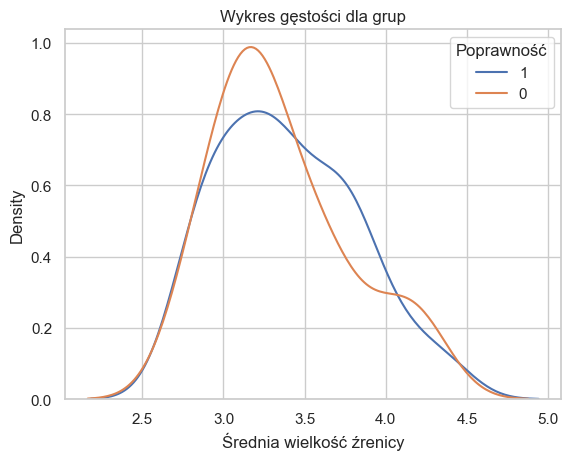

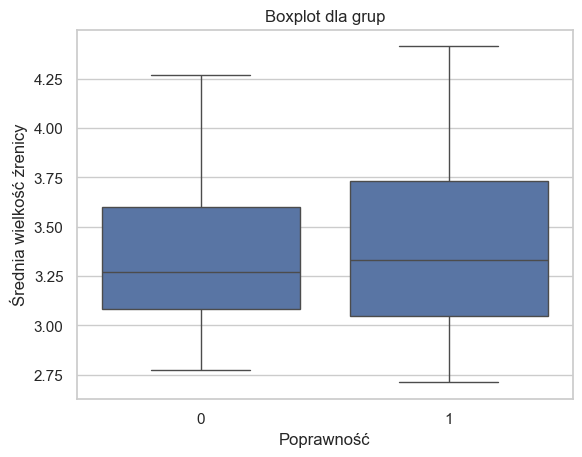

------------------------------
Kolekcja grafiki B: tylko polecenie:


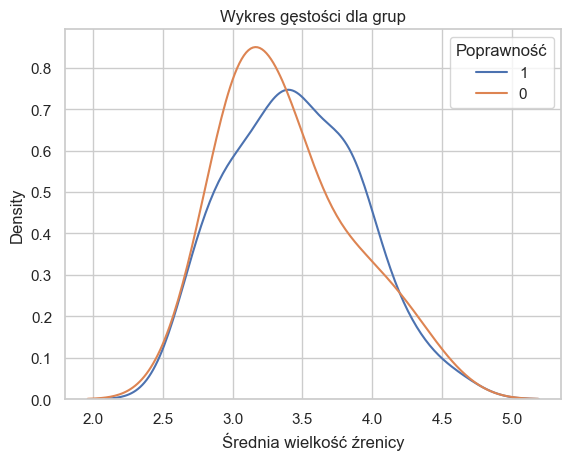

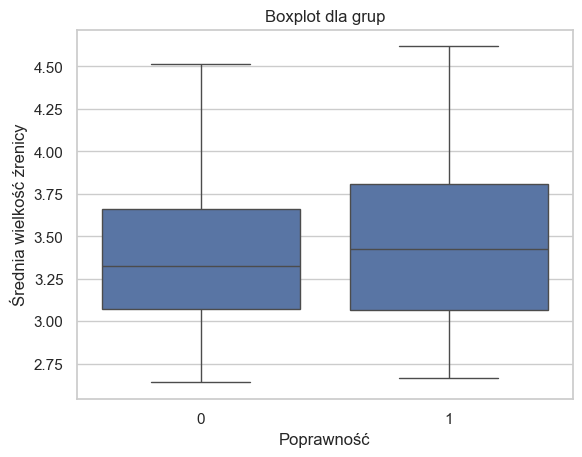

------------------------------
Kolekcja grafiki 1: z poleceniem:


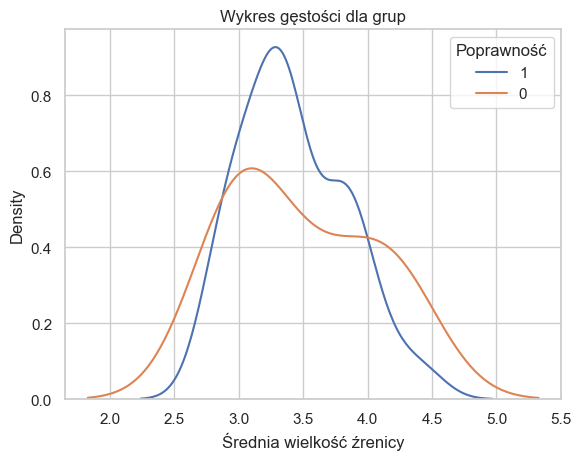

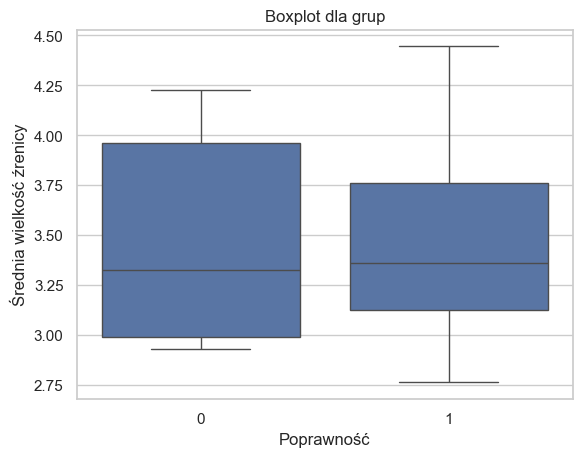

------------------------------
Kolekcja grafiki 1: bez polecenia:


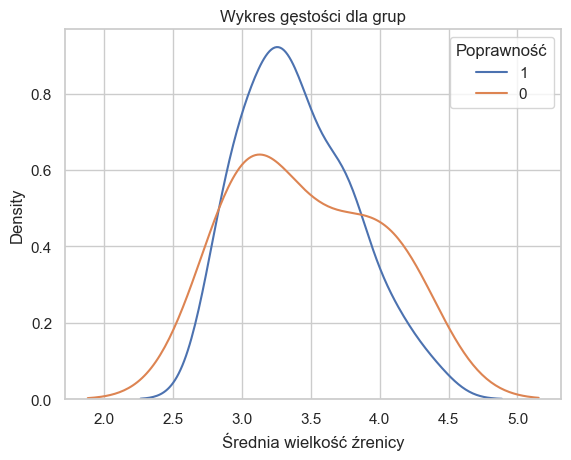

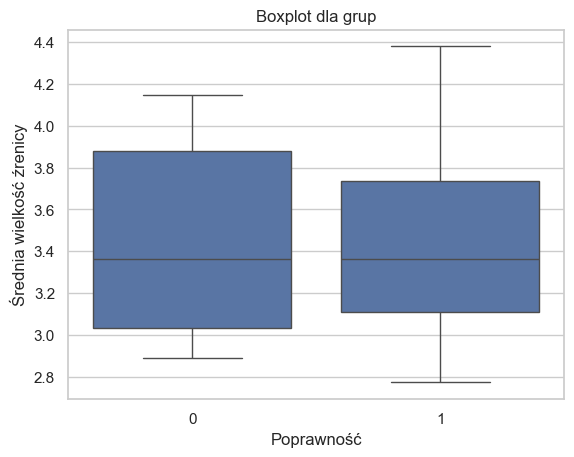

------------------------------
Kolekcja grafiki 1: tylko polecenie :


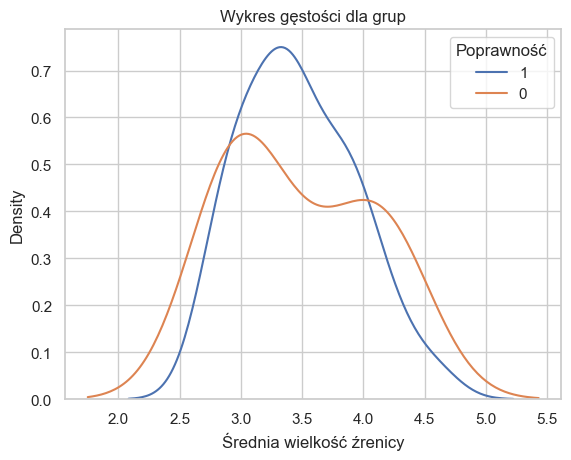

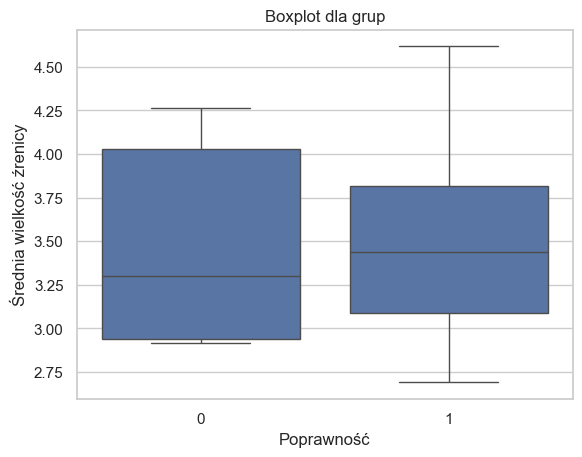

------------------------------
Kolekcja grafiki 2: z poleceniem:


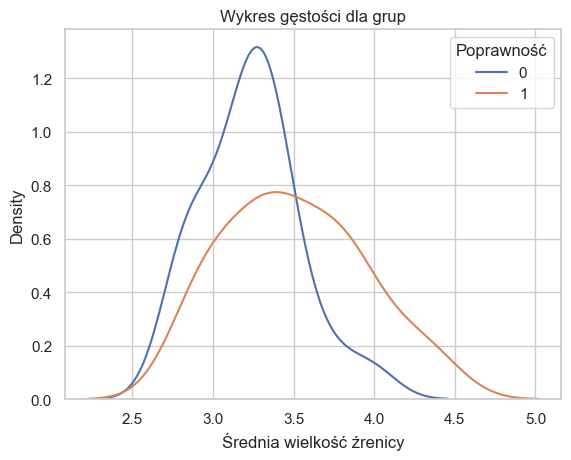

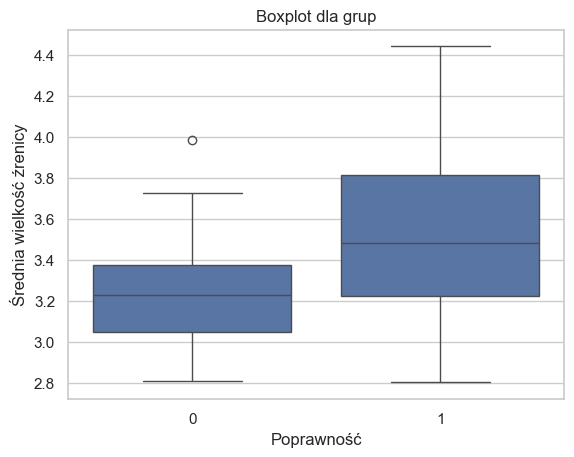

------------------------------
Kolekcja grafiki 2: bez polecenia:


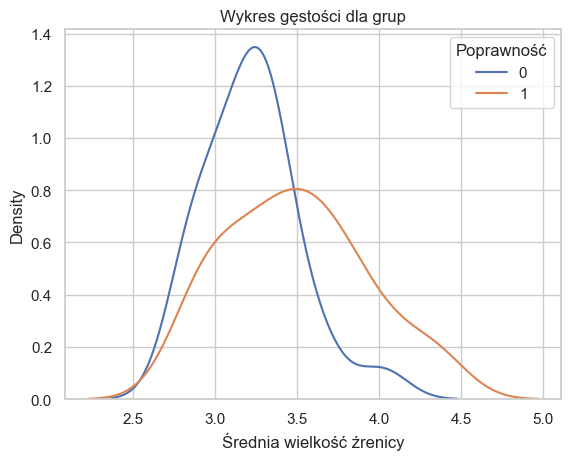

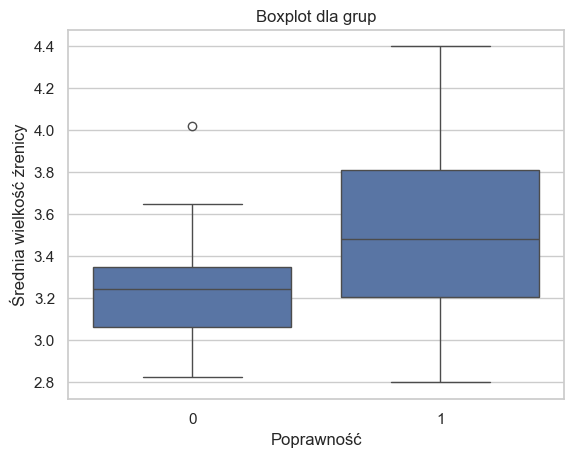

------------------------------
Kolekcja grafiki 2: tylko polecenie:


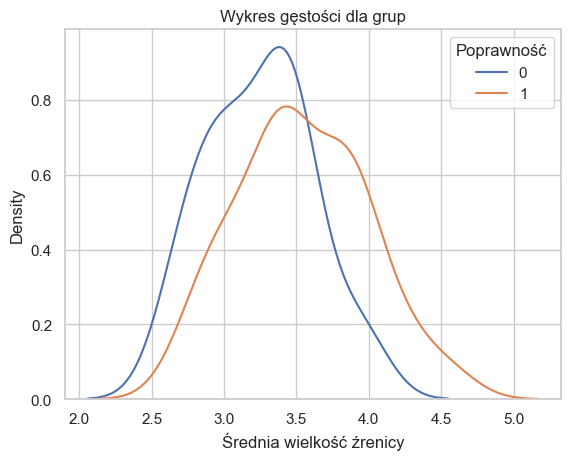

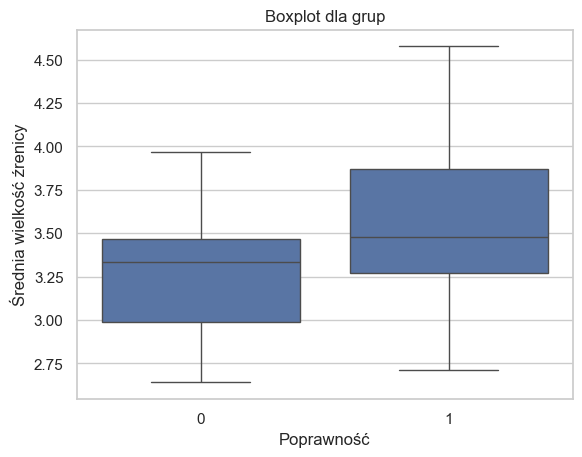

------------------------------
Kolekcja grafiki 3: z poleceniem:


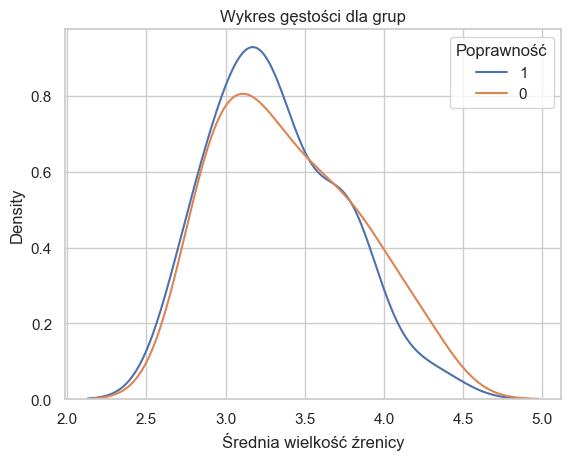

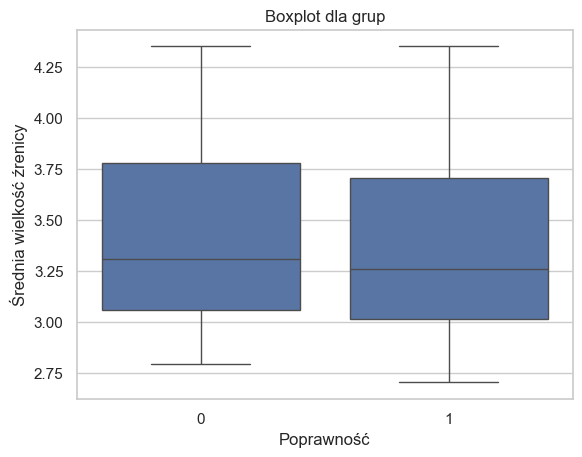

------------------------------
Kolekcja grafiki 3: bez polecenia:


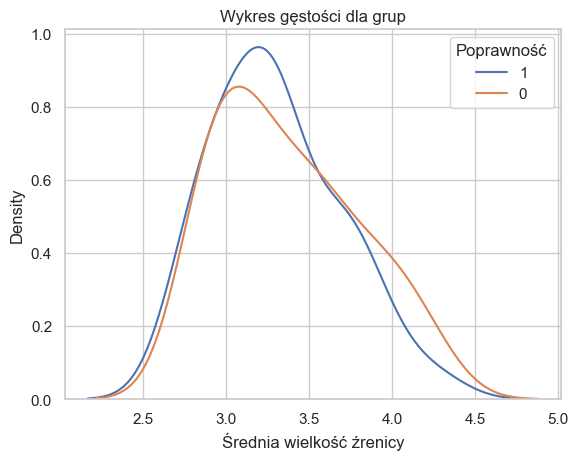

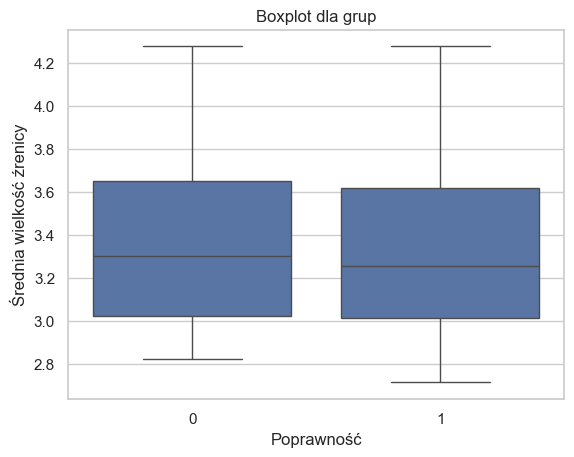

------------------------------
Kolekcja grafiki 3: tylko polecenie:


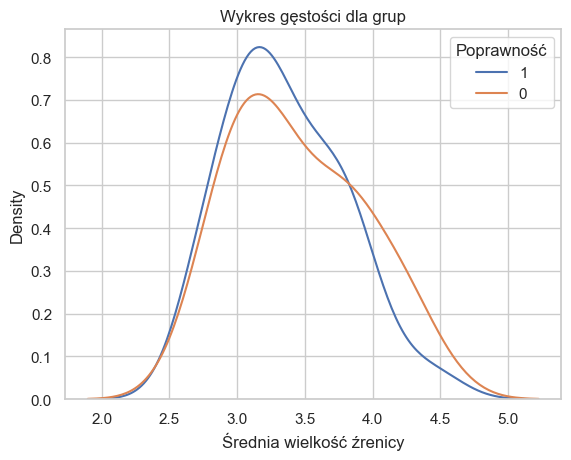

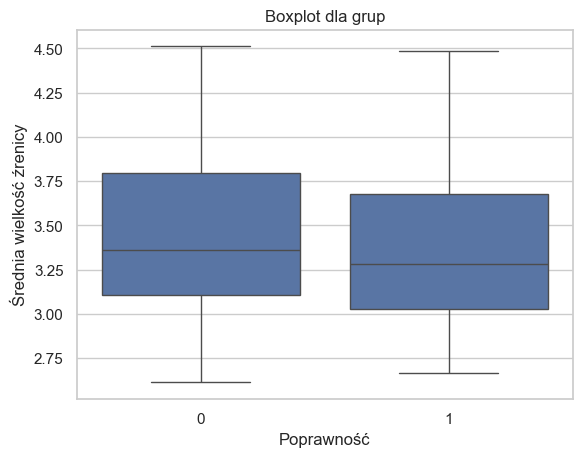

In [55]:
param_category = 'Corr'
for col in cols_continue:
    print('##########################################')
    print(col)
    for i, df in enumerate(dfs_coll):
        print('------------------------------')
        print(names_coll[i+1])
        plot_multi_density(df, col, param_category, cols_continue[col], 'Poprawność')
        plot_multi_boxplot(df, param_category, col, 'Poprawność', cols_continue[col])

##########################################
Total
------------------------------
Zsumowane wszystkie grafiki: z poleceniem:


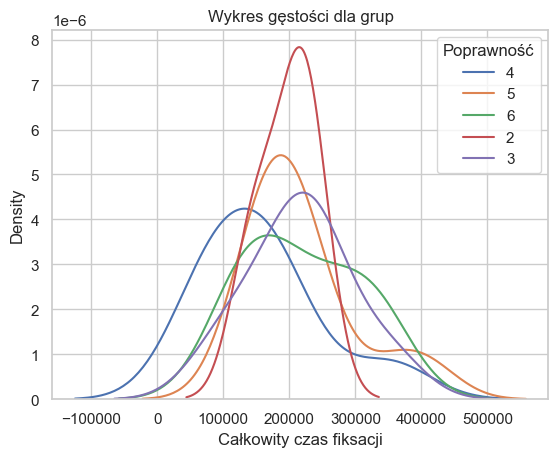

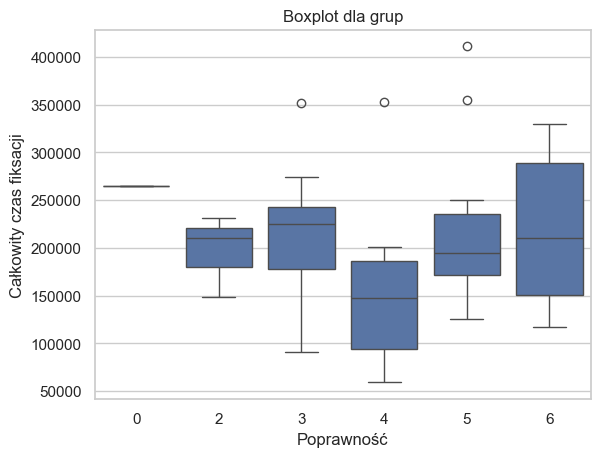

------------------------------
Zsumowane wszystkie grafiki: bez polecenia:


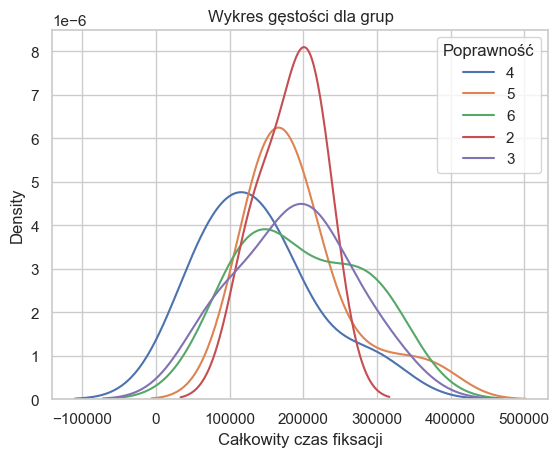

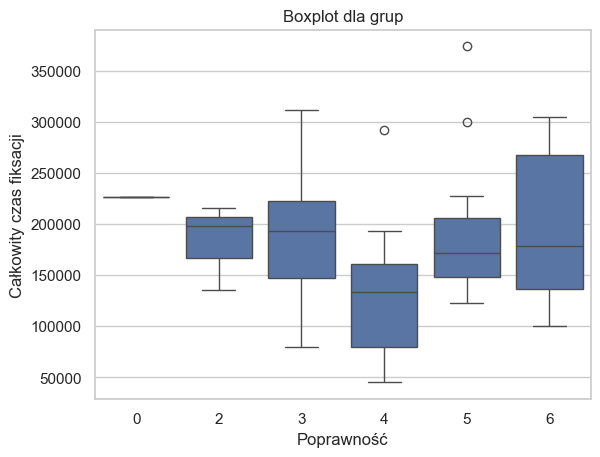

------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :


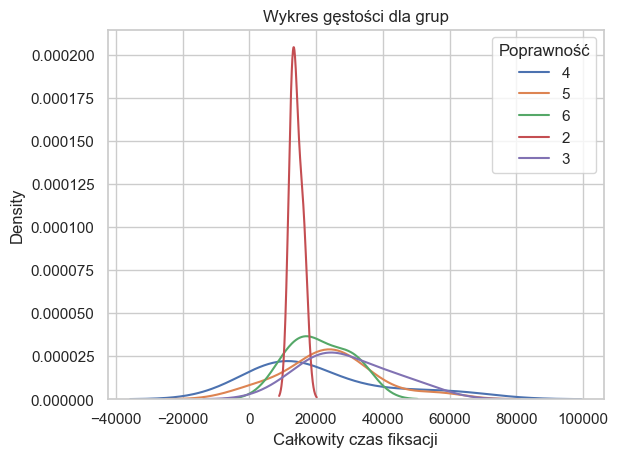

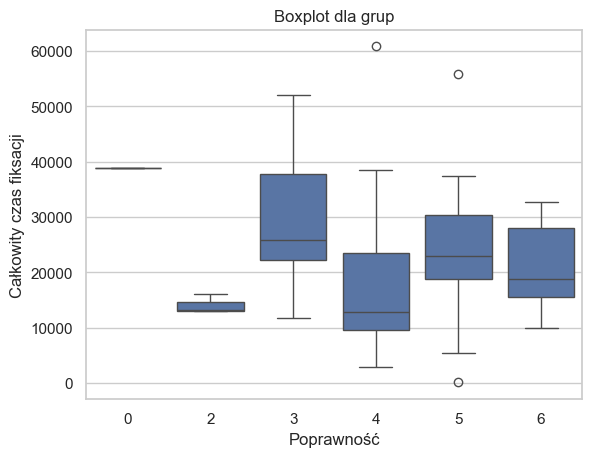

------------------------------
Zsumowane grafiki A: z poleceniem:


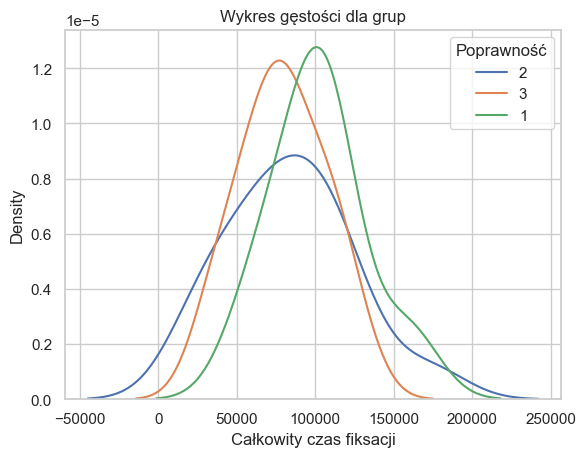

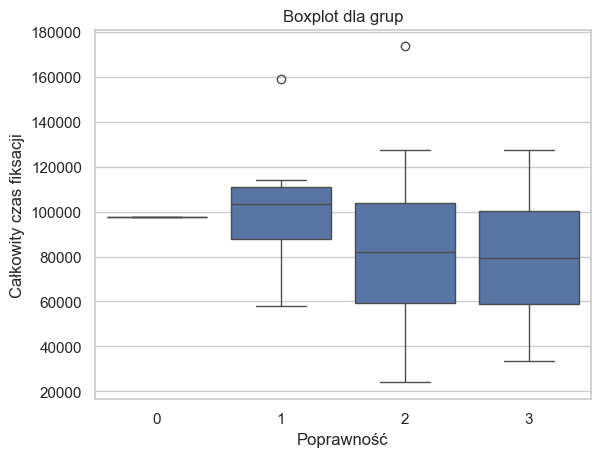

------------------------------
Zsumowane grafiki A: bez polecenia:


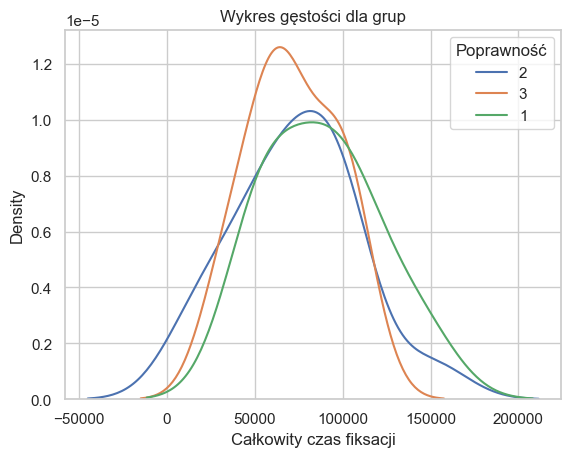

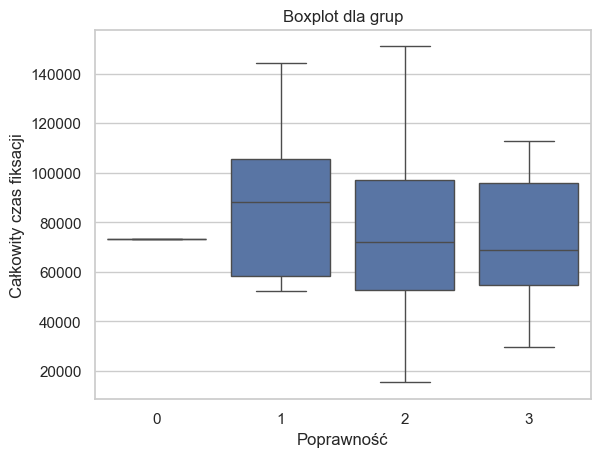

------------------------------
Zsumowane grafiki A: tylko polecenie :


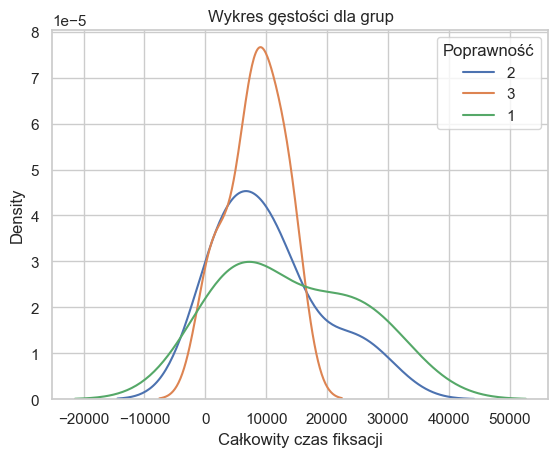

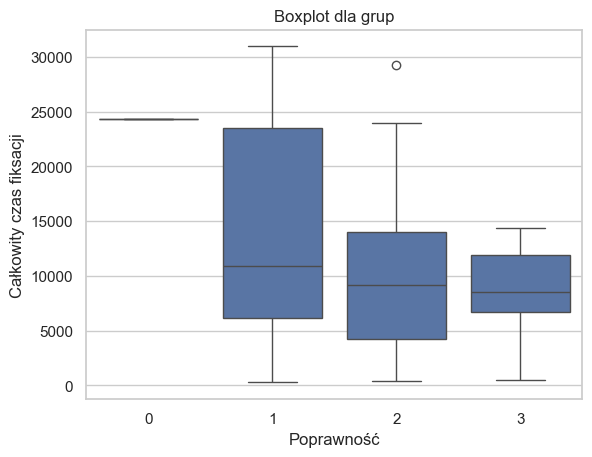

------------------------------
Zsumowane grafiki B: z poleceniem:


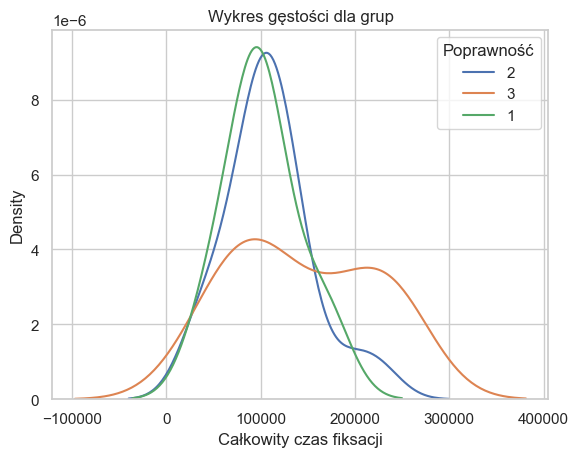

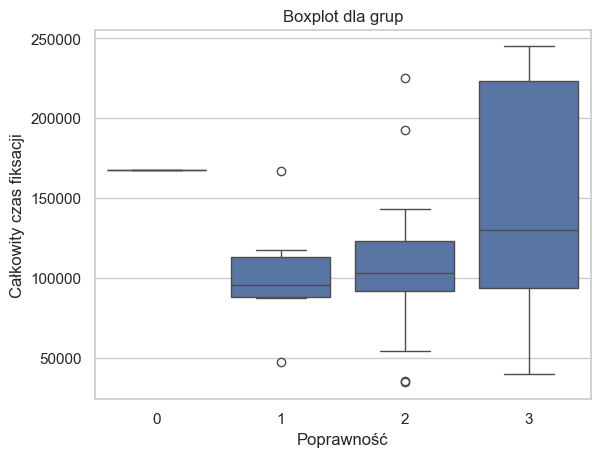

------------------------------
Zsumowane grafiki B: bez polecenia:


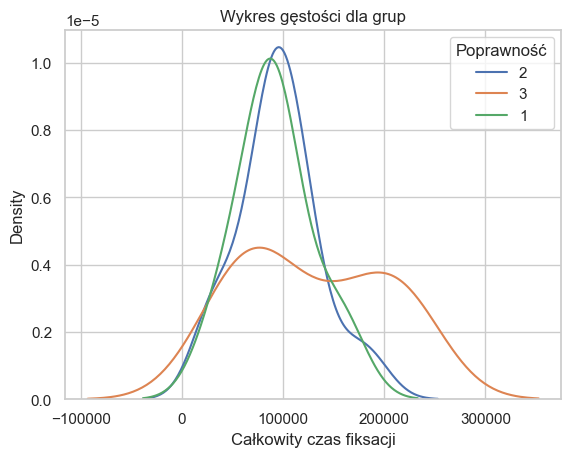

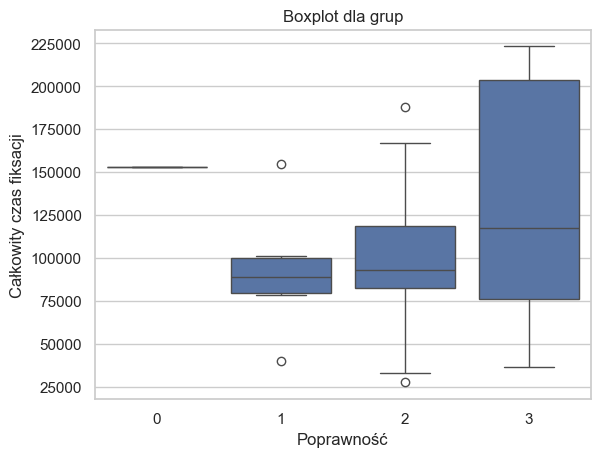

------------------------------
Zsumowane grafiki B: tylko polecenie :


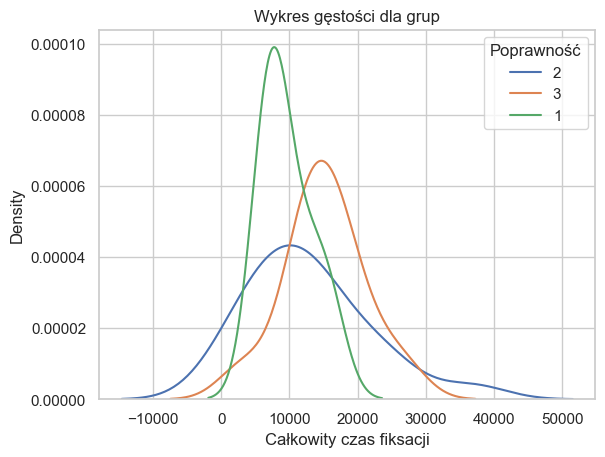

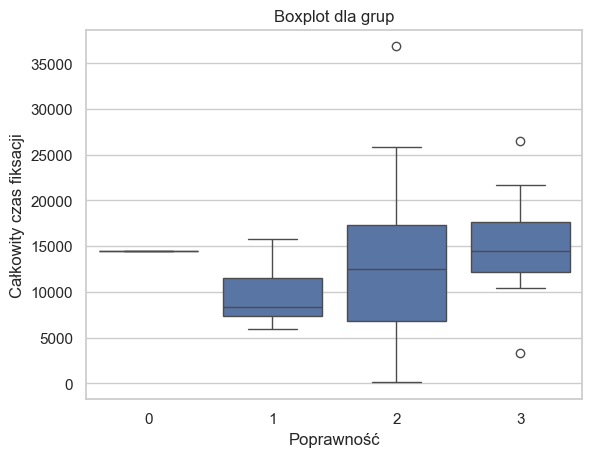

------------------------------
Zsumowane grafiki 1: z poleceniem:


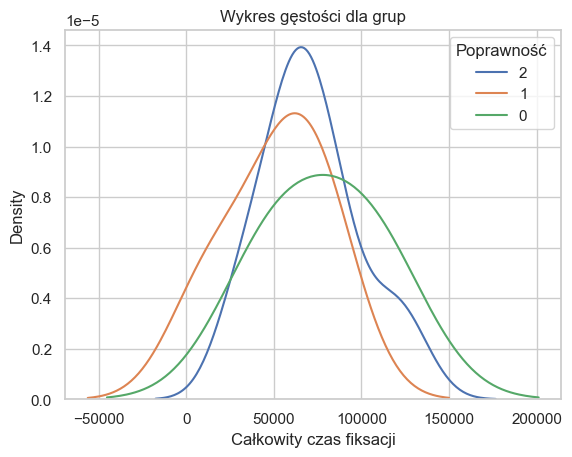

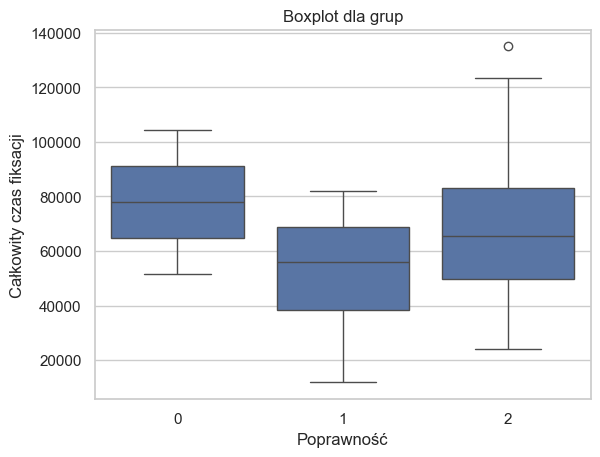

------------------------------
Zsumowane grafiki 1: bez polecenia:


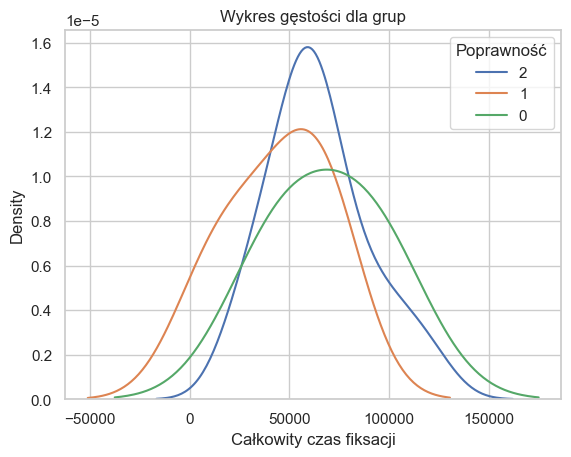

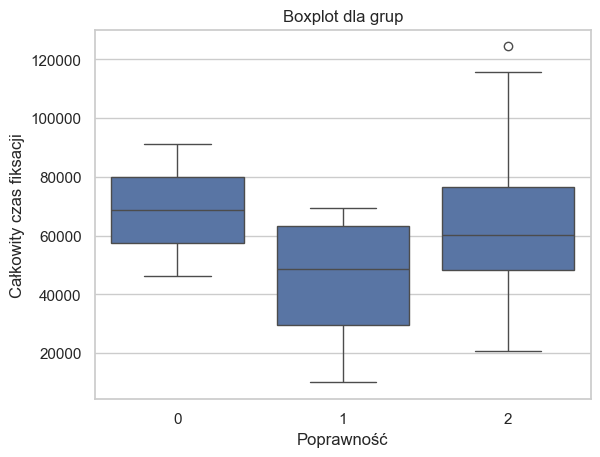

------------------------------
Zsumowane grafiki 1: tylko polecenie :


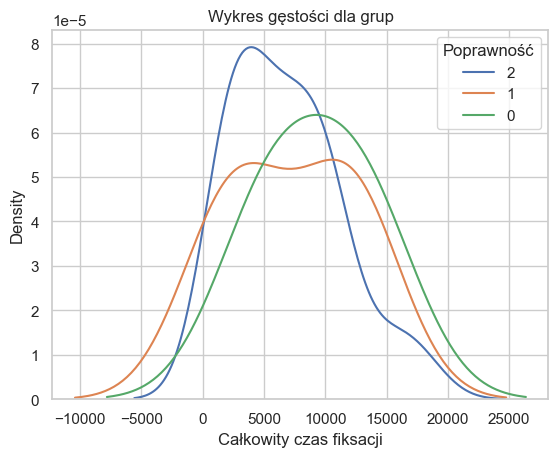

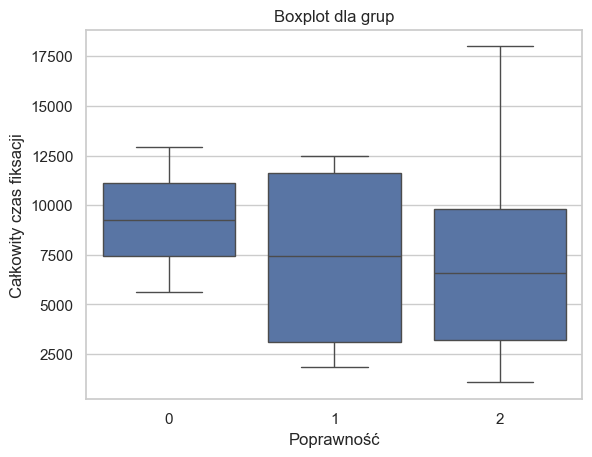

------------------------------
Zsumowane grafiki 2: z poleceniem:


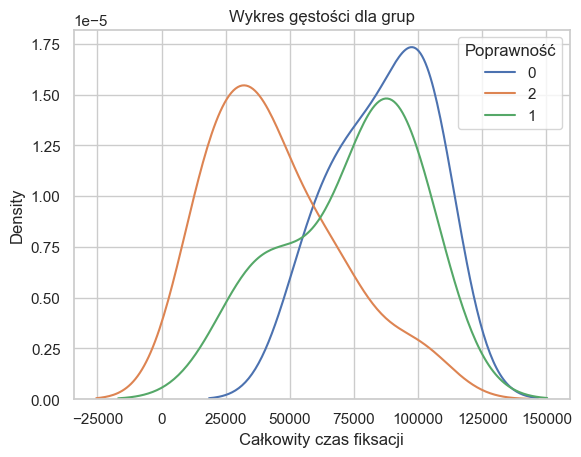

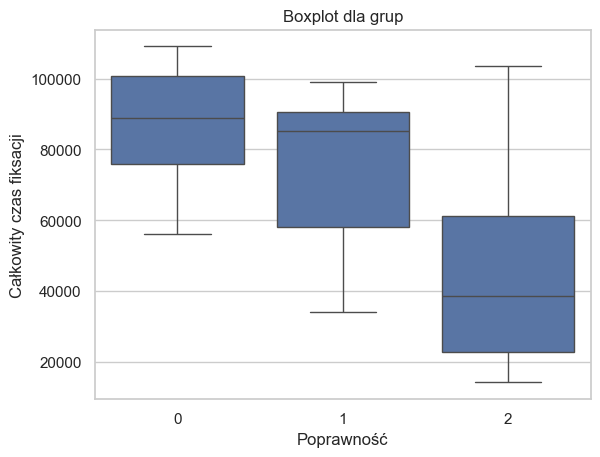

------------------------------
Zsumowane grafiki 2: bez polecenia:


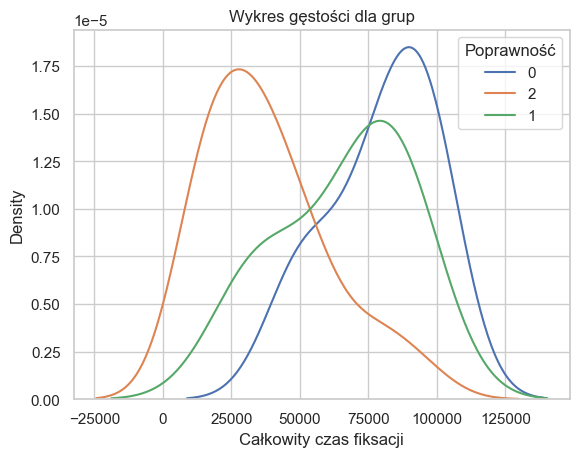

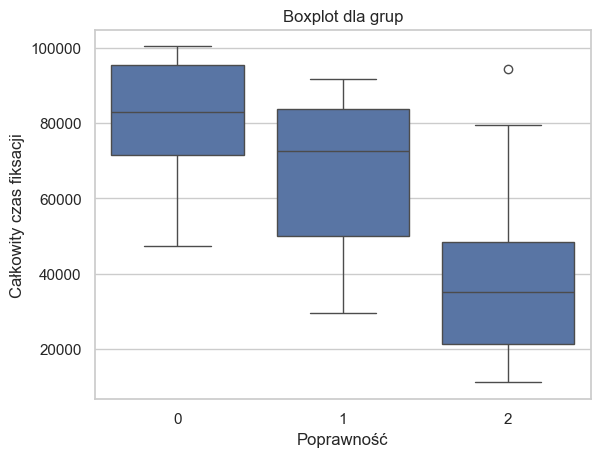

------------------------------
Zsumowane grafiki 2: tylko polecenie :


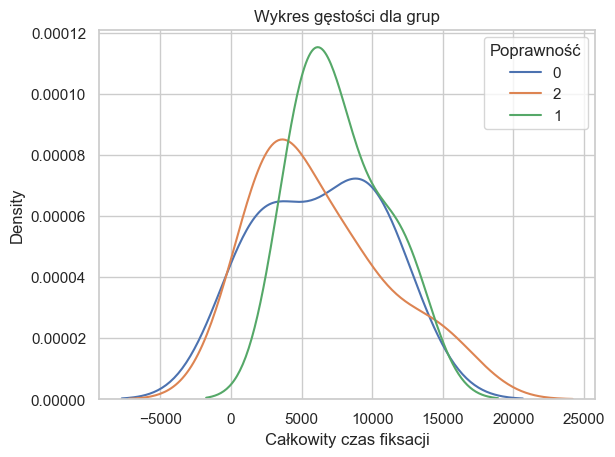

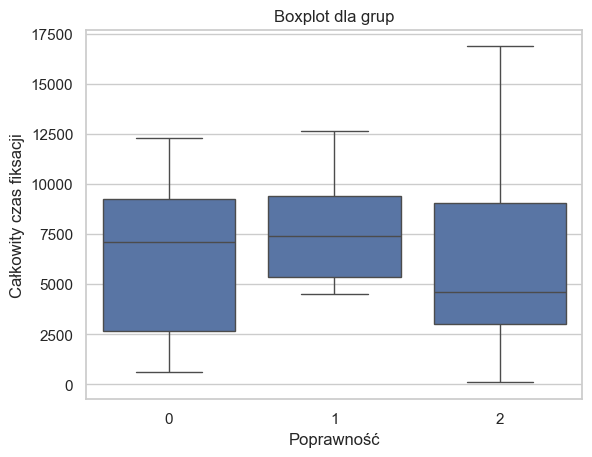

------------------------------
Zsumowane grafiki 3: z poleceniem:


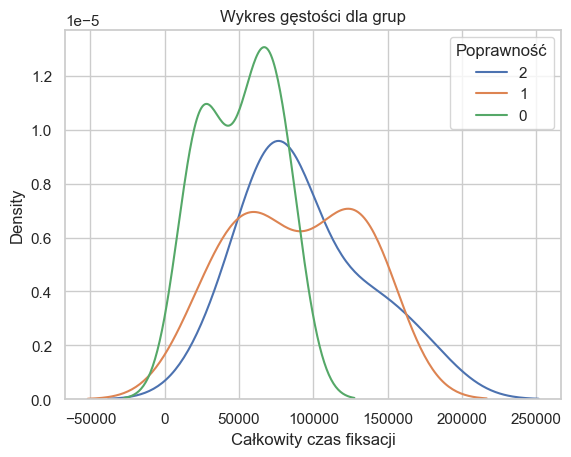

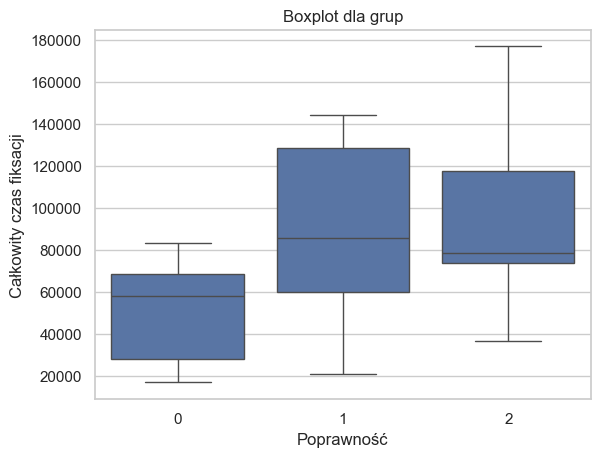

------------------------------
Zsumowane grafiki 3: bez polecenia:


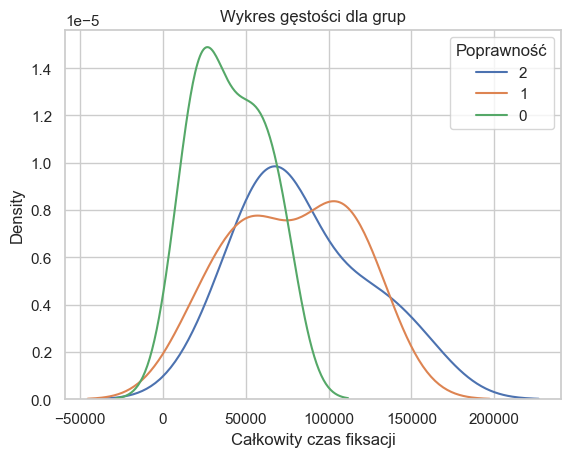

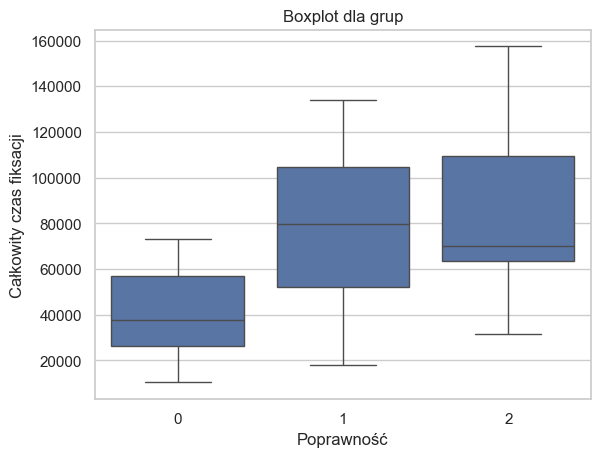

------------------------------
Zsumowane grafiki 3: tylko polecenie :


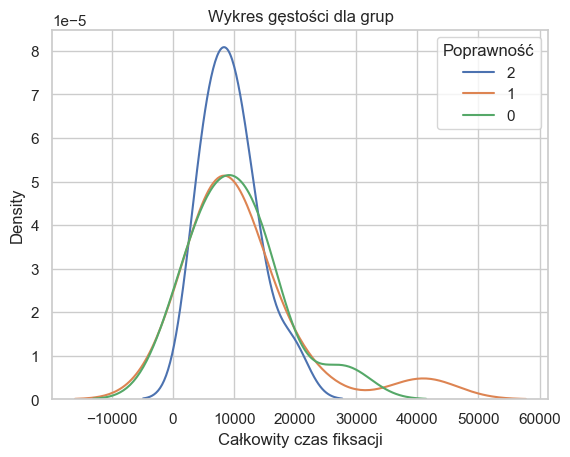

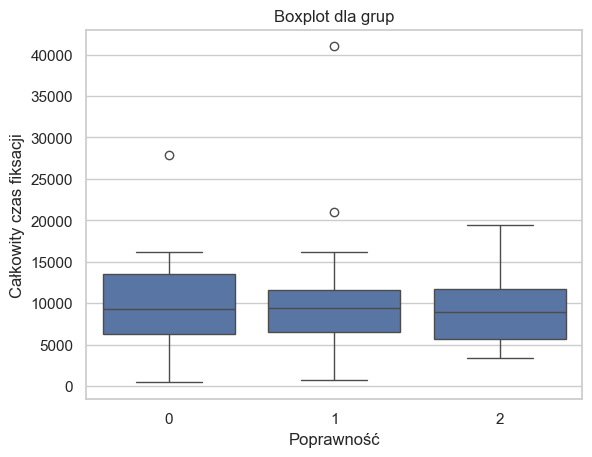

##########################################
Avg
------------------------------
Zsumowane wszystkie grafiki: z poleceniem:


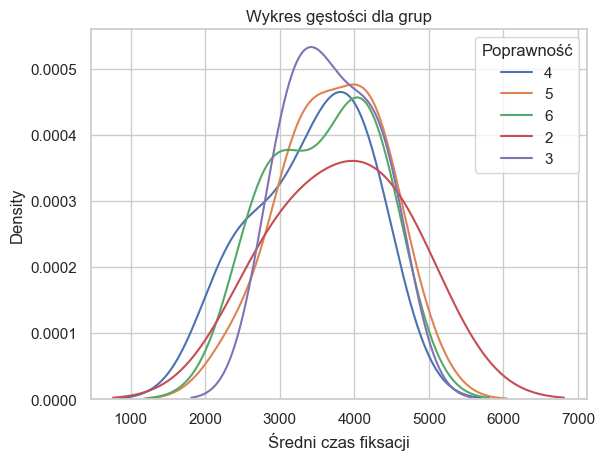

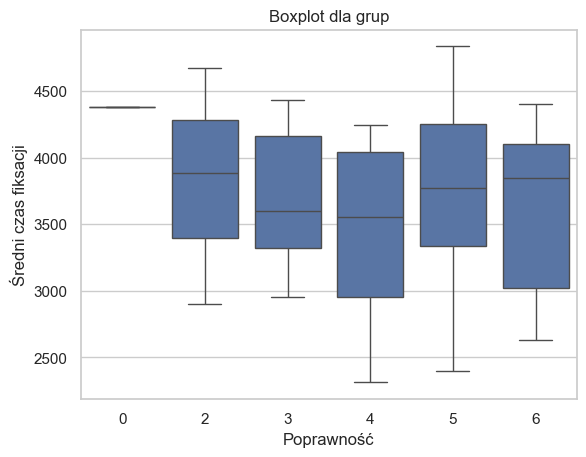

------------------------------
Zsumowane wszystkie grafiki: bez polecenia:


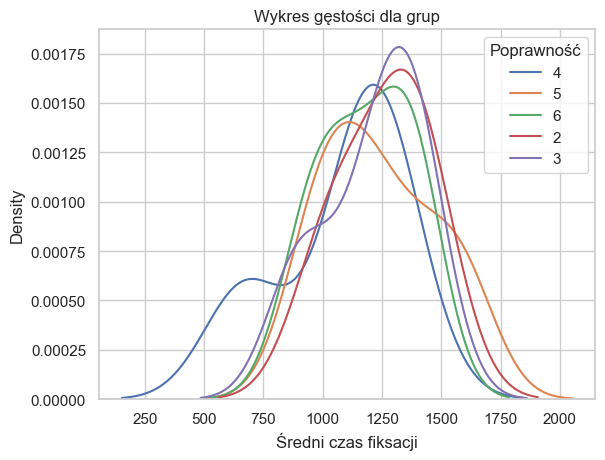

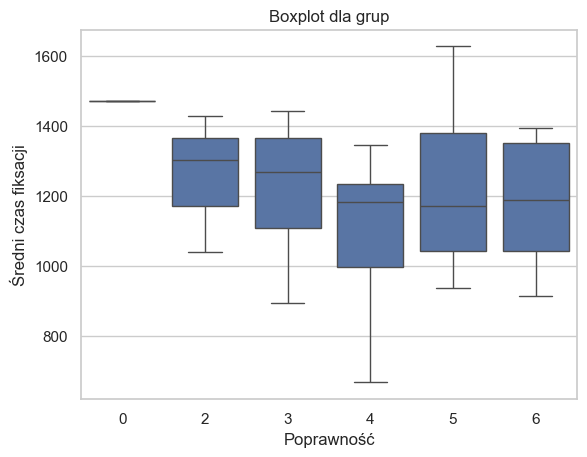

------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :


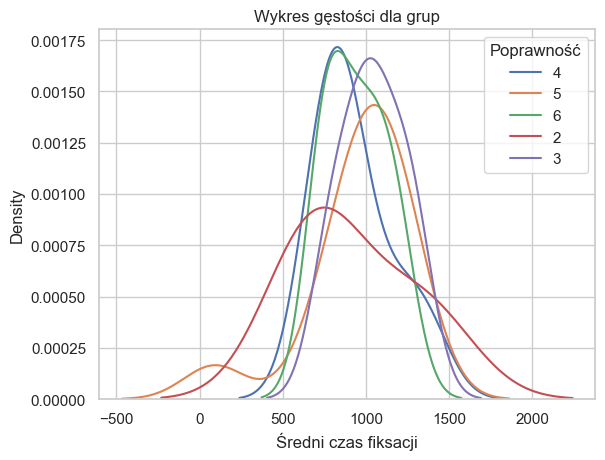

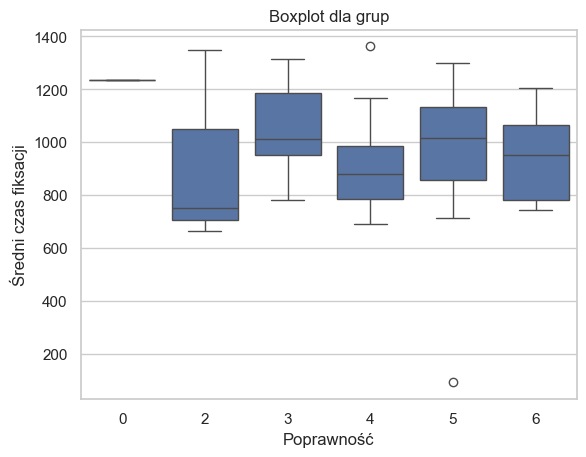

------------------------------
Zsumowane grafiki A: z poleceniem:


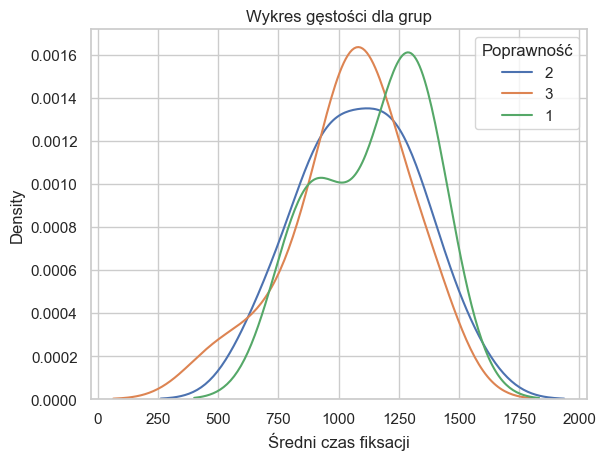

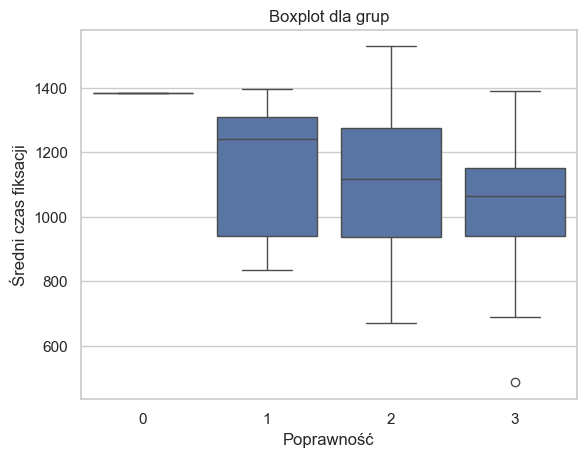

------------------------------
Zsumowane grafiki A: bez polecenia:


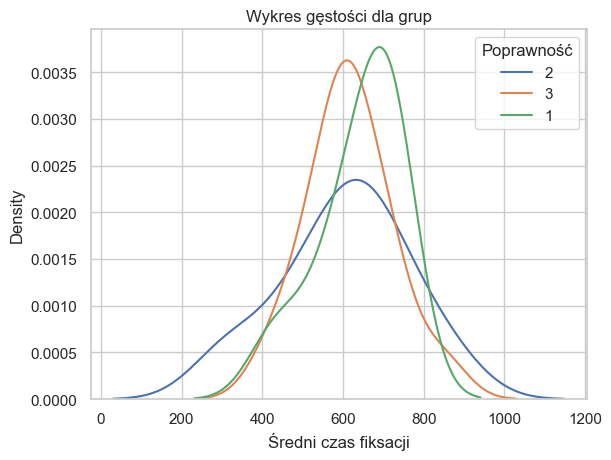

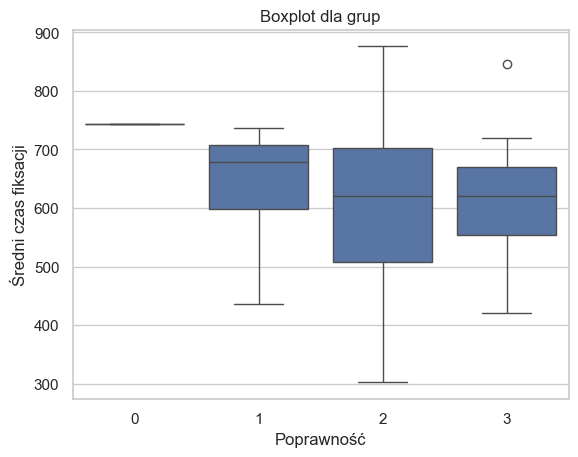

------------------------------
Zsumowane grafiki A: tylko polecenie :


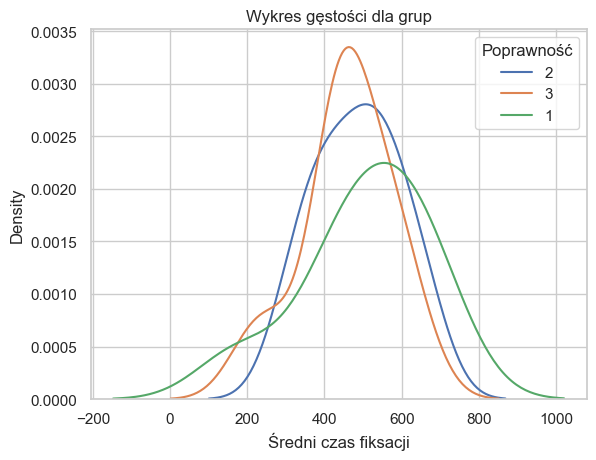

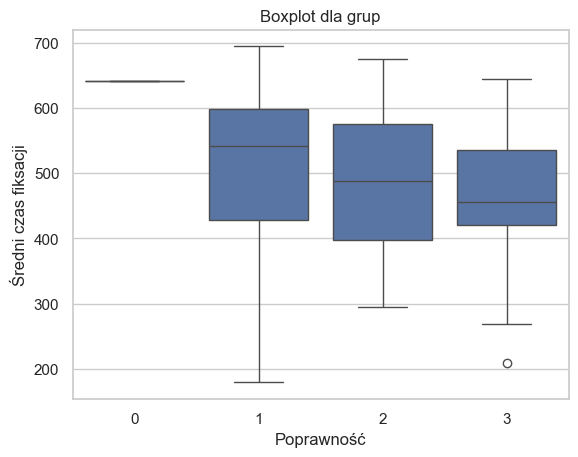

------------------------------
Zsumowane grafiki B: z poleceniem:


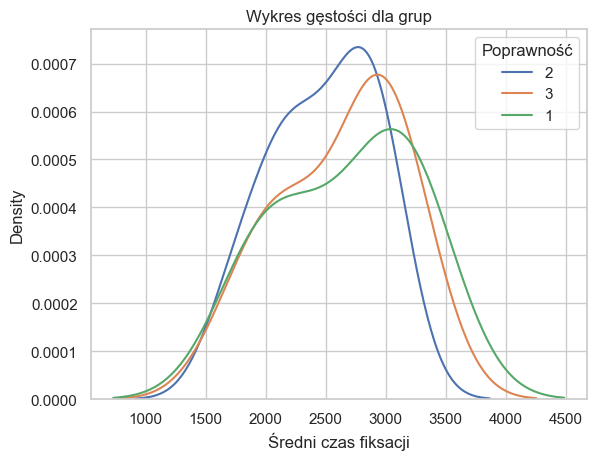

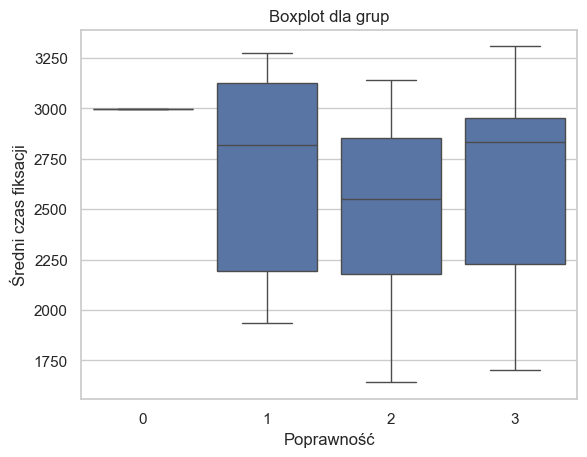

------------------------------
Zsumowane grafiki B: bez polecenia:


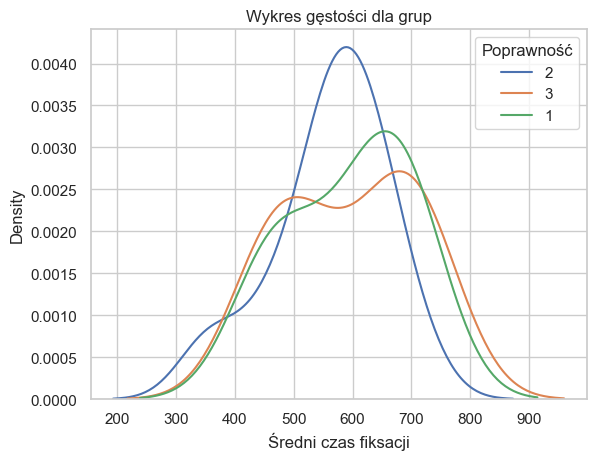

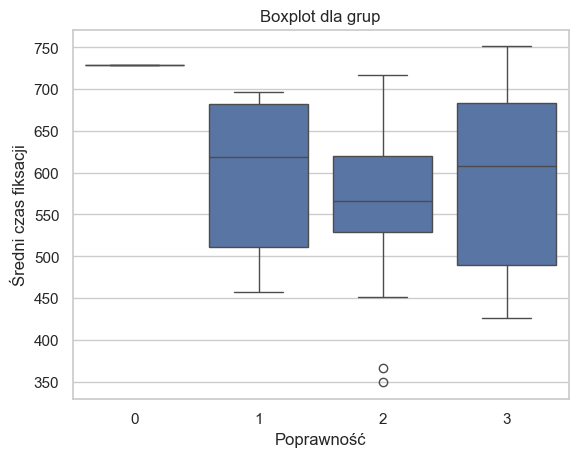

------------------------------
Zsumowane grafiki B: tylko polecenie :


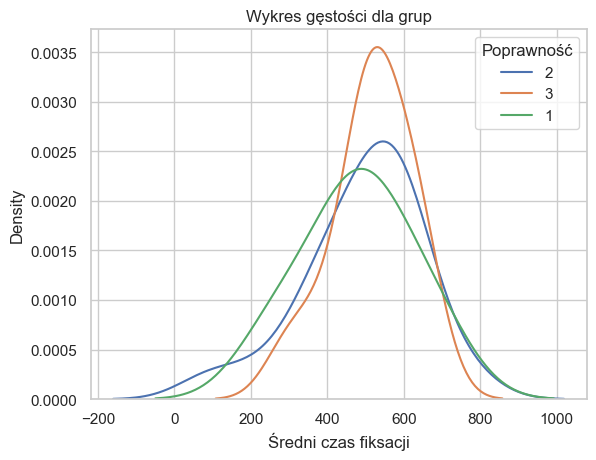

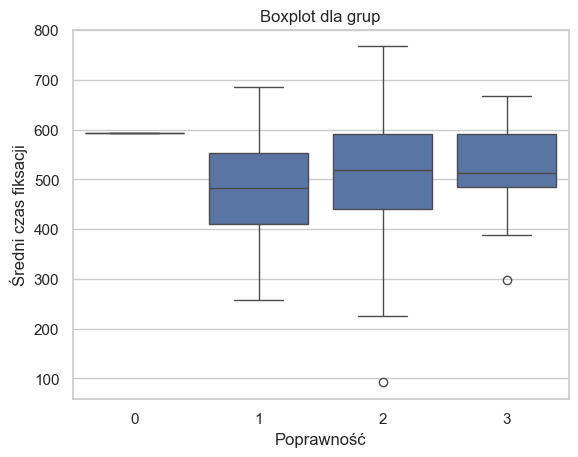

------------------------------
Zsumowane grafiki 1: z poleceniem:


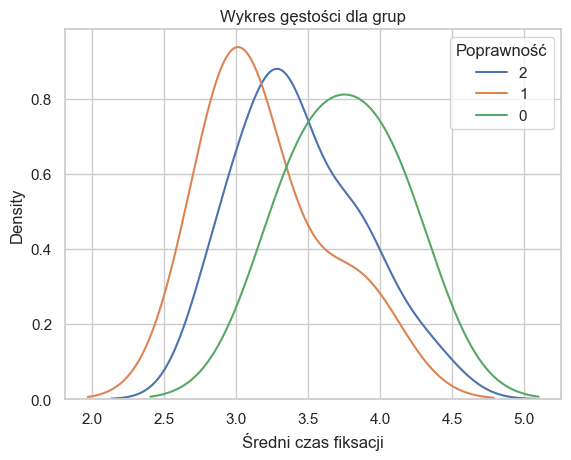

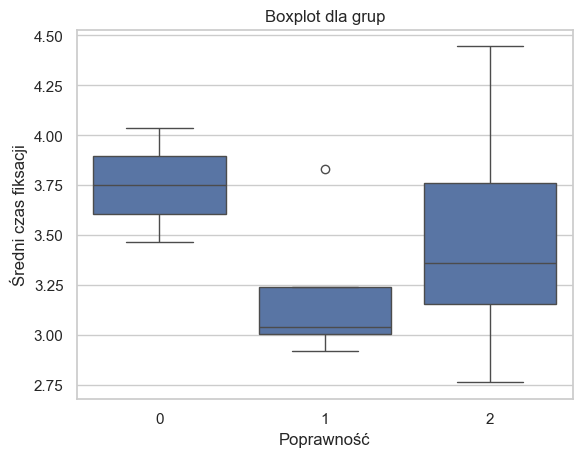

------------------------------
Zsumowane grafiki 1: bez polecenia:


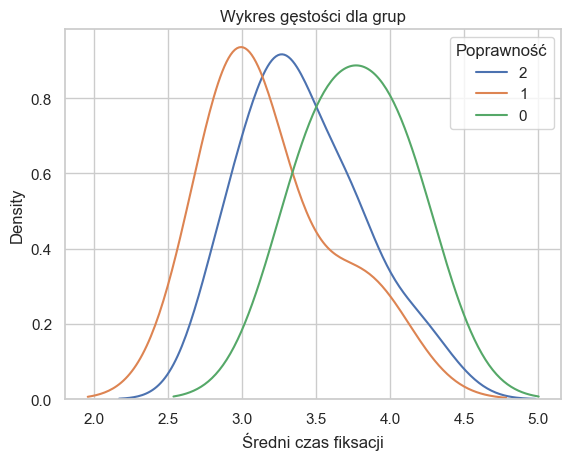

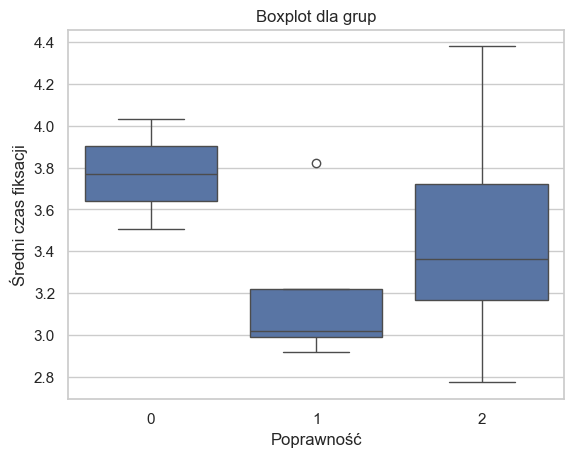

------------------------------
Zsumowane grafiki 1: tylko polecenie :


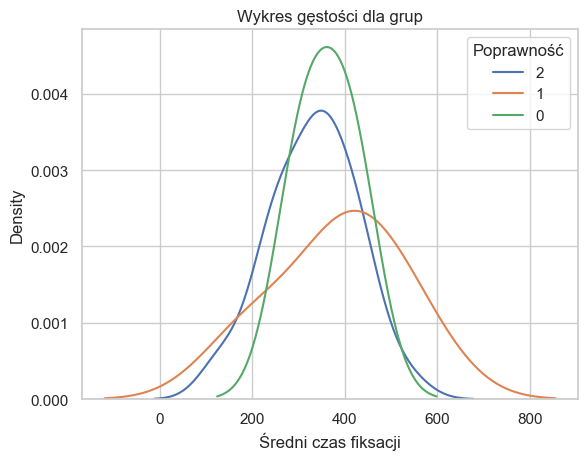

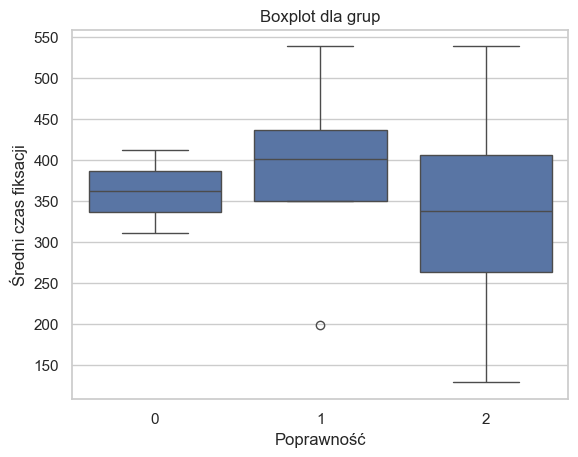

------------------------------
Zsumowane grafiki 2: z poleceniem:


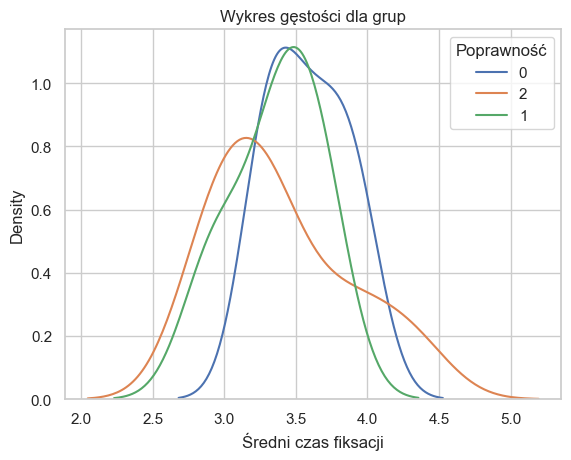

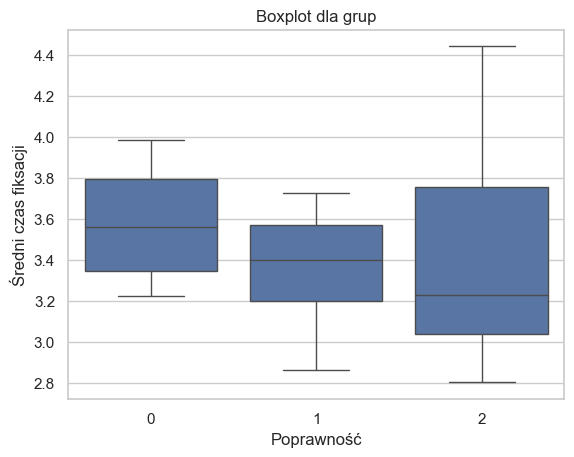

------------------------------
Zsumowane grafiki 2: bez polecenia:


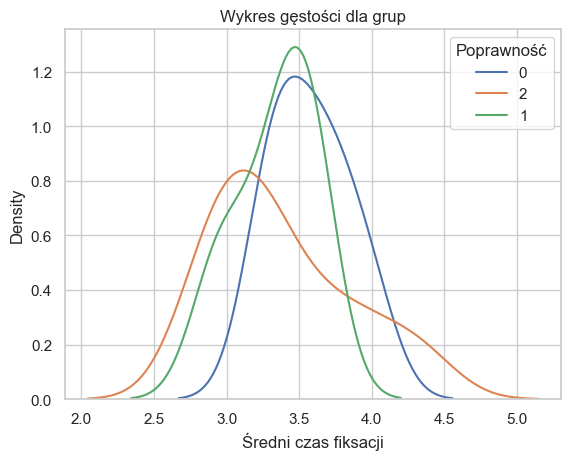

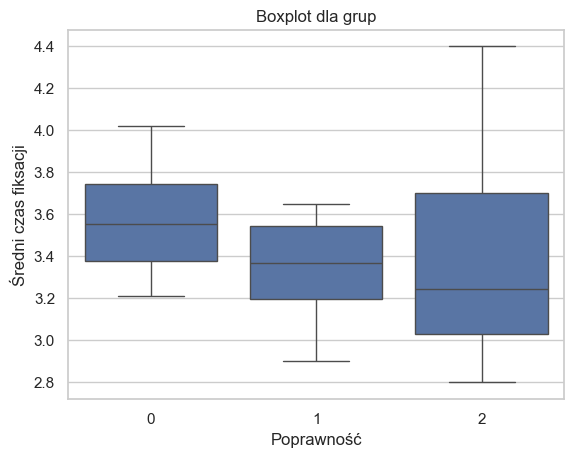

------------------------------
Zsumowane grafiki 2: tylko polecenie :


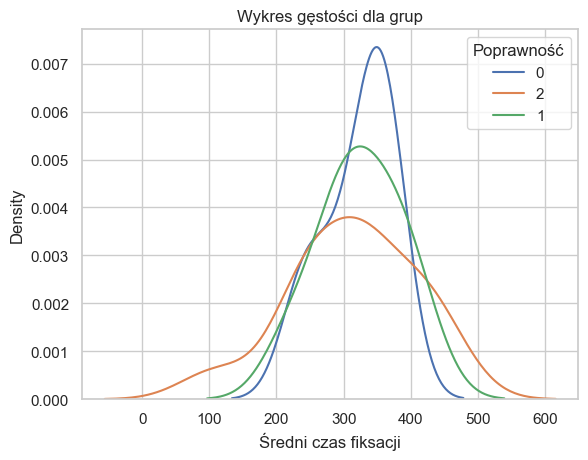

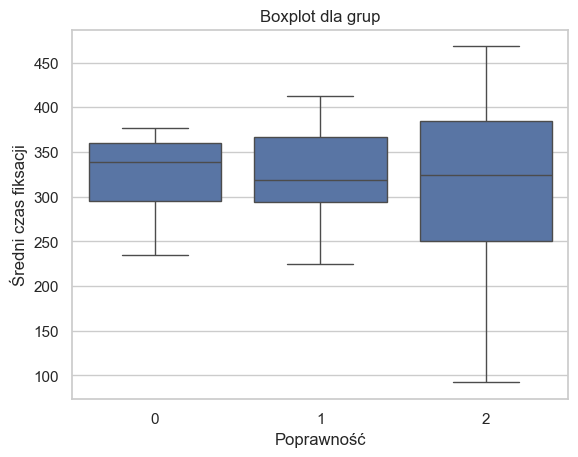

------------------------------
Zsumowane grafiki 3: z poleceniem:


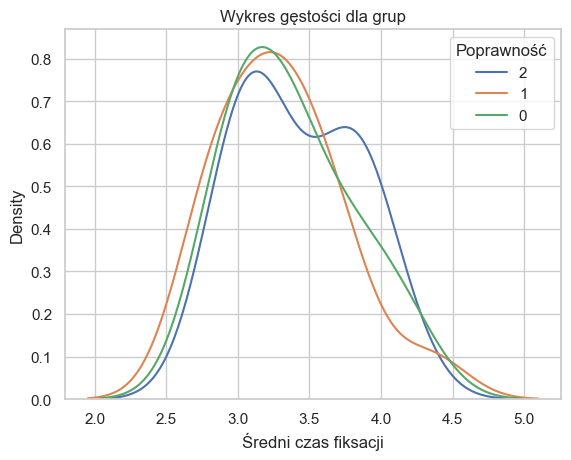

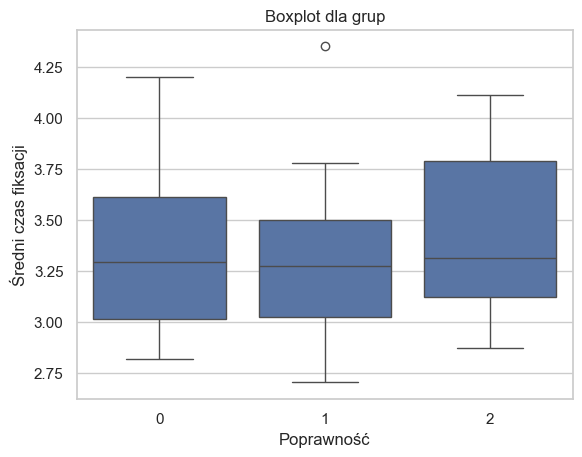

------------------------------
Zsumowane grafiki 3: bez polecenia:


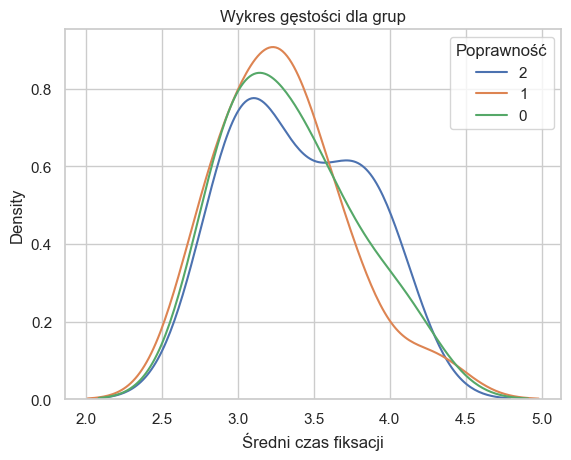

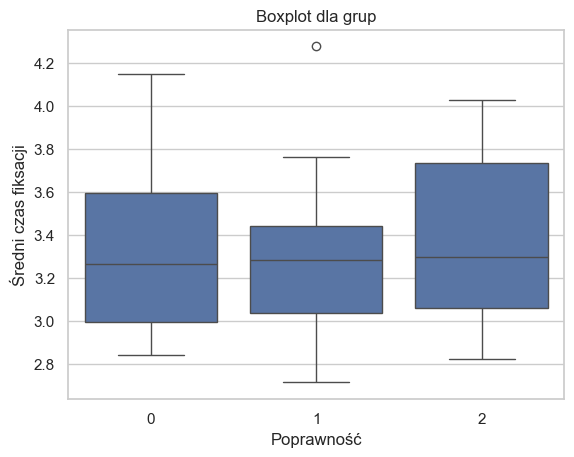

------------------------------
Zsumowane grafiki 3: tylko polecenie :


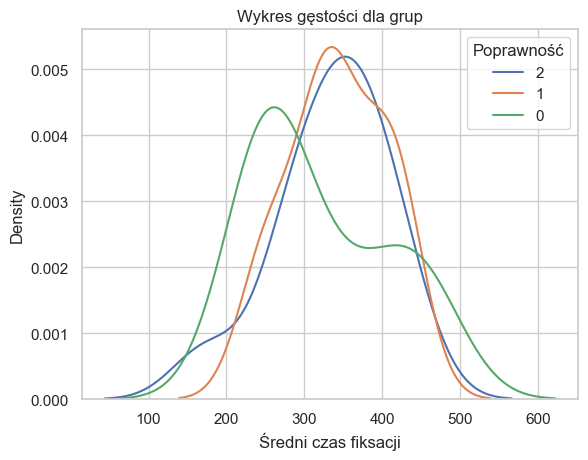

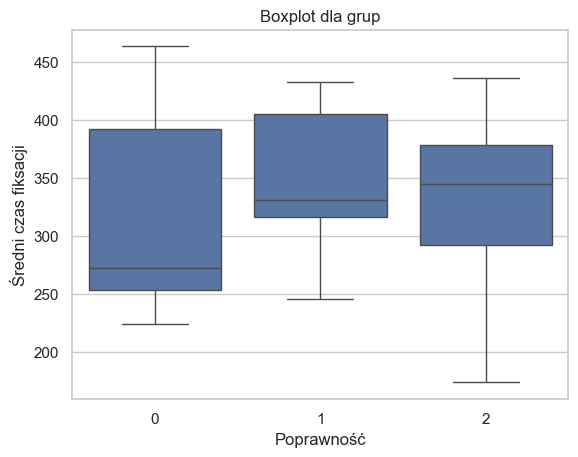

##########################################
Avg_pupil
------------------------------
Zsumowane wszystkie grafiki: z poleceniem:


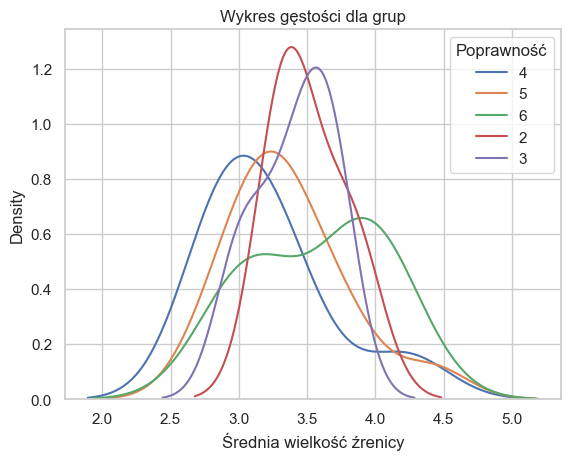

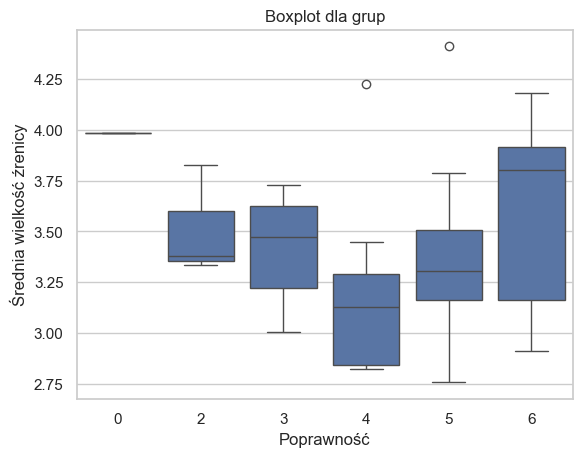

------------------------------
Zsumowane wszystkie grafiki: bez polecenia:


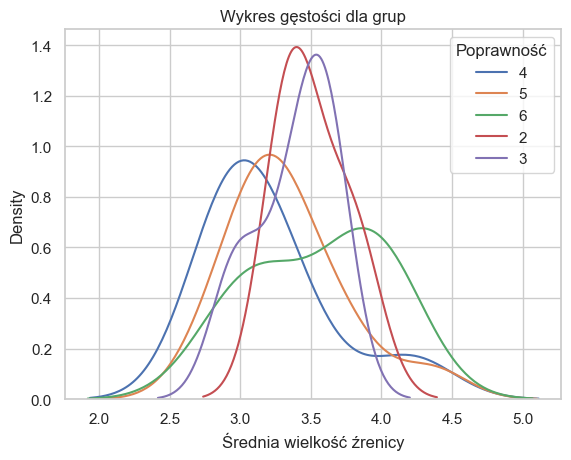

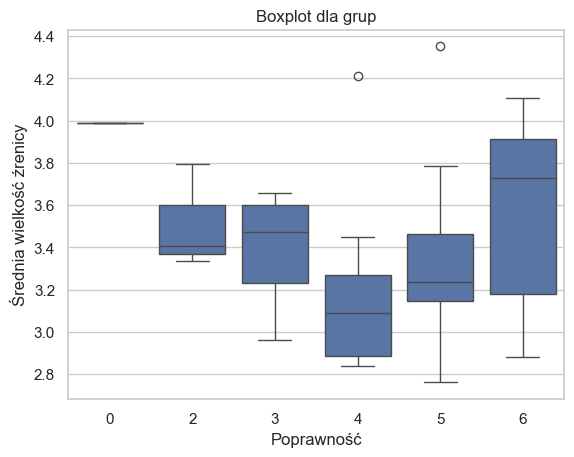

------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :


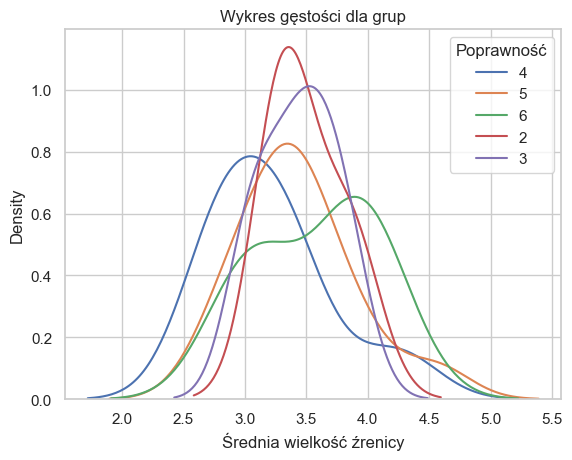

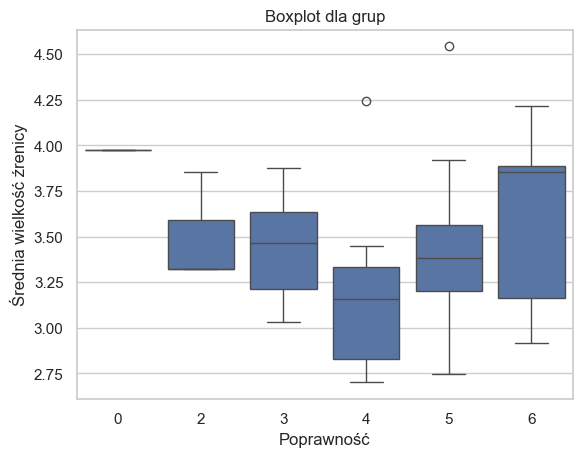

------------------------------
Zsumowane grafiki A: z poleceniem:


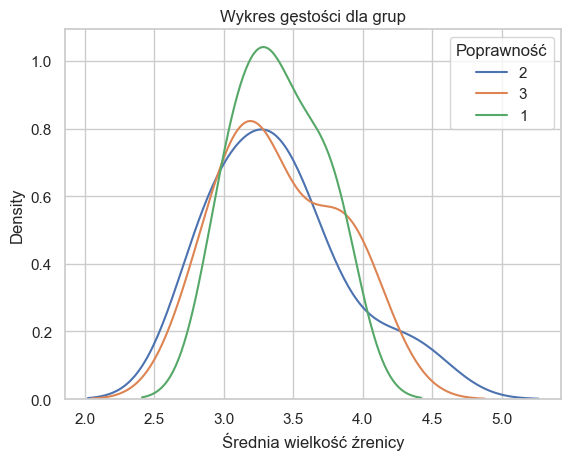

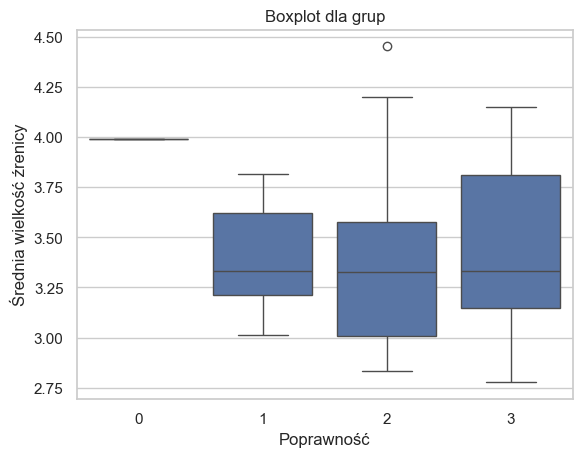

------------------------------
Zsumowane grafiki A: bez polecenia:


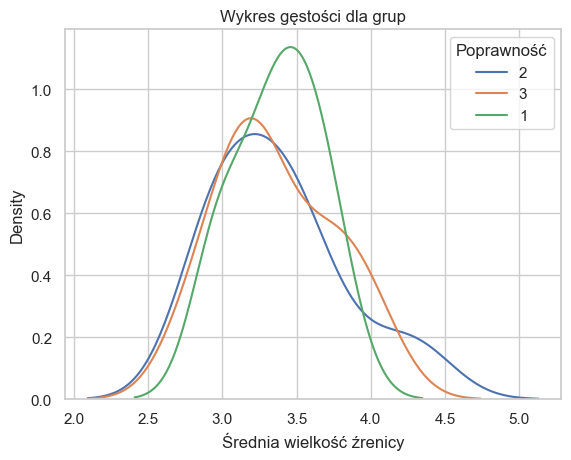

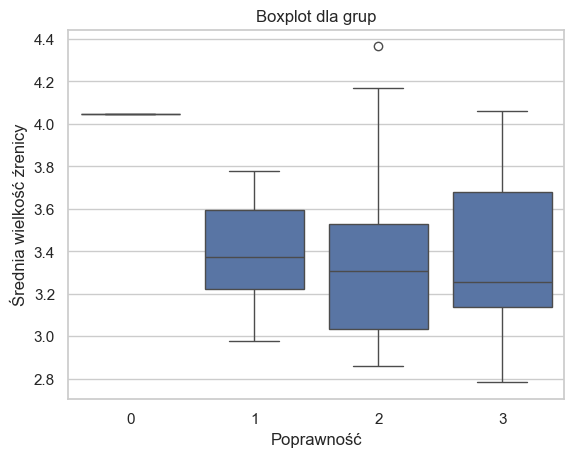

------------------------------
Zsumowane grafiki A: tylko polecenie :


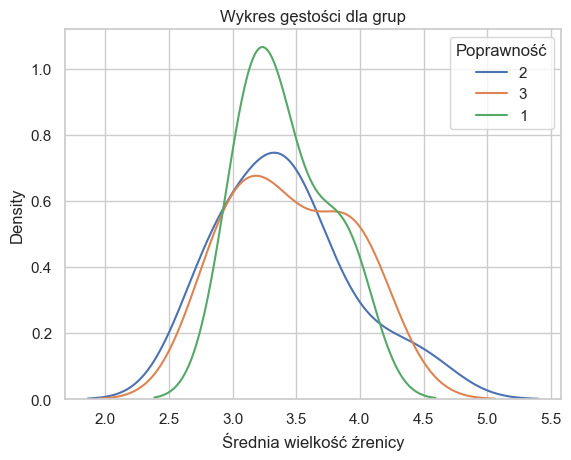

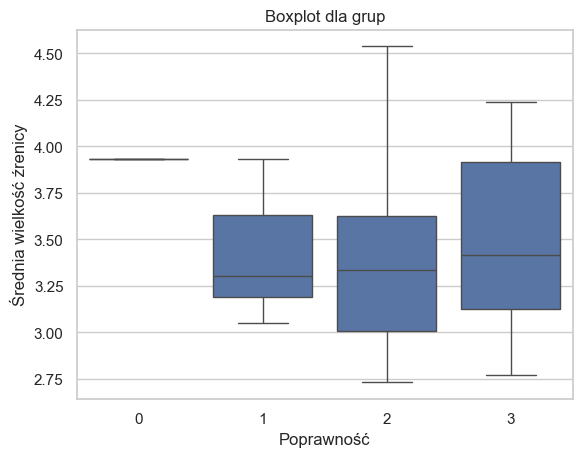

------------------------------
Zsumowane grafiki B: z poleceniem:


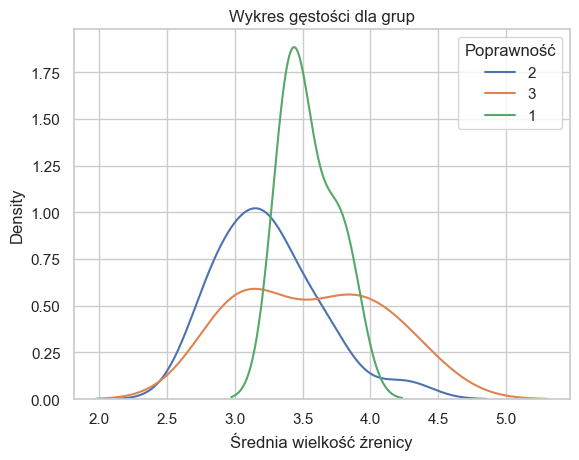

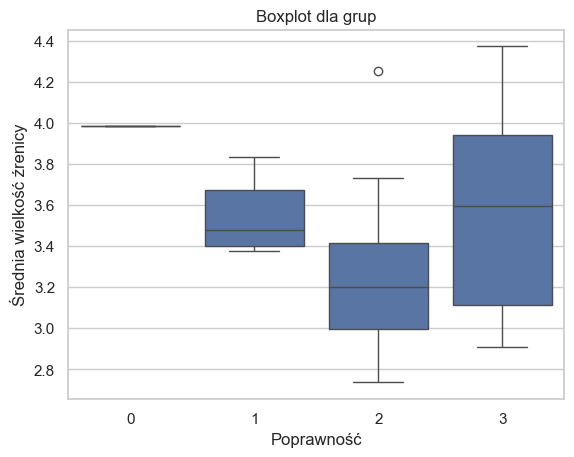

------------------------------
Zsumowane grafiki B: bez polecenia:


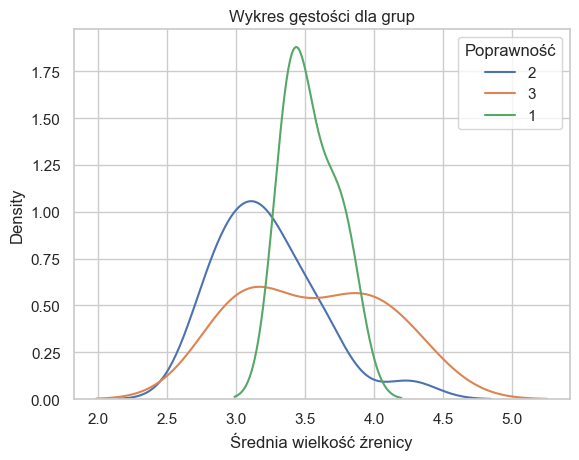

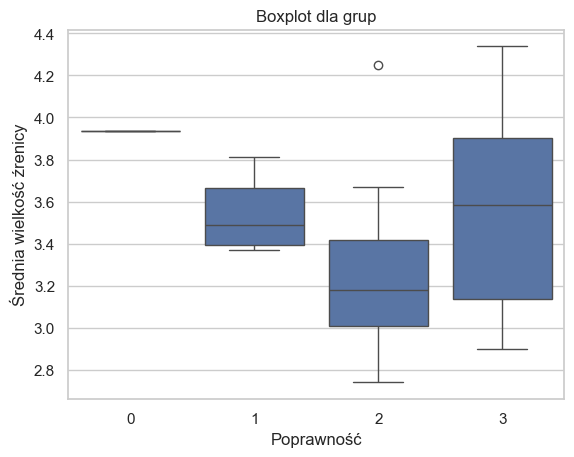

------------------------------
Zsumowane grafiki B: tylko polecenie :


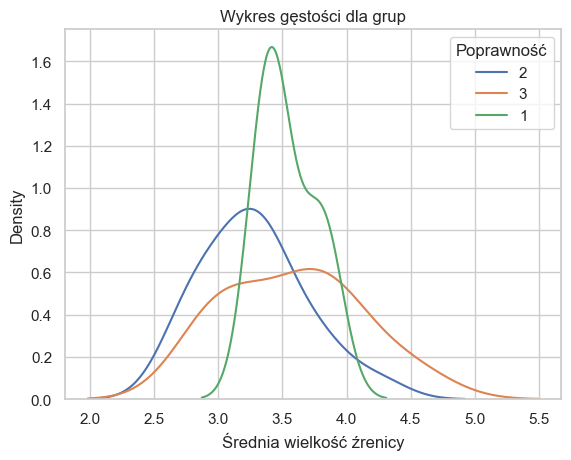

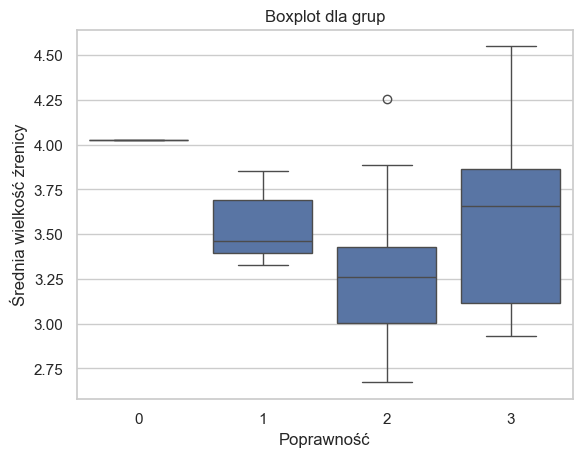

------------------------------
Zsumowane grafiki 1: z poleceniem:


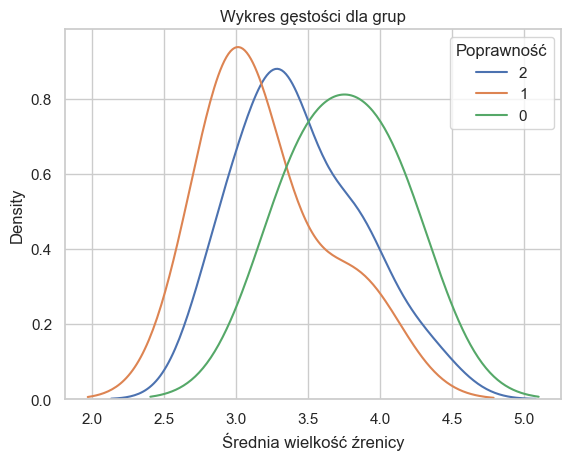

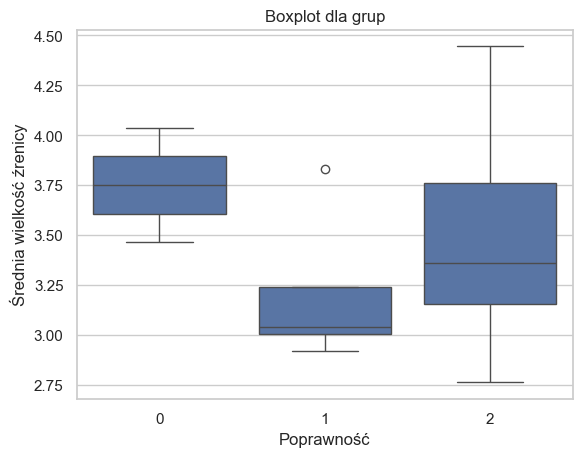

------------------------------
Zsumowane grafiki 1: bez polecenia:


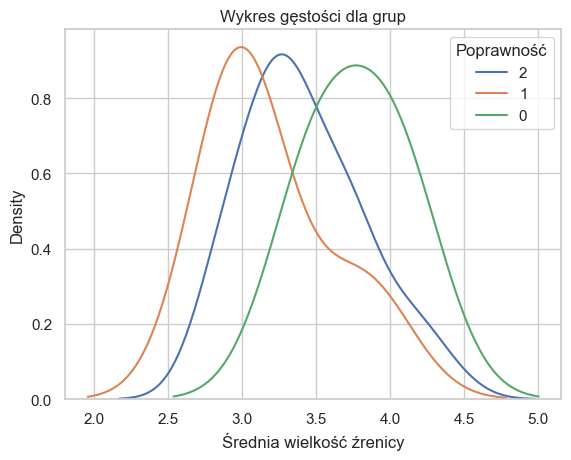

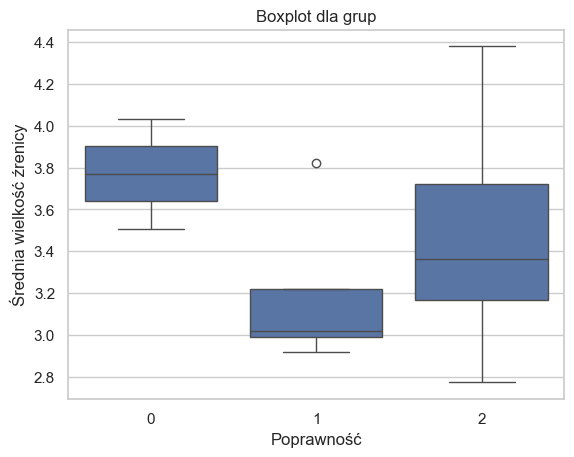

------------------------------
Zsumowane grafiki 1: tylko polecenie :


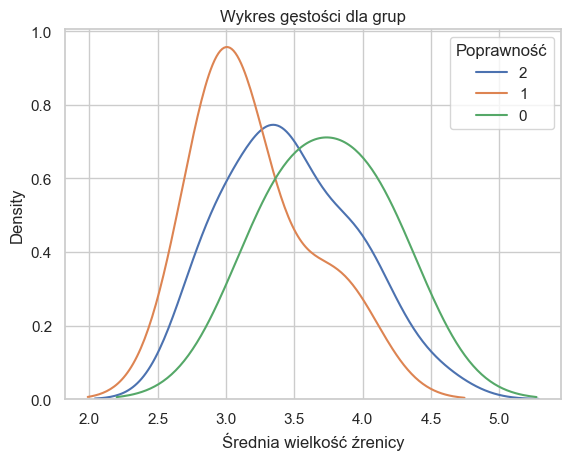

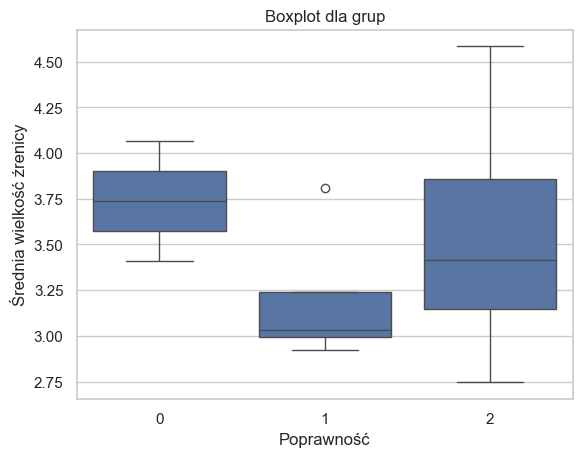

------------------------------
Zsumowane grafiki 2: z poleceniem:


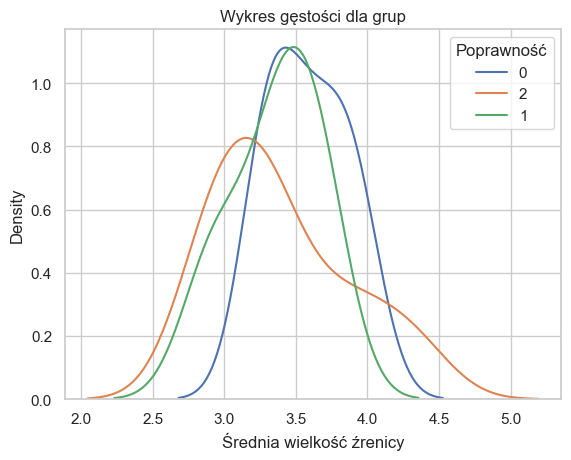

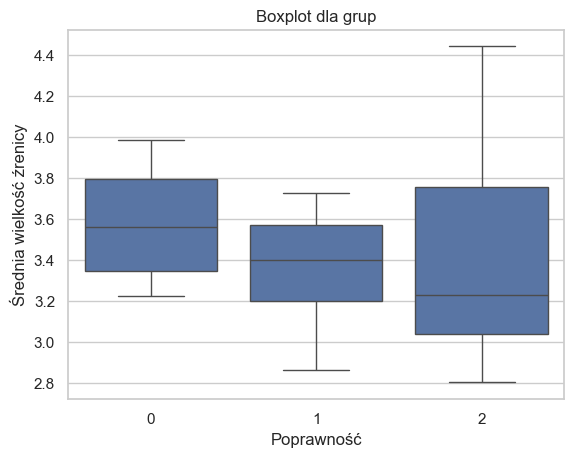

------------------------------
Zsumowane grafiki 2: bez polecenia:


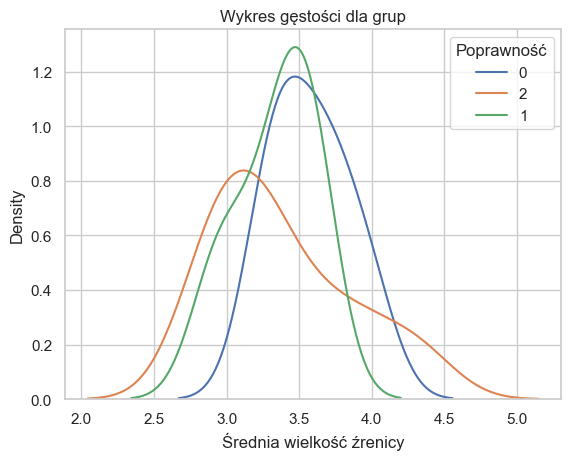

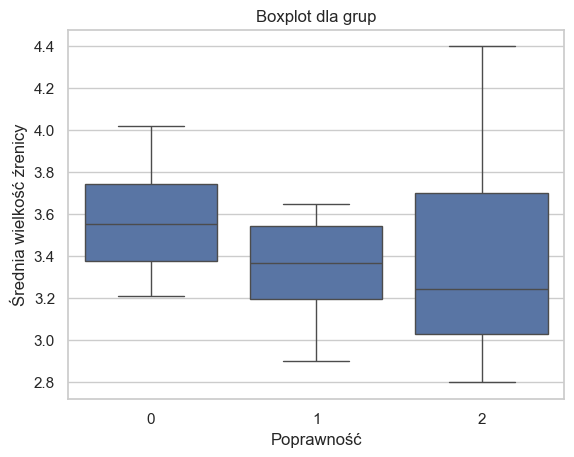

------------------------------
Zsumowane grafiki 2: tylko polecenie :


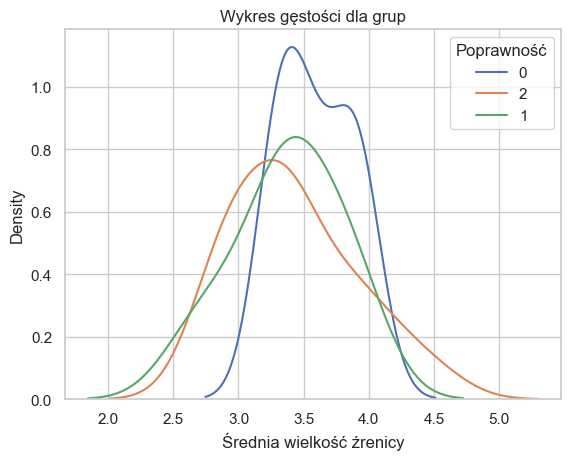

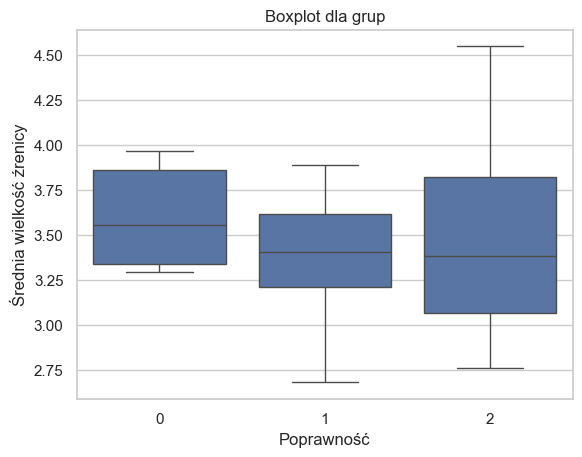

------------------------------
Zsumowane grafiki 3: z poleceniem:


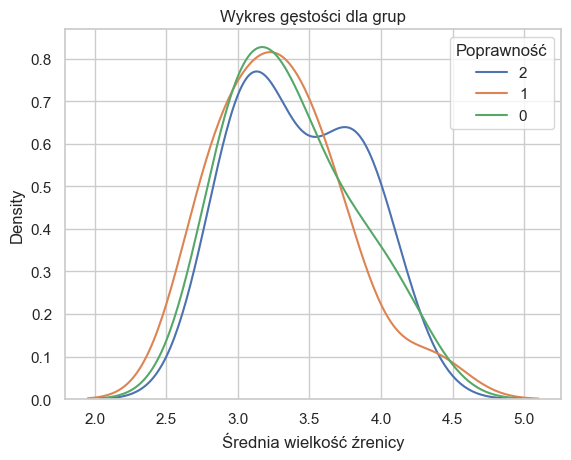

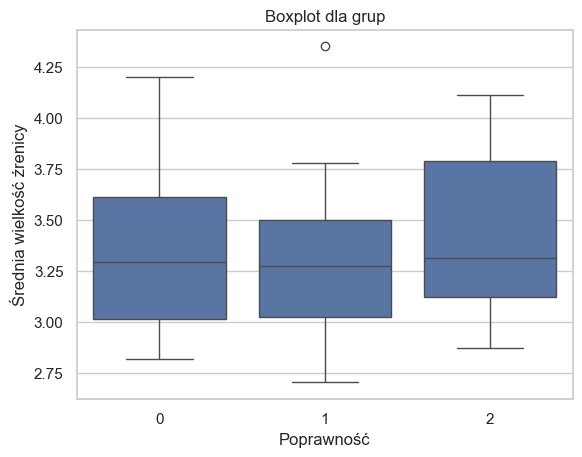

------------------------------
Zsumowane grafiki 3: bez polecenia:


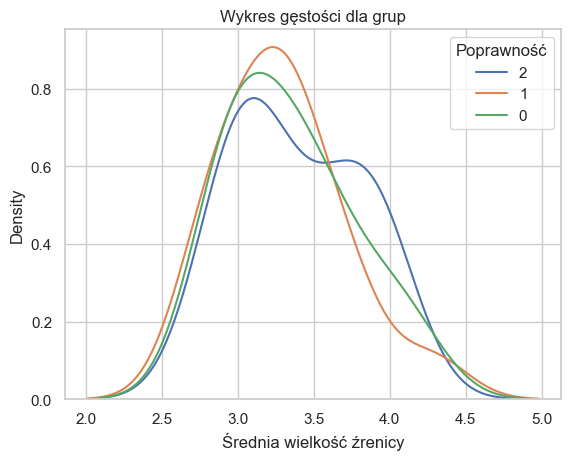

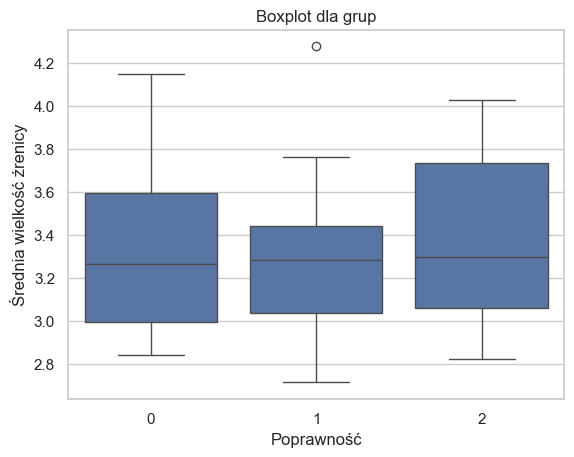

------------------------------
Zsumowane grafiki 3: tylko polecenie :


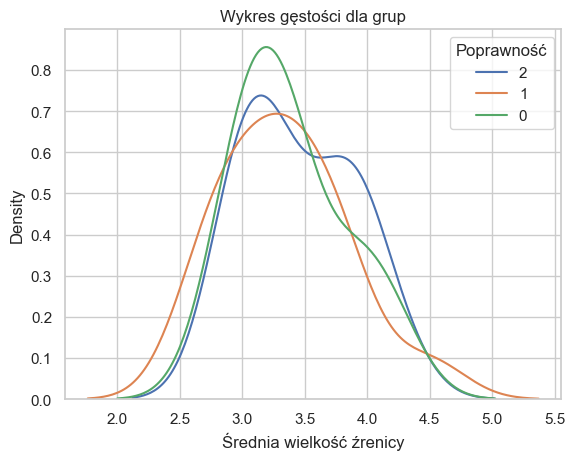

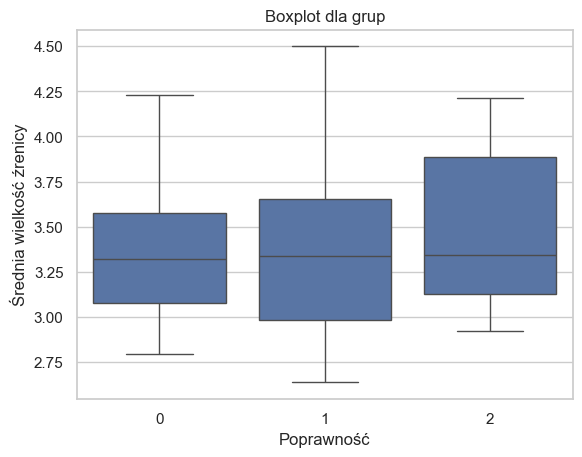

In [56]:
# sumy grafik
param_category = 'Corr'
for col in cols_continue:
    print('##########################################')
    print(col)
    for i, df in enumerate(dfs_sum):
        print('------------------------------')
        print(names_sum[i + 1])
        df = df.dropna()
        plot_multi_density(df, col, param_category, cols_continue[col], 'Poprawność')
        plot_multi_boxplot(df, param_category, col, 'Poprawność', cols_continue[col])

------------------------------
Kolekcja wszystkie grafiki: z poleceniem:


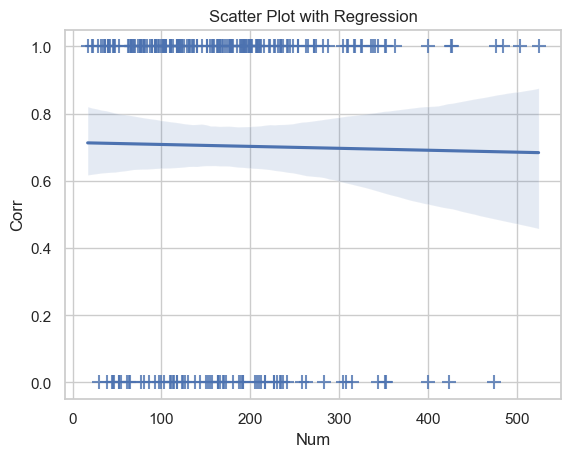

------------------------------
Kolekcja wszystkie grafiki: bez polecenia:


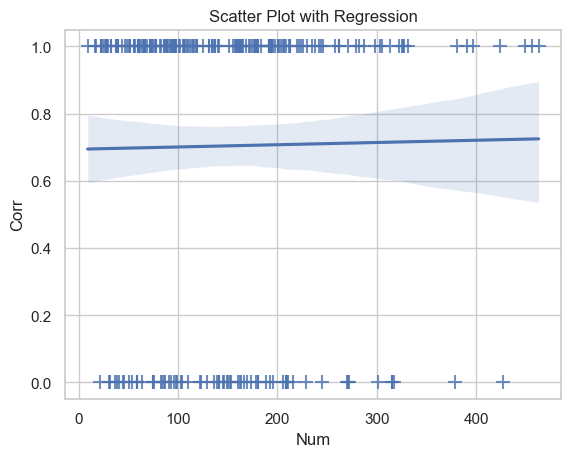

------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:


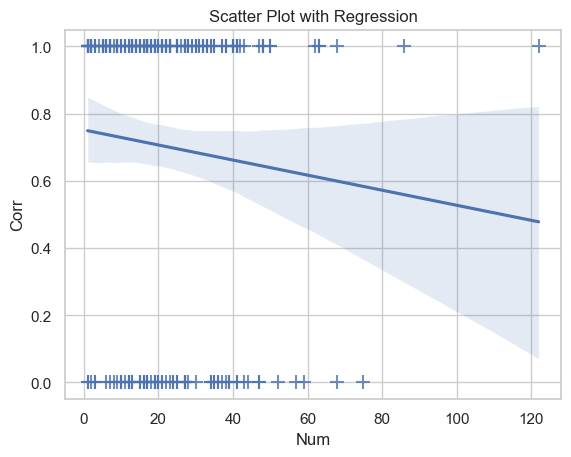

------------------------------
Kolekcja grafiki A: z poleceniem:


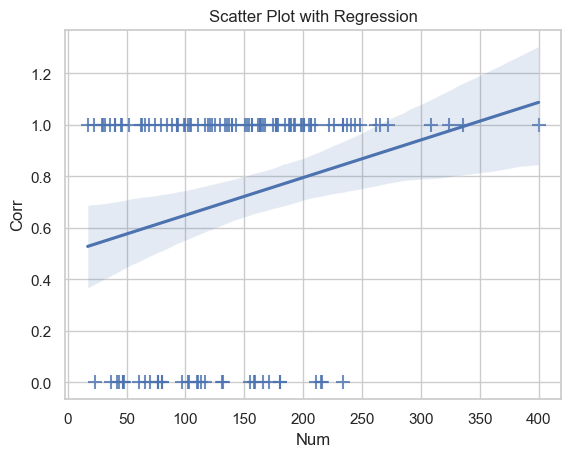

------------------------------
Kolekcja grafiki A: bez polecenia:


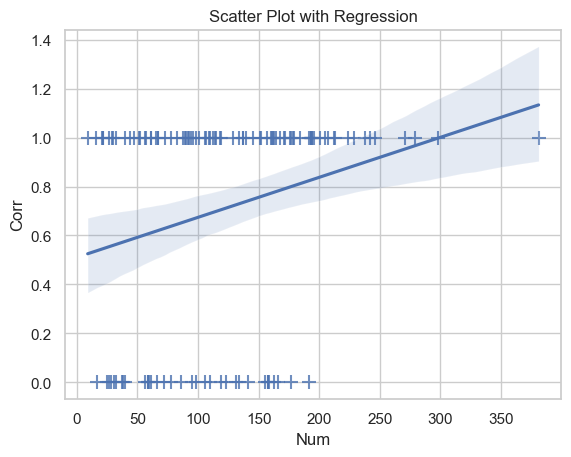

------------------------------
Kolekcja grafiki A: tylko polecenie:


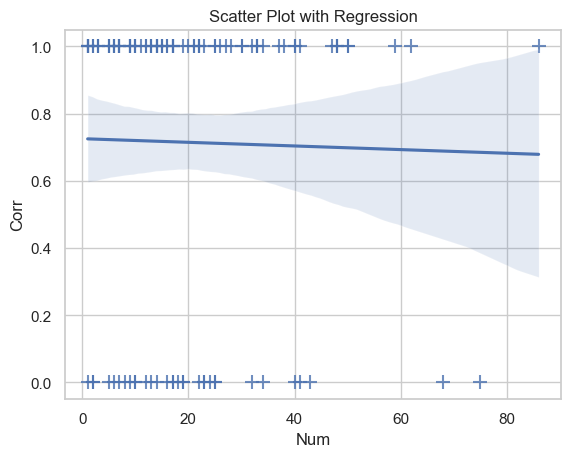

------------------------------
Kolekcja grafiki B: z poleceniem:


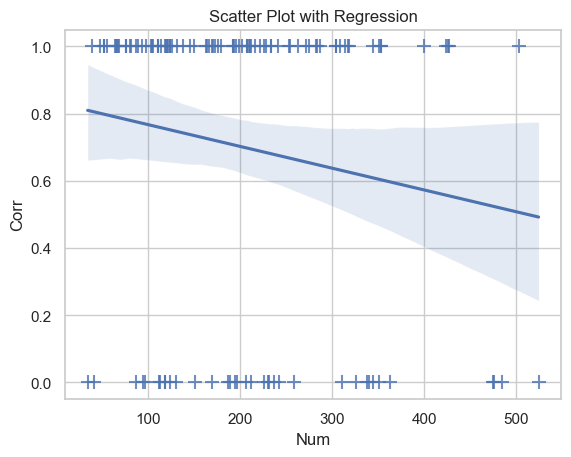

------------------------------
Kolekcja grafiki B: bez polecenia:


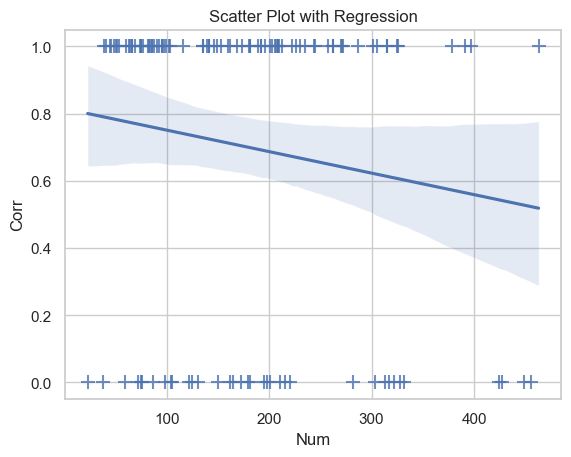

------------------------------
Kolekcja grafiki B: tylko polecenie:


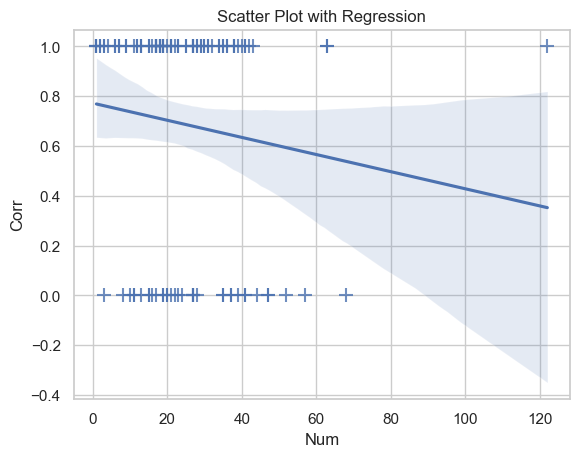

------------------------------
Kolekcja grafiki 1: z poleceniem:


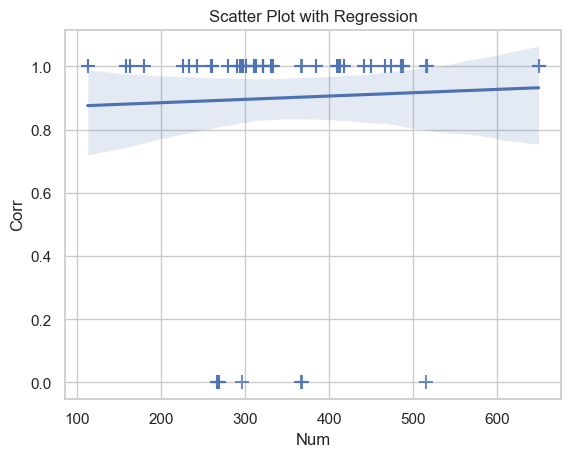

------------------------------
Kolekcja grafiki 1: bez polecenia:


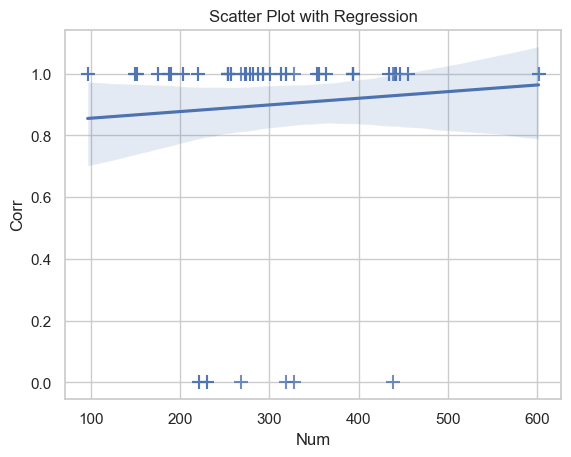

------------------------------
Kolekcja grafiki 1: tylko polecenie :


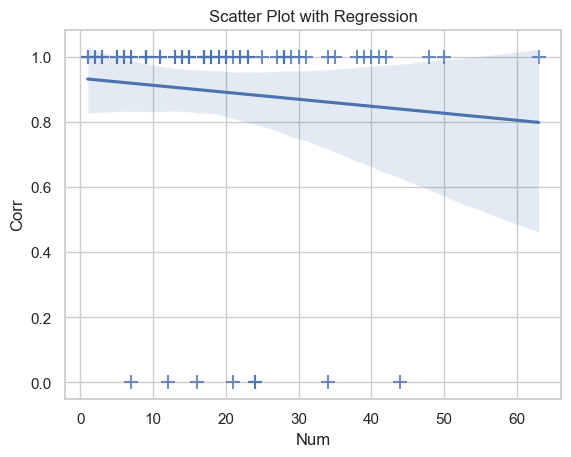

------------------------------
Kolekcja grafiki 2: z poleceniem:


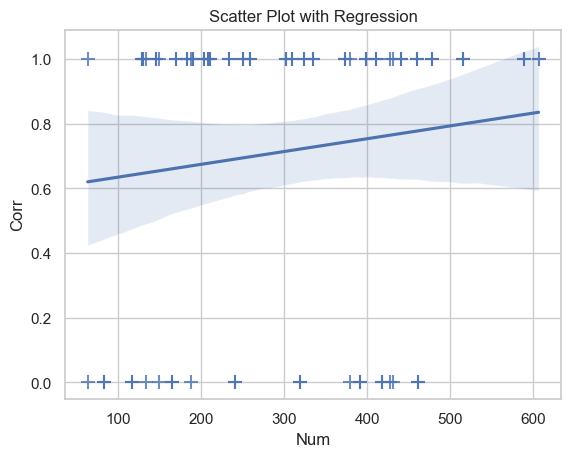

------------------------------
Kolekcja grafiki 2: bez polecenia:


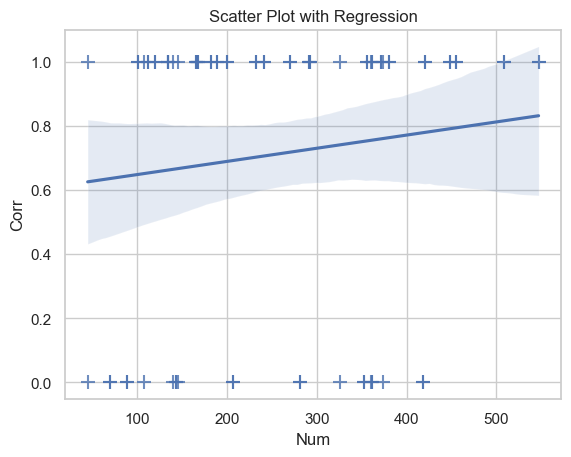

------------------------------
Kolekcja grafiki 2: tylko polecenie:


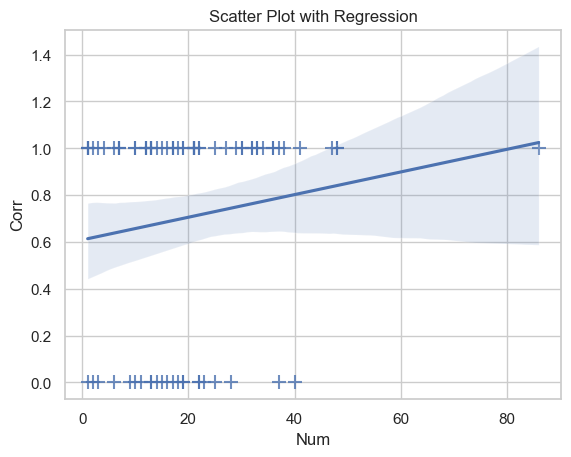

------------------------------
Kolekcja grafiki 3: z poleceniem:


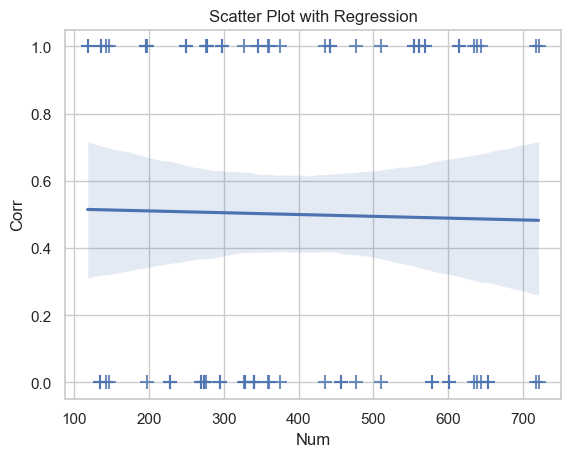

------------------------------
Kolekcja grafiki 3: bez polecenia:


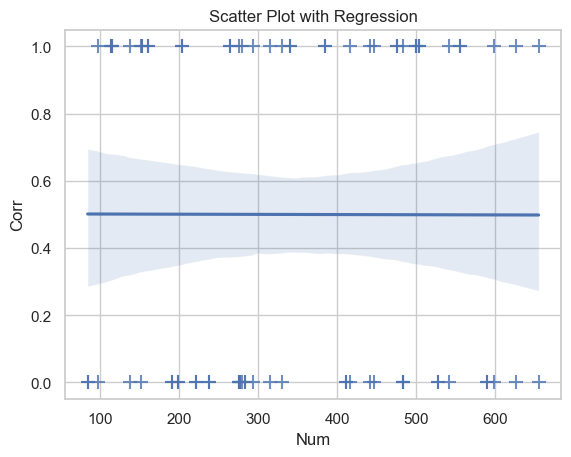

------------------------------
Kolekcja grafiki 3: tylko polecenie:


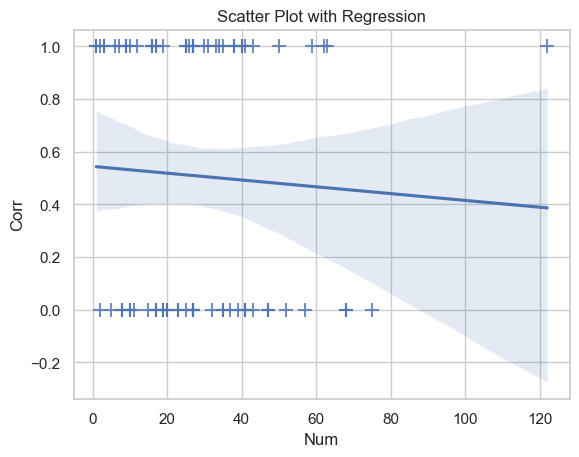

In [57]:
# kolekcje grafik
param_category = 'Corr'
col = 'Num'
for i, df in enumerate(dfs_coll):
    print('------------------------------')
    print(names_coll[i + 1])
    df = df.dropna()
    plot_scatter_with_regression(df, col, param_category)

------------------------------
Zsumowane wszystkie grafiki: z poleceniem:


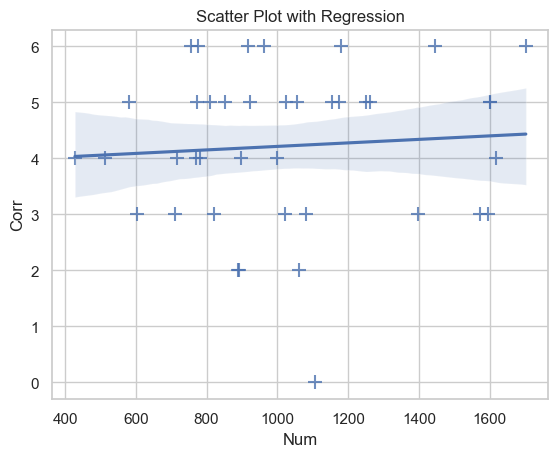

------------------------------
Zsumowane wszystkie grafiki: bez polecenia:


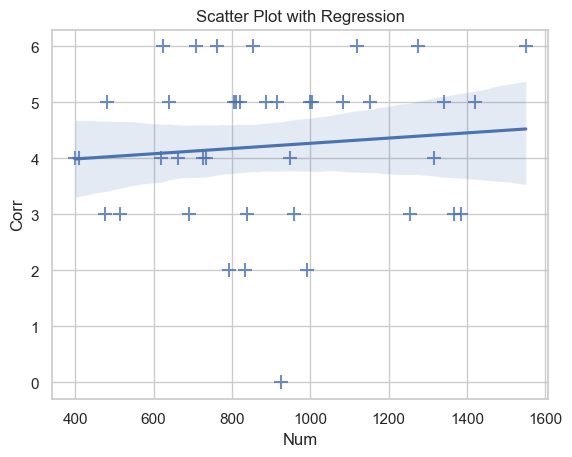

------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :


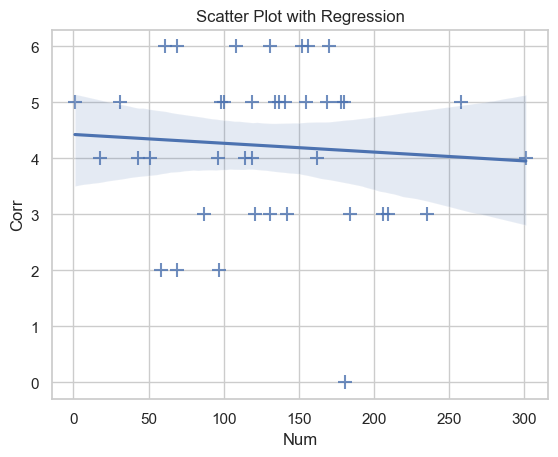

------------------------------
Zsumowane grafiki A: z poleceniem:


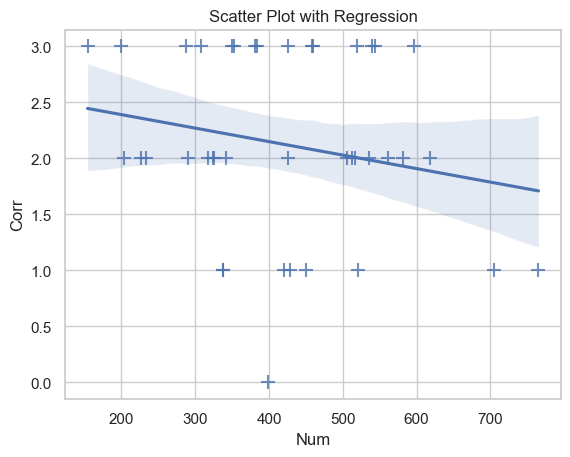

------------------------------
Zsumowane grafiki A: bez polecenia:


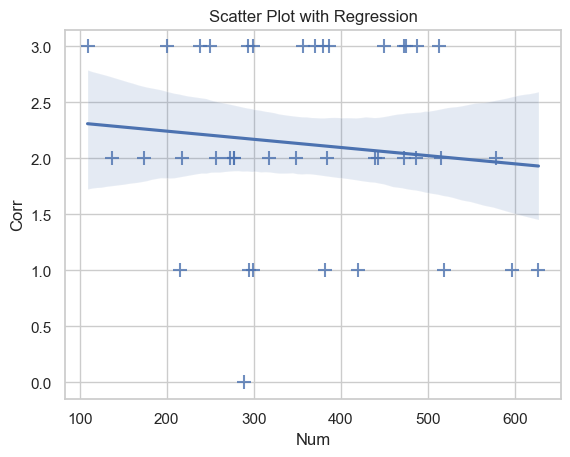

------------------------------
Zsumowane grafiki A: tylko polecenie :


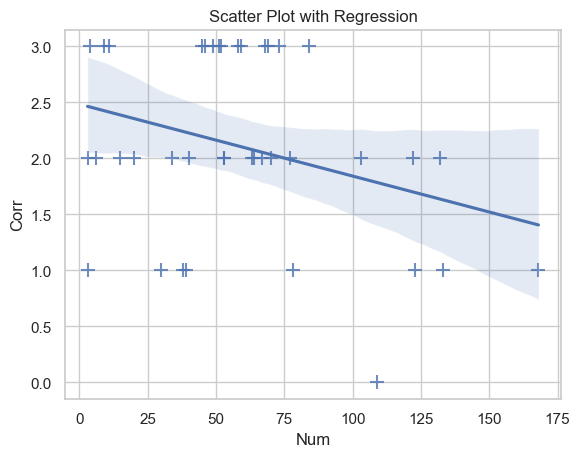

------------------------------
Zsumowane grafiki B: z poleceniem:


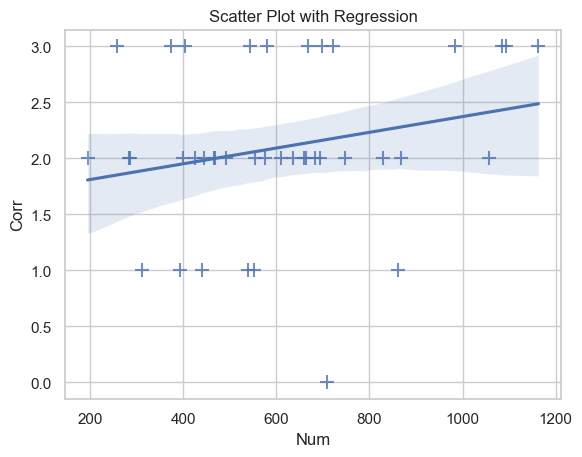

------------------------------
Zsumowane grafiki B: bez polecenia:


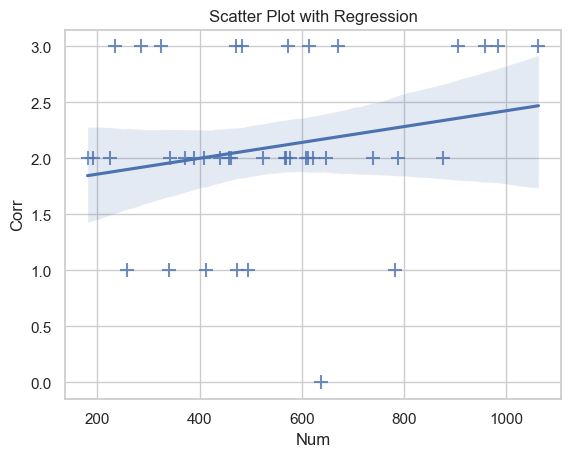

------------------------------
Zsumowane grafiki B: tylko polecenie :


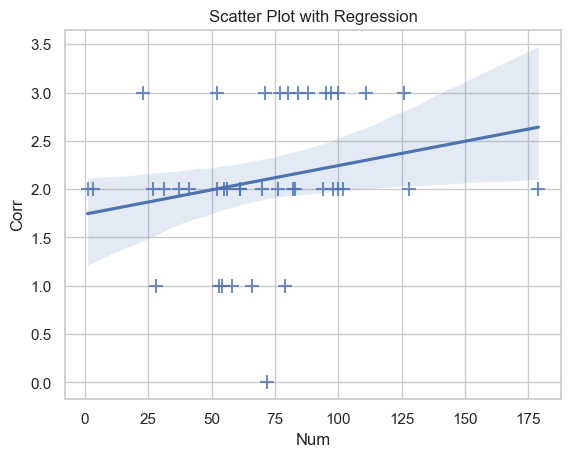

------------------------------
Zsumowane grafiki 1: z poleceniem:


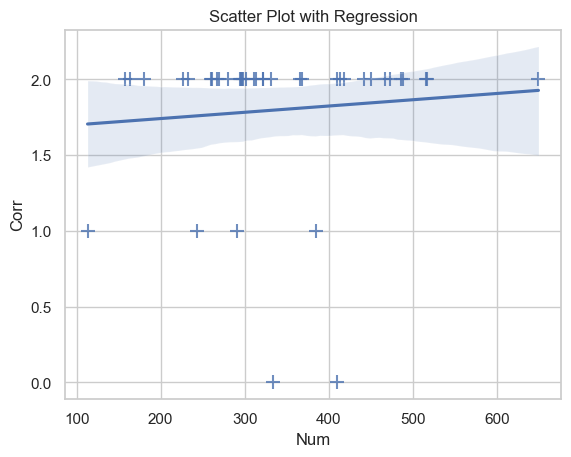

------------------------------
Zsumowane grafiki 1: bez polecenia:


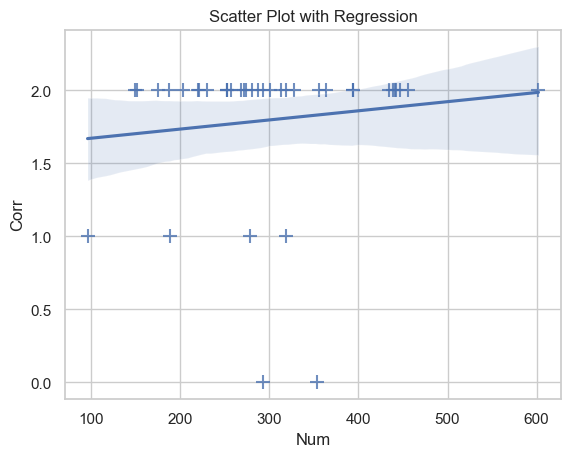

------------------------------
Zsumowane grafiki 1: tylko polecenie :


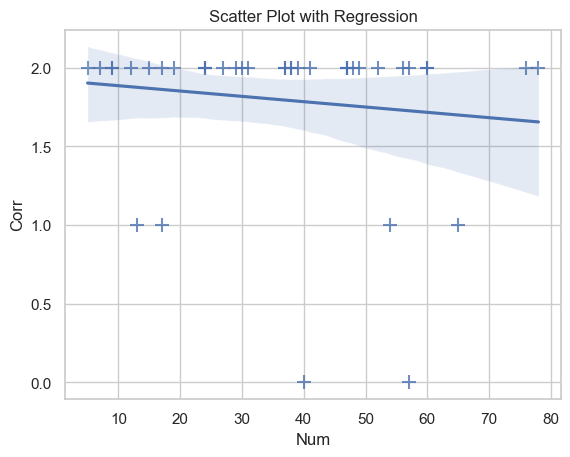

------------------------------
Zsumowane grafiki 2: z poleceniem:


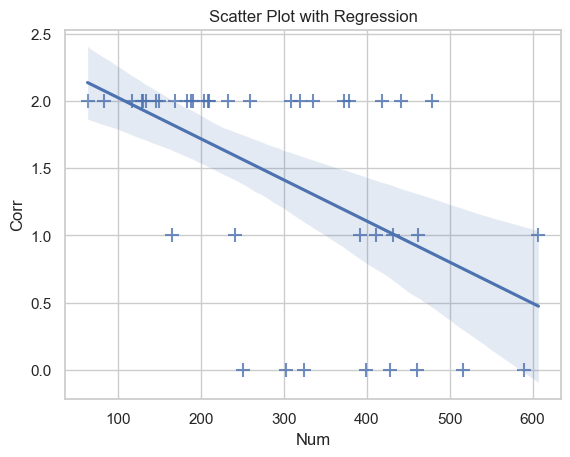

------------------------------
Zsumowane grafiki 2: bez polecenia:


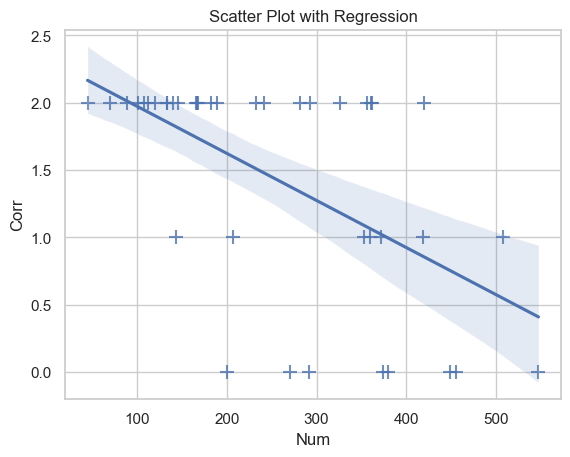

------------------------------
Zsumowane grafiki 2: tylko polecenie :


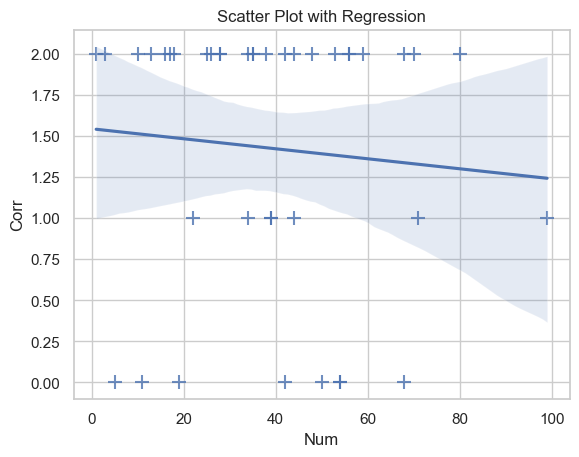

------------------------------
Zsumowane grafiki 3: z poleceniem:


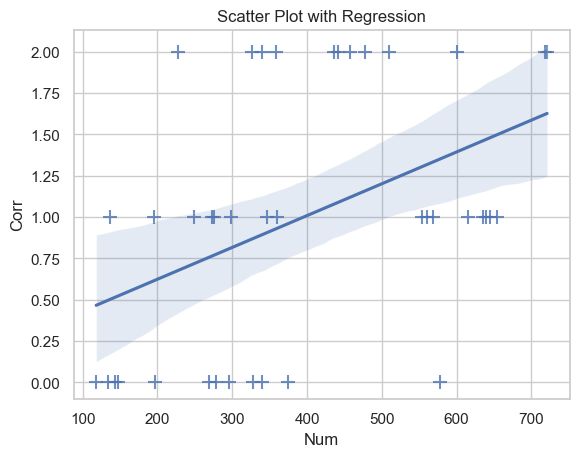

------------------------------
Zsumowane grafiki 3: bez polecenia:


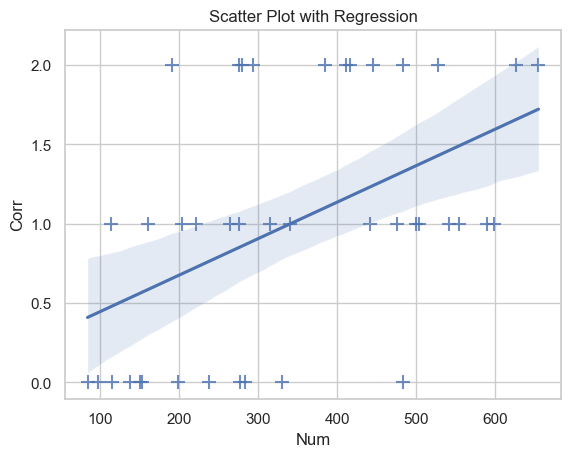

------------------------------
Zsumowane grafiki 3: tylko polecenie :


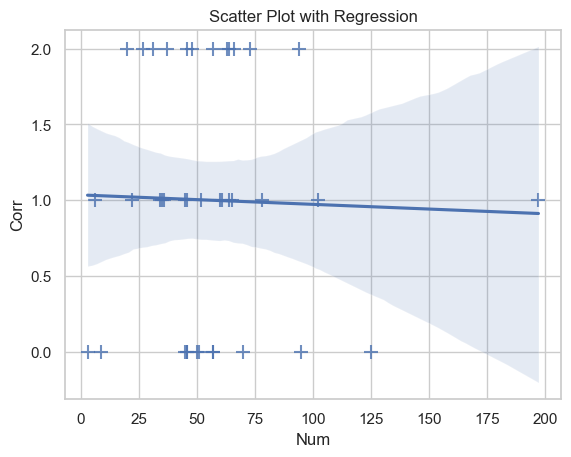

In [58]:
# sumy grafik
param_category = 'Corr'
col = 'Num'
for i, df in enumerate(dfs_sum):
    print('------------------------------')
    print(names_sum[i + 1])
    df = df.dropna()
    plot_scatter_with_regression(df, col, param_category)

Wykresy - trudność

##########################################
Total
------------------------------
Kolekcja wszystkie grafiki: z poleceniem:


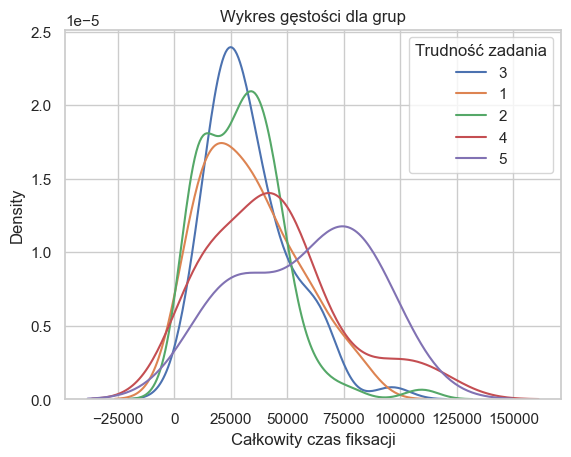

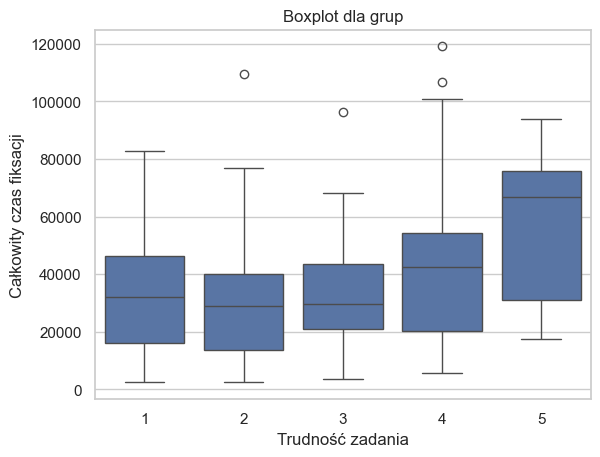

------------------------------
Kolekcja wszystkie grafiki: bez polecenia:


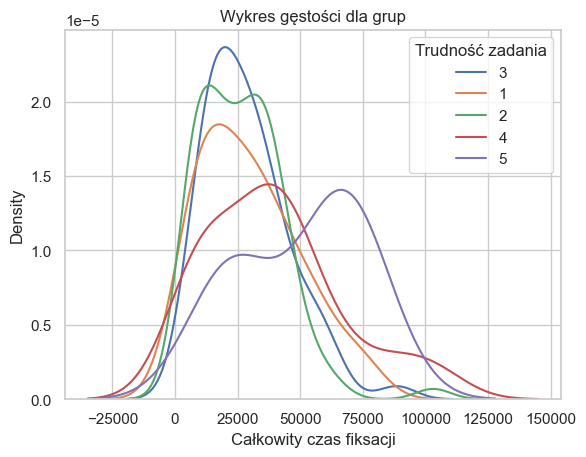

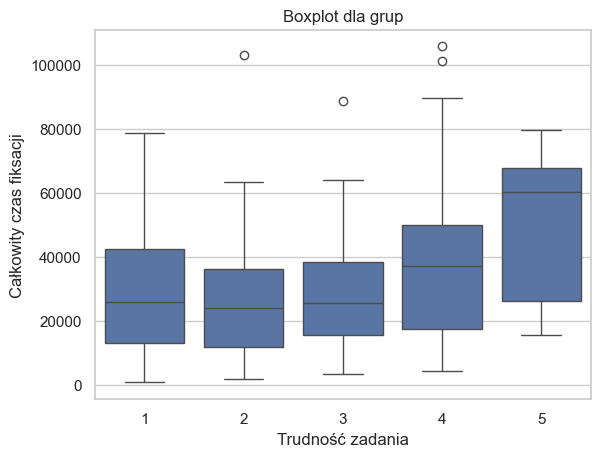

------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:


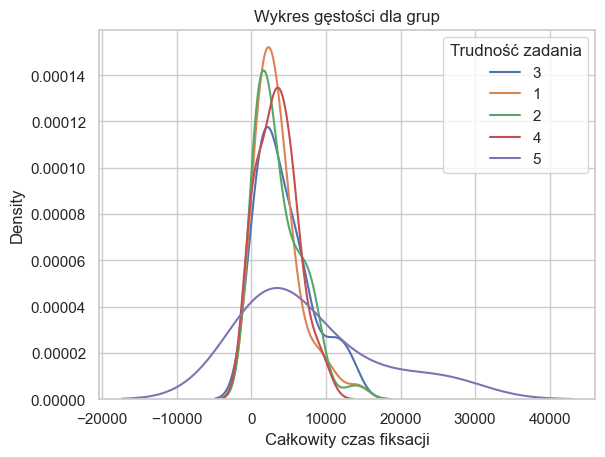

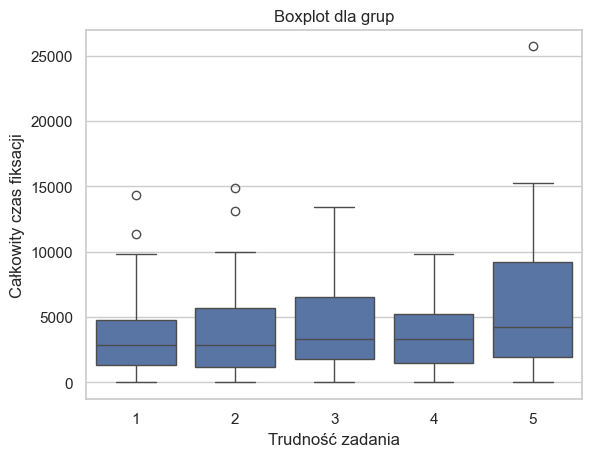

------------------------------
Kolekcja grafiki A: z poleceniem:


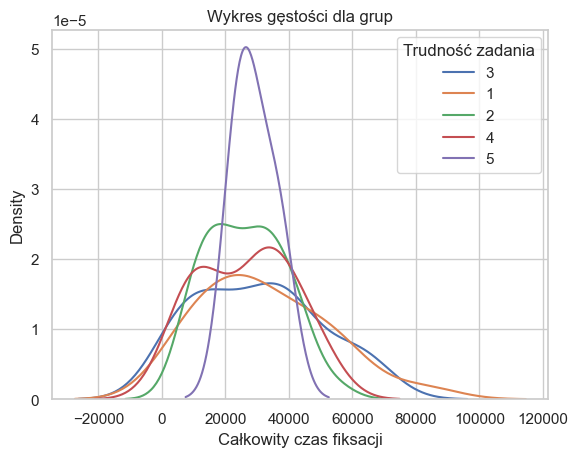

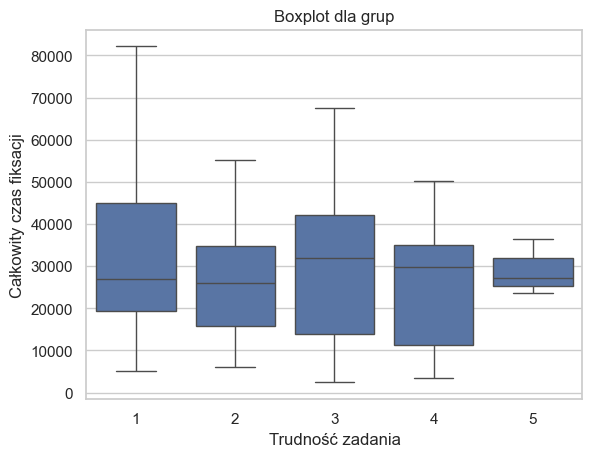

------------------------------
Kolekcja grafiki A: bez polecenia:


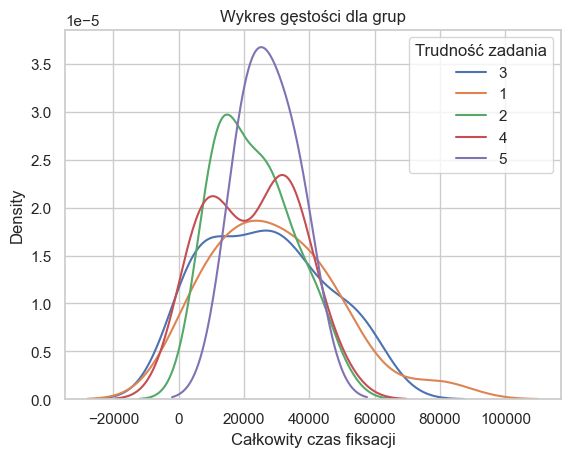

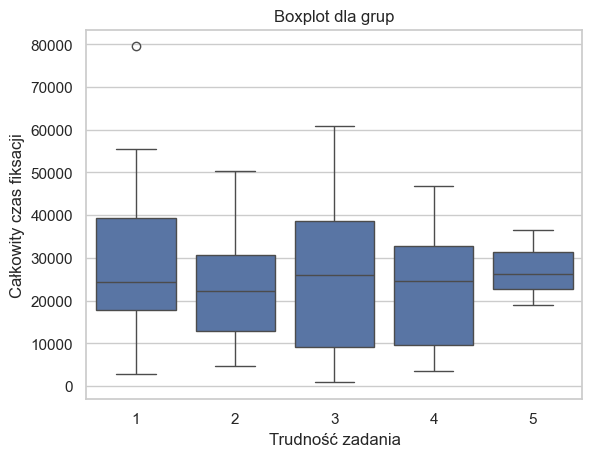

------------------------------
Kolekcja grafiki A: tylko polecenie:


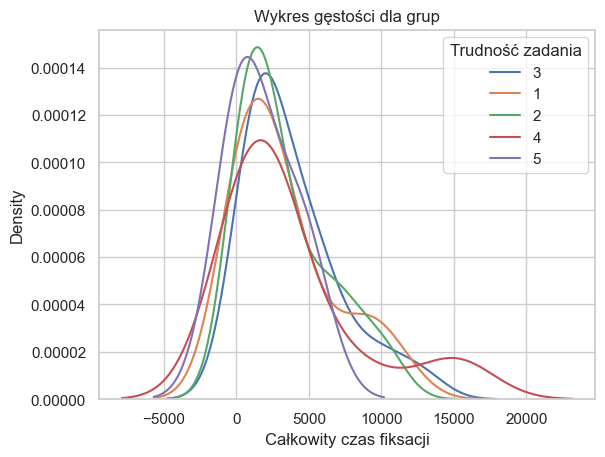

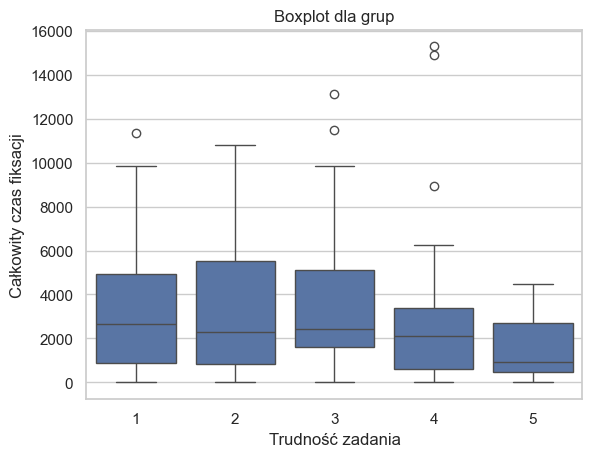

------------------------------
Kolekcja grafiki B: z poleceniem:


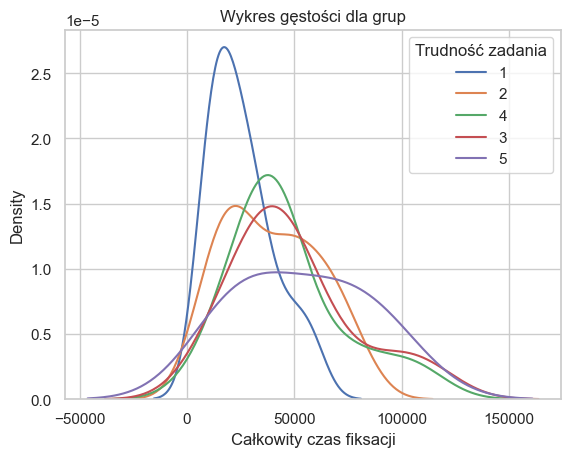

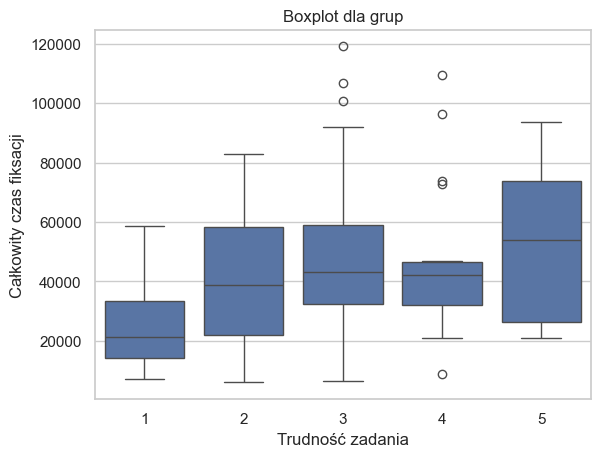

------------------------------
Kolekcja grafiki B: bez polecenia:


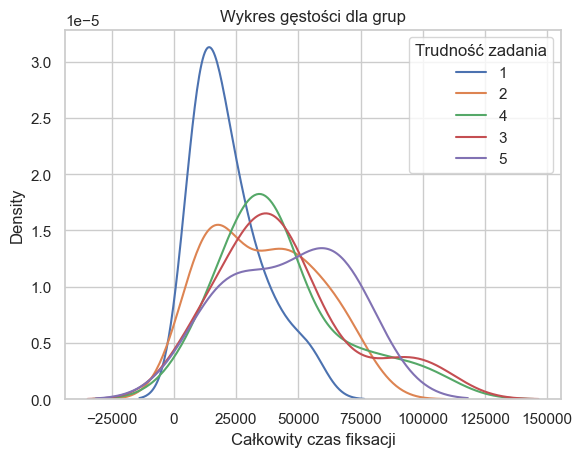

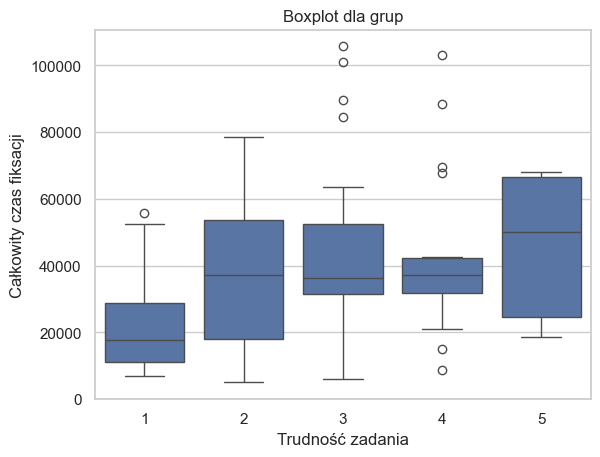

------------------------------
Kolekcja grafiki B: tylko polecenie:


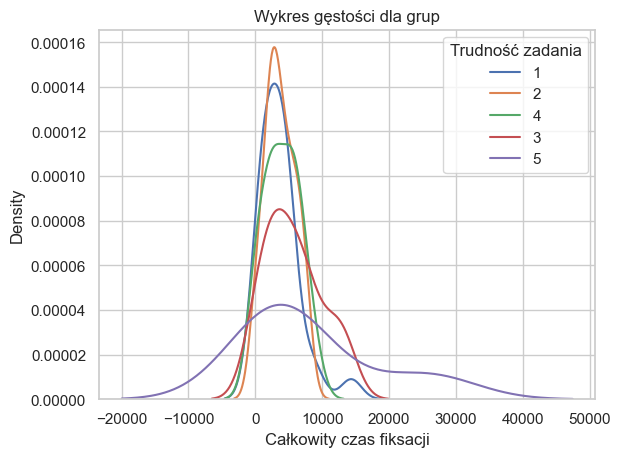

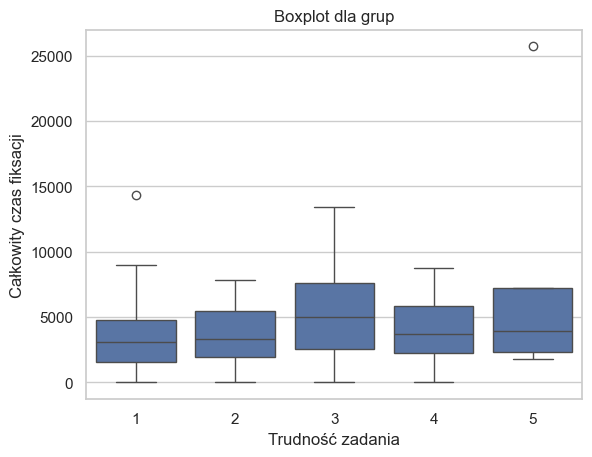

------------------------------
Kolekcja grafiki 1: z poleceniem:


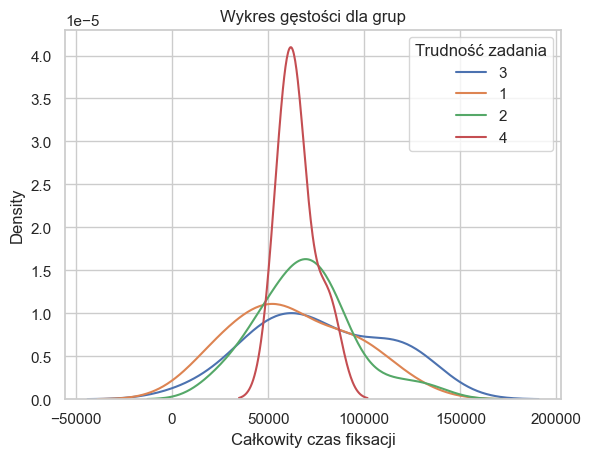

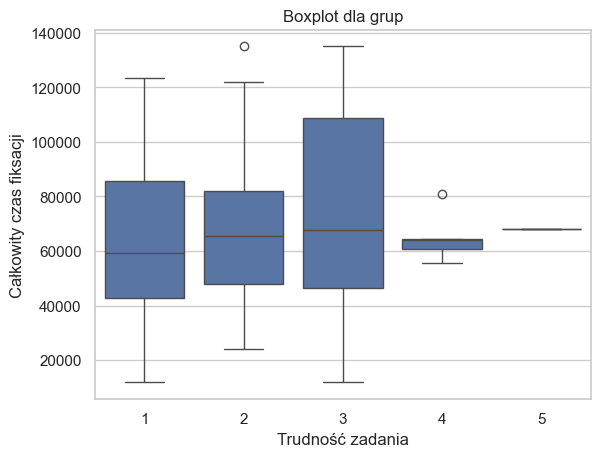

------------------------------
Kolekcja grafiki 1: bez polecenia:


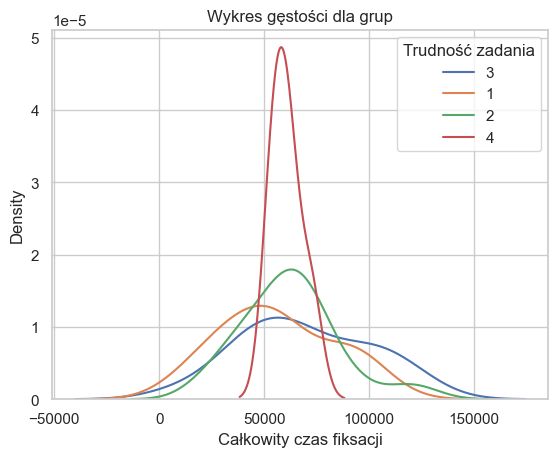

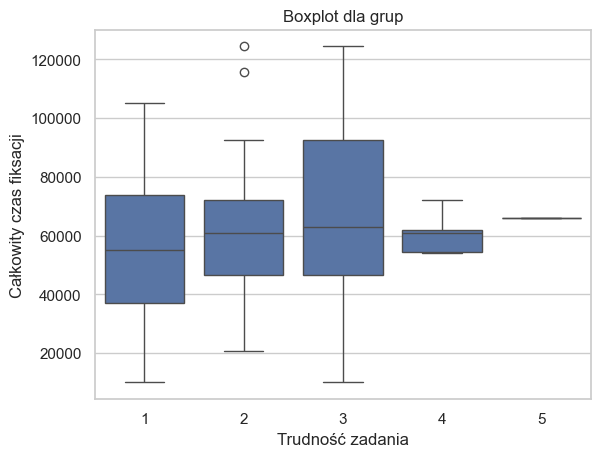

------------------------------
Kolekcja grafiki 1: tylko polecenie :


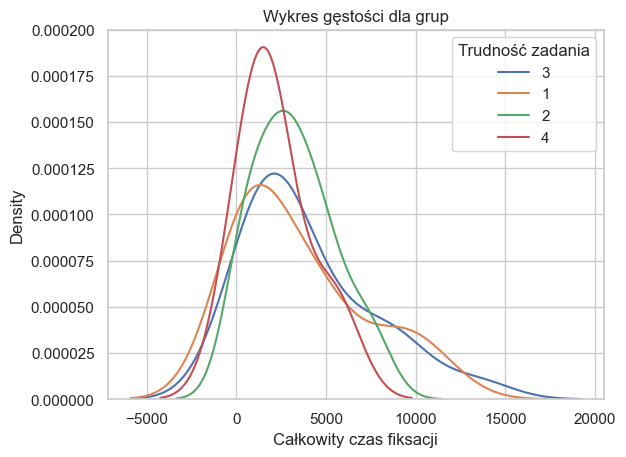

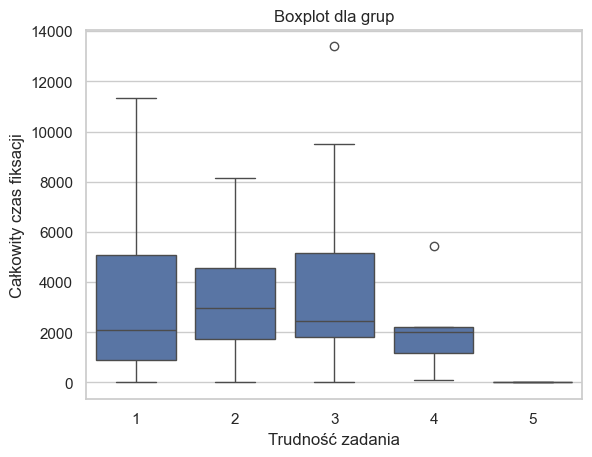

------------------------------
Kolekcja grafiki 2: z poleceniem:


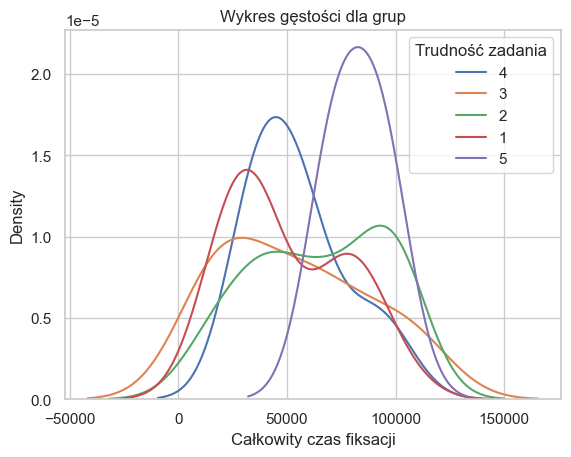

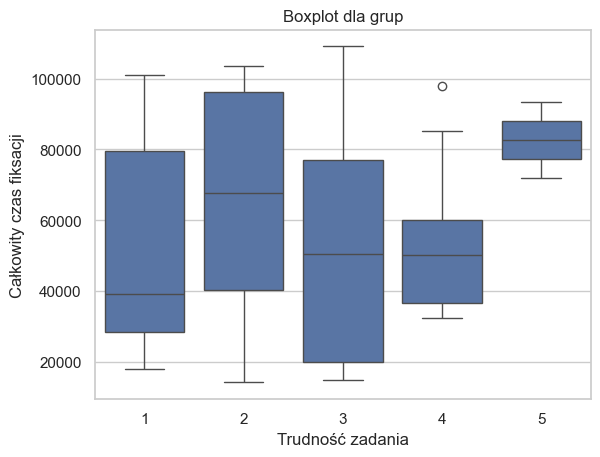

------------------------------
Kolekcja grafiki 2: bez polecenia:


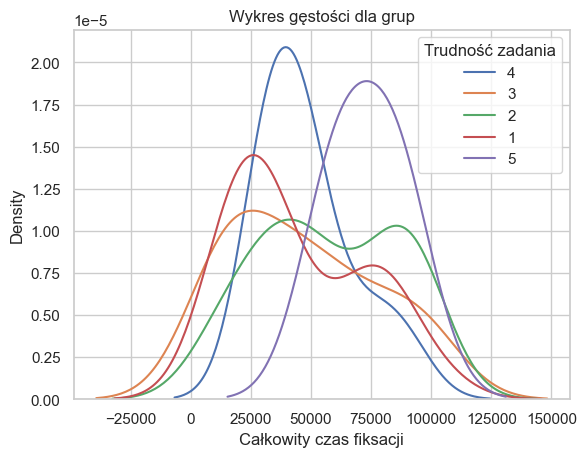

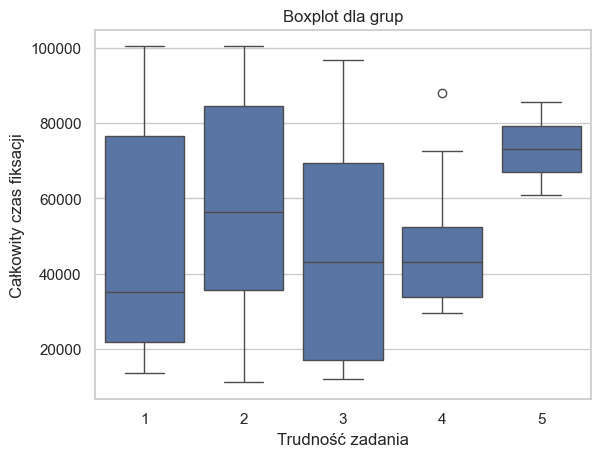

------------------------------
Kolekcja grafiki 2: tylko polecenie:


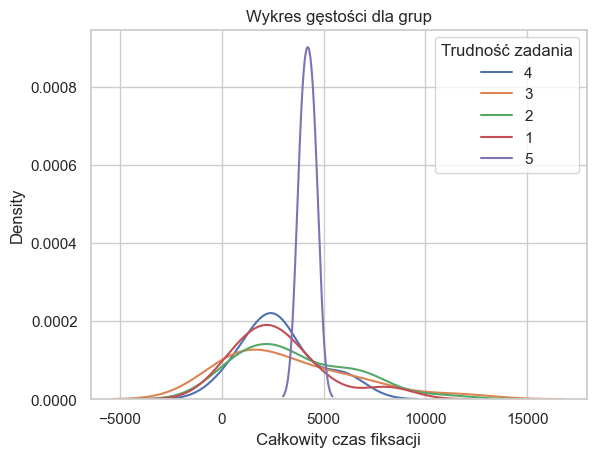

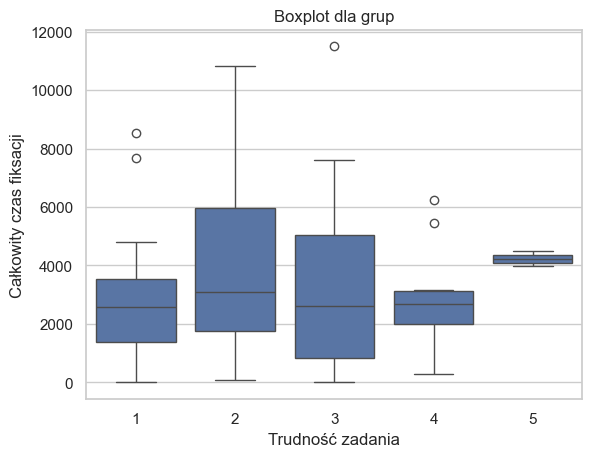

------------------------------
Kolekcja grafiki 3: z poleceniem:


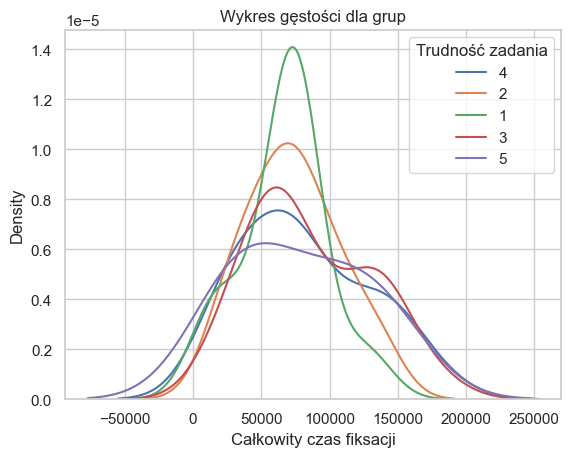

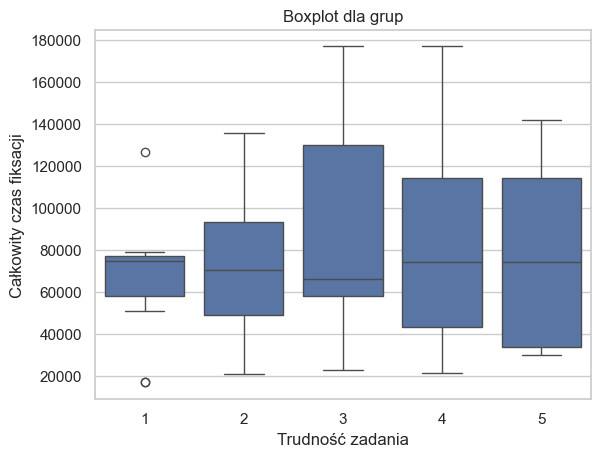

------------------------------
Kolekcja grafiki 3: bez polecenia:


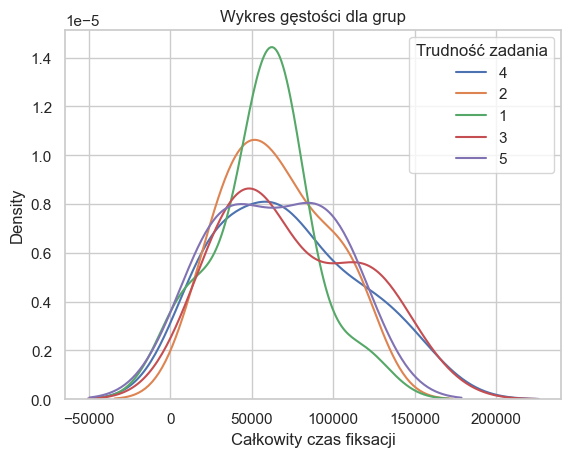

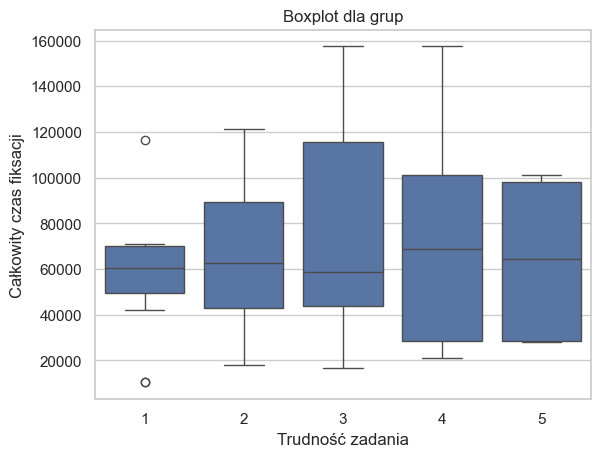

------------------------------
Kolekcja grafiki 3: tylko polecenie:


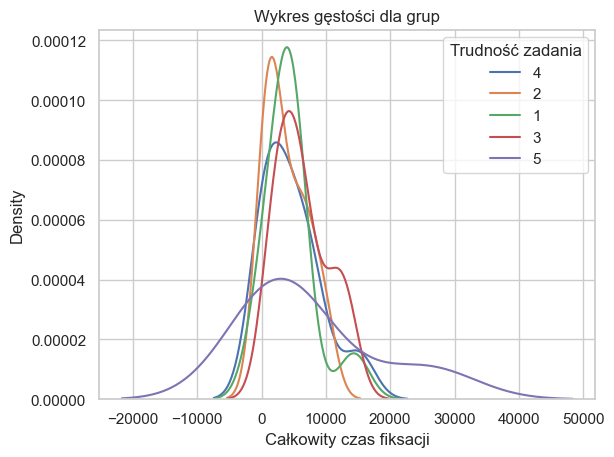

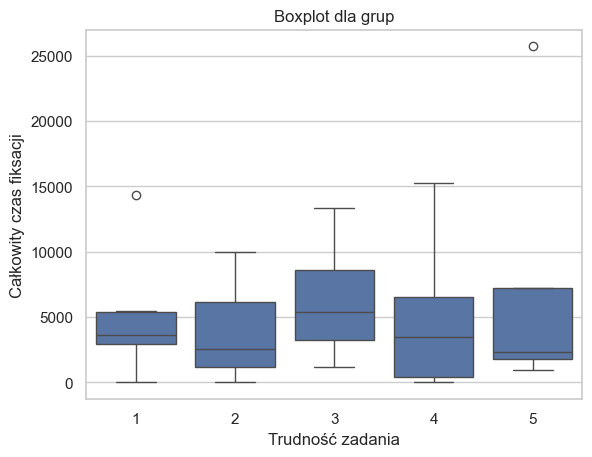

##########################################
Avg
------------------------------
Kolekcja wszystkie grafiki: z poleceniem:


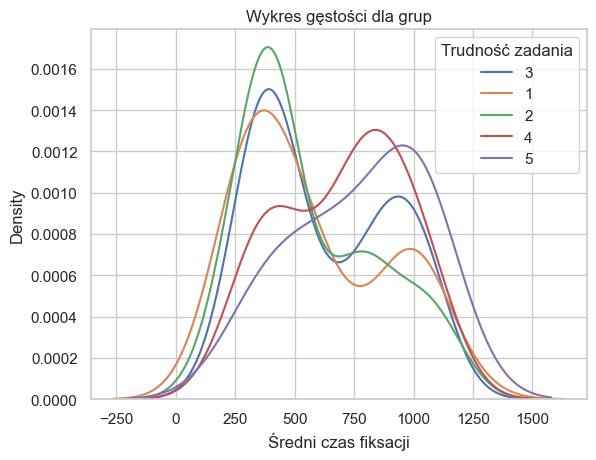

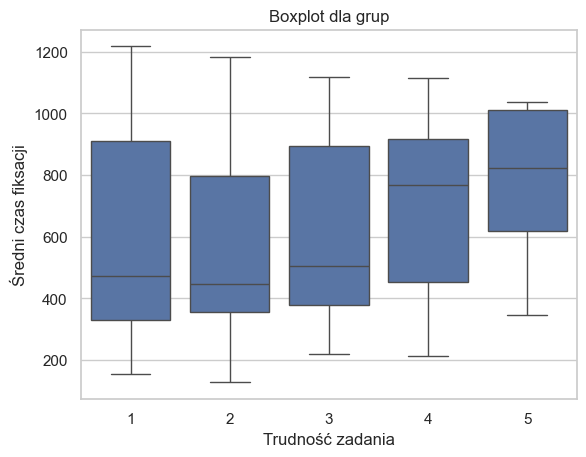

------------------------------
Kolekcja wszystkie grafiki: bez polecenia:


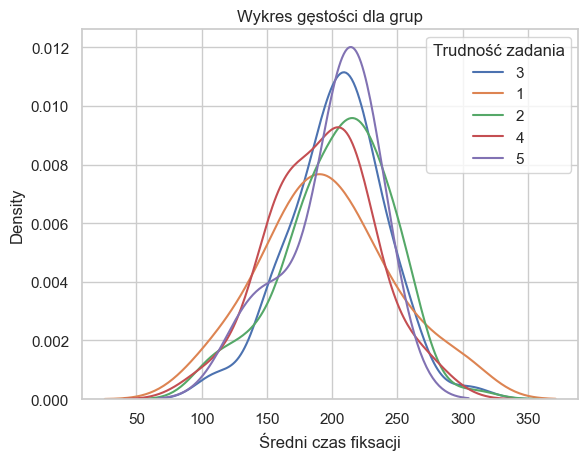

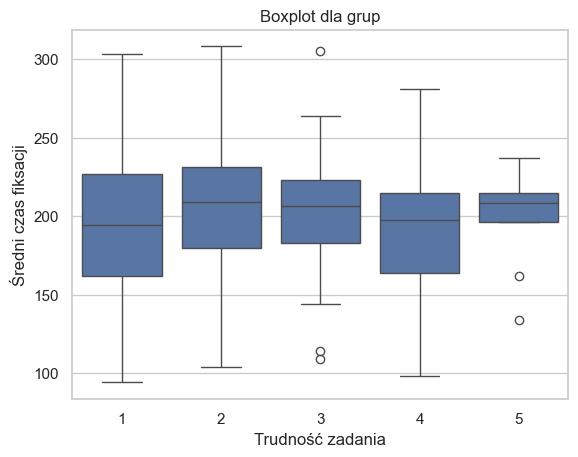

------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:


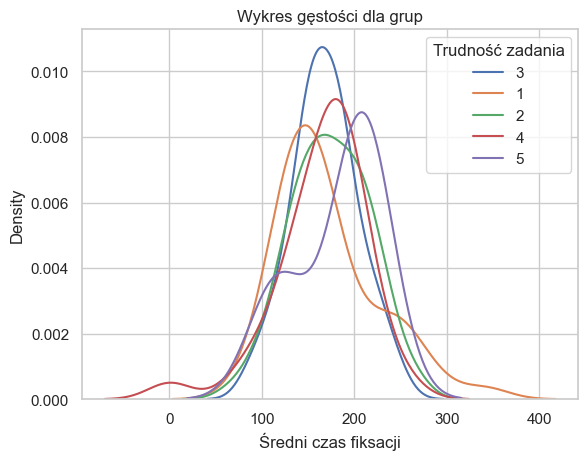

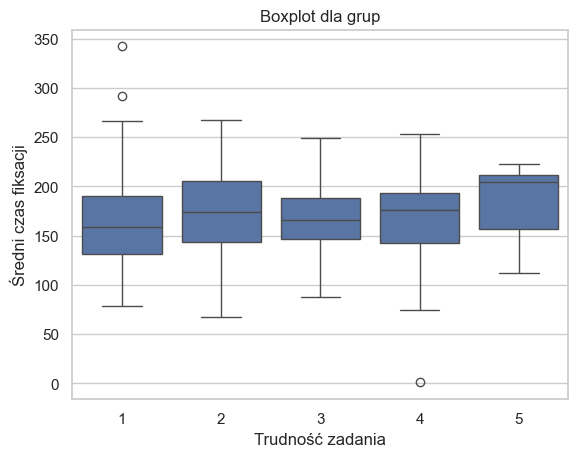

------------------------------
Kolekcja grafiki A: z poleceniem:


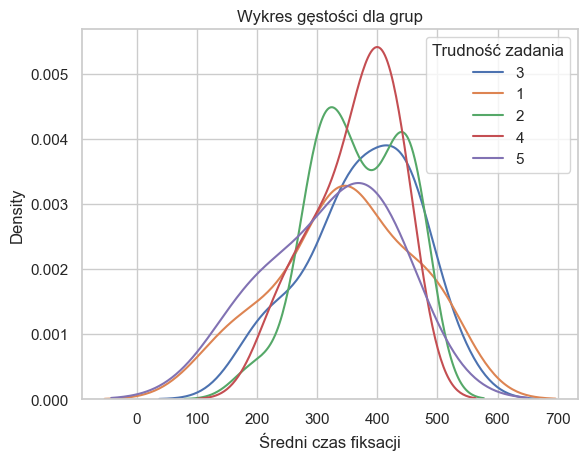

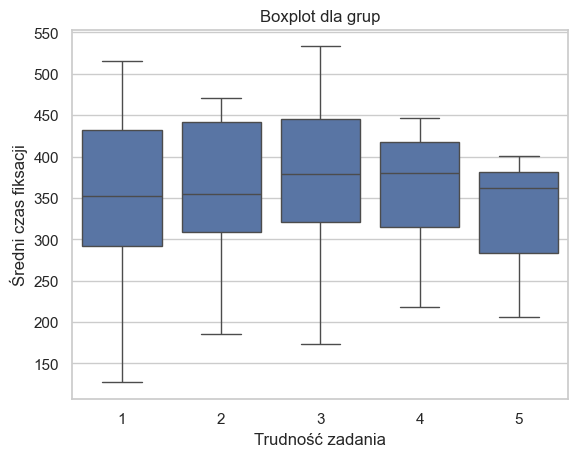

------------------------------
Kolekcja grafiki A: bez polecenia:


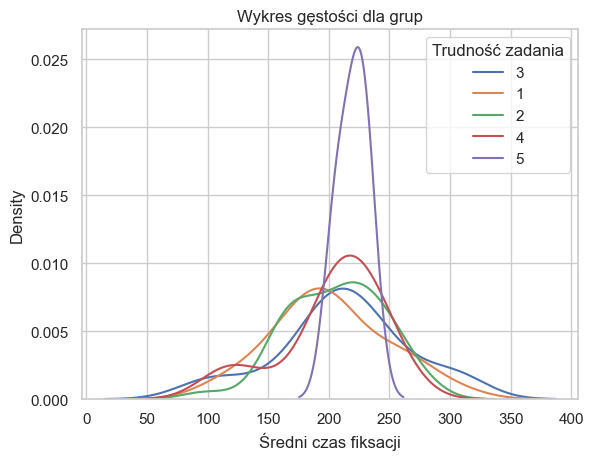

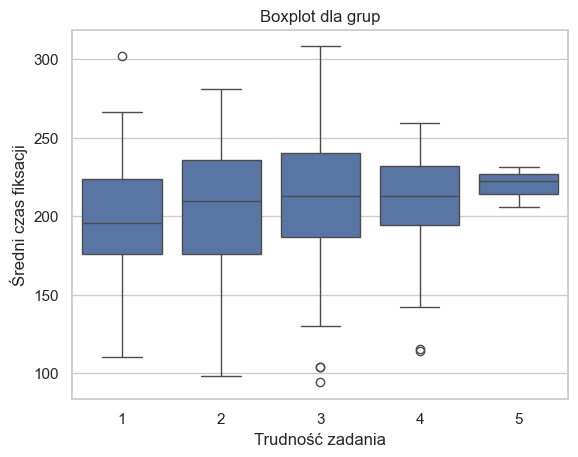

------------------------------
Kolekcja grafiki A: tylko polecenie:


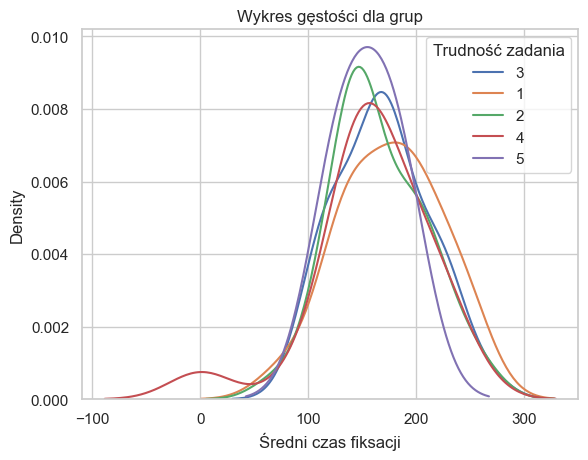

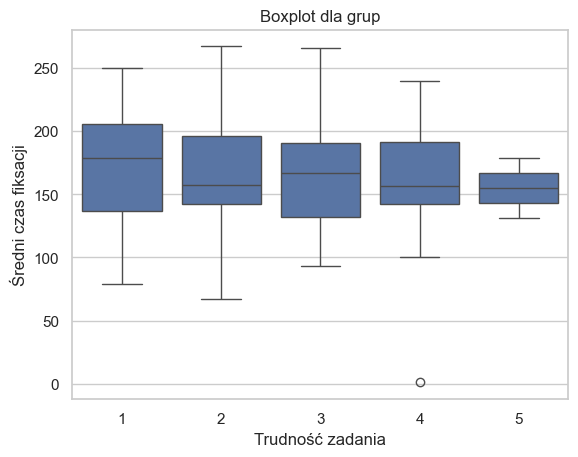

------------------------------
Kolekcja grafiki B: z poleceniem:


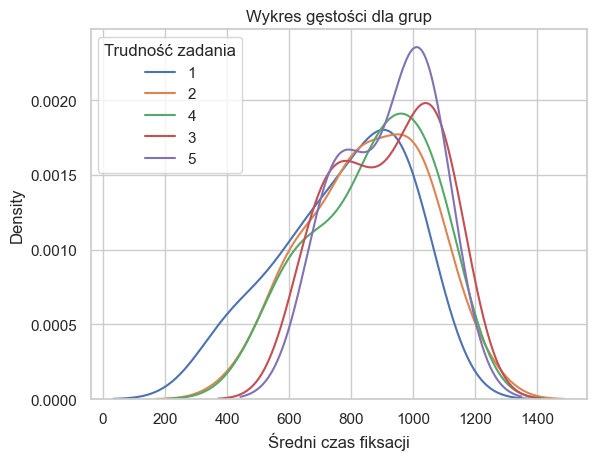

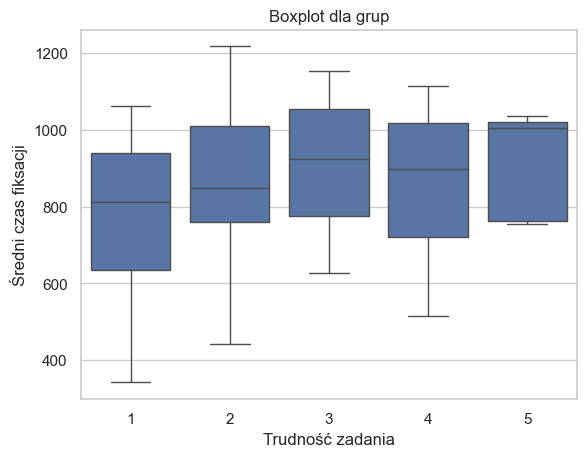

------------------------------
Kolekcja grafiki B: bez polecenia:


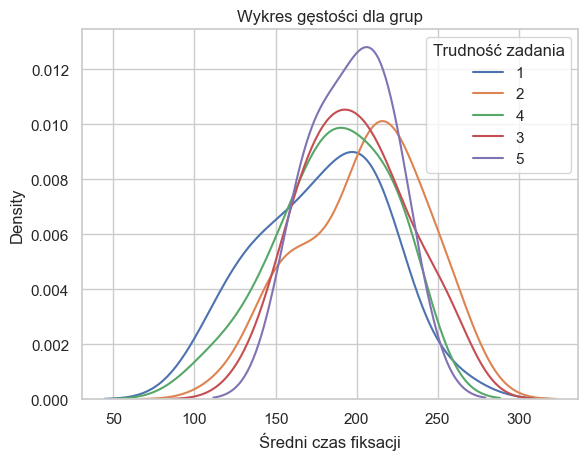

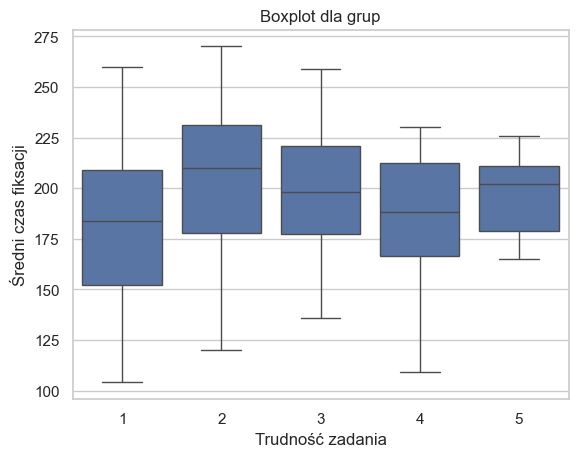

------------------------------
Kolekcja grafiki B: tylko polecenie:


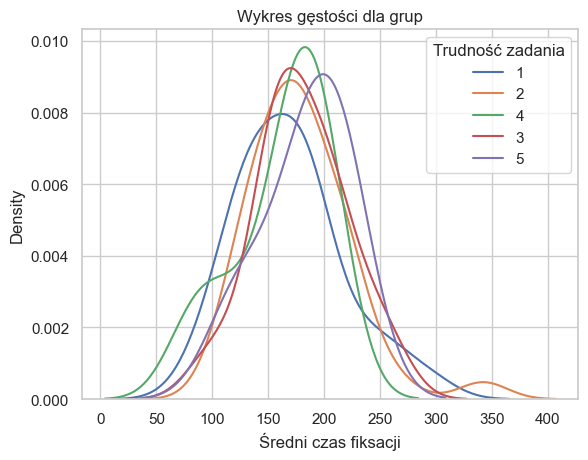

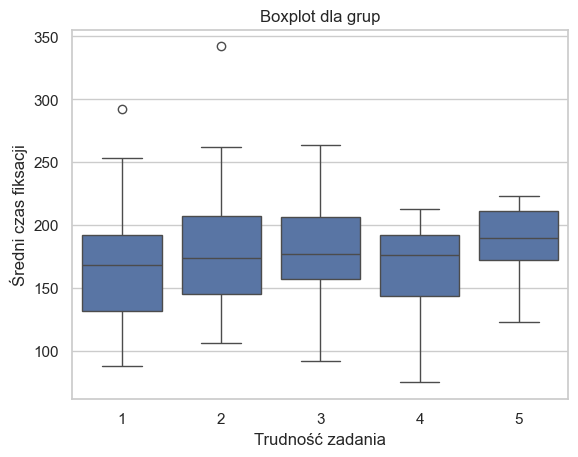

------------------------------
Kolekcja grafiki 1: z poleceniem:


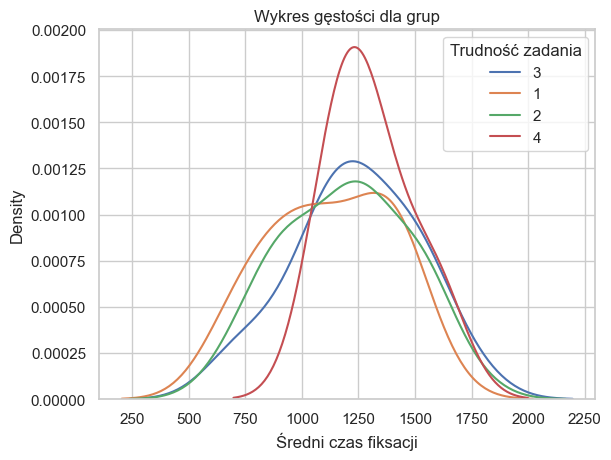

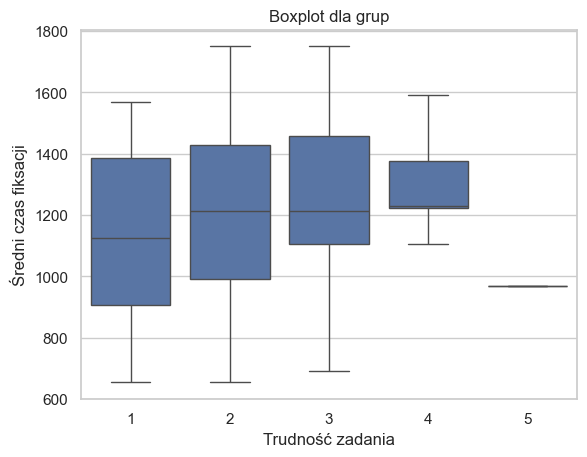

------------------------------
Kolekcja grafiki 1: bez polecenia:


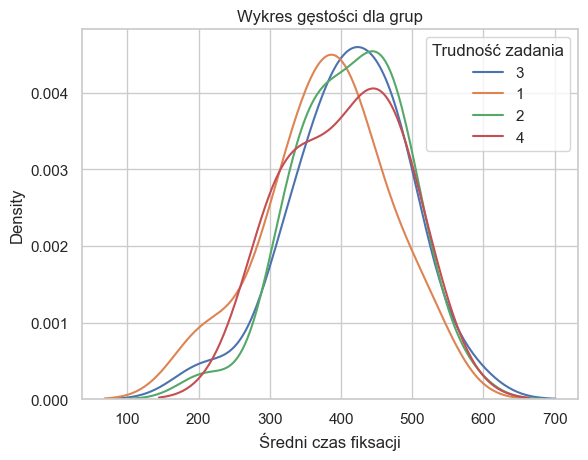

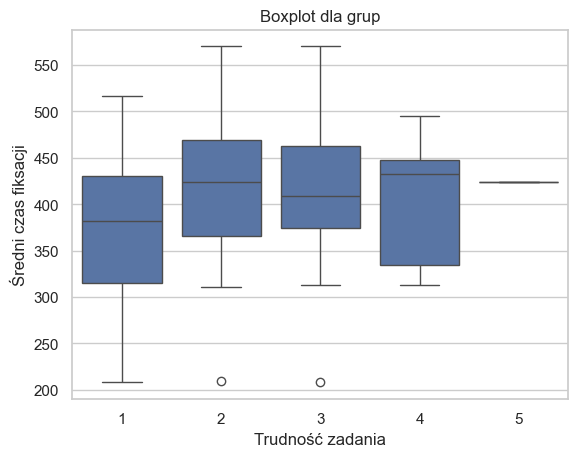

------------------------------
Kolekcja grafiki 1: tylko polecenie :


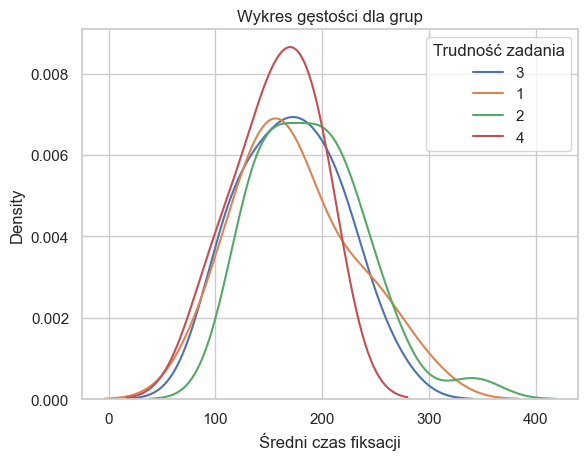

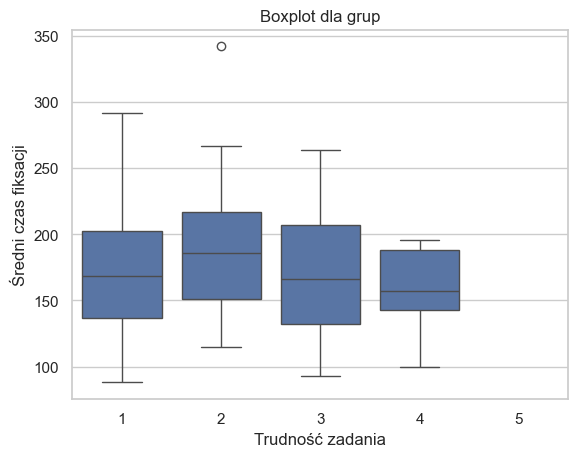

------------------------------
Kolekcja grafiki 2: z poleceniem:


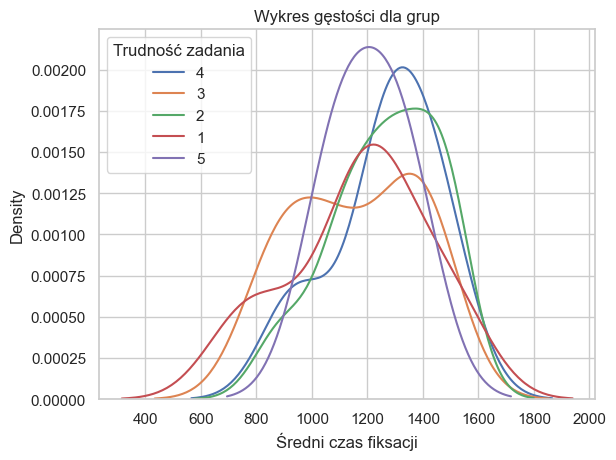

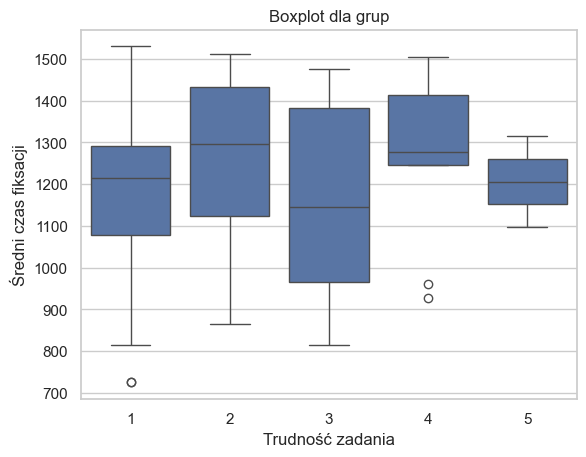

------------------------------
Kolekcja grafiki 2: bez polecenia:


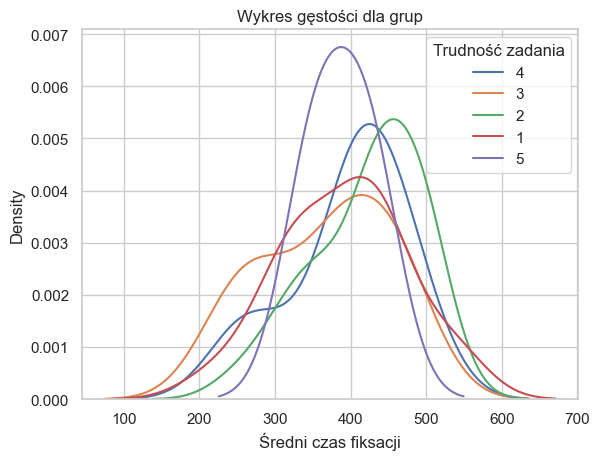

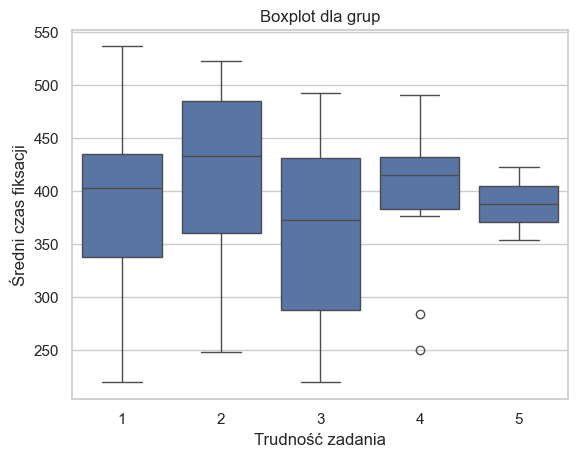

------------------------------
Kolekcja grafiki 2: tylko polecenie:


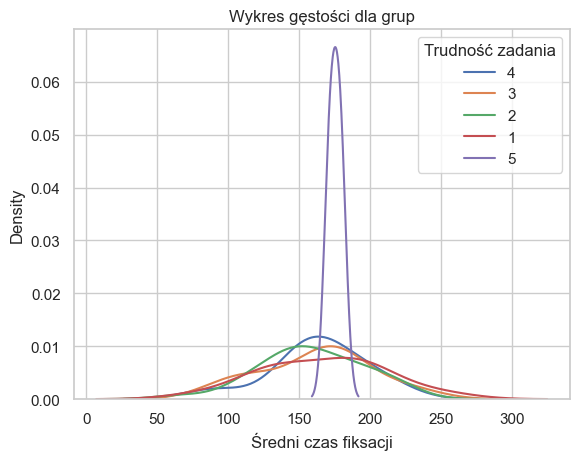

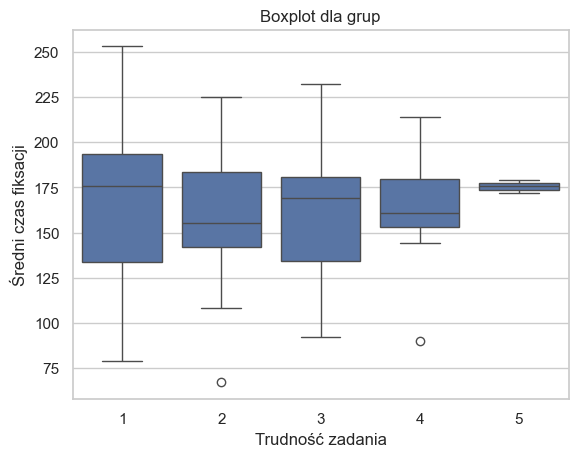

------------------------------
Kolekcja grafiki 3: z poleceniem:


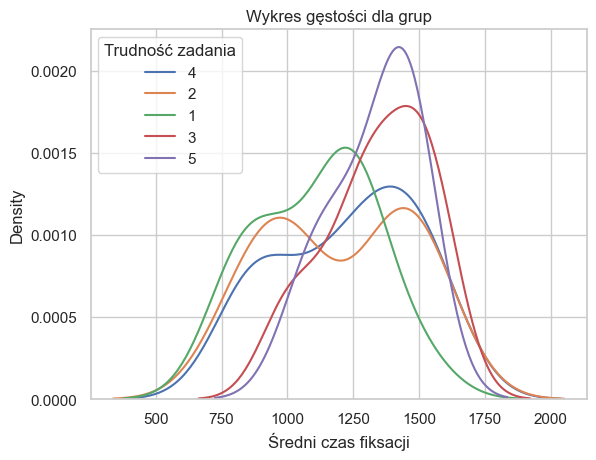

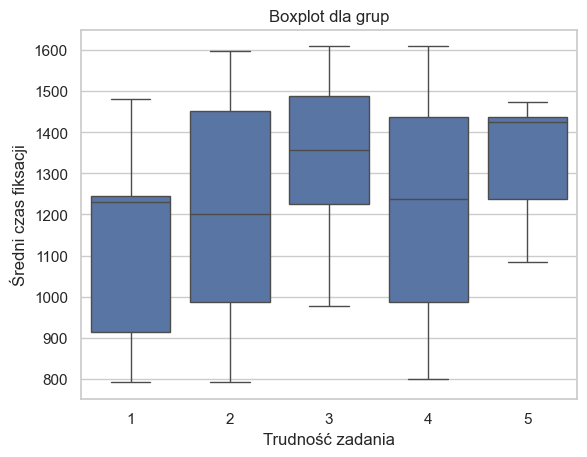

------------------------------
Kolekcja grafiki 3: bez polecenia:


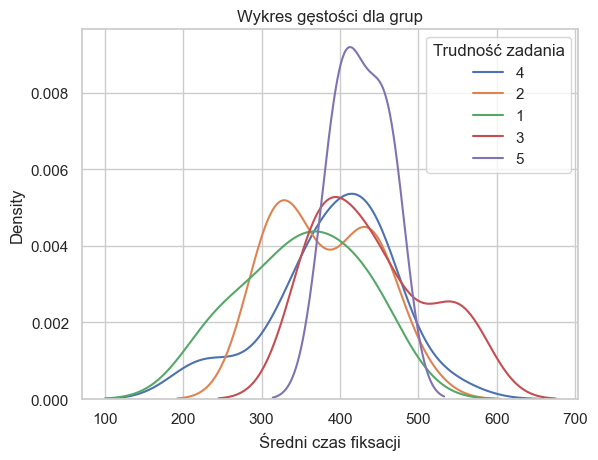

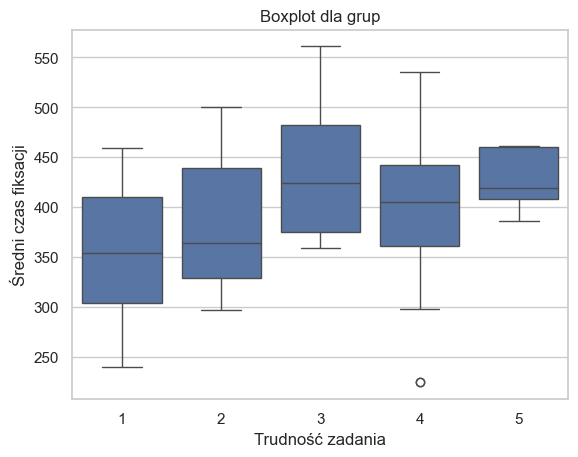

------------------------------
Kolekcja grafiki 3: tylko polecenie:


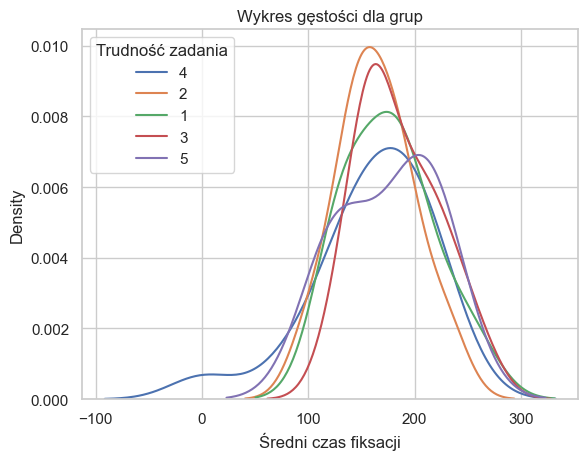

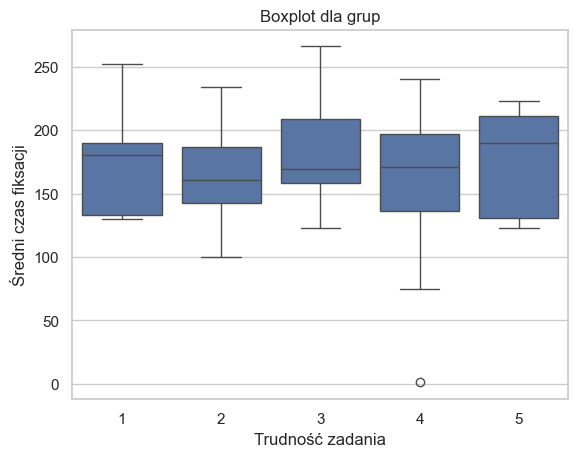

##########################################
Avg_pupil
------------------------------
Kolekcja wszystkie grafiki: z poleceniem:


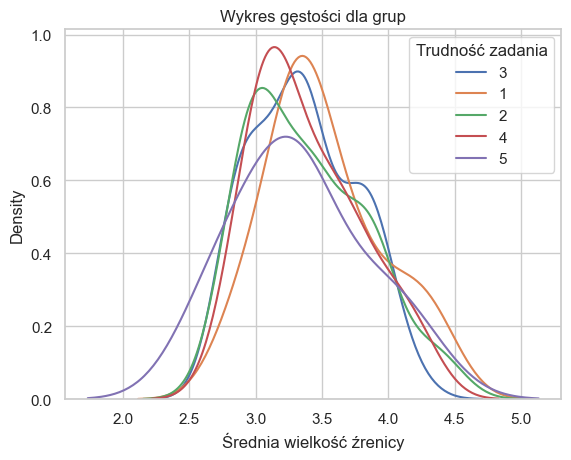

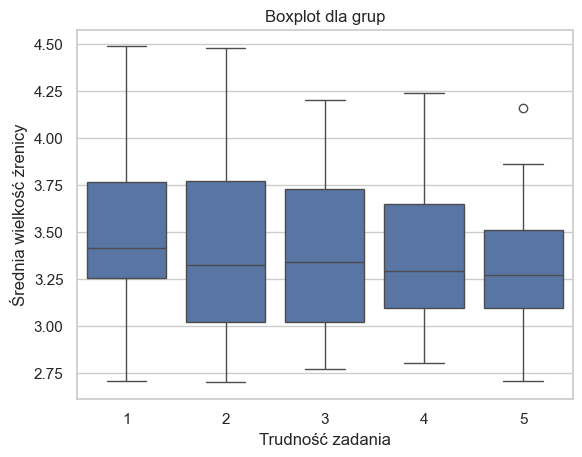

------------------------------
Kolekcja wszystkie grafiki: bez polecenia:


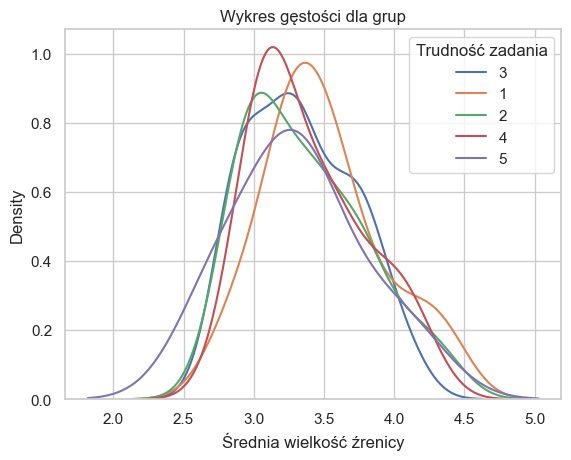

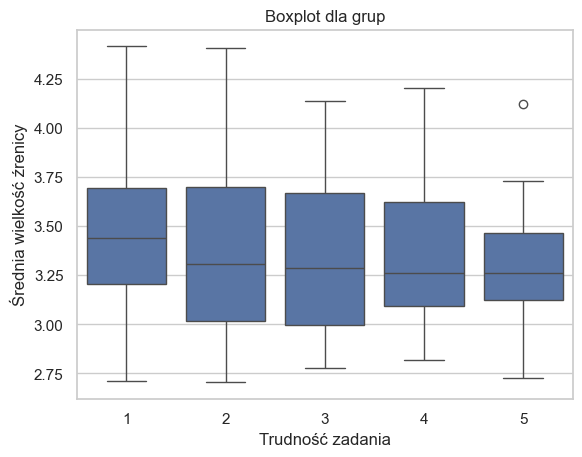

------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:


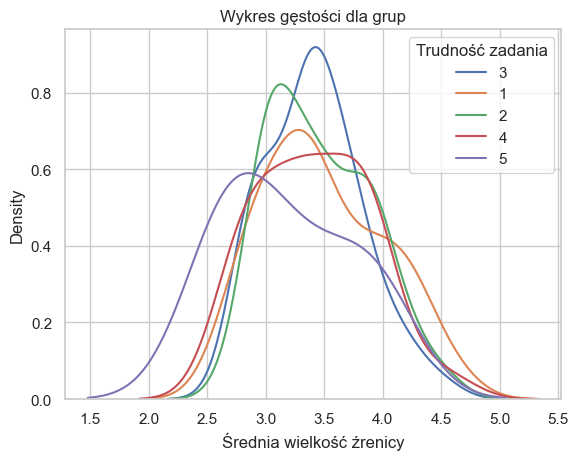

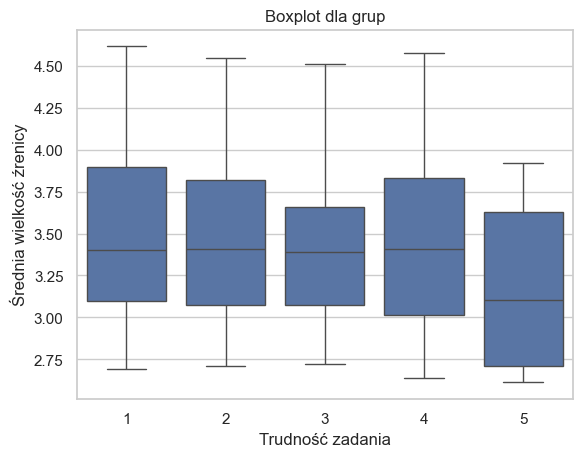

------------------------------
Kolekcja grafiki A: z poleceniem:


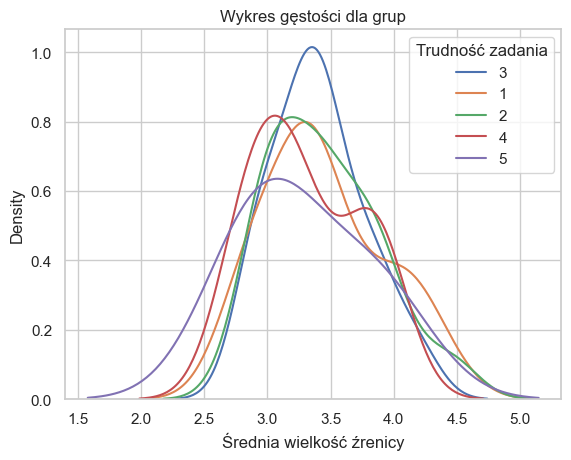

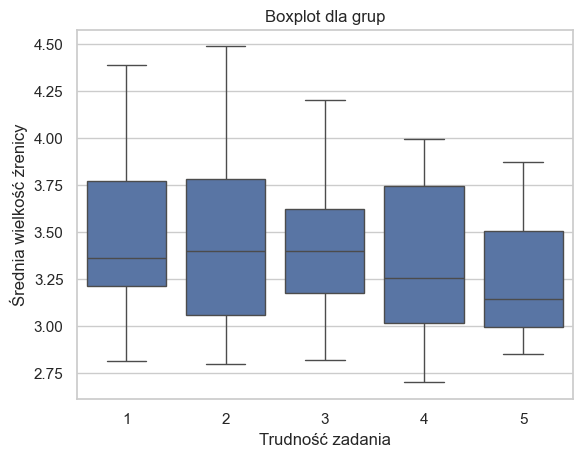

------------------------------
Kolekcja grafiki A: bez polecenia:


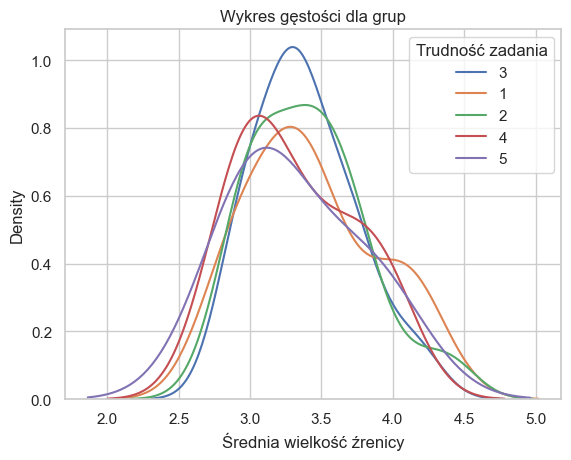

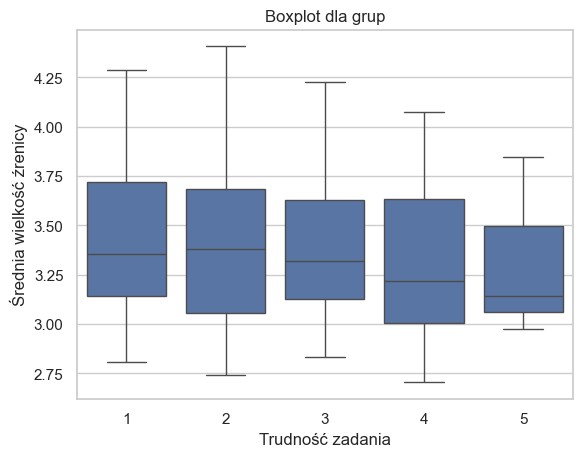

------------------------------
Kolekcja grafiki A: tylko polecenie:


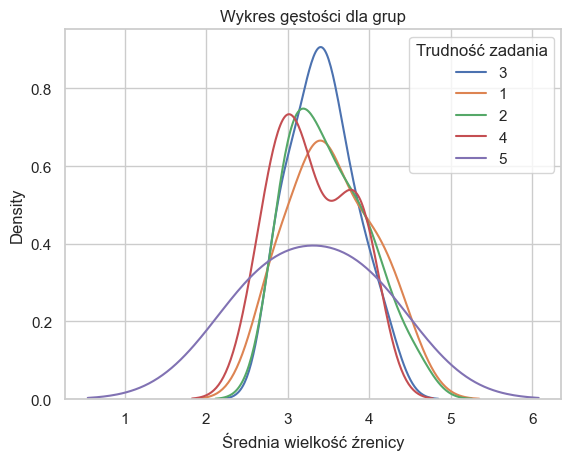

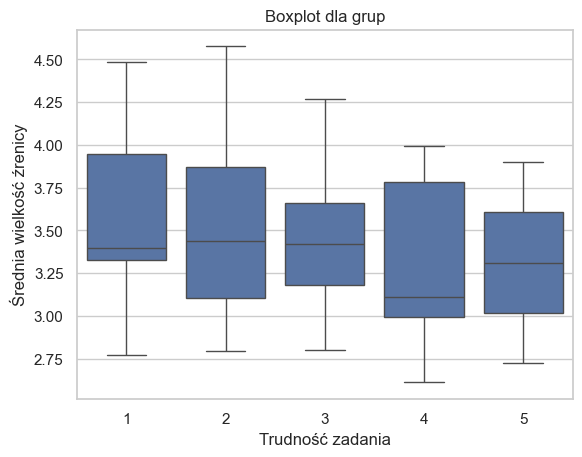

------------------------------
Kolekcja grafiki B: z poleceniem:


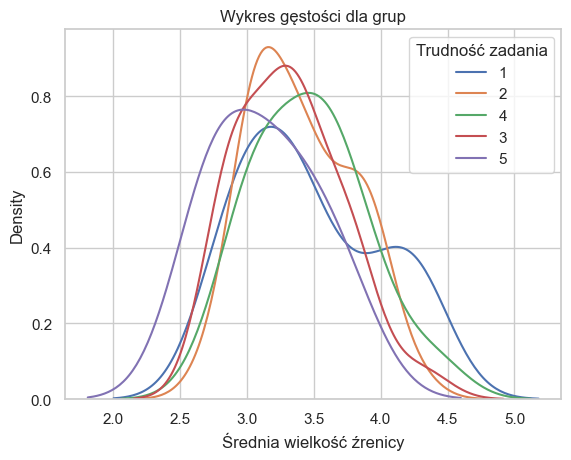

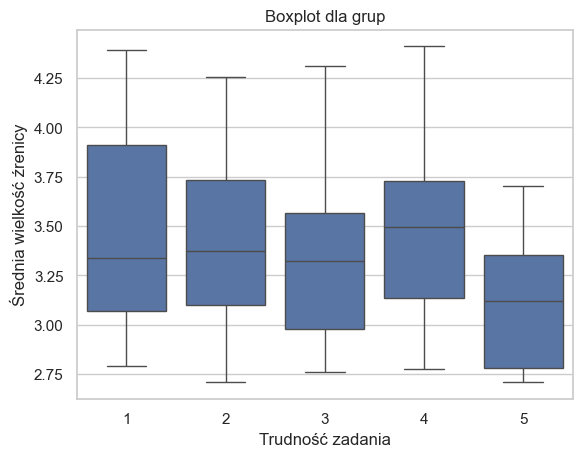

------------------------------
Kolekcja grafiki B: bez polecenia:


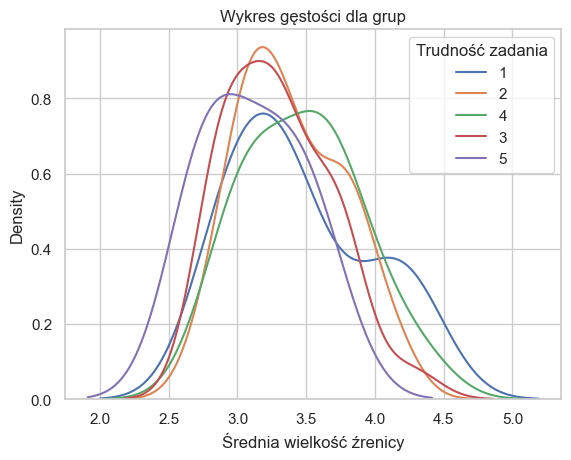

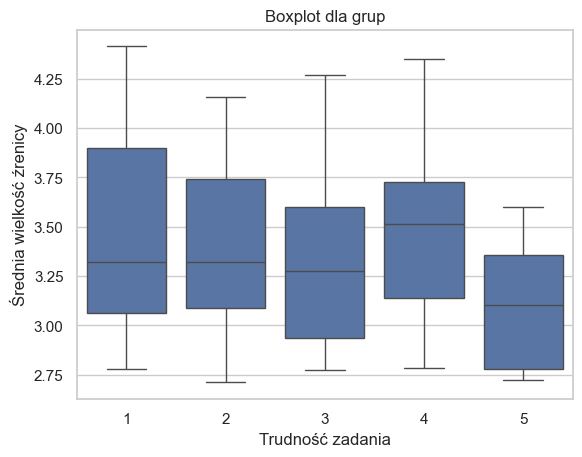

------------------------------
Kolekcja grafiki B: tylko polecenie:


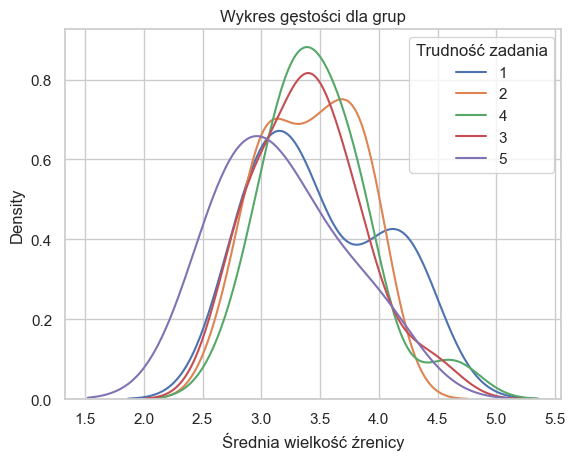

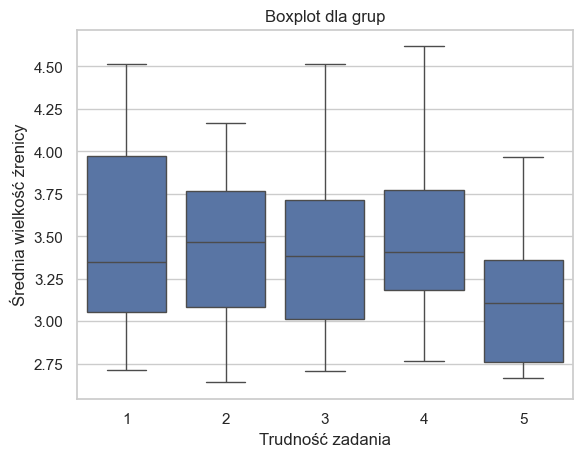

------------------------------
Kolekcja grafiki 1: z poleceniem:


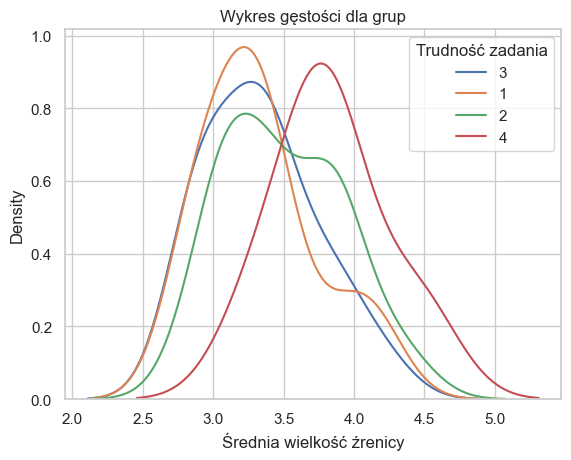

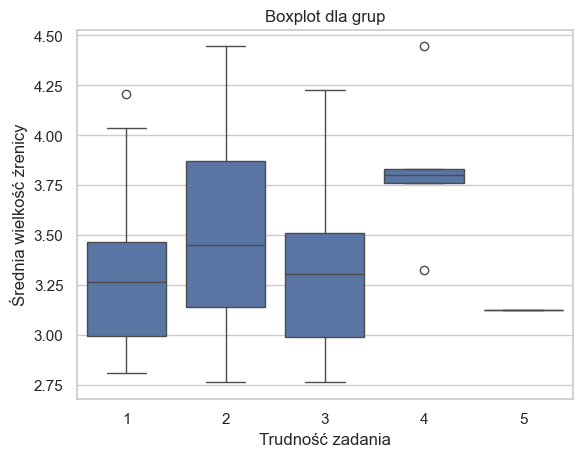

------------------------------
Kolekcja grafiki 1: bez polecenia:


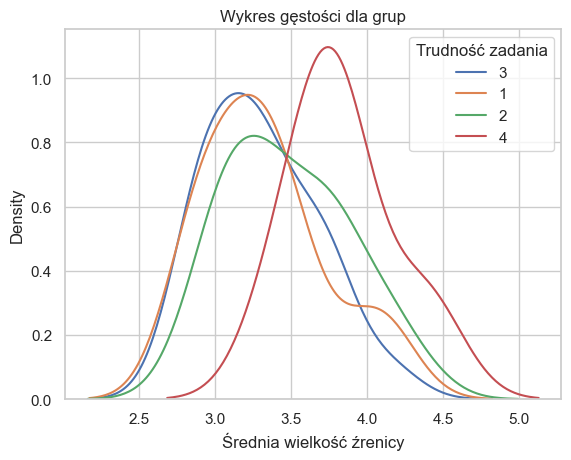

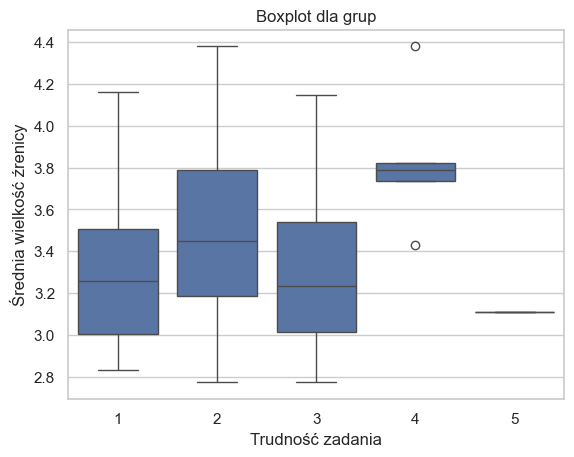

------------------------------
Kolekcja grafiki 1: tylko polecenie :


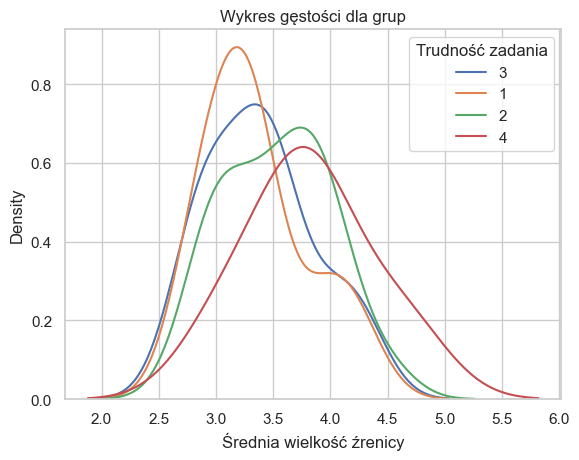

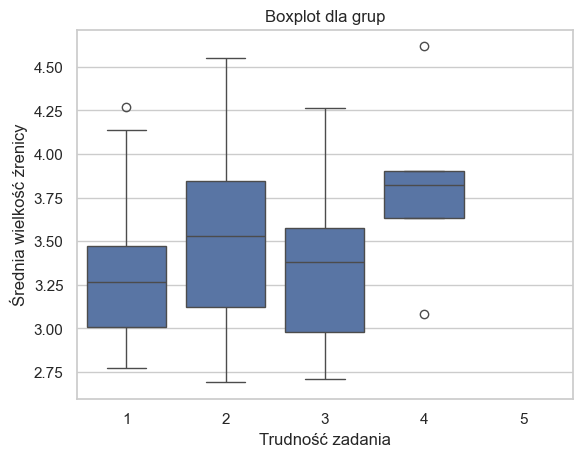

------------------------------
Kolekcja grafiki 2: z poleceniem:


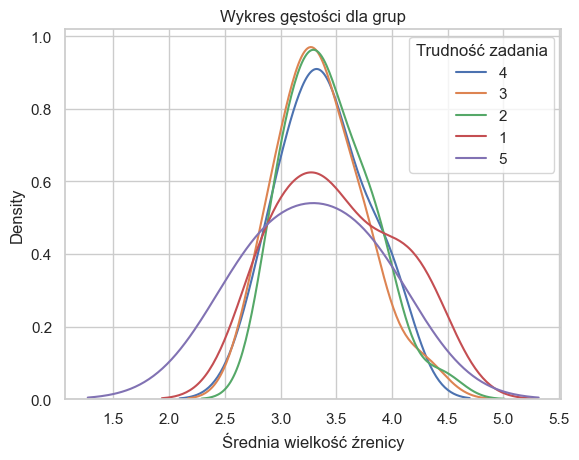

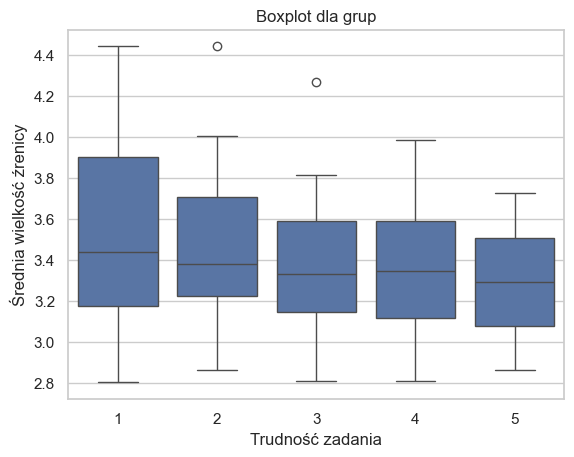

------------------------------
Kolekcja grafiki 2: bez polecenia:


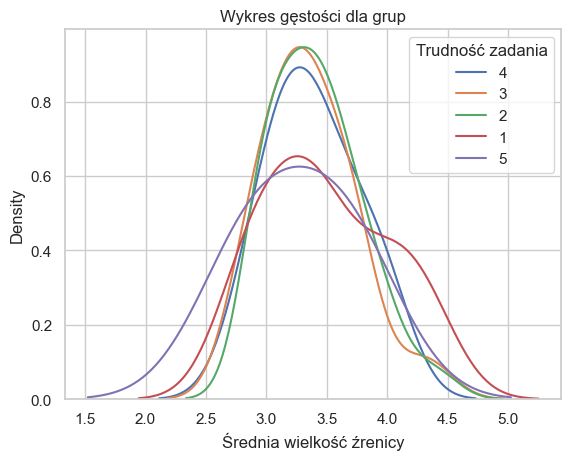

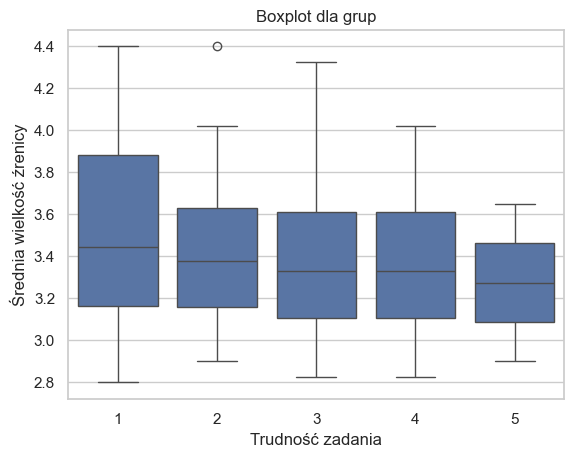

------------------------------
Kolekcja grafiki 2: tylko polecenie:


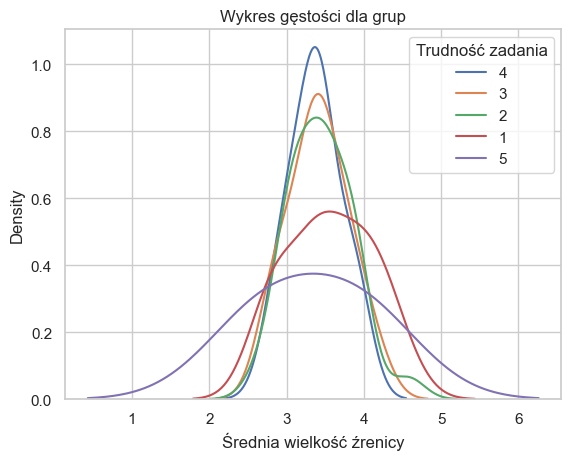

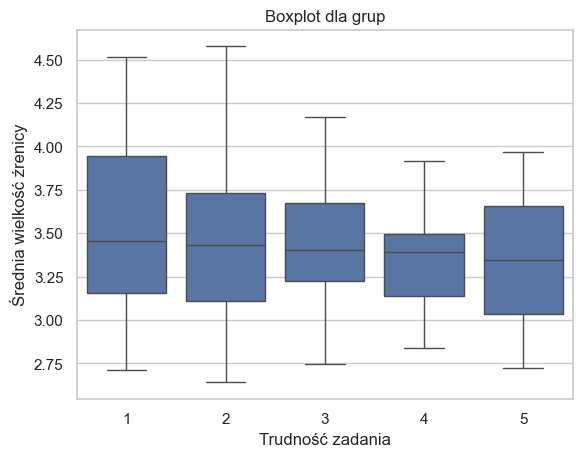

------------------------------
Kolekcja grafiki 3: z poleceniem:


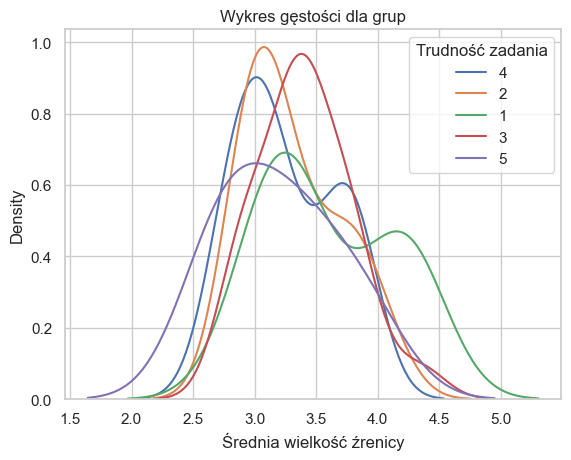

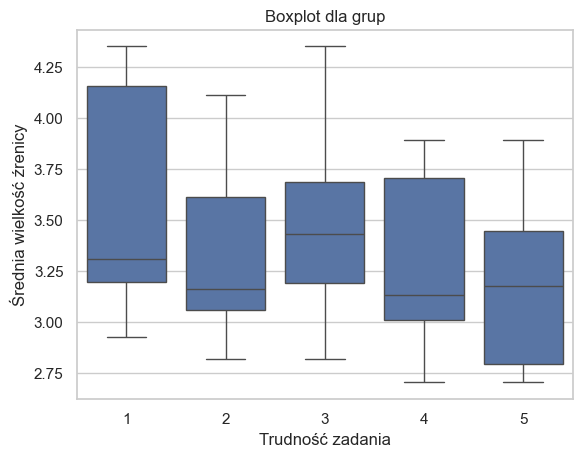

------------------------------
Kolekcja grafiki 3: bez polecenia:


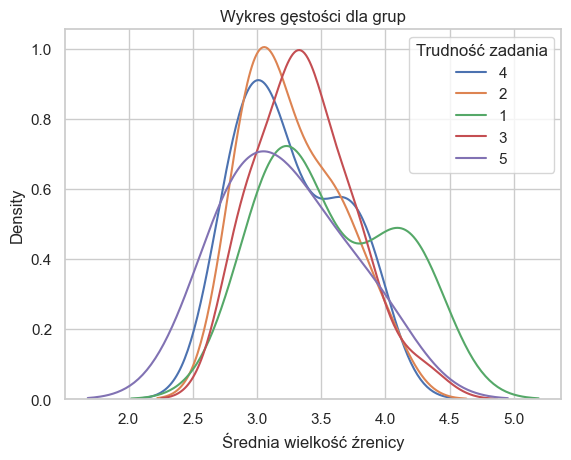

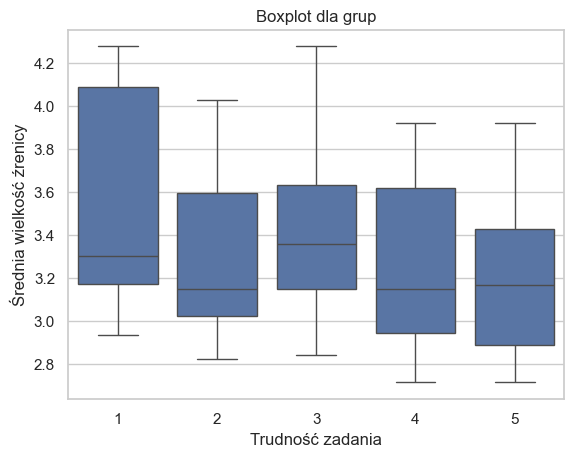

------------------------------
Kolekcja grafiki 3: tylko polecenie:


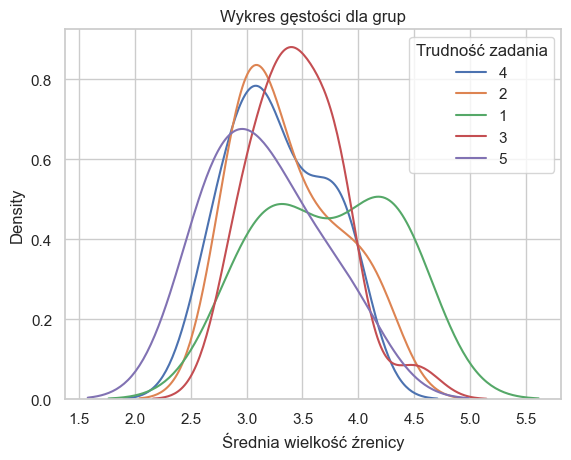

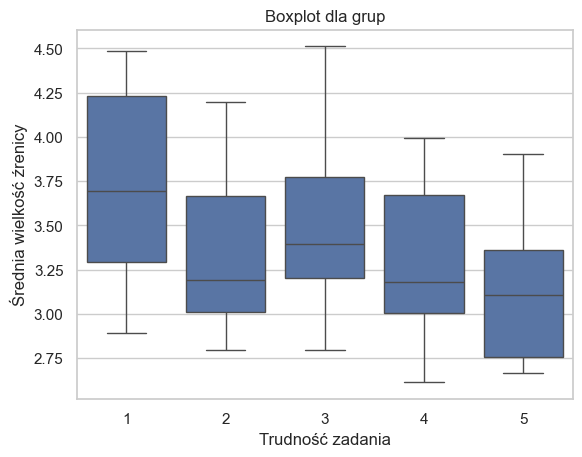

In [59]:
# kolekcje 
param_category = 'Diff'
for col in cols_continue:
    print('##########################################')
    print(col)
    for i, df in enumerate(dfs_coll):
        print('------------------------------')
        print(names_coll[i+1])
        plot_multi_density(df, col, param_category, cols_continue[col], 'Trudność zadania')
        plot_multi_boxplot(df, param_category, col, 'Trudność zadania', cols_continue[col])

##########################################
Total
------------------------------
Zsumowane wszystkie grafiki: z poleceniem:


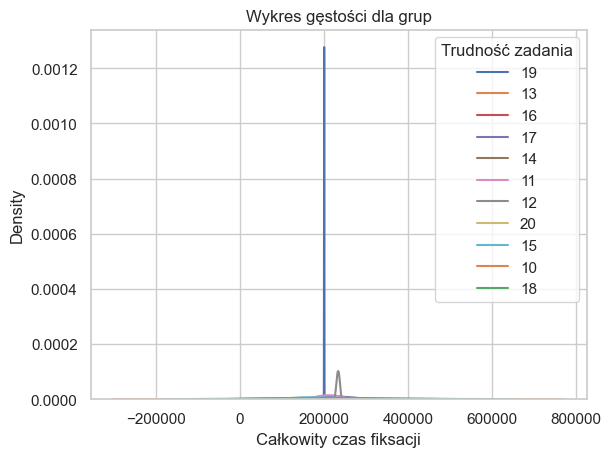

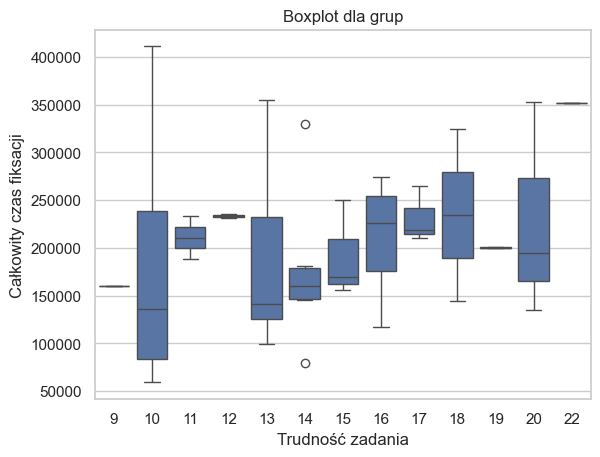

------------------------------
Zsumowane wszystkie grafiki: bez polecenia:


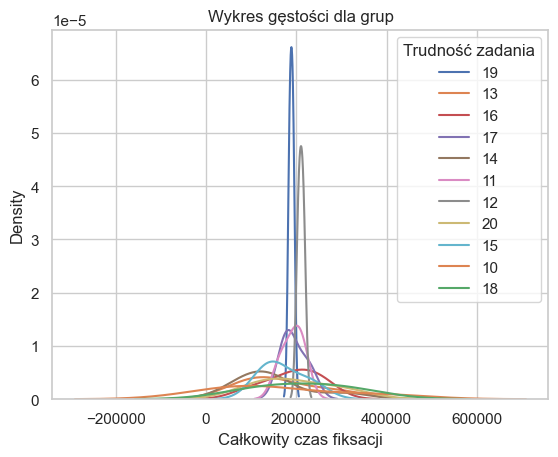

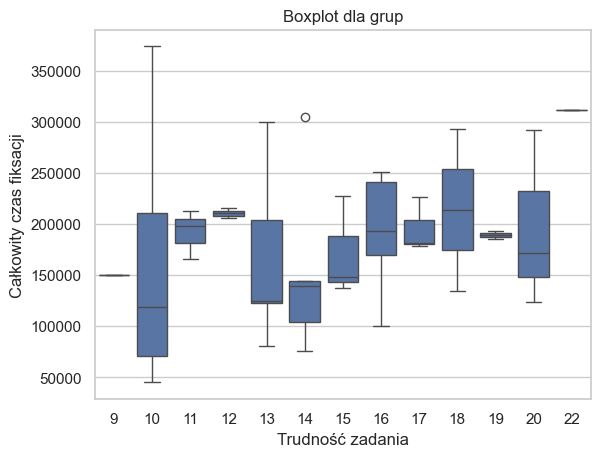

------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :


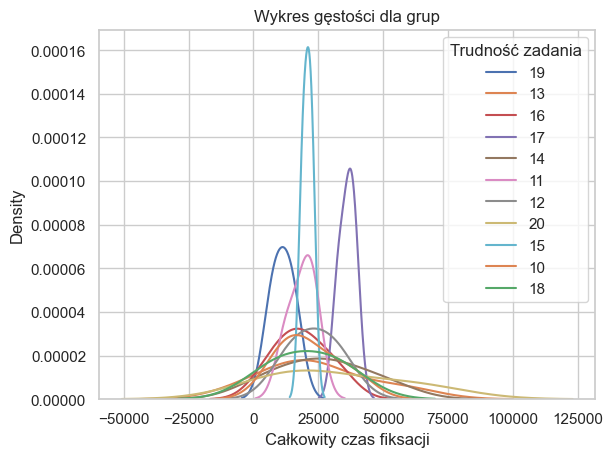

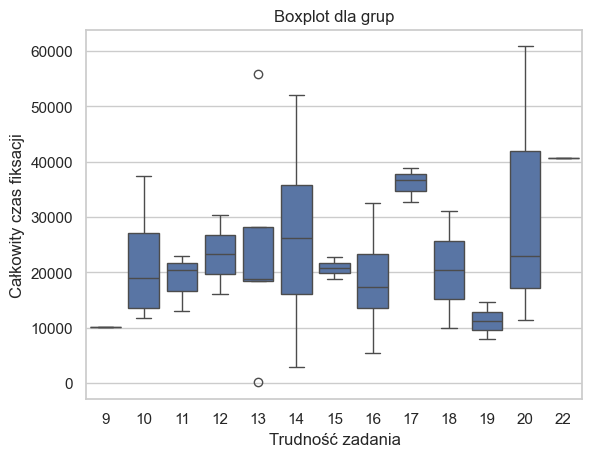

------------------------------
Zsumowane grafiki A: z poleceniem:


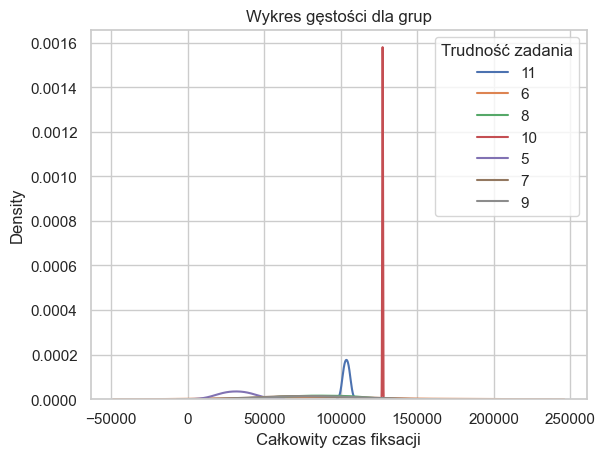

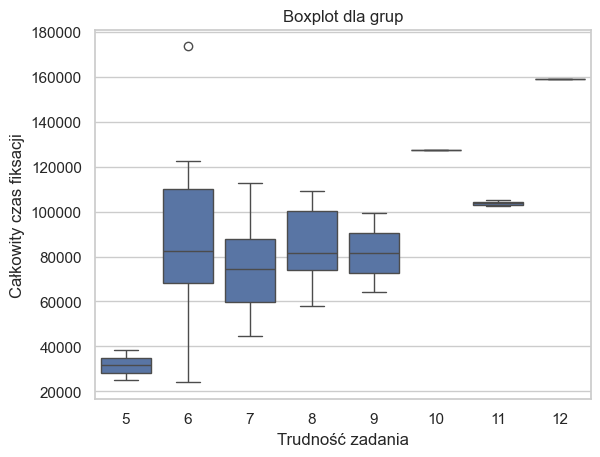

------------------------------
Zsumowane grafiki A: bez polecenia:


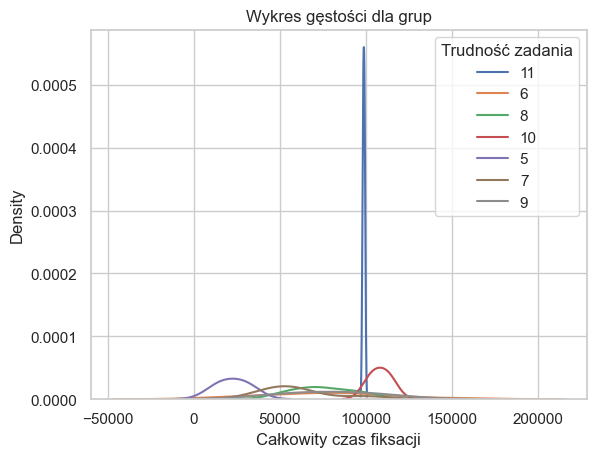

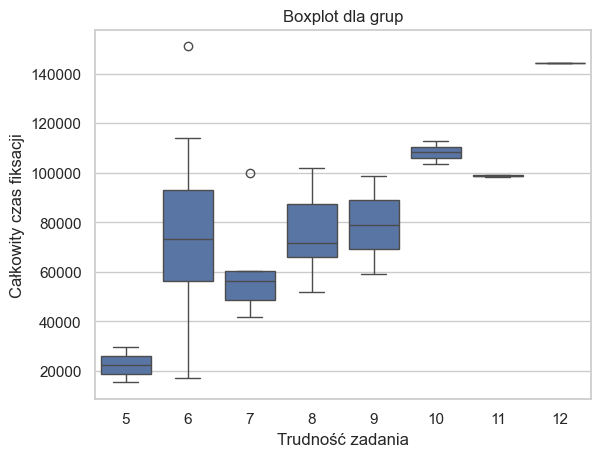

------------------------------
Zsumowane grafiki A: tylko polecenie :


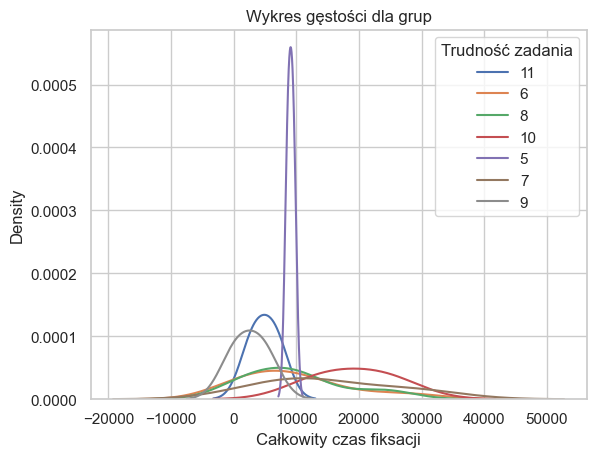

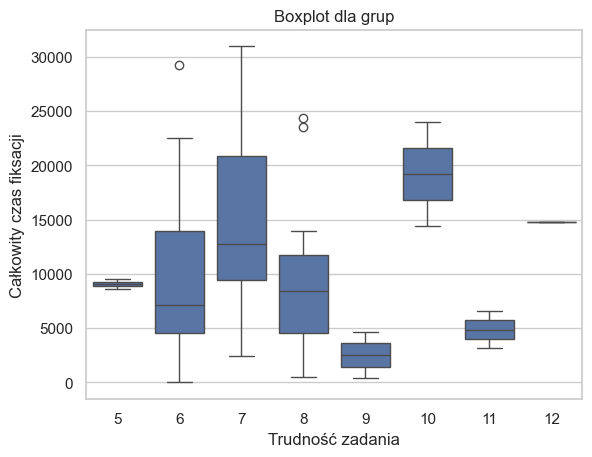

------------------------------
Zsumowane grafiki B: z poleceniem:


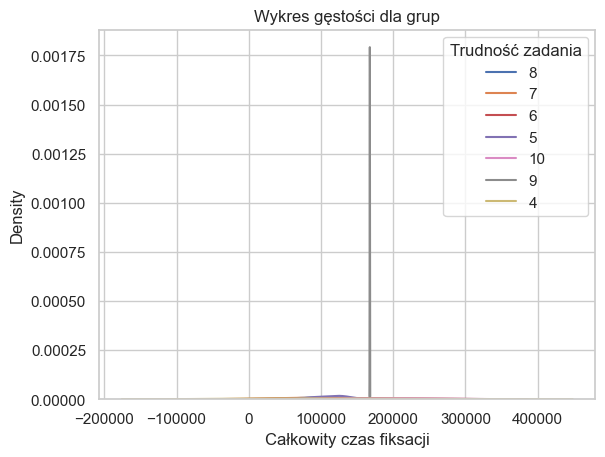

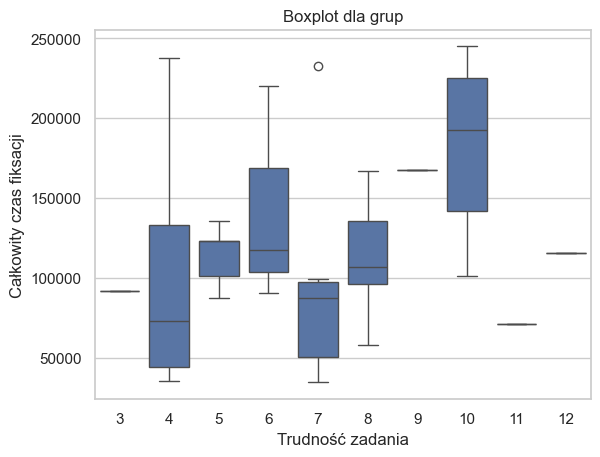

------------------------------
Zsumowane grafiki B: bez polecenia:


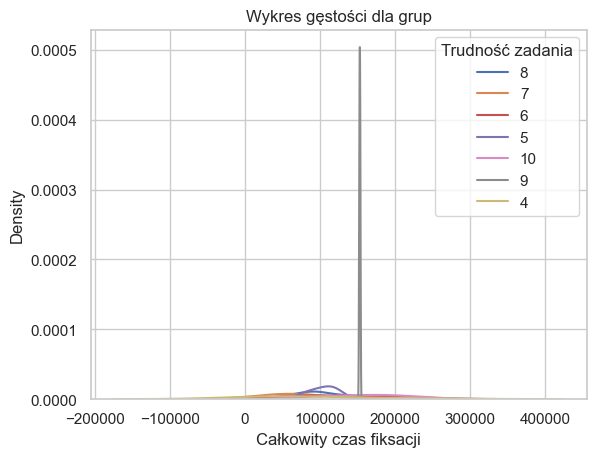

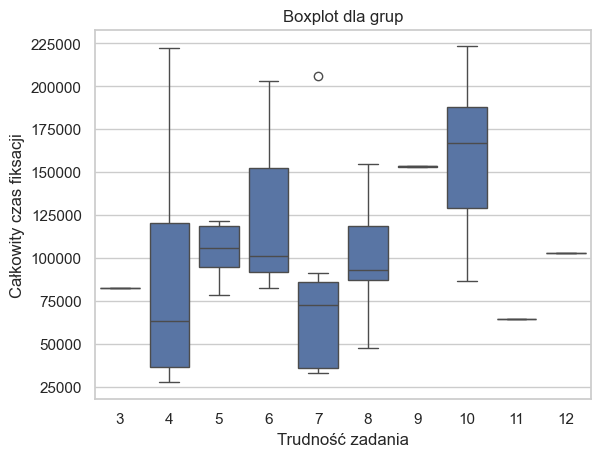

------------------------------
Zsumowane grafiki B: tylko polecenie :


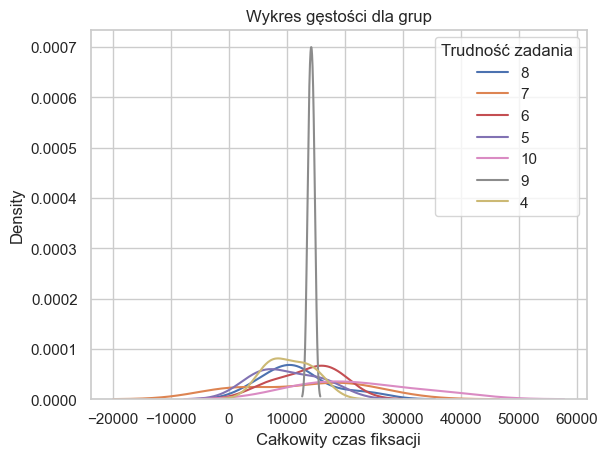

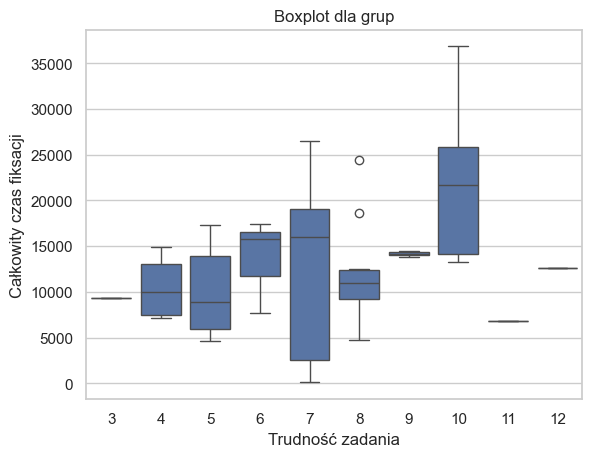

------------------------------
Zsumowane grafiki 1: z poleceniem:


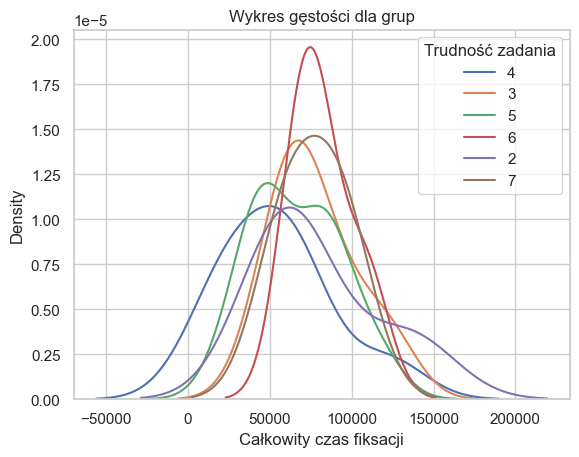

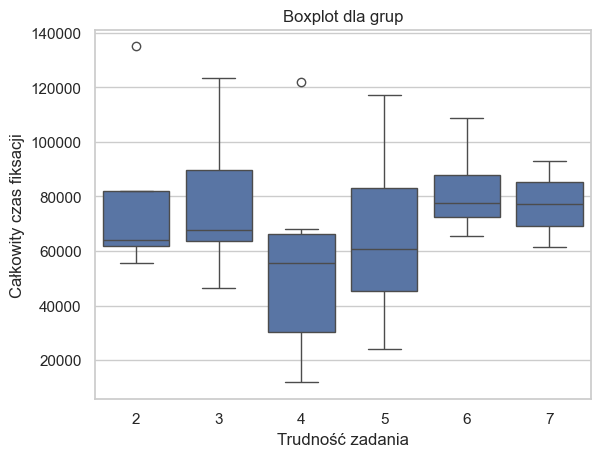

------------------------------
Zsumowane grafiki 1: bez polecenia:


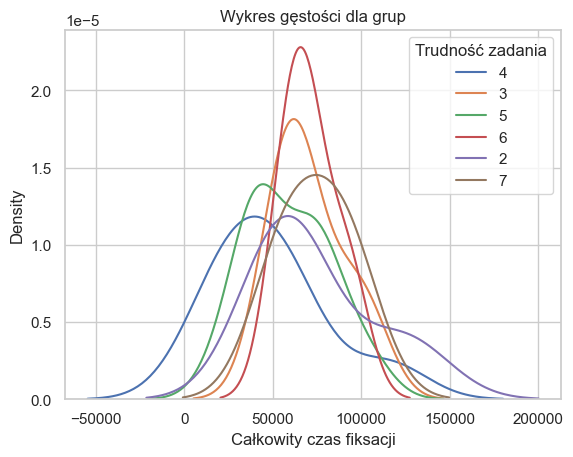

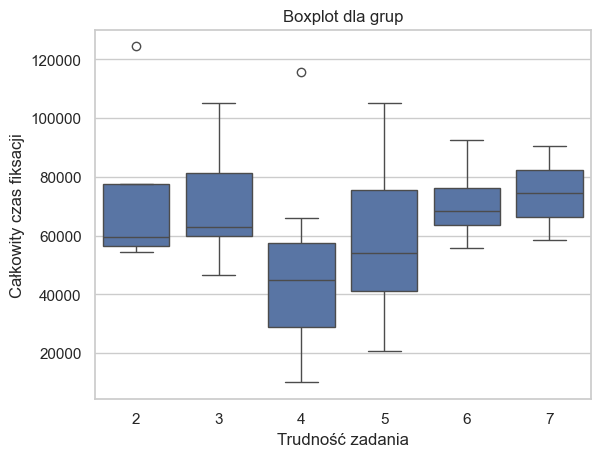

------------------------------
Zsumowane grafiki 1: tylko polecenie :


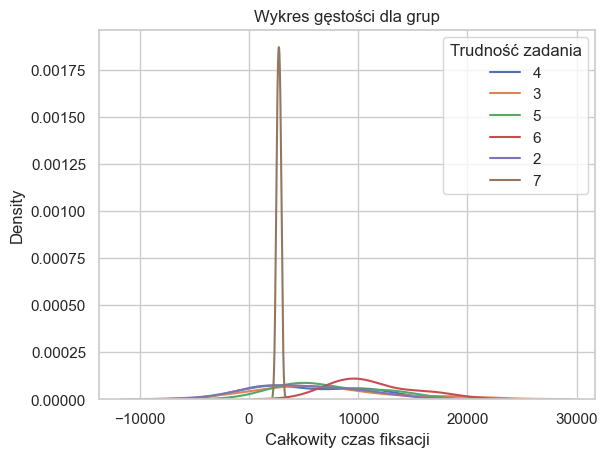

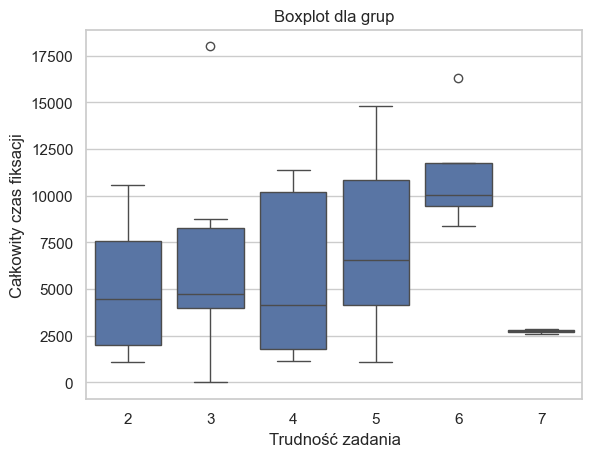

------------------------------
Zsumowane grafiki 2: z poleceniem:


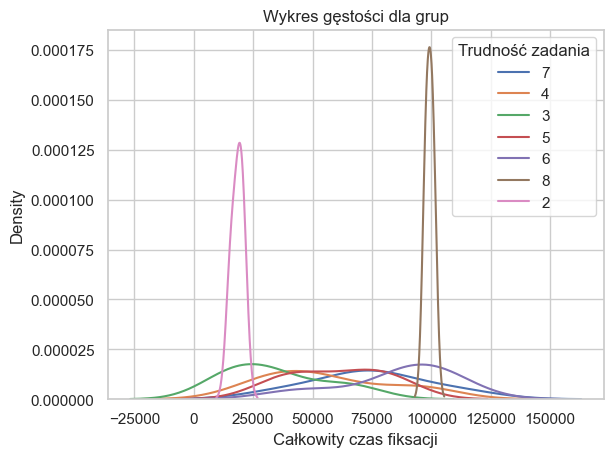

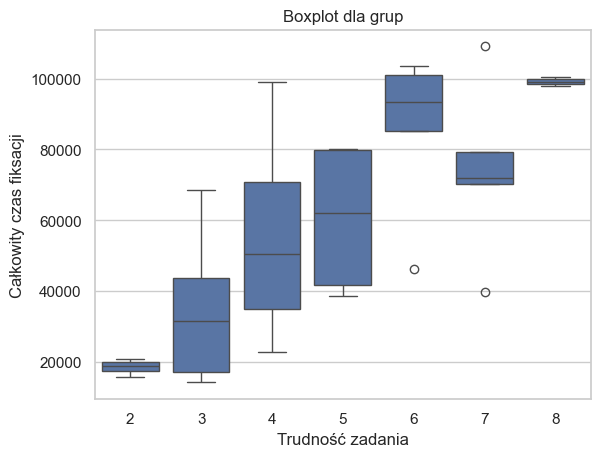

------------------------------
Zsumowane grafiki 2: bez polecenia:


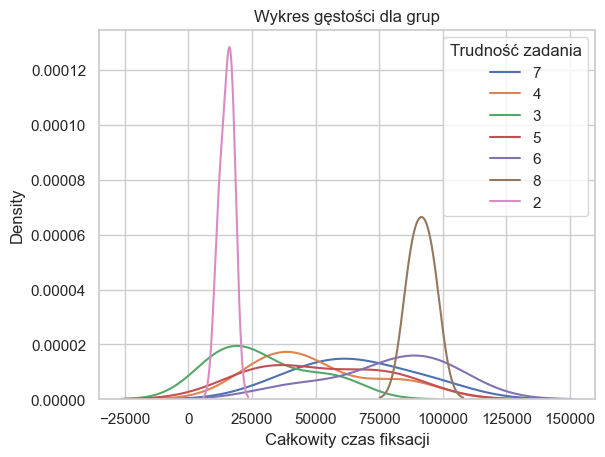

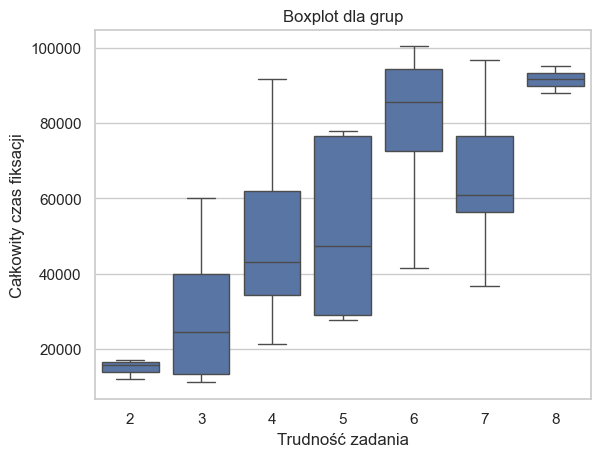

------------------------------
Zsumowane grafiki 2: tylko polecenie :


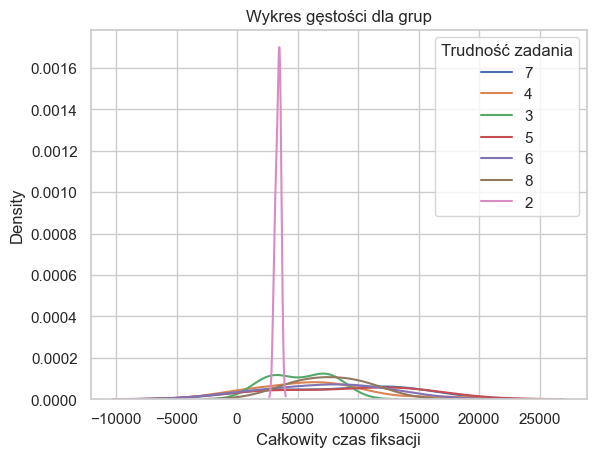

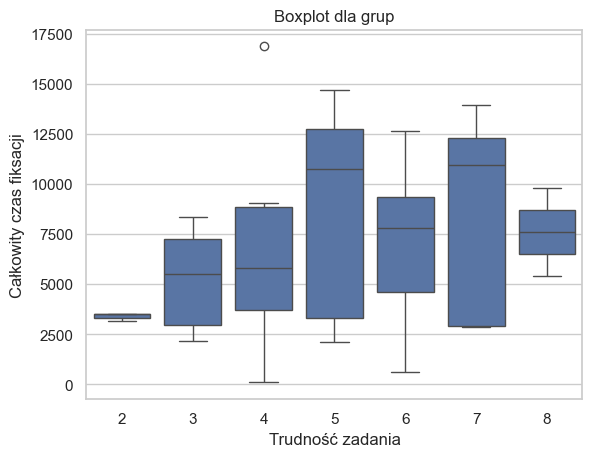

------------------------------
Zsumowane grafiki 3: z poleceniem:


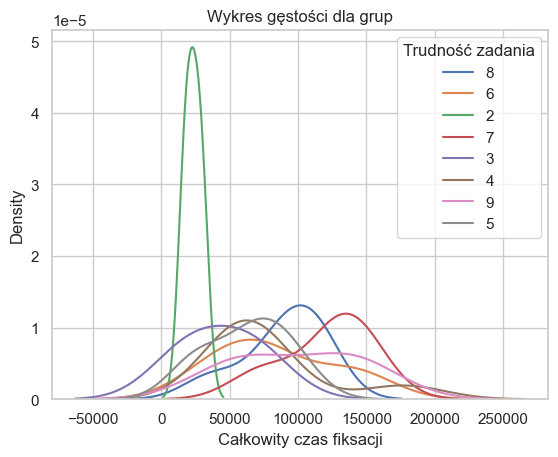

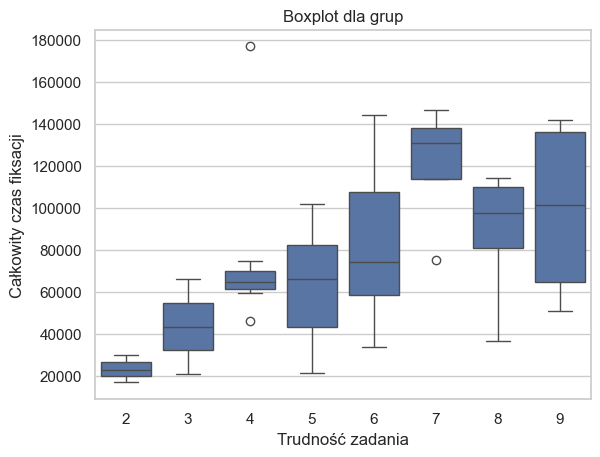

------------------------------
Zsumowane grafiki 3: bez polecenia:


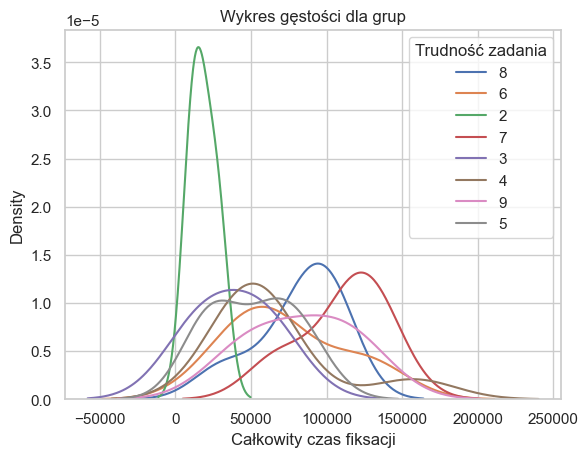

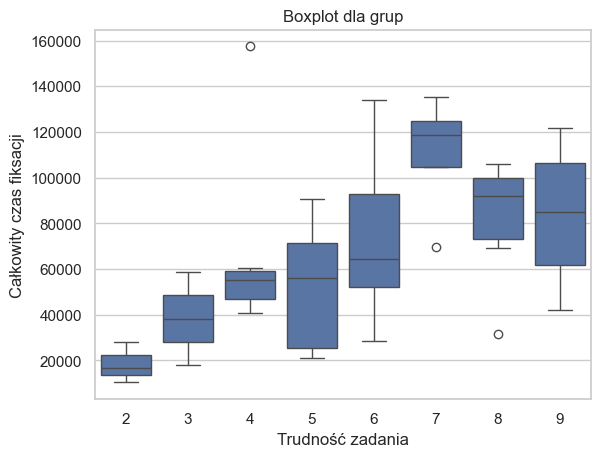

------------------------------
Zsumowane grafiki 3: tylko polecenie :


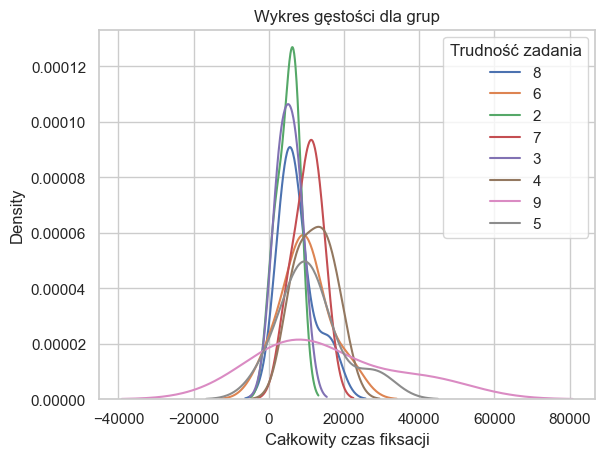

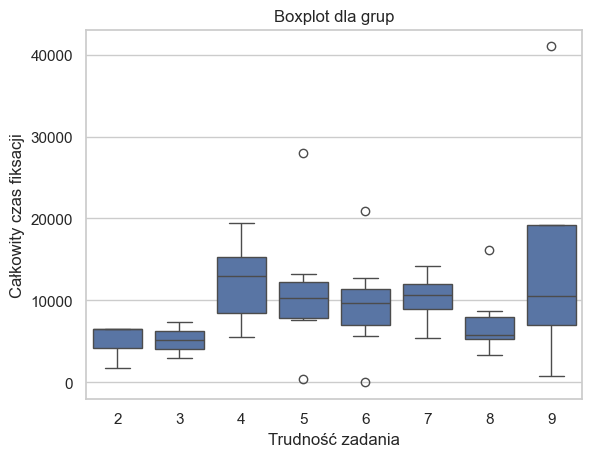

##########################################
Avg
------------------------------
Zsumowane wszystkie grafiki: z poleceniem:


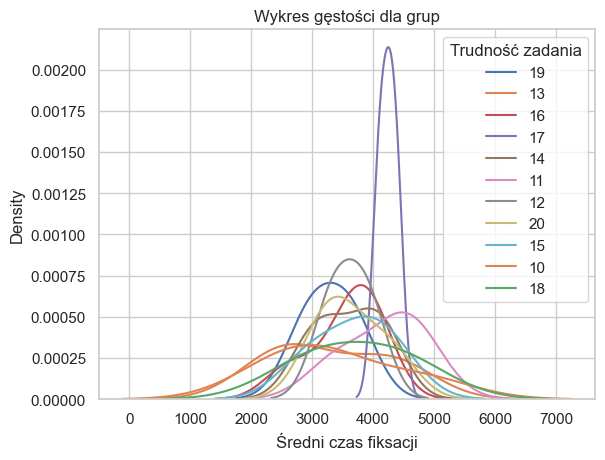

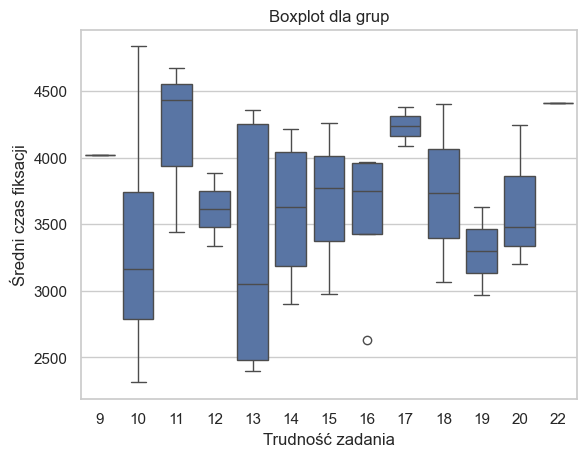

------------------------------
Zsumowane wszystkie grafiki: bez polecenia:


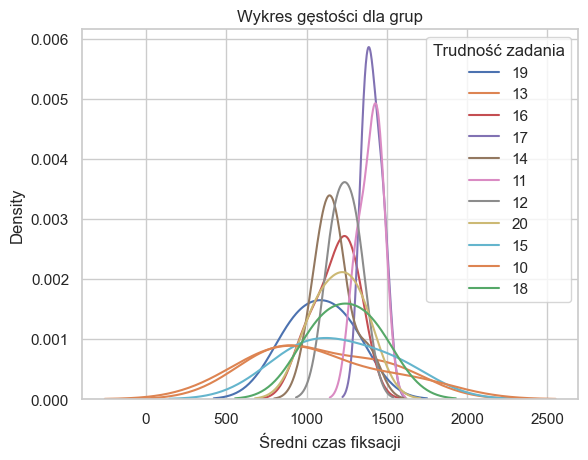

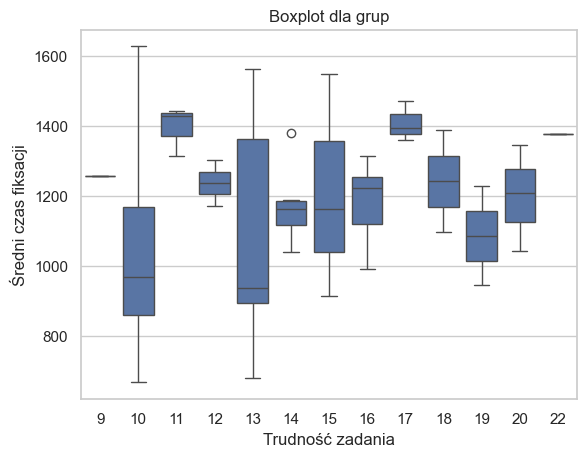

------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :


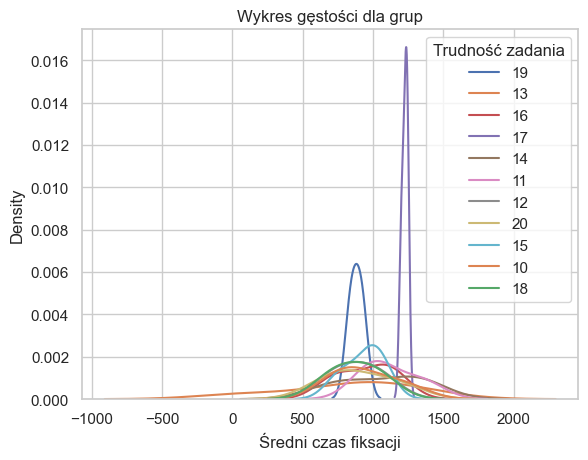

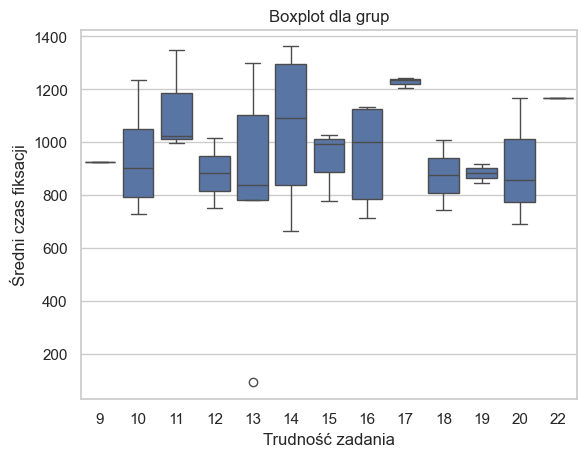

------------------------------
Zsumowane grafiki A: z poleceniem:


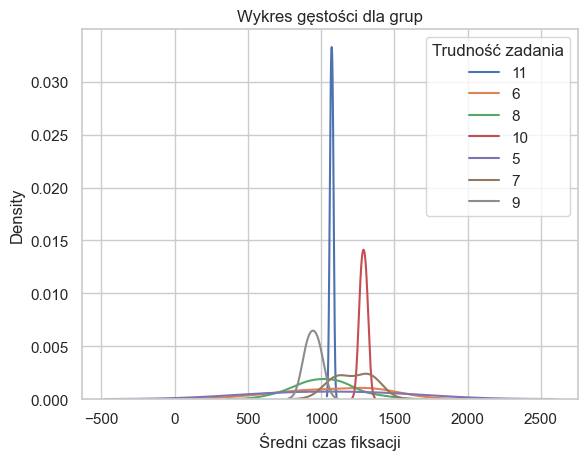

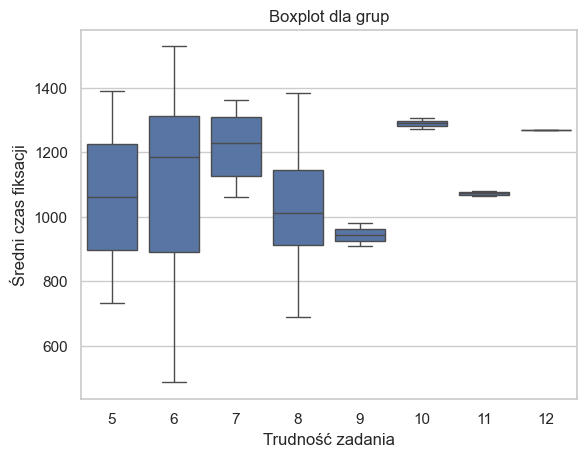

------------------------------
Zsumowane grafiki A: bez polecenia:


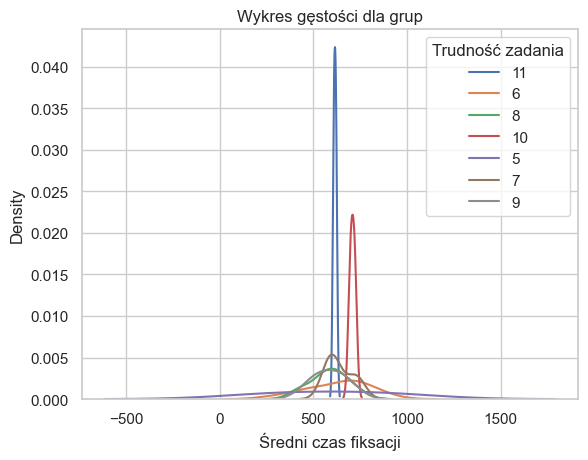

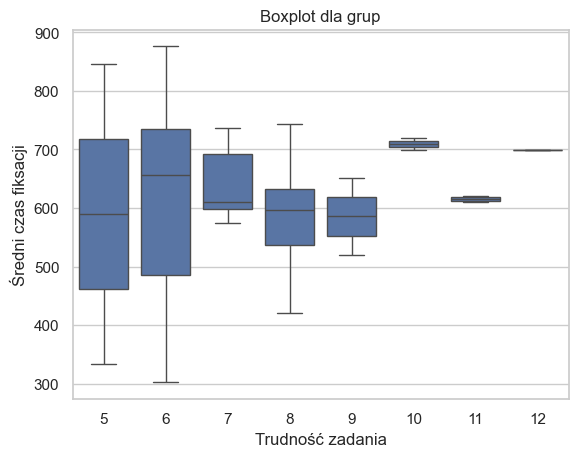

------------------------------
Zsumowane grafiki A: tylko polecenie :


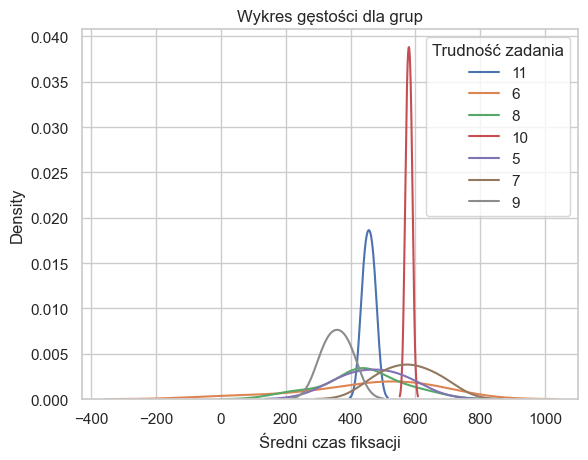

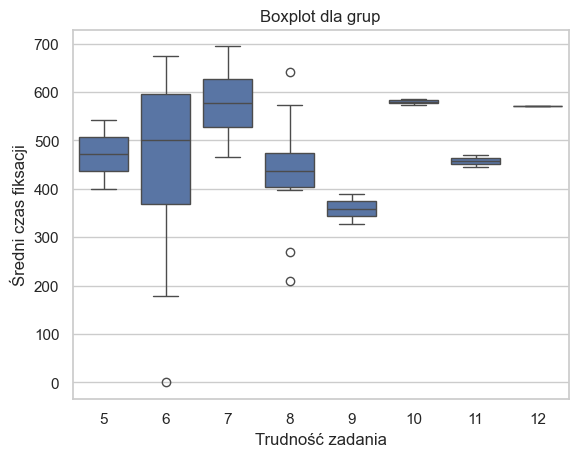

------------------------------
Zsumowane grafiki B: z poleceniem:


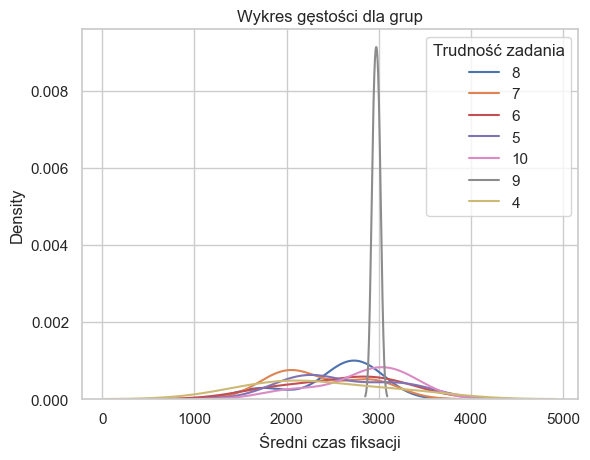

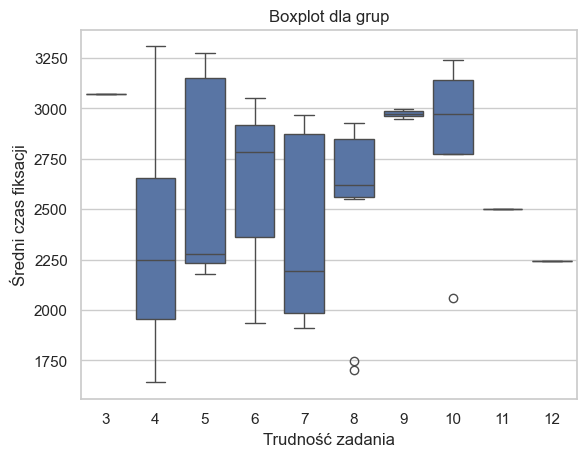

------------------------------
Zsumowane grafiki B: bez polecenia:


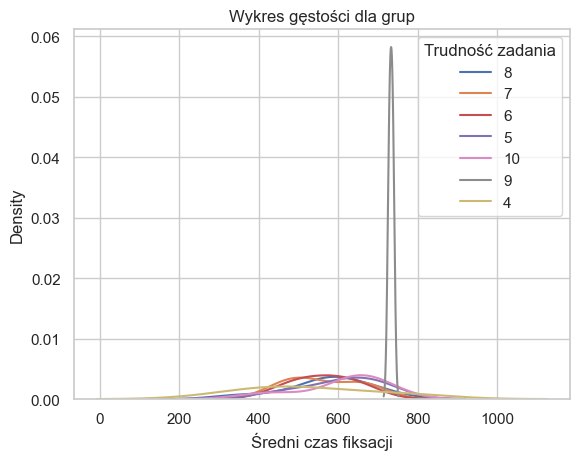

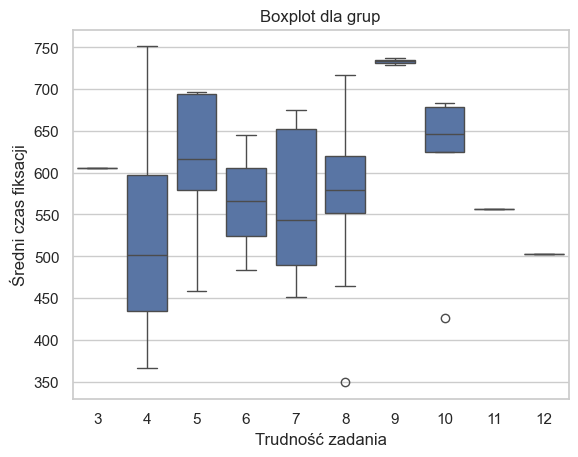

------------------------------
Zsumowane grafiki B: tylko polecenie :


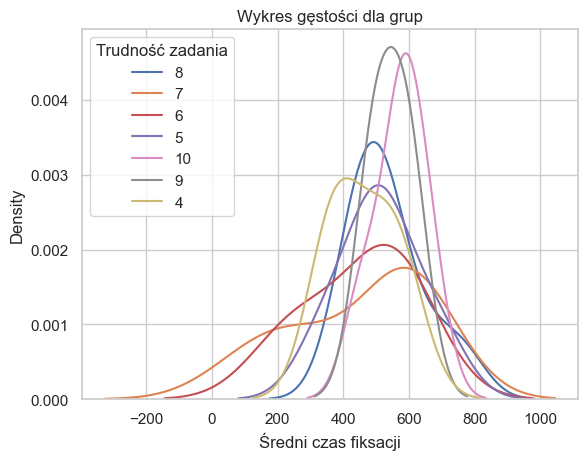

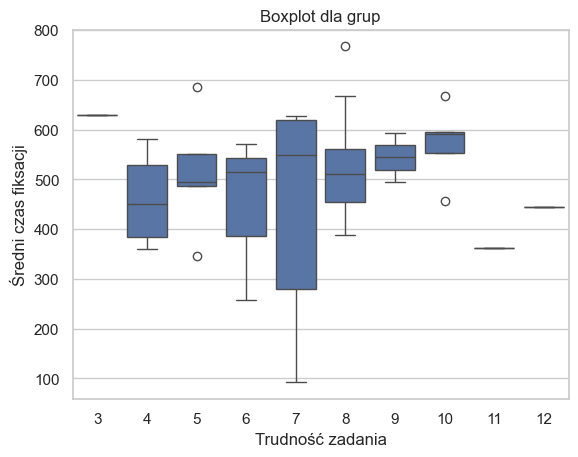

------------------------------
Zsumowane grafiki 1: z poleceniem:


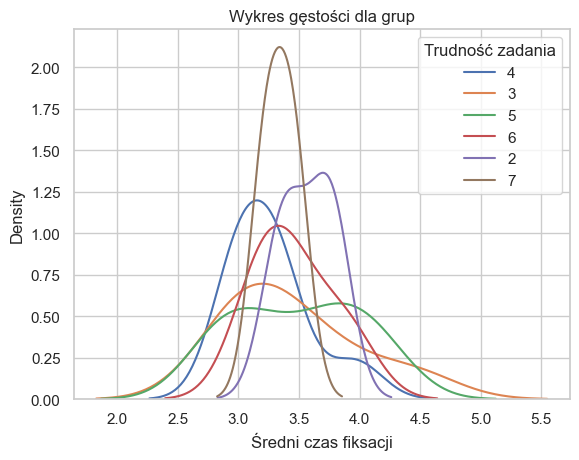

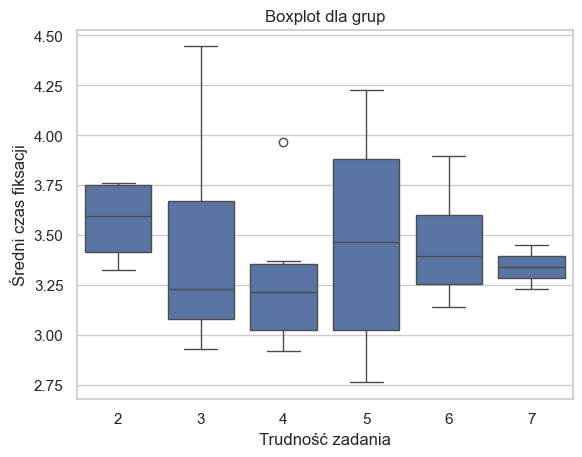

------------------------------
Zsumowane grafiki 1: bez polecenia:


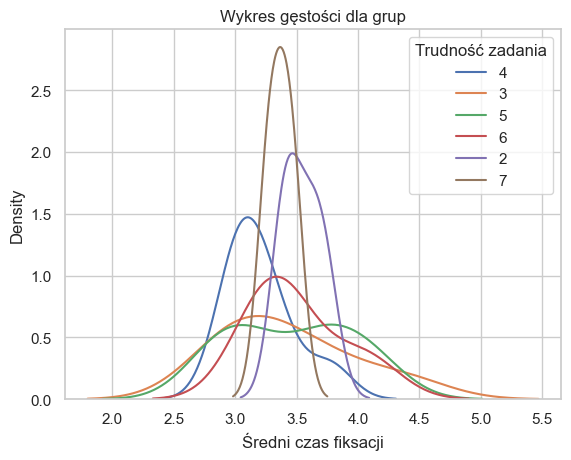

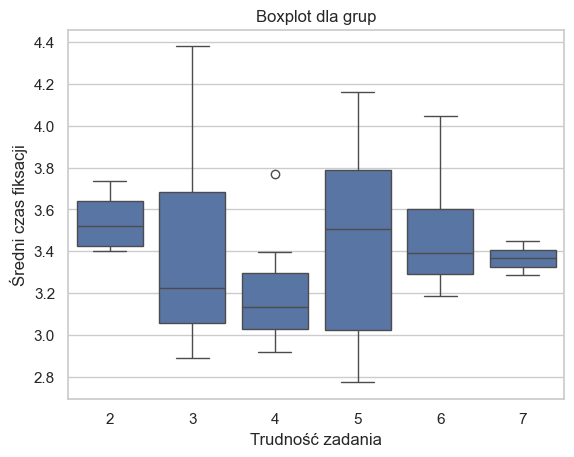

------------------------------
Zsumowane grafiki 1: tylko polecenie :


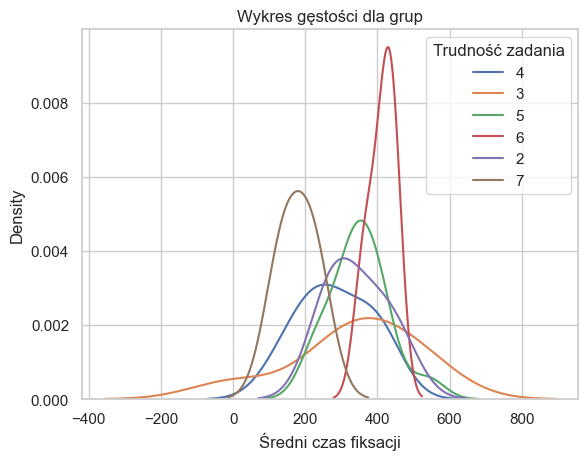

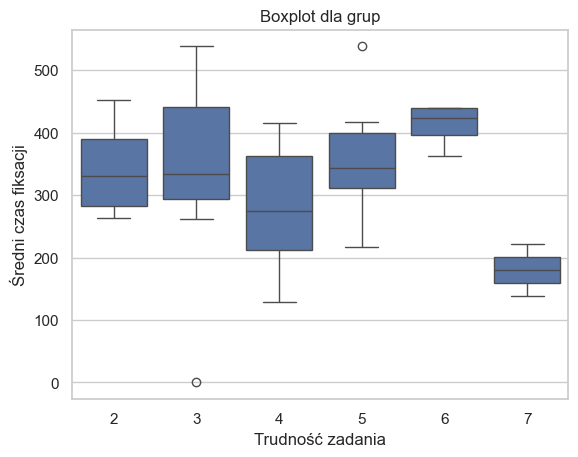

------------------------------
Zsumowane grafiki 2: z poleceniem:


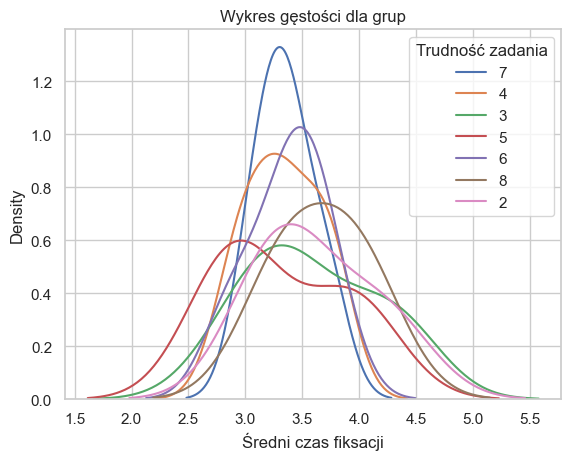

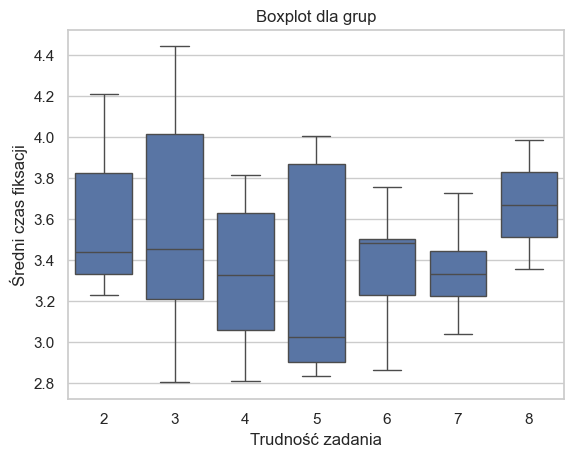

------------------------------
Zsumowane grafiki 2: bez polecenia:


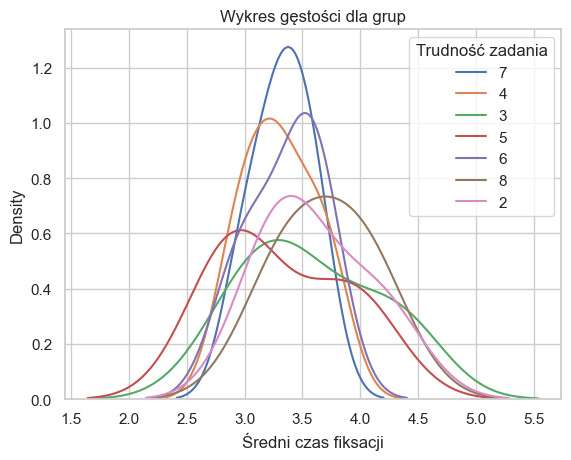

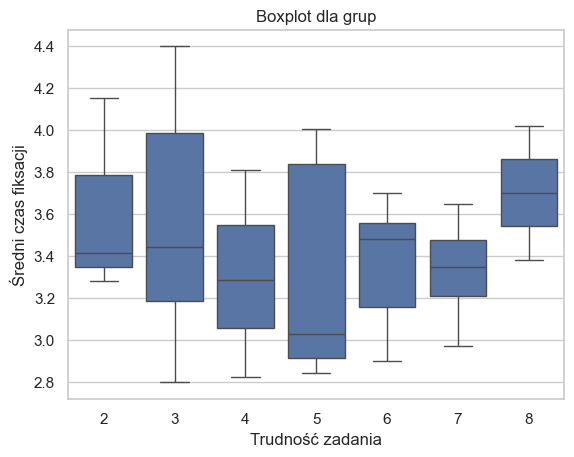

------------------------------
Zsumowane grafiki 2: tylko polecenie :


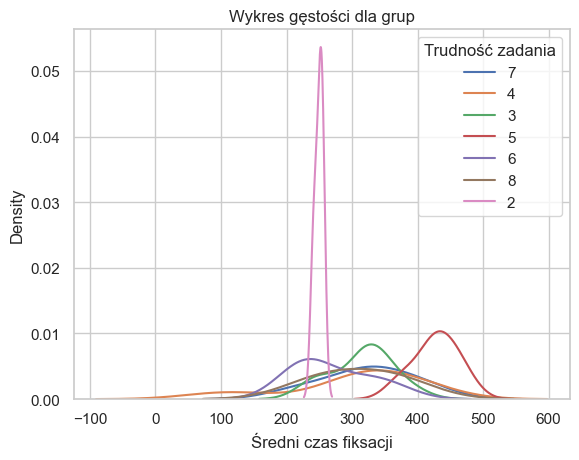

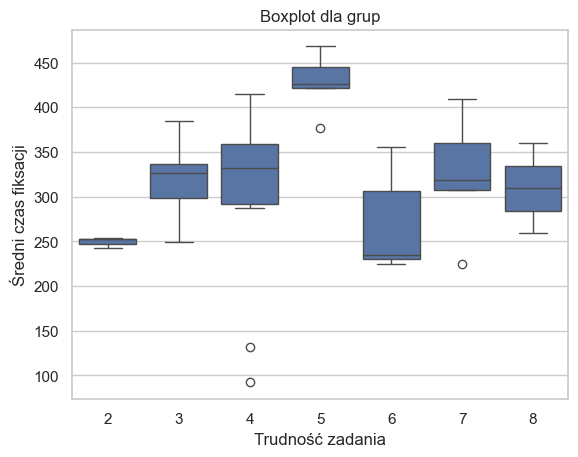

------------------------------
Zsumowane grafiki 3: z poleceniem:


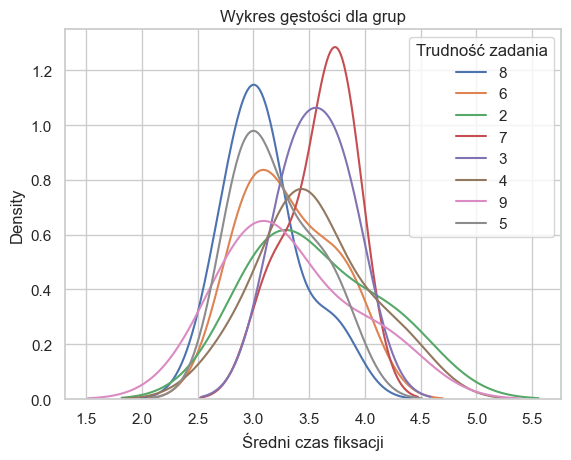

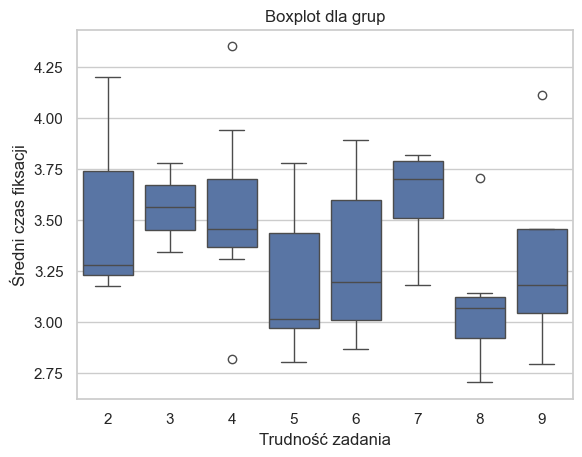

------------------------------
Zsumowane grafiki 3: bez polecenia:


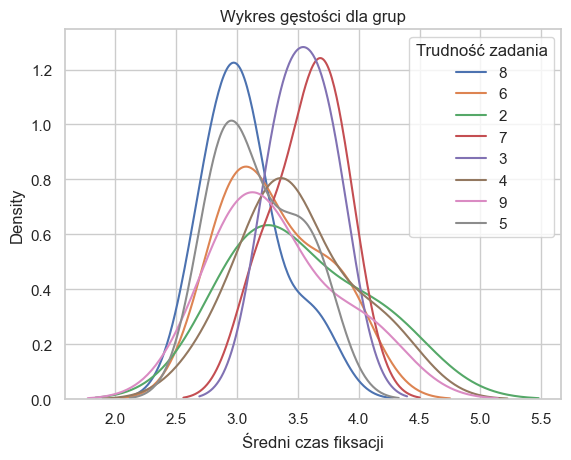

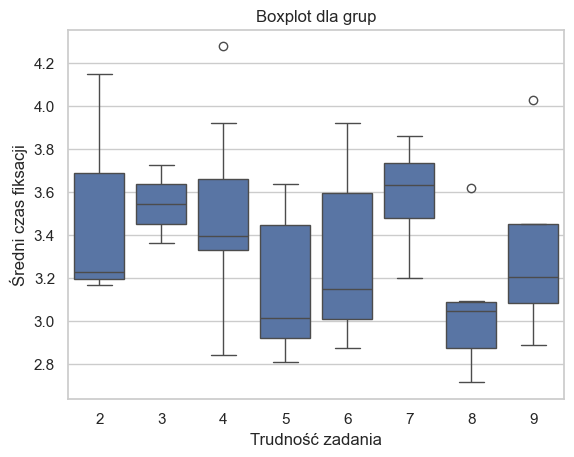

------------------------------
Zsumowane grafiki 3: tylko polecenie :


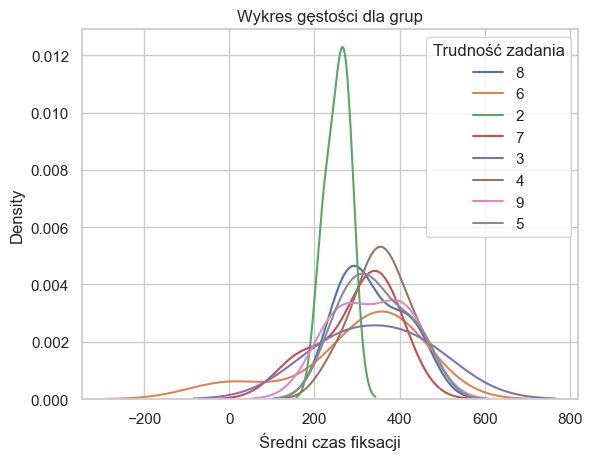

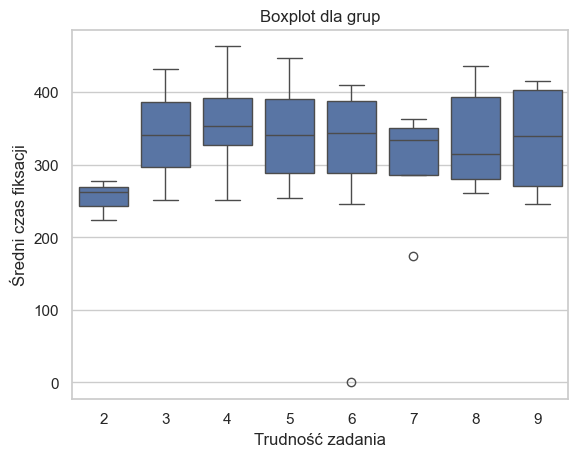

##########################################
Avg_pupil
------------------------------
Zsumowane wszystkie grafiki: z poleceniem:


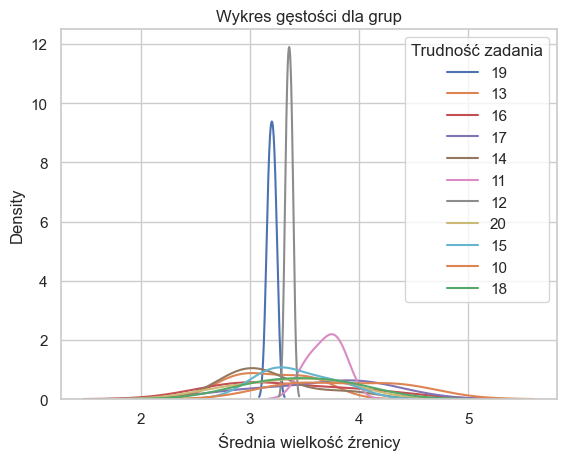

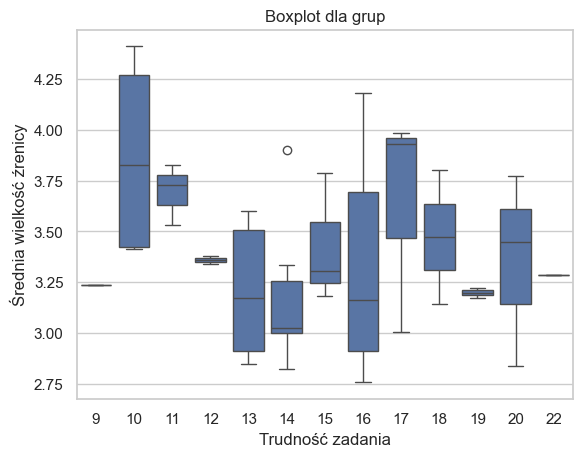

------------------------------
Zsumowane wszystkie grafiki: bez polecenia:


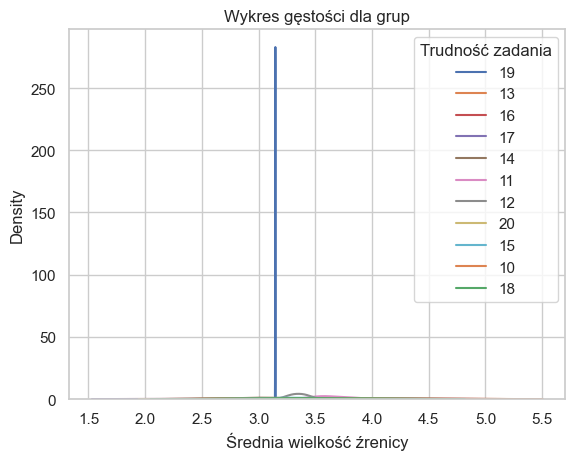

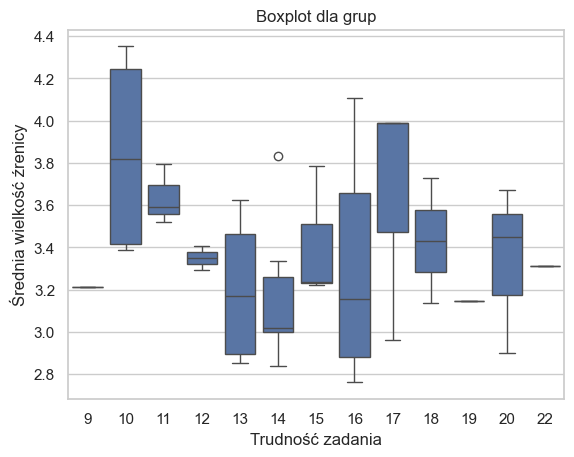

------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :


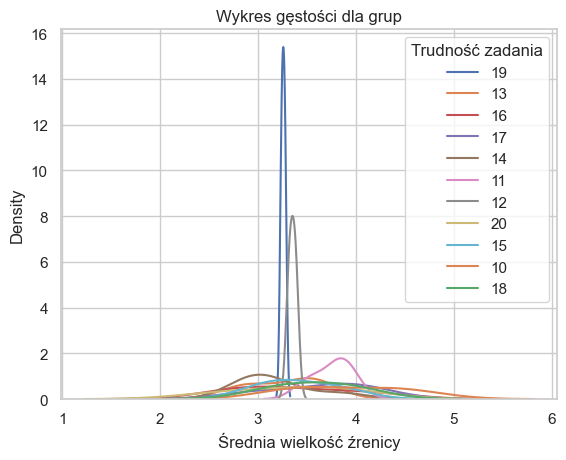

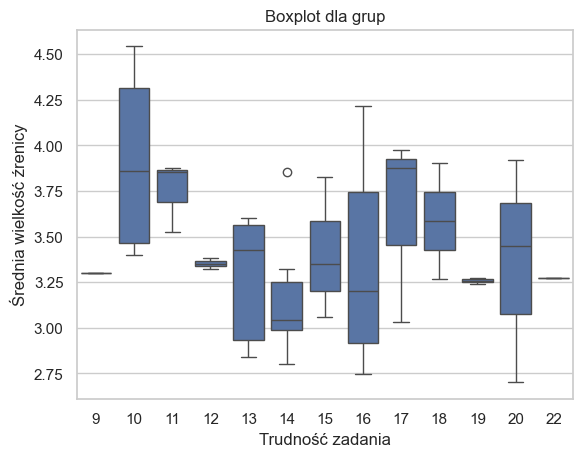

------------------------------
Zsumowane grafiki A: z poleceniem:


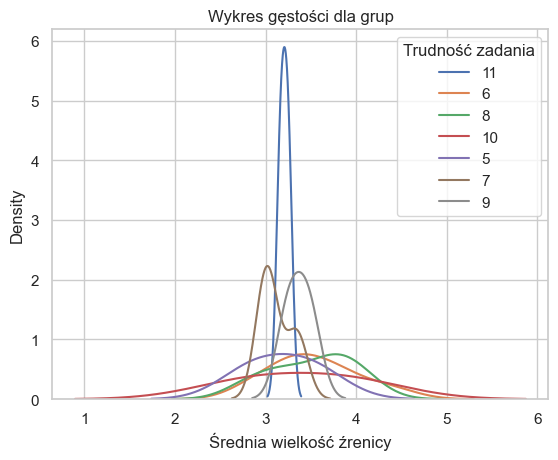

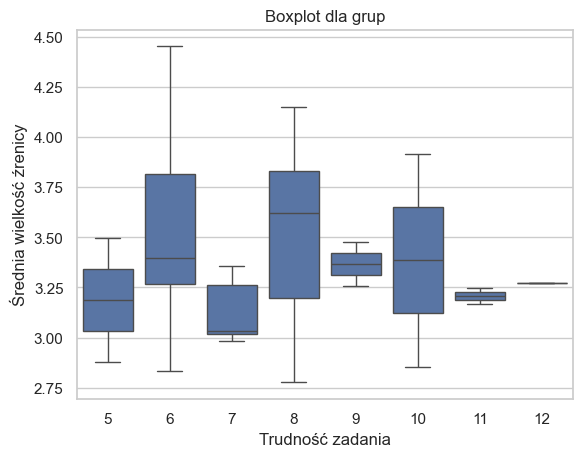

------------------------------
Zsumowane grafiki A: bez polecenia:


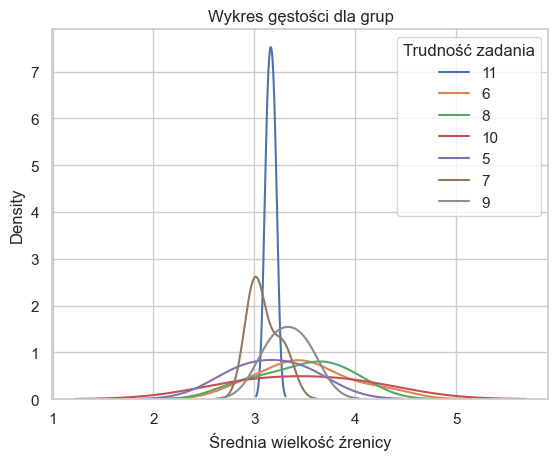

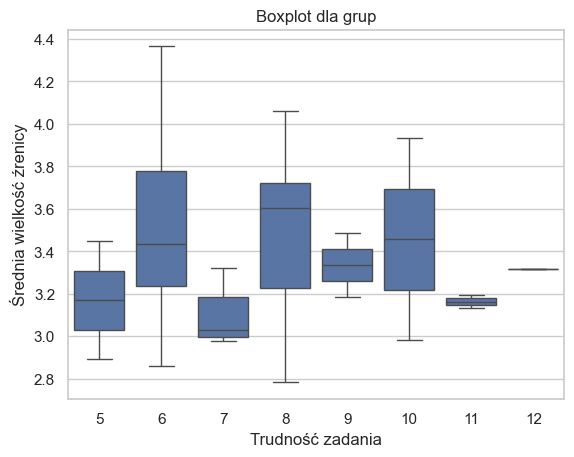

------------------------------
Zsumowane grafiki A: tylko polecenie :


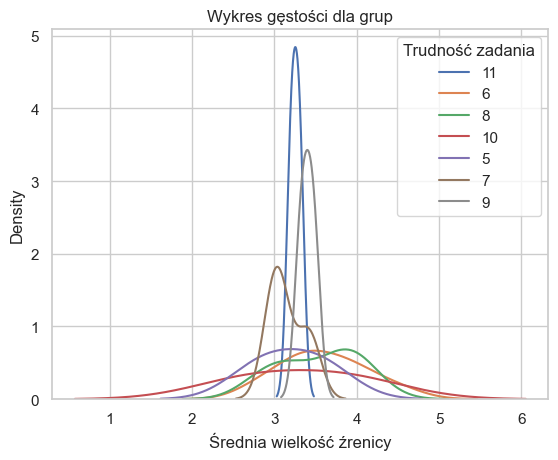

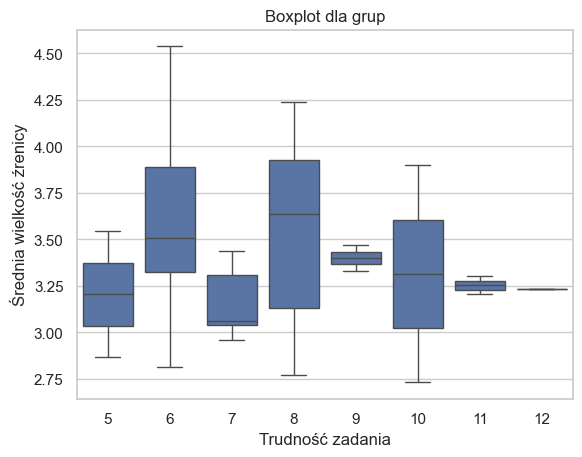

------------------------------
Zsumowane grafiki B: z poleceniem:


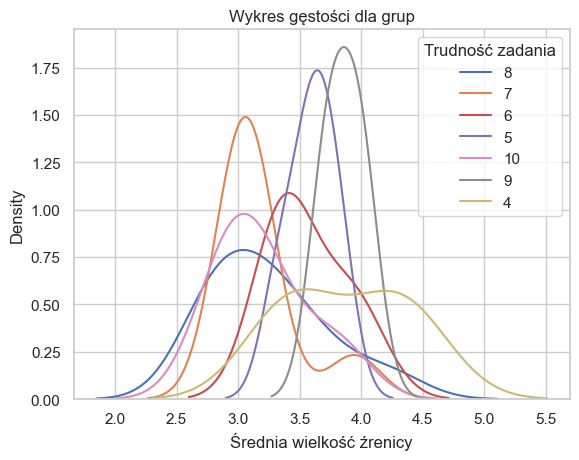

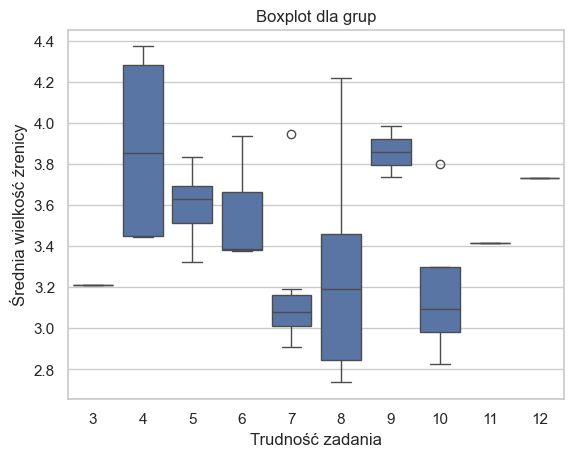

------------------------------
Zsumowane grafiki B: bez polecenia:


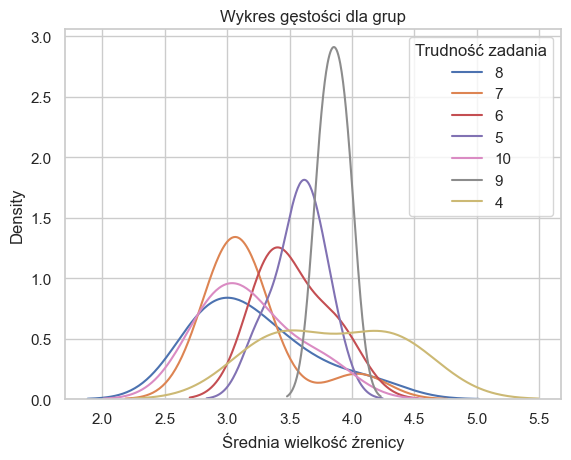

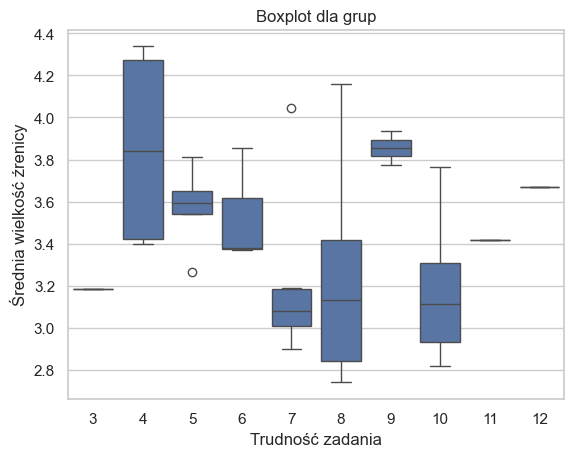

------------------------------
Zsumowane grafiki B: tylko polecenie :


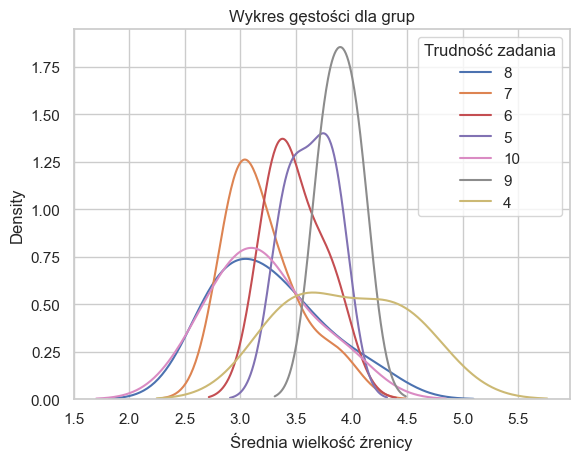

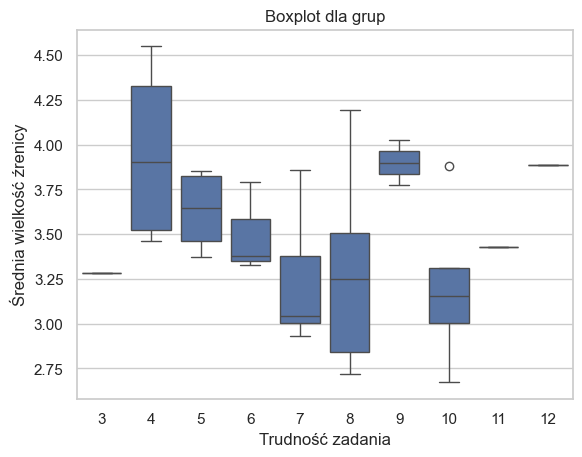

------------------------------
Zsumowane grafiki 1: z poleceniem:


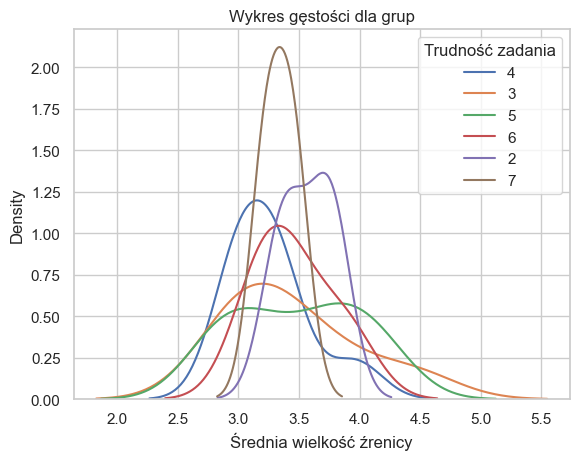

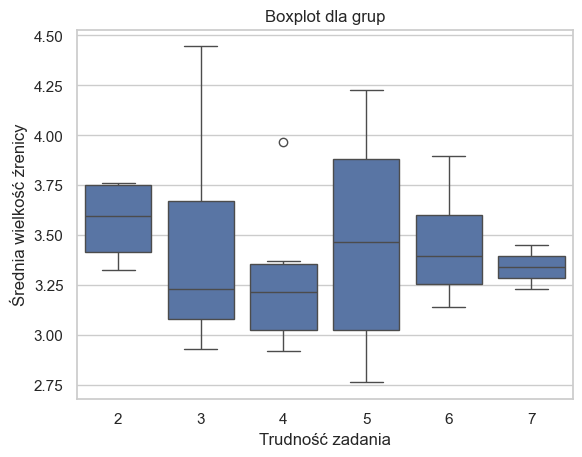

------------------------------
Zsumowane grafiki 1: bez polecenia:


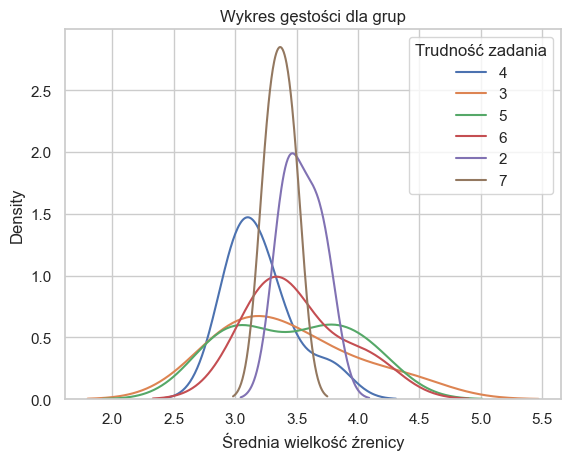

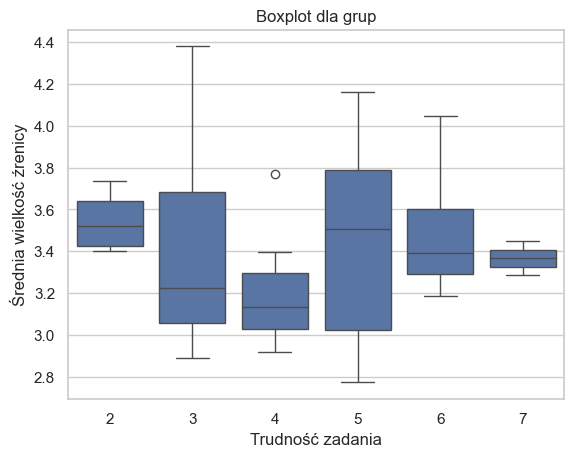

------------------------------
Zsumowane grafiki 1: tylko polecenie :


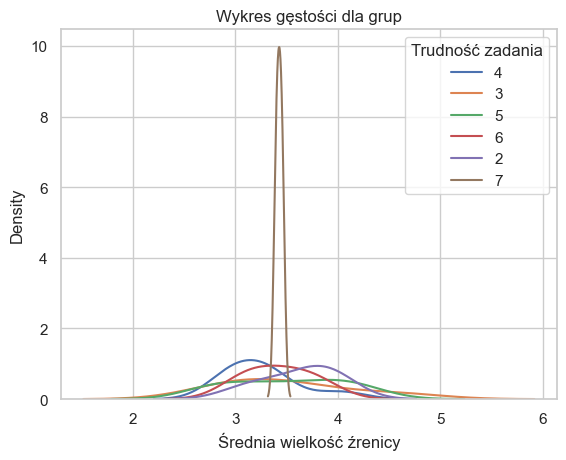

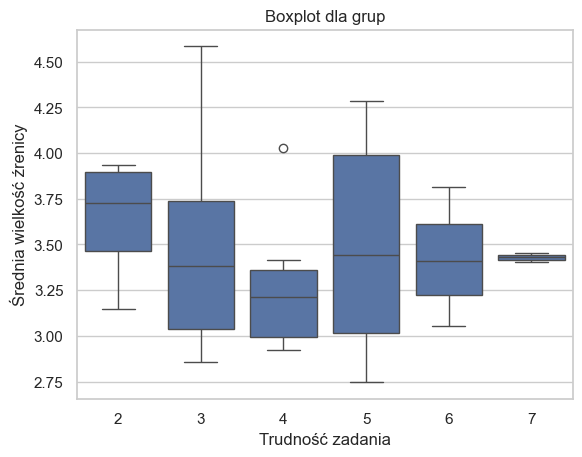

------------------------------
Zsumowane grafiki 2: z poleceniem:


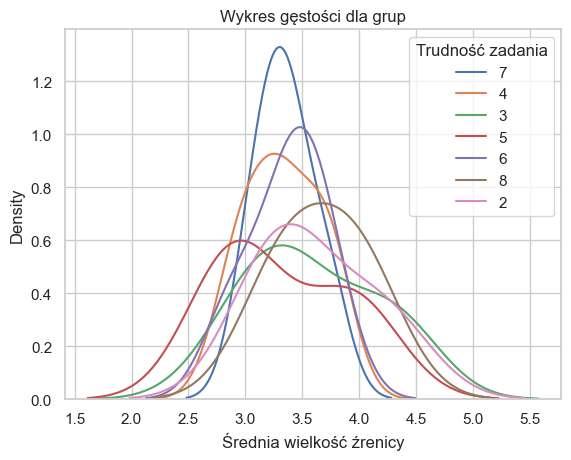

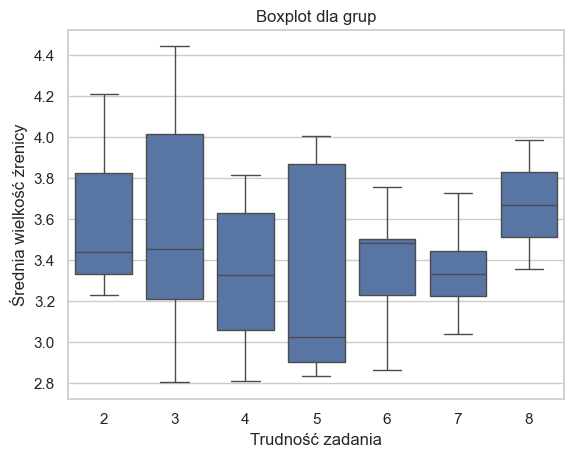

------------------------------
Zsumowane grafiki 2: bez polecenia:


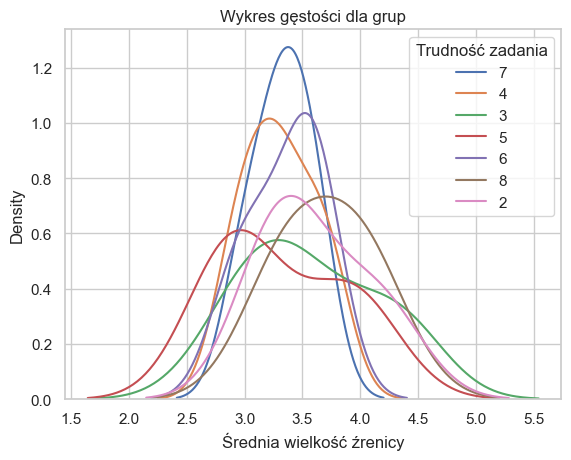

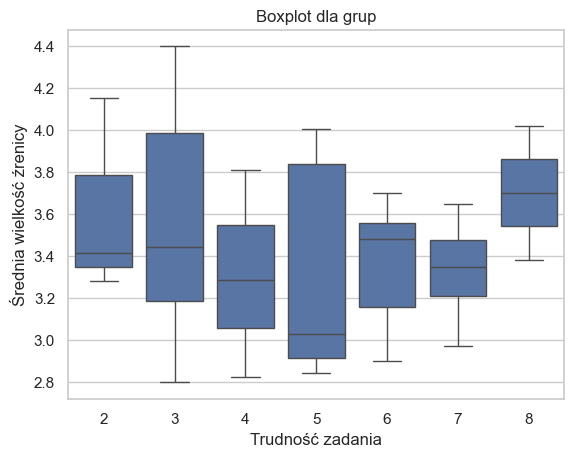

------------------------------
Zsumowane grafiki 2: tylko polecenie :


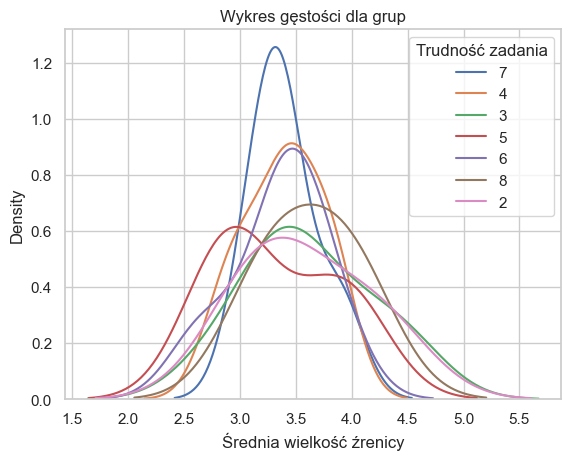

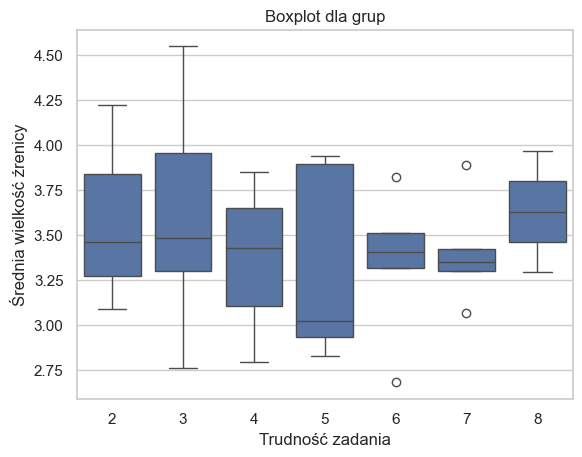

------------------------------
Zsumowane grafiki 3: z poleceniem:


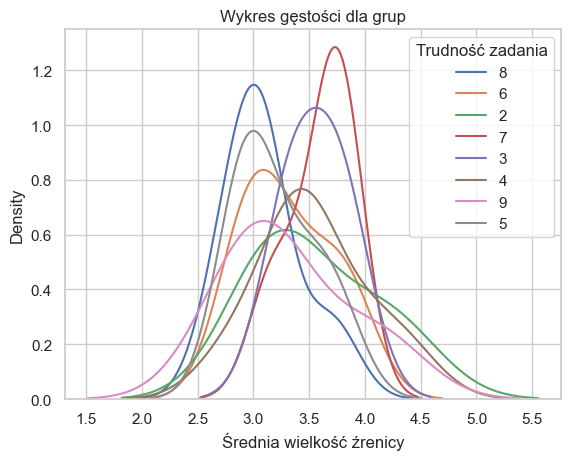

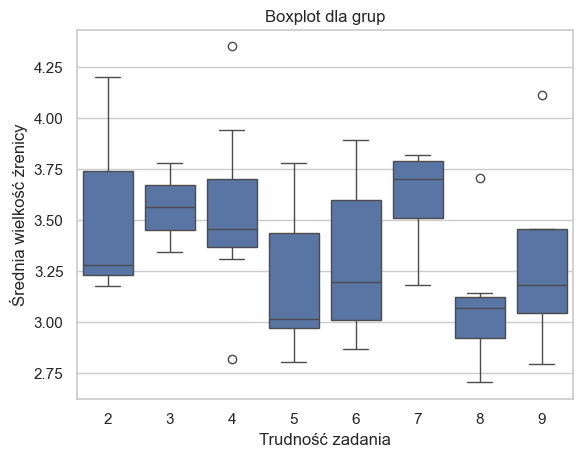

------------------------------
Zsumowane grafiki 3: bez polecenia:


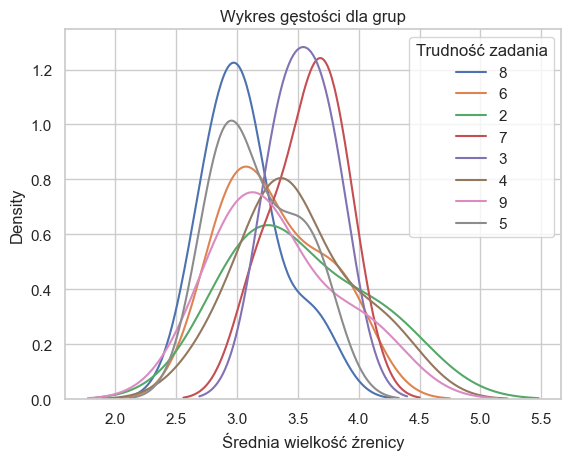

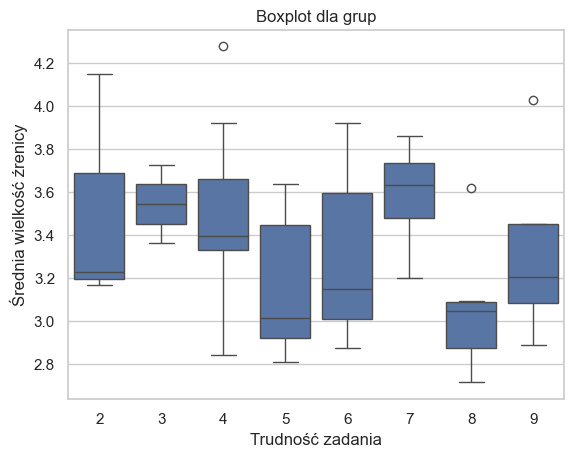

------------------------------
Zsumowane grafiki 3: tylko polecenie :


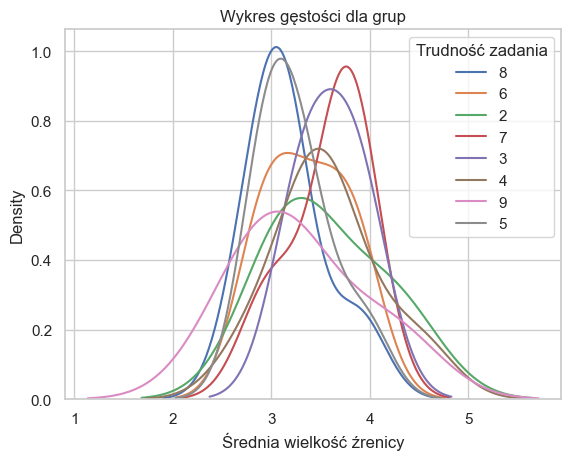

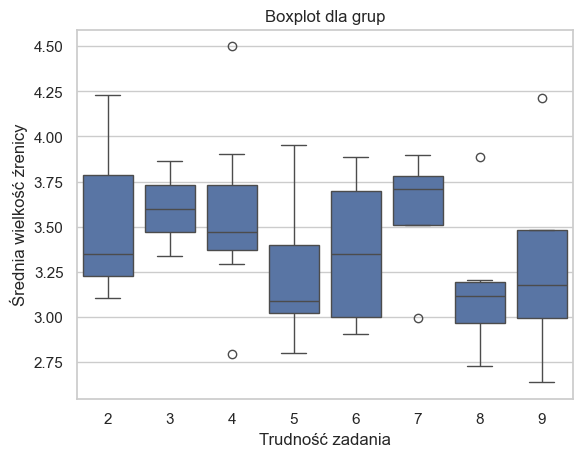

In [60]:
# sumy grafik
param_category = 'Diff'
for col in cols_continue:
    print('##########################################')
    print(col)
    for i, df in enumerate(dfs_sum):
        print('------------------------------')
        print(names_sum[i + 1])
        plot_multi_density(df, col, param_category, cols_continue[col], 'Trudność zadania')
        plot_multi_boxplot(df, param_category, col, 'Trudność zadania', cols_continue[col])

------------------------------
Kolekcja wszystkie grafiki: z poleceniem:


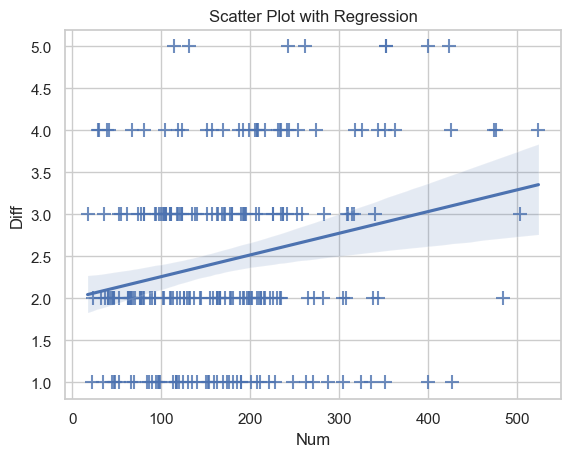

------------------------------
Kolekcja wszystkie grafiki: bez polecenia:


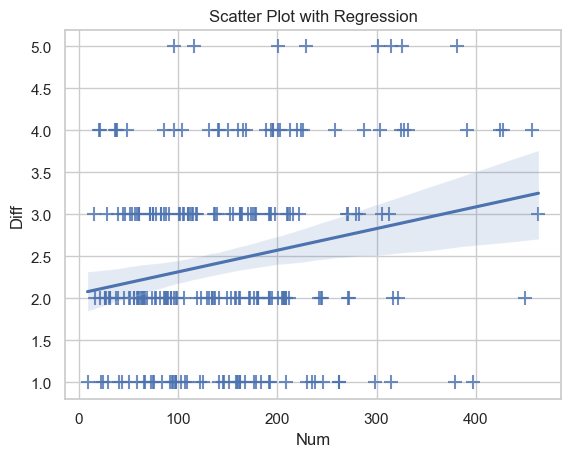

------------------------------
Kolekcja wszystkie grafiki: tylko polecenie:


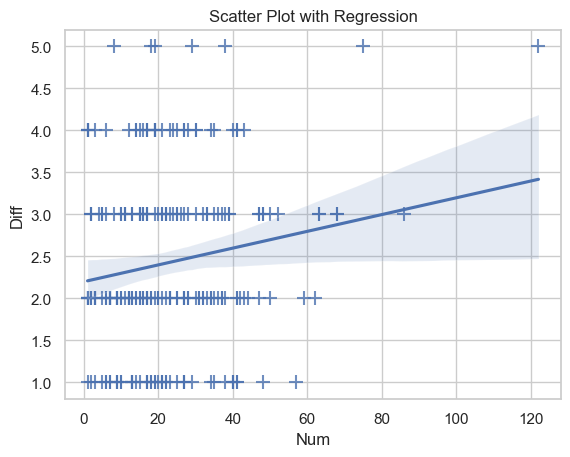

------------------------------
Kolekcja grafiki A: z poleceniem:


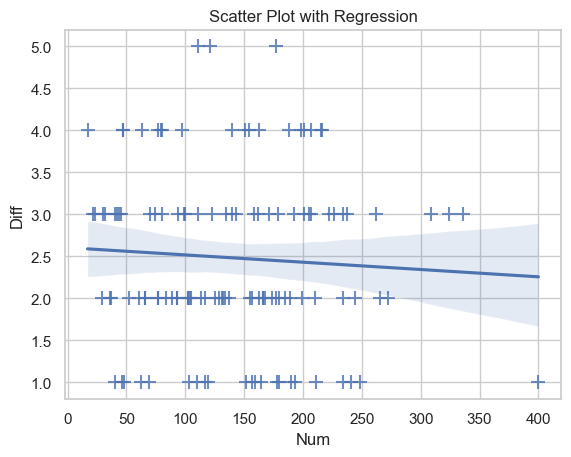

------------------------------
Kolekcja grafiki A: bez polecenia:


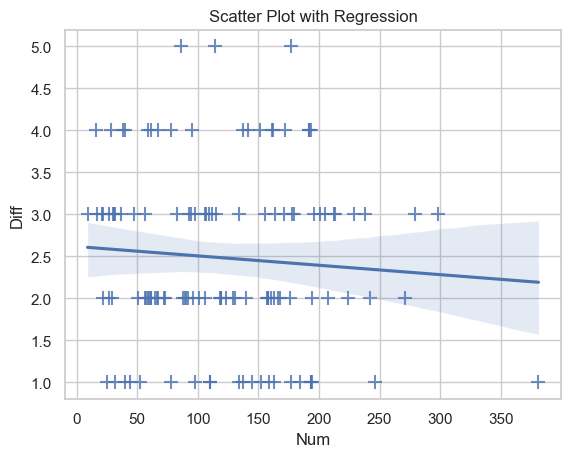

------------------------------
Kolekcja grafiki A: tylko polecenie:


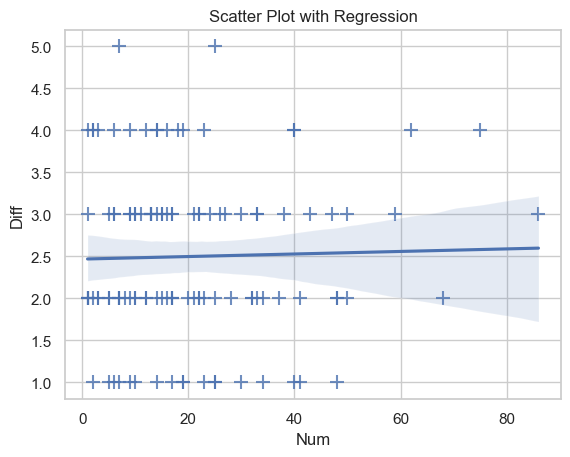

------------------------------
Kolekcja grafiki B: z poleceniem:


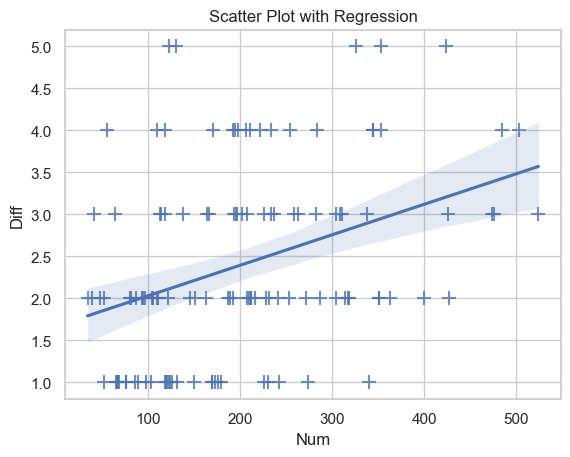

------------------------------
Kolekcja grafiki B: bez polecenia:


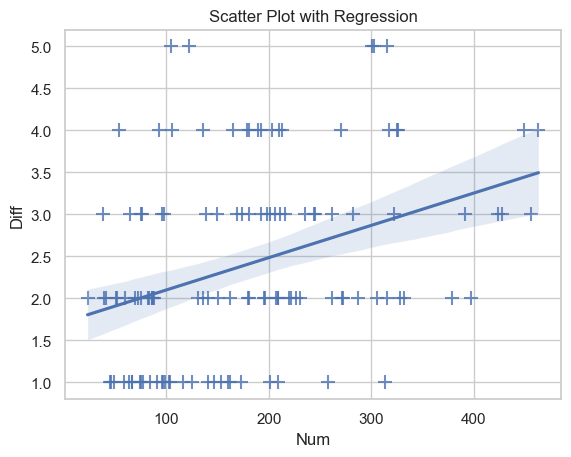

------------------------------
Kolekcja grafiki B: tylko polecenie:


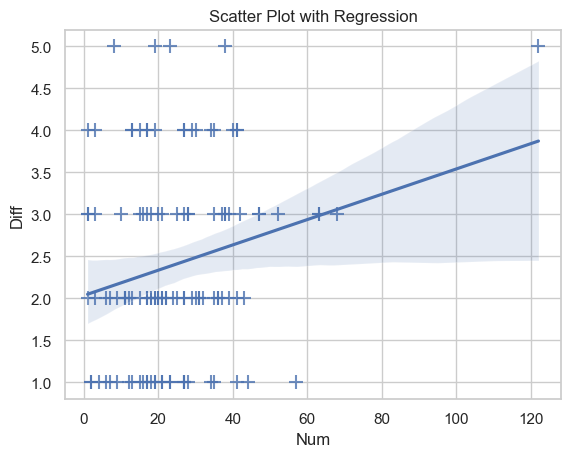

------------------------------
Kolekcja grafiki 1: z poleceniem:


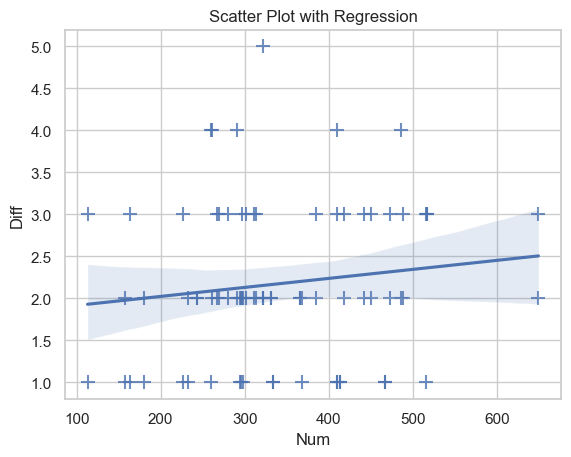

------------------------------
Kolekcja grafiki 1: bez polecenia:


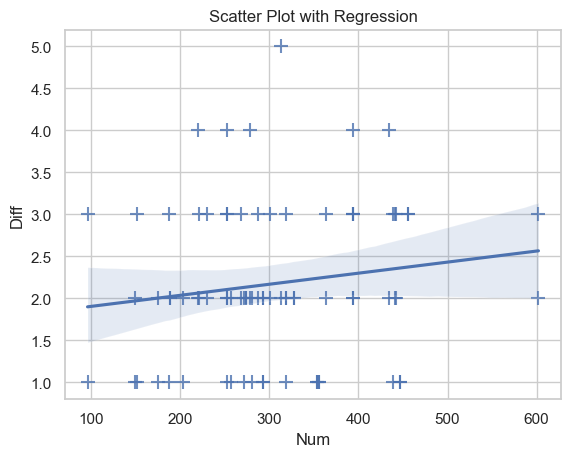

------------------------------
Kolekcja grafiki 1: tylko polecenie :


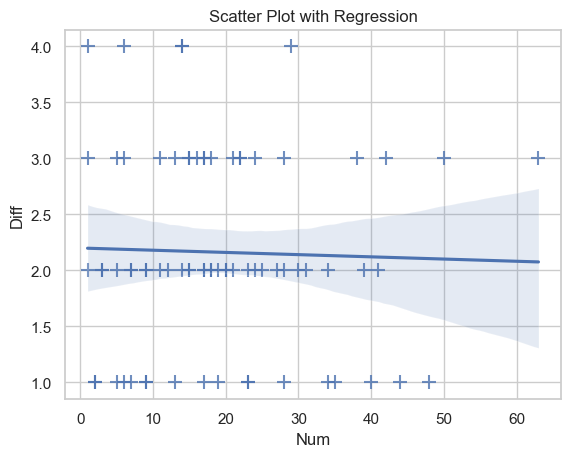

------------------------------
Kolekcja grafiki 2: z poleceniem:


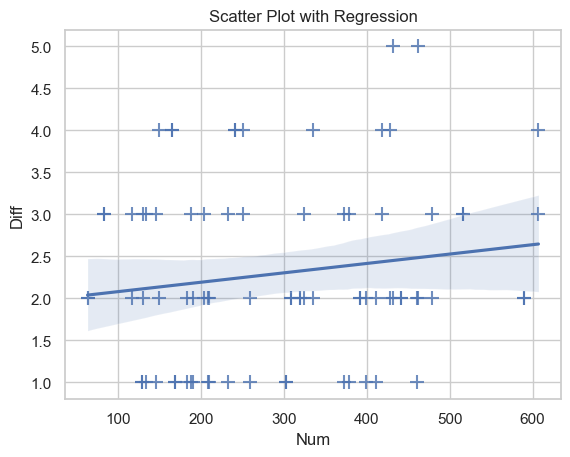

------------------------------
Kolekcja grafiki 2: bez polecenia:


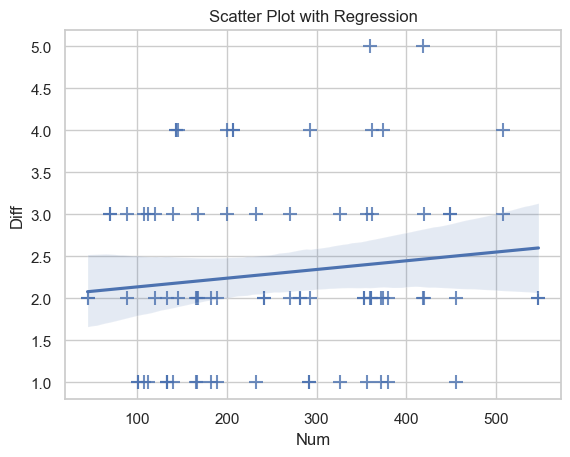

------------------------------
Kolekcja grafiki 2: tylko polecenie:


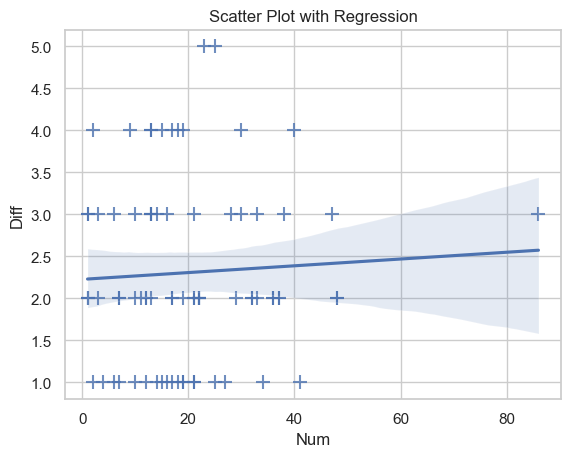

------------------------------
Kolekcja grafiki 3: z poleceniem:


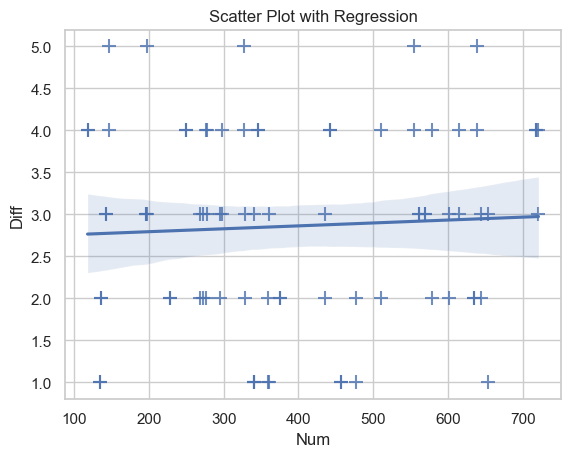

------------------------------
Kolekcja grafiki 3: bez polecenia:


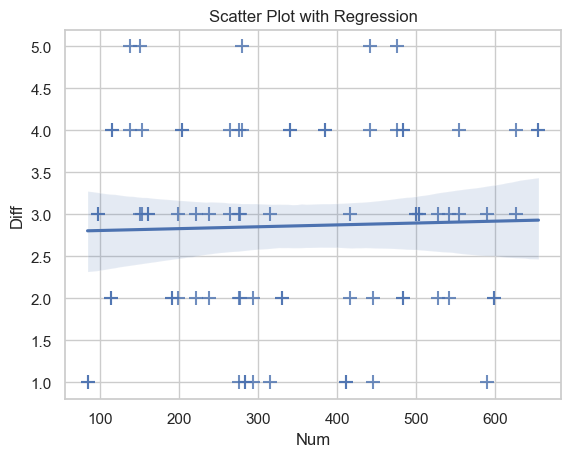

------------------------------
Kolekcja grafiki 3: tylko polecenie:


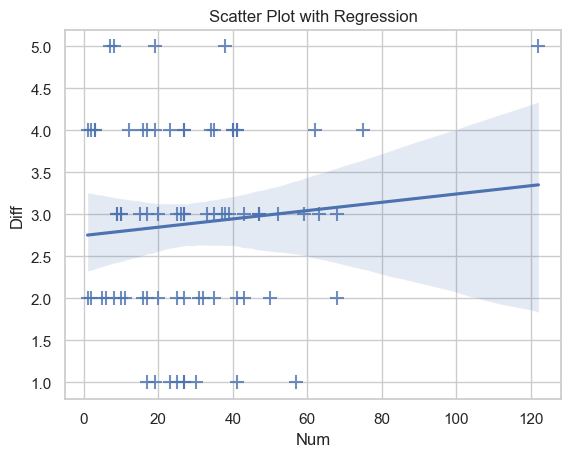

In [61]:
# kolekcje grafik
param_category = 'Diff'
col = 'Num'
for i, df in enumerate(dfs_coll):
    print('------------------------------')
    print(names_coll[i + 1])
    df = df.dropna()
    plot_scatter_with_regression(df, col, param_category)

------------------------------
Zsumowane wszystkie grafiki: z poleceniem:


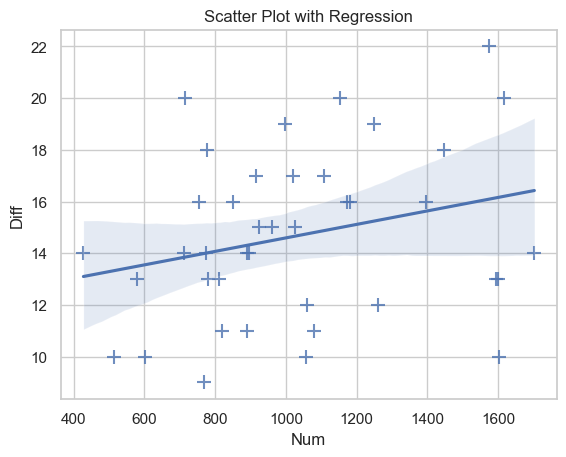

------------------------------
Zsumowane wszystkie grafiki: bez polecenia:


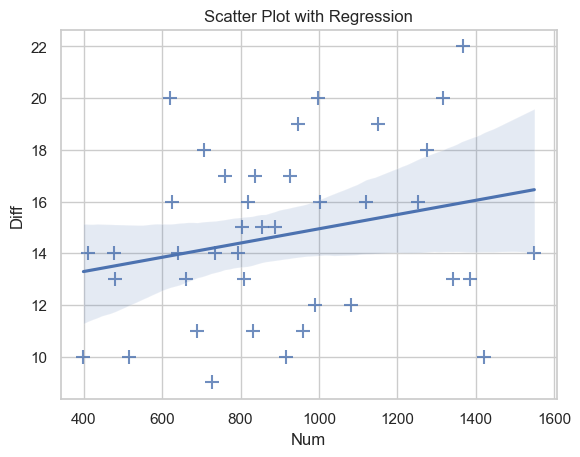

------------------------------
Zsumowane wszystkie grafiki: tylko polecenie :


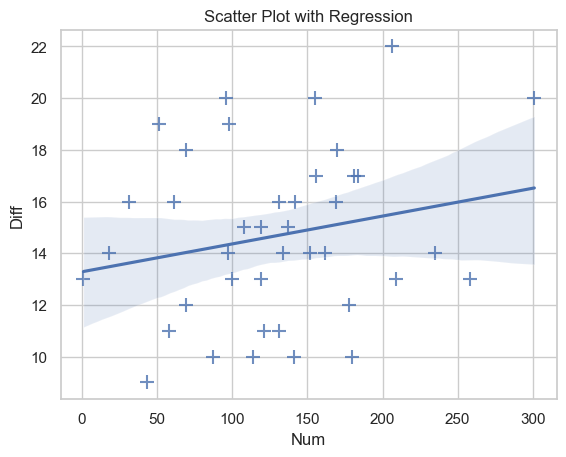

------------------------------
Zsumowane grafiki A: z poleceniem:


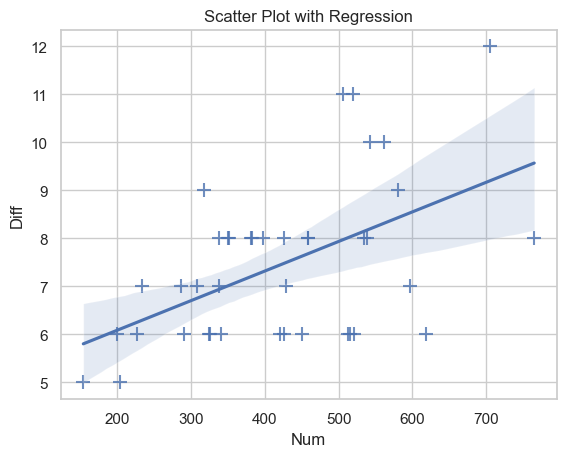

------------------------------
Zsumowane grafiki A: bez polecenia:


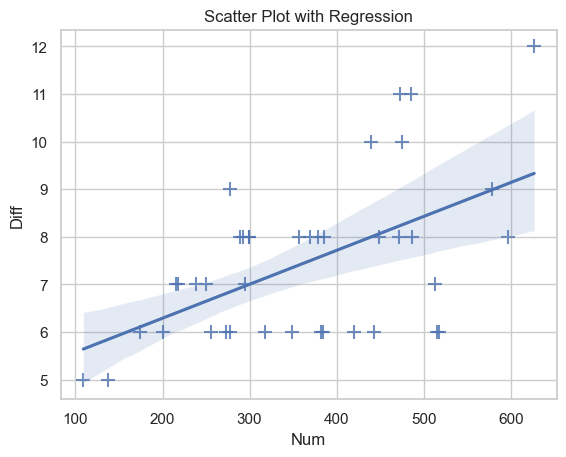

------------------------------
Zsumowane grafiki A: tylko polecenie :


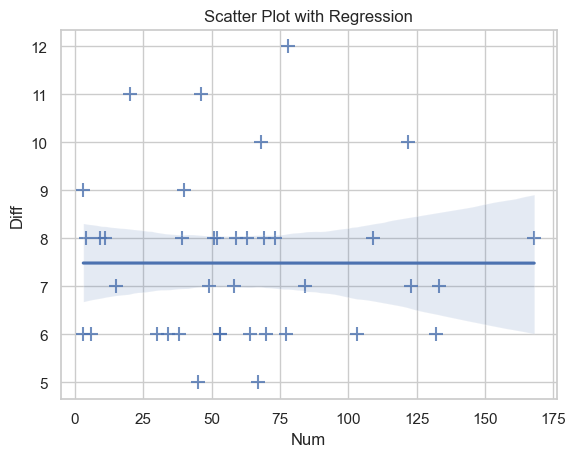

------------------------------
Zsumowane grafiki B: z poleceniem:


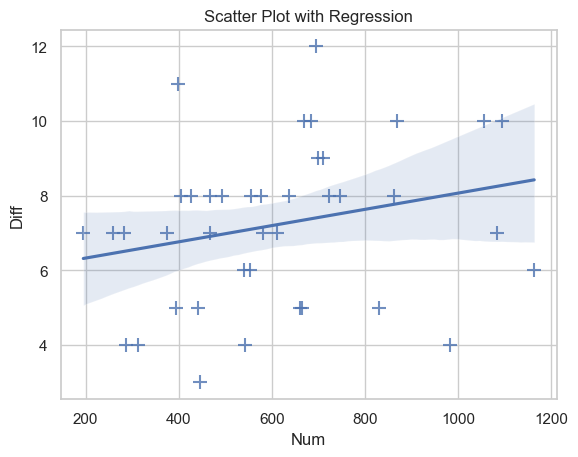

------------------------------
Zsumowane grafiki B: bez polecenia:


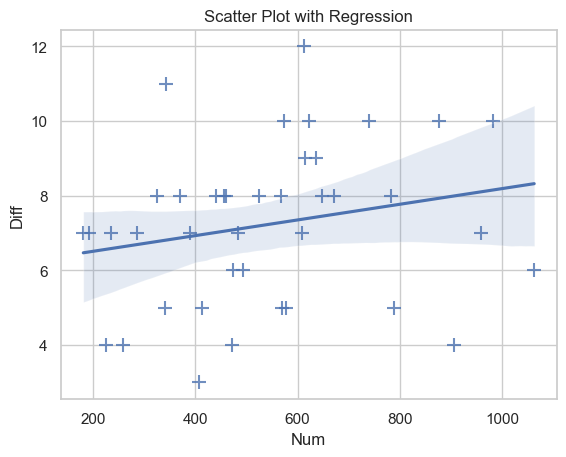

------------------------------
Zsumowane grafiki B: tylko polecenie :


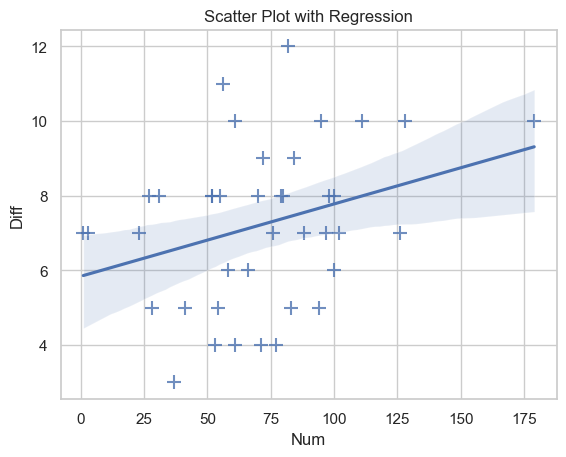

------------------------------
Zsumowane grafiki 1: z poleceniem:


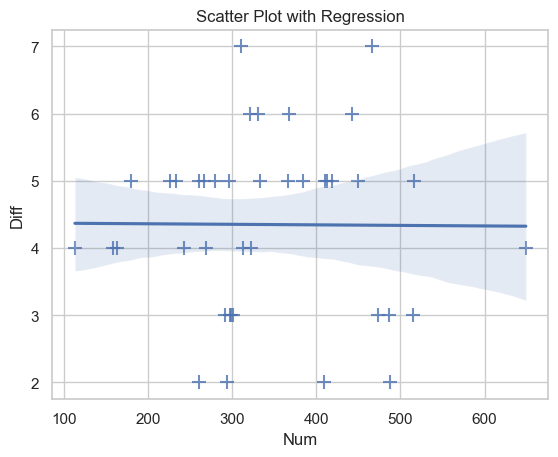

------------------------------
Zsumowane grafiki 1: bez polecenia:


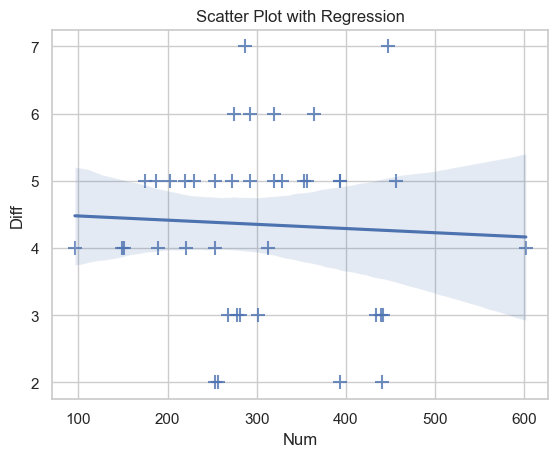

------------------------------
Zsumowane grafiki 1: tylko polecenie :


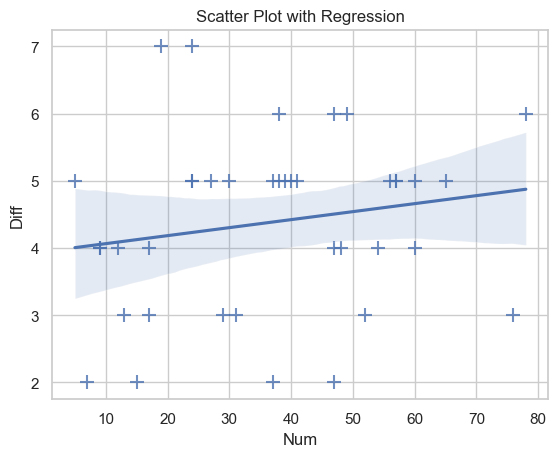

------------------------------
Zsumowane grafiki 2: z poleceniem:


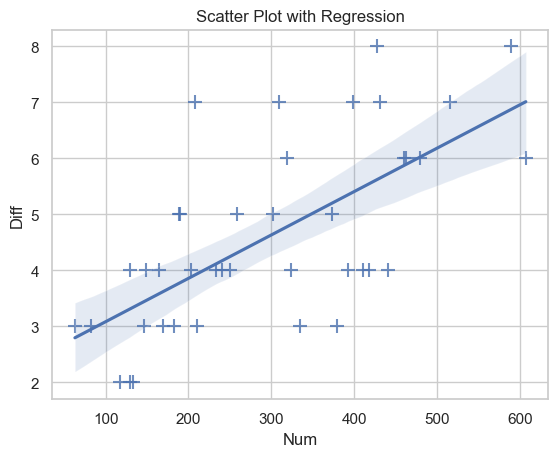

------------------------------
Zsumowane grafiki 2: bez polecenia:


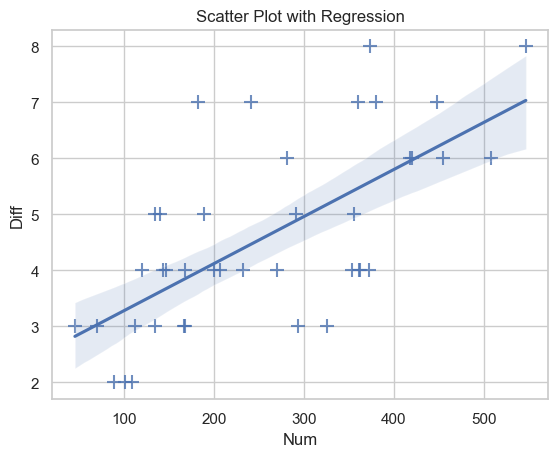

------------------------------
Zsumowane grafiki 2: tylko polecenie :


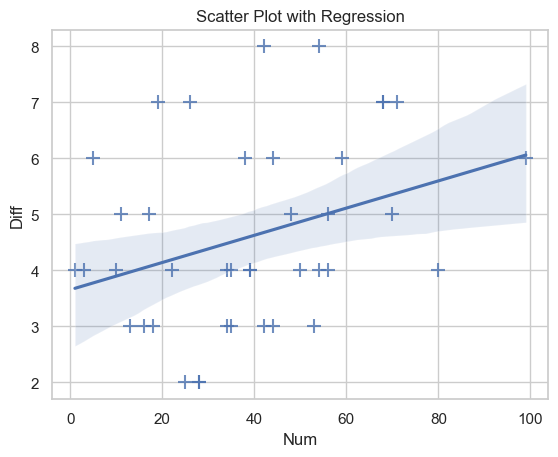

------------------------------
Zsumowane grafiki 3: z poleceniem:


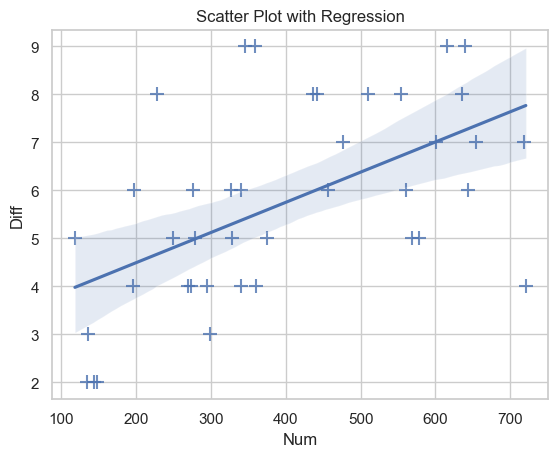

------------------------------
Zsumowane grafiki 3: bez polecenia:


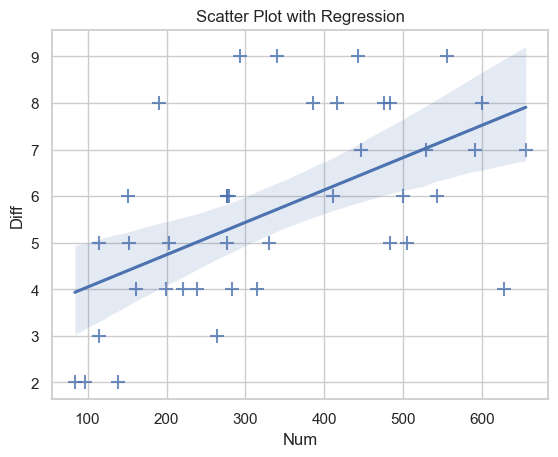

------------------------------
Zsumowane grafiki 3: tylko polecenie :


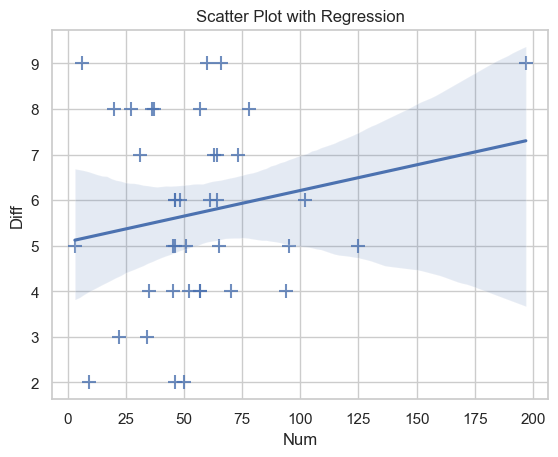

In [62]:
# sumy grafik
param_category = 'Diff'
col = 'Num'
for i, df in enumerate(dfs_sum):
    print('------------------------------')
    print(names_sum[i + 1])
    df = df.dropna()
    plot_scatter_with_regression(df, col, param_category)